<a href="https://colab.research.google.com/github/dnzambuli/Deep-learning-4-CV/blob/master/Project/Project_Notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Medical Image Segmentation for Disease Diagnosis

## The Data
SIPaKMeD Database

## Data Description
The SIPaKMeD Database consists of 4049 images of isolated cells that have been manually cropped from 966 cluster cell images of Pap smear slides. These images were acquired through a CCD camera adapted to an optical microscope. The cell images are divided into five categories containing normal, abnormal and benign cells.

## Data Source
https://www.cse.uoi.gr/~marina/sipakmed.html
4
# Reference
Marina E. Plissiti, Panagiotis Dimitrakopoulos, Giorgos Sfikas, Christophoros Nikou, Olga Krikoni, Antonia

&emsp;&emsp;Charchanti, SIPAKMED: A new dataset for feature

&emsp;&emsp;and image based classification of normal and pathological cervical cells in Pap smear images, IEEE

&emsp;&emsp;International Conference on Image Processing (ICIP) 2018, Athens, Greece, 7-10 October 2018.

# Task Requirements

## Context Example
Malaria is a leading cause of death in Africa. Many **rural clinics** lack advanced diagnostic tools. AI-powered **microscopy image segmentation** can help detect **malaria parasites in blood smears**, reducing misdiagnosis.

## Objective:
Train a **U-Net model** to segment malaria-infected blood cells from microscopic images

## Steps:
1. **Dataset:** Use the NIH malaria dataset or collect labeled blood smear images.
2. **Preprocessing:** Convert images to grayscale, normalize pixel values.
3. **Train U-Net Model:** Use U-Net for cell segmentation.
4. **Evaluation:** Measure IoU (Intersection over Union) and Dice Score.

## Real-World Impact:
✅ Provides AI-assisted malaria diagnosis for rural clinics.

✅ Reduces human error in manual microscopy diagnosis.

✅ Helps doctors prioritize high-risk patients.

## Assesment Rubric

|Criteria| Description| Marks|
|:----|:----|:----|
|Dataset Preparation| Handling of malaria microscopy images| 20|
|Model Implementation| Training U-Net for segmentation| 25|
|Performance| Evaluation IoU, Dice Score| 20|
|Code Documentation| Structured and well-commented code| 15|
|Report & Visualization| Accuracy analysis and segmentation results| 20|

In [1]:
# getting the files using wget



# !wget https://www.cse.uoi.gr/~marina/SIPAKMED/im_Superficial-Intermediate.7z
# !wget https://www.cse.uoi.gr/~marina/SIPAKMED/im_Parabasal.7z
# !wget https://www.cse.uoi.gr/~marina/SIPAKMED/im_Koilocytotic.7z
# !wget https://www.cse.uoi.gr/~marina/SIPAKMED/im_Metaplastic.7z
# !wget https://www.cse.uoi.gr/~marina/SIPAKMED/im_Dyskeratotic.7z

# 1. Download the data from source

In [2]:
# function that can download .7z data and extract it into folders of the name passed into the function.
import subprocess
import os
import urllib.request

def download_7z(source_url, save_directory_name):
  """
  Downloads a .7z file from a given URL and extracts it into a folder
  with the specified name.

  Args:
    source_url: The URL of the .7z file to download.
    save_directory_name: The name of the directory to create and extract
                         the contents of the .7z file into.
  """

  # Create the directory if it doesn't exist
  if not os.path.exists(save_directory_name):
    os.makedirs(save_directory_name)

  # Download the .7z file
  file_name = os.path.basename(source_url)
  file_path = os.path.join(save_directory_name, file_name)
  urllib.request.urlretrieve(source_url, file_path)

  # Extract the .7z file using 7z
  try:
    subprocess.run(['7z', 'x', file_path, f'-o{save_directory_name}'], check=True)
    print(f"Successfully downloaded and extracted {source_url} to {save_directory_name}")
  except FileNotFoundError:
    print("7z is not installed. Please install 7z and try again.")
  except subprocess.CalledProcessError as e:
    print(f"Error extracting the file: {e}")


# downloading
download_7z("https://www.cse.uoi.gr/~marina/SIPAKMED/im_Superficial-Intermediate.7z", "Superficial-Intermediate")
download_7z("https://www.cse.uoi.gr/~marina/SIPAKMED/im_Parabasal.7z", "Parabasal")
download_7z("https://www.cse.uoi.gr/~marina/SIPAKMED/im_Koilocytotic.7z", "Koilocytotic")
download_7z("https://www.cse.uoi.gr/~marina/SIPAKMED/im_Metaplastic.7z", "Metaplastic")
download_7z("https://www.cse.uoi.gr/~marina/SIPAKMED/im_Dyskeratotic.7z", "Dyskeratotic")


Successfully downloaded and extracted https://www.cse.uoi.gr/~marina/SIPAKMED/im_Superficial-Intermediate.7z to Superficial-Intermediate
Successfully downloaded and extracted https://www.cse.uoi.gr/~marina/SIPAKMED/im_Parabasal.7z to Parabasal
Successfully downloaded and extracted https://www.cse.uoi.gr/~marina/SIPAKMED/im_Koilocytotic.7z to Koilocytotic
Successfully downloaded and extracted https://www.cse.uoi.gr/~marina/SIPAKMED/im_Metaplastic.7z to Metaplastic
Successfully downloaded and extracted https://www.cse.uoi.gr/~marina/SIPAKMED/im_Dyskeratotic.7z to Dyskeratotic


# 2. Examine unique file types in the folders

sample idea for reading the filenames

```python
def get_main_file_types_in_folders(root_folder):
  """
  Reads the main file type in each folder within the specified root folder.

  Args:
    root_folder: The path to the root folder containing the subfolders.

  Returns:
    A dictionary where keys are folder names and values are the most frequent file extension.
  """

  folder_file_types = defaultdict(lambda: defaultdict(int))

  for folder_name in os.listdir(root_folder):
    folder_path = os.path.join(root_folder, folder_name)
    if os.path.isdir(folder_path):
      for filename in os.listdir(folder_path):
        _, file_extension = os.path.splitext(filename)
        if file_extension:
          folder_file_types[folder_name][file_extension.lower()] += 1

  main_file_types = {}
  for folder_name, file_type_counts in folder_file_types.items():
    if file_type_counts:
      most_frequent_file_type = max(file_type_counts, key=file_type_counts.get)
      main_file_types[folder_name] = most_frequent_file_type

  return main_file_types
```

In [3]:
# function to read the main file type in each folder like: .bat, .jpg, ...

from collections import defaultdict

def get_main_file_types_in_folders(root_folder_path):
    """
    Reads the main file type in the folder named 'im_[root_folder_path]', excluding any .7z archives.

    Args:
        root_folder_path (str): The base folder name.

    Returns:
        A string representing the most frequent file extension in 'im_[root_folder_path]', or None if empty.
    """

    # Construct the folder name
    folder_name = f"{root_folder_path}/im_{root_folder_path}" # after finding out the links bring back a sub .7z archive

    if not os.path.exists(folder_name) or not os.path.isdir(folder_name):
        print(f"Folder '{folder_name}' does not exist or is not a directory.")
        return None

    file_type_counts = defaultdict(int)

    for filename in os.listdir(folder_name):
        file_path = os.path.join(folder_name, filename)

        # Ensure it's a file and not a directory
        if os.path.isfile(file_path):
            _, file_extension = os.path.splitext(filename)

            # Ignore empty extensions (folders, hidden files, etc.) and .7z archives
            if file_extension and file_extension.lower() != ".7z":
                file_type_counts[file_extension.lower()] += 1

    # Determine the most frequent file extension
    if file_type_counts:
        return file_type_counts
    else:
        return None  # Return None if no valid files were found

# Example usage:
root_folder_path = ["Superficial-Intermediate", "Parabasal", "Koilocytotic", "Metaplastic", "Dyskeratotic"]
for folder in root_folder_path:
  print(f"Main file type in {folder}: {get_main_file_types_in_folders(folder)}")


Main file type in Superficial-Intermediate: defaultdict(<class 'int'>, {'.dat': 1662, '.bmp': 126})
Main file type in Parabasal: defaultdict(<class 'int'>, {'.dat': 1574, '.bmp': 108})
Main file type in Koilocytotic: defaultdict(<class 'int'>, {'.dat': 1650, '.bmp': 238})
Main file type in Metaplastic: defaultdict(<class 'int'>, {'.bmp': 271, '.dat': 1586})
Main file type in Dyskeratotic: defaultdict(<class 'int'>, {'.dat': 1626, '.bmp': 223})


# 3. Data Description

The data appears as a

bmp -- the image
dat -- the regions within the image data that have a specific image

## 3.1 Sample illustration

Initial idea

**drawing a rectangle**

```python
def display_borders_from_dat(image_path, dat_path):
    """
    Displays the borders of regions identified in a .dat file on the corresponding .bmp image.

    Args:
        image_path: Path to the .bmp image file.
        dat_path: Path to the .dat file containing region information.
    """

    try:
        # Load the image
        image = cv2.imread(image_path)
        if image is None:
            print(f"Error loading image: {image_path}")
            return

        # Load the .dat file
        with open(dat_path, 'r') as f:
            lines = f.readlines()

        # Process the .dat file to get region coordinates (assuming a specific format)
        # Adjust this part based on the actual format of your .dat file
        regions = []
        for line in lines:
            parts = line.strip().split()
            if len(parts) >= 4:
                try:
                    x1, y1, x2, y2 = map(int, parts[:4])
                    regions.append((x1, y1, x2, y2))
                except ValueError:
                    print(f"Skipping invalid line: {line.strip()}")

        # Draw borders on the image
        for x1, y1, x2, y2 in regions:
            cv2.rectangle(image, (x1, y1), (x2, y2), (0, 0, 255), 2)  # Red border, thickness 2

        # Display the image with borders in Google Colab
        cv2_imshow(image)

    except Exception as e:
        print(f"Error processing files: {e}")
```

## 3.2 The rectangle failed as .dat files seem to illustrate a polygon

example of `001_cyt01.dat`

```dat
801.25,776.25
820.25,766.25
829.75,754.75
841.75,741.25
846.75,721.25
849.25,708.75
855.25,700.25
853.75,690.25
839.75,691.75
824.25,694.25
810.25,693.25
800.75,687.75
788.25,691.75
776.75,699.25
772.75,709.25
770.25,721.25
767.25,734.75
768.25,748.75
770.75,765.25
779.75,776.25
792.75,778.25
801.25,776.25
```

Polygon Points: [(1164, 873), (1141, 865), (1118, 862), (1102, 860), (1088, 864), (1074, 860), (1071, 856), (1056, 861), (1045, 872), (1036, 875), (1019, 868), (1007, 864), (997, 853), (984, 841), (983, 828), (983, 816), (992, 810), (994, 795), (988, 782), (991, 771), (990, 757), (999, 746), (1000, 715), (1011, 683), (1024, 657), (1035, 628), (1049, 597), (1054, 581), (1056, 551), (1057, 541), (1081, 533), (1105, 530), (1111, 514), (1150, 509), (1167, 512), (1174, 525), (1177, 530), (1191, 521), (1213, 521), (1228, 527), (1244, 540), (1262, 553), (1278, 564), (1301, 580), (1315, 591), (1337, 596), (1351, 611), (1362, 647), (1371, 675), (1376, 691), (1362, 703), (1355, 712), (1348, 722), (1349, 744), (1341, 754), (1337, 768), (1332, 780), (1337, 795), (1327, 801), (1314, 812), (1313, 824), (1309, 837), (1300, 857), (1285, 880), (1253, 890), (1213, 889), (1185, 879), (1164, 873)]


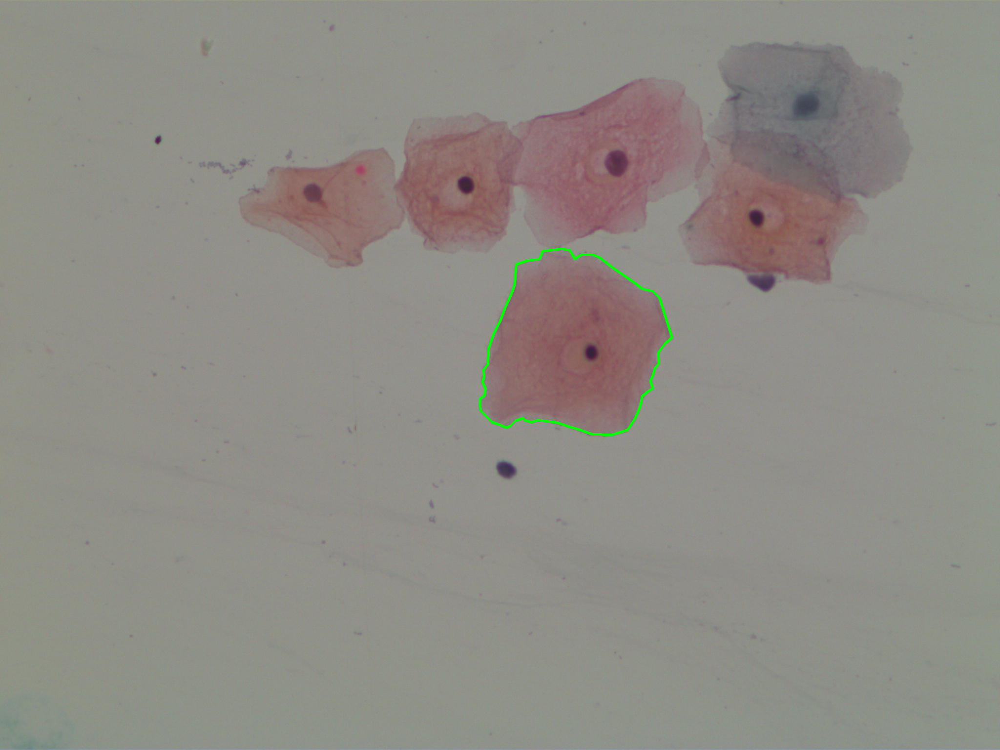

In [4]:
from google.colab.patches import cv2_imshow
import cv2
import numpy as np


def display_polygon_from_dat(image_path, dat_path):
    """
    Displays the borders of a region identified in a .dat file as a polygon on a .bmp image.

    Args:
        image_path: Path to the .bmp image file.
        dat_path: Path to the .dat file containing polygon points.
    """

    try:
        # Load the image
        image = cv2.imread(image_path)
        if image is None:
            print(f"Error loading image: {image_path}")
            return

        # Load the .dat file
        with open(dat_path, 'r') as f:
            lines = f.readlines()

        # Process the .dat file to get polygon coordinates
        polygon_points = []
        for line in lines:
            parts = line.strip().split(',')
            if len(parts) == 2:
                try:
                    x, y = map(float, parts)  # Convert to float since values have decimals
                    polygon_points.append((int(x), int(y)))  # Convert to integers for OpenCV
                except ValueError:
                    print(f"Skipping invalid line: {line.strip()}")
        print(f"Polygon Points: {polygon_points}")

        # Convert list to numpy array and reshape for OpenCV
        polygon_np = np.array(polygon_points, np.int32).reshape((-1, 1, 2))

        # Draw the polygon on the image
        cv2.polylines(image, [polygon_np], isClosed=True, color=(0, 255, 0), thickness=3)

        # Display the image with the drawn polygon
        cv2_imshow(image)

    except Exception as e:
        print(f"Error processing files: {e}")


# Example usage:
# Assuming you have a folder with .bmp and .dat files
# image_folder = "/content/Superficial-Intermediate/im_Superficial-Intermediate"
# for filename in os.listdir(image_folder):
#     if filename.endswith(".bmp"):
#         image_path = os.path.join(image_folder, filename)
#         dat_path = os.path.join(image_folder, filename[:-4] + ".dat")  # Replace ".bmp" with ".dat"
#         if os.path.exists(dat_path):
#             display_borders_from_dat(image_path, dat_path)

crop_root_path = "/content/Superficial-Intermediate/im_Superficial-Intermediate"
image_path = f"{crop_root_path}/001.bmp"
dat_path = f"{crop_root_path}/001_cyt01.dat"
display_polygon_from_dat(image_path, dat_path)

# 4. Labeling the data

original data is in the format:

- Image .bmp
- cell border _cyt[int].dat
- cell nucleus _nuc[int].dat

target data will be in the format

- green bordered cell with blue bordered nucleus
- a label dataset with the cell type data

## 4.1 About Cell types

1. **Superficial-Intermediate cells** - They constitute the majority of the cells found in a Pap test. Usually they are flat with round, oval or polygonal shape cytoplasm stains mostly eosinophilic or cyanophilic. They contain a central pycnotic nucleus. They have well defined, large polygonal cytoplasm and easily recognized nuclear limits (small pycnotic in the superficial and vesicular nuclei in intermediate cells). These type of cells show the characteristics morphological changes (koilocytic atypia) due to more severe lessions.

2. **Parabasal cells** - Parabasal cells are immature squamous cells and they are the smallest epithelial cells seen on a typical vaginal smear. The cytoplasm is generally cyanophilic and they usually contain a large vesicular nucleus. It must be noted that parabasal cells have similar morphological characteristic with the cells identified as metaplastic cells and it is difficult to be distinguished from them.

3. **Koilocytotic cells** - These cells correspond most commonly in mature squamous cells (intermediate and superficial) and some times in metaplastic type koilocytotic cells. They appear most often cyanophilic, very lightly stained and they are characterized by a large perinuclear cavity. The periphery of the cytoplasm is very dense stained. The nuclei of koilocytes are usually enlarged, eccentrically located, hyperchromatic and exhibit irregularity of the nuclear membrane contour.

4. **Dysketarotic cells** - They are squamous cells which undergone premature abnormal keratinization within individual cells or more often in three-dimensional clusters. They exhibit a brilliant orangeophilic cytoplasm. They are characterized by the presence of vesicular nuclei, identical to the nuclei of koilcytotic cells. In many cases there are binucleated and/or multinucleated cells.

5. **Metaplastic Cells** - They are in essence small or large parabasal-type cells with prominent cellular borders, often exhibiting eccentric nuclei and sometimes containing a large intracellular vacuole. The staining in the center portion is usually light brown and it often differs from that in the marginal portion. Also, there is essentially a darker-stained cytoplasm and they exhibit great uniformity of size and shape compared to the parabasal cells, as their characteristic is the well defined, almost round shape of cytoplasm.

## Simplified explanation

1. **Superficial & Intermediate Cells** – These are the most common cells found in a Pap test. They are large, flat, and have well-defined edges. Their center contains a small, dark nucleus. In certain conditions, they may show changes (koilocytosis) that indicate more serious abnormalities.

2. **Parabasal Cells** – These are immature cells, smaller than superficial and intermediate cells. They have a round shape with a large, light-colored nucleus. They look similar to another type of cell called metaplastic cells, making them difficult to tell apart.

3. **Koilocytotic Cells** – These are squamous (flat) cells that have a distinct appearance due to viral infection, often linked to HPV. They have a clear area around the nucleus (perinuclear cavity), and their edges stain darker. The nucleus is usually larger and irregular.

4. **Dyskeratotic Cells** – These are squamous cells that have started abnormal early keratinization (a process where cells become tough and die off). They often clump together and stain bright orange. Their nuclei look similar to those in koilocytotic cells, and sometimes they have more than one nucleus.

5. **Metaplastic Cells** – These cells are transitioning from one type to another, often appearing similar to parabasal cells but with clearer borders and a more even, rounded shape. They sometimes have a large vacuole (empty space) inside and stain darker at the edges than in the center.

In [5]:
import re

def cell_bind(data_folder):
    """
    Identifies and pairs each .bmp image with its corresponding _cyt_ (cell wall) and _nuc_ (nucleus) .dat files.

    Args:
        data_folder (str): Path to the folder containing .bmp and .dat files.

    Returns:
        dict: A dictionary mapping each .bmp image to its corresponding _cyt_ and _nuc_ .dat files.
    """
    cell_region = {}

    # List all files in the folder
    all_files = os.listdir(data_folder)

    # Find all BMP images
    bmp_files = [f for f in all_files if f.endswith(".bmp")]

    # Find matching cyt and nuc dat files
    cyt_files = {re.search(r"(\d+)_cyt\d*_.dat", f): f for f in all_files if "_cyt" in f and f.endswith(".dat")}
    nuc_files = {re.search(r"(\d+)_nuc\d*_.dat", f): f for f in all_files if "_nuc" in f and f.endswith(".dat")}

    for bmp in bmp_files:
        match = re.search(r"(\d+)", bmp)
        if match:
            num = match.group(1)
            cyt_file = cyt_files.get(re.search(rf"{num}_cyt\d*_.dat", "_".join(cyt_files.values())), None)
            nuc_file = nuc_files.get(re.search(rf"{num}_nuc\d*_.dat", "_".join(nuc_files.values())), None)

            if cyt_file and nuc_file:
                cell_region[bmp] = (cyt_file, nuc_file)

    return cell_region

In [6]:
def crop_img(root_folder, cell_region):
    """
    Crops an image based on the cell_wall and marks the nucleus with a green circle.

    Args:
        root_folder (str): The main folder containing images.
        cell_region (dict): Dictionary mapping .bmp images to corresponding .dat files.

    The cropped images are stored in 'cropped/' inside the root folder.
    """

    cropped_folder = os.path.join(root_folder, "CROPPED")
    os.makedirs(cropped_folder, exist_ok=True)

    for bmp_file, (cyt_dat, nuc_dat) in cell_region.items():
        image_path = os.path.join(root_folder, bmp_file)
        cyt_path = os.path.join(root_folder, cyt_dat)
        nuc_path = os.path.join(root_folder, nuc_dat)

        # Load image
        image = cv2.imread(image_path)
        if image is None:
            print(f"Error: Cannot load {image_path}")
            continue

        # Read cell wall coordinates
        cell_wall_points = []
        with open(cyt_path, "r") as f:
            for line in f:
                parts = line.strip().split(',')
                if len(parts) == 2:
                    x, y = map(float, parts)
                    cell_wall_points.append((int(x), int(y)))

        if not cell_wall_points:
            print(f"Skipping {bmp_file} - No cell wall detected")
            continue

        # Convert cell wall points to numpy array
        cell_wall_np = np.array(cell_wall_points, np.int32).reshape((-1, 1, 2))

        # Create a mask for cropping
        mask = np.zeros(image.shape[:2], dtype=np.uint8)
        cv2.fillPoly(mask, [cell_wall_np], 255)

        # Apply mask
        cropped_image = cv2.bitwise_and(image, image, mask=mask)

        # Read nucleus coordinates and draw circle
        with open(nuc_path, "r") as f:
            for line in f:
                parts = line.strip().split(',')
                if len(parts) == 2:
                    x, y = map(float, parts)
                    center = (int(x), int(y))
                    cv2.circle(cropped_image, center, 10, (0, 255, 0), 2)  # Green circle

        # Save cropped image
        save_path = os.path.join(cropped_folder, bmp_file)
        cv2.imwrite(save_path, cropped_image)
        print(f"Saved cropped image: {save_path}")

In [7]:
def process_files_in_folders(root_folder_path_list):
    """
    Loops through folders in the provided list, identifies .dat and .bmp files in 'im_' subfolders, and applies the cell_bind function.

    Args:
        root_folder_path_list (list): A list of root folder paths to iterate through.
    """
    for root_folder_path in root_folder_path_list:
        im_folder_path = os.path.join(root_folder_path, f"im_{root_folder_path}")

        if os.path.exists(im_folder_path) and os.path.isdir(im_folder_path):
            print(f"\nProcessing folder: {im_folder_path}")

            # Identify cell regions
            cell_regions = cell_bind(im_folder_path)

            if not cell_regions:
                print(f"No valid cell regions found in {im_folder_path}. Skipping...")
                continue

            print(f"Identified {len(cell_regions)} cell regions.")

            # Process and crop images
            crop_img(im_folder_path, cell_regions)
        else:
            print(f"\nWarning: Folder {im_folder_path} does not exist or is not a directory.")


# usage
process_files_in_folders(root_folder_path)



Processing folder: Superficial-Intermediate/im_Superficial-Intermediate
Identified 126 cell regions.
Saved cropped image: Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119.bmp
Saved cropped image: Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/109.bmp
Saved cropped image: Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/100.bmp
Saved cropped image: Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021.bmp
Saved cropped image: Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/053.bmp
Saved cropped image: Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094.bmp
Saved cropped image: Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/072.bmp
Saved cropped image: Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/078.bmp
Saved cropped image: Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/055.bmp
Saved cropped image: Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007.bm

Polygon Points: [(91, 236), (114, 232), (136, 234), (162, 236), (184, 232), (209, 225), (242, 219), (263, 213), (288, 203), (304, 202), (328, 197), (346, 191), (358, 184), (369, 179), (378, 175), (389, 159), (397, 142), (398, 128), (392, 115), (383, 105), (362, 98), (344, 96), (329, 93), (308, 94), (296, 95), (287, 94), (275, 89), (263, 84), (251, 76), (229, 71), (215, 69), (202, 68), (185, 69), (162, 70), (143, 70), (122, 64), (105, 51), (78, 35), (60, 19), (39, 9), (30, 10), (21, 22), (13, 38), (9, 53), (9, 62), (13, 74), (20, 86), (21, 101), (24, 121), (29, 138), (30, 153), (32, 163), (34, 174), (39, 195), (44, 215), (54, 228), (70, 236), (79, 235), (91, 236)]


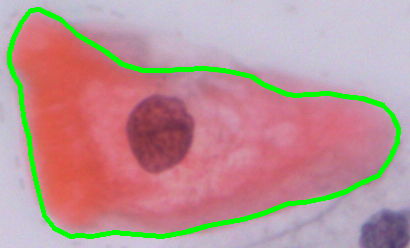

In [8]:
cropped_img_001_01 = "/content/Koilocytotic/im_Koilocytotic/CROPPED/001_01.bmp"
display_polygon_from_dat(cropped_img_001_01, f"{cropped_img_001_01[:-4]}_cyt.dat")

Polygon Points: [(159, 173), (169, 167), (179, 159), (188, 149), (193, 135), (194, 125), (191, 114), (187, 110), (183, 101), (175, 96), (166, 93), (157, 93), (146, 96), (136, 103), (128, 113), (125, 125), (125, 137), (131, 150), (137, 163), (144, 171), (149, 175), (159, 173)]


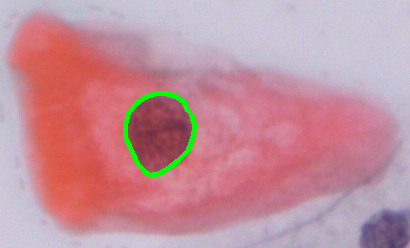

In [9]:
display_polygon_from_dat(cropped_img_001_01, f"{cropped_img_001_01[:-4]}_nuc.dat")

# 5. Combine to a dataset

The goal is to end up with a dataset in the following format

```bash
Clean_Data/
│
├── Training_Data/
│   ├── Images/
│   │   ├── 001_01.bmp
│   │   ├── ...
│   │   ├── xxx_xx.bmp
│   │
│   ├── Masks/           # Corresponding segmentation masks
│   │   ├── 001_01_nuc.bmp  # Nucleus mask
│   │   ├── 001_01_cyt.bmp  # Cytoplasm mask
|   |
│   ├── Labels.txt
│   │   ├── superficial-intermediate
│   │   ├── ...
│   │   ├── Koliocytotic
│   │   ├── ...
│   │   ├── Parabasal
│   │   ├── ...
│   │   ├── Metaplastic
│   │   ├── ...
│   │   ├── Dyskeratotic
│
├── Validation_Data/
│   ├── Images/
│   │   ├── 001_01.bmp
│   │   ├── ...
│   │   ├── xxx_xx.bmp
│   │
│   ├── Masks/
│   │   ├── 001_01_nuc.bmp
│   │   ├── 001_01_cyt.bmp
│   │
│   ├── Labels.txt
│   │   ├── superficial-intermediate
│   │   ├── ...
│   │   ├── Koliocytotic
│   │   ├── ...
│   │   ├── Parabasal
│   │   ├── ...
│   │   ├── Metaplastic
│   │   ├── ...
│   │   ├── Dyskeratotic
|
├── Test_Data/
│   ├── Images/
│   │   ├── 001_01.bmp
│   │   ├── ...
│   │   ├── xxx_xx.bmp
│   │
│   ├── Masks/
│   │   ├── 001_01_nuc.bmp
│   │   ├── 001_01_cyt.bmp
│   │
│   ├── Labels.txt
│   │   ├── superficial-intermediate
│   │   ├── ...
│   │   ├── Koliocytotic
│   │   ├── ...
│   │   ├── Parabasal
│   │   ├── ...
│   │   ├── Metaplastic
│   │   ├── ...
│   │   ├── Dyskeratotic
  
```


# Creating Masks

## what are masks
A mask in image data is **a binary** or **labeled image** that indicates the regions of interest in the original image. It is commonly used in `image segmentation tasks` where the goal is to identify and separate specific objects or structures from the background.

## what are they used for

1. **Object Segmentation**: Helps a model understand which pixels belong to an object and which do not.
2. **Ground Truth for Training**: Masks serve as labels for training deep learning models like U-Net.
3. **Feature Highlighting**: Can be used to isolate cells, lesions, or specific structures in medical imaging.

## Types

### Binary Mask (Black & White)

- Used for segmentation (e.g., cell detection).

- Pixels are either 0 (background) or 1 (object).

*Example*: Identifying malaria-infected blood cells.

### Grayscale Mask (Shades of Gray)

- Each pixel has an intensity value between 0-255 (or 0-1 when normalized).

- Used in medical imaging to show probabilities of regions being an object.

### Colored Mask (Multi-Class Segmentation)

- Each object class has a different color.

*Example*:

1. Red (255,0,0) → Nucleus

2. Green (0,255,0) → Cytoplasm

3. Blue (0,0,255) → Background

In [10]:
def create_mask_from_dat(image_path, dat_path, save_path, mask_size=(256, 256)):
    """
    Creates a binary mask from .dat file containing polygon coordinates.

    Args:
        image_path (str): Path to the original image (to get dimensions).
        dat_path (str): Path to the .dat file containing polygon coordinates.
        save_path (str): Path to save the generated mask.
        mask_size (tuple): The desired output mask size.

    Returns:
        None (Saves the mask as a .bmp file).
    """

    # Check if image exists
    if not os.path.exists(image_path):
        print(f"⚠️ Warning: Image not found - {image_path}")
        return

    # Check if .dat file exists
    if not os.path.exists(dat_path):
        print(f"⚠️ Warning: Dat file not found - {dat_path}")
        return

    # Load image to get dimensions
    img = cv2.imread(image_path)
    if img is None:
        print(f"❌ Error: Cannot load image {image_path}")
        return

    height, width = img.shape[:2]

    # Create a blank mask
    mask = np.zeros((height, width), dtype=np.uint8)

    # Read polygon coordinates from .dat file
    points = []
    with open(dat_path, 'r') as f:
        for line in f:
            coords = line.strip().split(',')
            if len(coords) == 2:
                try:
                    x, y = map(float, coords)  # Convert to float
                    points.append((int(x), int(y)))  # Convert to int for OpenCV
                except ValueError:
                    print(f"⚠️ Skipping invalid line: {line.strip()}")

    # Debug: Print extracted points
    print(f"Extracted {len(points)} polygon points from {dat_path}")

    if not points:
        print(f"❌ Error: No valid points found in {dat_path}. Mask cannot be created.")
        return

    # Convert points to numpy array
    polygon = np.array(points, np.int32).reshape((-1, 1, 2))

    # Draw filled polygon on mask
    cv2.fillPoly(mask, [polygon], 255)

    # Resize mask to match training dimensions
    mask = cv2.resize(mask, mask_size)

    # Debug: Show mask
    from google.colab.patches import cv2_imshow
    cv2_imshow(mask)

    # Ensure the save directory exists
    os.makedirs(os.path.dirname(save_path), exist_ok=True)

    # Save mask
    success = cv2.imwrite(save_path, mask)
    if success:
        print(f"✅ Mask saved successfully at: {save_path}")
    else:
        print(f"❌ Error: Failed to save mask at {save_path}")


Extracted 22 polygon points from /content/Koilocytotic/im_Koilocytotic/CROPPED/001_01_nuc.dat


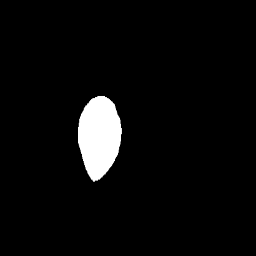

✅ Mask saved successfully at: /content/Disposables/Training_Data/Masks/001_01_nuc.bmp
Extracted 59 polygon points from /content/Koilocytotic/im_Koilocytotic/CROPPED/001_01_cyt.dat


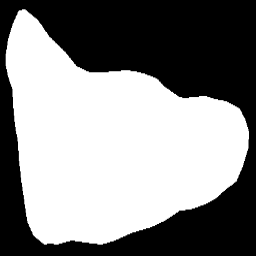

✅ Mask saved successfully at: /content/Disposables/Training_Data/Masks/001_01_cyt.bmp


In [11]:
cropped_img_001_01 = "/content/Koilocytotic/im_Koilocytotic/CROPPED/001_01.bmp"
nuc_dat = f"{cropped_img_001_01[:-4]}_nuc.dat"
cyt_dat = f"{cropped_img_001_01[:-4]}_cyt.dat"

# Define mask save paths
nucleus_mask_path = "/content/Disposables/Training_Data/Masks/001_01_nuc.bmp"
cytoplasm_mask_path = "/content/Disposables/Training_Data/Masks/001_01_cyt.bmp"

# Generate and save masks
create_mask_from_dat(cropped_img_001_01, nuc_dat, nucleus_mask_path)
create_mask_from_dat(cropped_img_001_01, cyt_dat, cytoplasm_mask_path)

In [12]:
from PIL import Image


image_path = "/content/Disposables/Training_Data/Masks/001_01_nuc.bmp"

try:
    # Open the image
    img = Image.open(image_path)

    # Convert the image to a NumPy array (if needed)
    img_array = np.array(img)

    # Now you can work with the image data (img or img_array)
    print(f"Image shape: {img_array.shape}") #print the shape of the array
    print(f"Image mode: {img.mode}") #print the color mode of the image.

    # Example: Display the image (if you have a display environment)
    # img.show()

except FileNotFoundError:
    print(f"Error: Image file not found at {image_path}")
except Exception as e:
    print(f"An error occurred: {e}")

Image shape: (256, 256)
Image mode: L


## 5.1 Counting Cropped Images in Each Cell Type Folder

To ensure the robustness and fairness of my deep learning model, I am counting the number of cropped images in each cell type folder. This step is critical for maintaining a balanced dataset, which directly impacts the model's ability to generalize and perform well across all cell types.

### Why is this important?

1. **Preventing Bias:** If one cell type (e.g., parabasal) has significantly more images than others, the model may become biased toward that cell type. This happens because the model learns to prioritize features associated with the more frequently seen class, leading to poor performance on underrepresented classes.

2. **Proportional Distribution:** Ensuring a proportional distribution of images across all cell types helps the model learn to discriminate between classes equally well. For example, if parabasal cells dominate the dataset, the model might excel at identifying parabasal cells but struggle with other cell types (e.g., superficial or intermediate cells) due to their lower representation.

3. **Balanced Training:** A balanced dataset allows the model to generalize better, improving its ability to correctly classify all cell types during inference, even in real-world scenarios where the distribution of cell types may vary.

### Example Scenario
> If the dataset contains `1,000 parabasal cell` images but only `100 images of another cell type` (e.g., intermediate cells), the model might achieve high accuracy for parabasal cells but perform poorly on intermediate cells. This imbalance could lead to misleadingly high overall accuracy while failing to meet the practical needs of the application.

By counting and balancing the number of cropped images per cell type, I aim to create a more equitable training environment, ensuring the model performs reliably across all classes.



In [13]:
def count_cropped_images(root_directories):
    """
    Counts the number of cropped images in each 'Cropped' folder within the specified root directories.

    Only considering images with names in the format 'xxx_xx.bmp' where both 'xxx' and 'xx' are numbers.

    Args:
        root_directories (list): A list of primary folder directories
                                 (e.g., ["Superficial-Intermediate", "Parabasal", ...]).

    Returns:
        dict: A dictionary with the primary folder name as the key and the number of cropped images as the value.
    """
    cropped_counts = {}
    valid_pattern = re.compile(r"^\d{3}_\d{2}\.bmp$")

    for root_dir in root_directories:
        cropped_folder = os.path.join(root_dir, f"im_{root_dir}", "CROPPED")

        if not os.path.exists(cropped_folder):
            print(f"Skipping {root_dir} - No Cropped folder found.")
            cropped_counts[root_dir] = 0
            continue

        # Count only .bmp images in the Cropped folder
        image_count = len([f for f in os.listdir(cropped_folder) if valid_pattern.match(f)])
        cropped_counts[root_dir] = image_count

    return cropped_counts

In [14]:
cropped_image_counts = count_cropped_images(root_folder_path)

# Print the results
for category, count in cropped_image_counts.items():
    print(f"{category}: {count} cropped images")

Superficial-Intermediate: 831 cropped images
Parabasal: 787 cropped images
Koilocytotic: 825 cropped images
Metaplastic: 793 cropped images
Dyskeratotic: 813 cropped images


In [15]:
print(831+ 787 + 825 + 793 +813)

4049


## 5.2 Confirm All Images Are Cropped

To maintain consistency and accuracy in my dataset, I am verifying that all images have been cropped according to the dimensions specified in the .dat polygon files. This step ensures that each image is properly aligned with the annotated regions of interest, which is crucial for training the deep learning model effectively.

### Why is this important?

1. **Consistency in Data Preprocessing**: Cropping images based on the .dat polygon dimensions ensures that all images are uniformly processed. This consistency is vital for the model to learn meaningful patterns and features from the data.

2. **Accurate Representation of Cell Types**: Proper cropping guarantees that the model focuses on the relevant regions of the images, avoiding unnecessary background noise or irrelevant information. This improves the model's ability to accurately identify and classify cell types.

3. **Validation of Dataset Integrity**: By confirming that all images are cropped, I can ensure the dataset is complete and ready for training. This step also helps identify any potential issues, such as missing or incorrectly cropped images, which could negatively impact model performance.

### Dataset Snapshot Overview

Below is a summary of the current dataset, including the number of cell snapshots and the number of cells in the last snapshot for each cell type:

|Cell type|# cell snapshots|# cells in last snapshot|
|:---|:---|:---:|
|Dyskeratotic|223|03|
|Koilocytotic|238|02|
|Metaplastic|271|04|
|Parabasal|108|03|
|Superficial-Intermediate|126|07|

This table provides a clear overview of the dataset's composition, ensuring transparency and helping to identify any imbalances or inconsistencies that may need addressing before training the model.

In [16]:
dyskeratotic_all_img =os.path.isfile("/content/Dyskeratotic/im_Dyskeratotic/CROPPED/223_03.bmp")
koilocytotic_all_img =os.path.isfile("/content/Koilocytotic/im_Koilocytotic/CROPPED/238_02.bmp")
metaplastic_all_img =os.path.isfile("/content/Metaplastic/im_Metaplastic/CROPPED/271_04.bmp")
parabasal_all_img =os.path.isfile("/content/Parabasal/im_Parabasal/CROPPED/108_03.bmp")
superficial_inter_all_img =os.path.isfile("/content/Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/126_07.bmp")

print(f"""All files in \nDyskeratotic are cropped, {dyskeratotic_all_img}
      \nKoilocytotic are cropped, {koilocytotic_all_img}
      \nMetaplastic are cropped, {metaplastic_all_img}
      \nParabasal are cropped, {parabasal_all_img}
      \nSuperficial-Intermediate are cropped, {superficial_inter_all_img}""")

All files in 
Dyskeratotic are cropped, True
      
Koilocytotic are cropped, True
      
Metaplastic are cropped, True
      
Parabasal are cropped, True
      
Superficial-Intermediate are cropped, True


# 5.3 Organise the data into a balanced dataset

1. Identify the `minority class` and balance all classes by `downsampling the dominant classes`.

2. Ensure proportional distribution across `Training`, `Validation`, and `Test sets`.

3. `Prevent overrepresentation` of any cell type, maintaining equal learning opportunities for the model.

In [17]:
import shutil
import random

def organize_balanced_clean_data(root_directories, clean_data_path="/content/Clean_Data", split_ratio=(0.7, 0.2, 0.1)):
    """
    Organizes images from cropped folders into Clean_Data with a balanced dataset.

    Args:
        root_directories (list): List of primary folder directories (e.g., ["Superficial-Intermediate", "Parabasal", ...]).
        clean_data_path (str): Destination folder for structured data.
        split_ratio (tuple): Train, validation, and test split percentages.

    Ensures:
        - The dataset is **balanced** by limiting the dominant classes to match the minority class.
        - Each dataset type (Training, Validation, Test) gets an equal proportion of images.
    """

    # Create Clean_Data directory and subfolders
    dataset_types = ["Training_Data", "Validation_Data", "Test_Data"]
    for dataset in dataset_types:
        dataset_path = os.path.join(clean_data_path, dataset)
        os.makedirs(os.path.join(dataset_path, "Images"), exist_ok=True)
        os.makedirs(os.path.join(dataset_path, "Masks"), exist_ok=True)

    # Count available cropped images per class
    cropped_counts = count_cropped_images(root_directories)

    # Determine the **minimum** number of images among all cell types (for balancing)
    min_images = min(cropped_counts.values())

    print(f"📊 Balancing dataset to {min_images} images per class to prevent bias.")

    # Store label info
    label_files = {dataset: [] for dataset in dataset_types}

    for root_dir in root_directories:
        cropped_folder = os.path.join(root_dir, f"im_{root_dir}", "CROPPED")

        if not os.path.exists(cropped_folder):
            print(f"⚠️ Skipping {root_dir} - No Cropped folder found.")
            continue

        # Get all images in the Cropped folder, ensuring we only use `xxx_xx.bmp` format
        images = [f for f in os.listdir(cropped_folder) if f.endswith(".bmp") and "_" in f and f.split("_")[0].isdigit()]

        # Randomly sample `min_images` to balance the dataset
        random.shuffle(images)
        balanced_images = images[:min_images]  # Ensures all classes have the same number of images

        # Split dataset
        total = len(balanced_images)
        train_split = int(split_ratio[0] * total)
        val_split = int(split_ratio[1] * total)

        train_files = balanced_images[:train_split]
        val_files = balanced_images[train_split:train_split + val_split]
        test_files = balanced_images[train_split + val_split:]

        # Assign each set to corresponding directory
        dataset_mapping = {
            "Training_Data": train_files,
            "Validation_Data": val_files,
            "Test_Data": test_files
        }

        for dataset, files in dataset_mapping.items():
            dataset_path = os.path.join(clean_data_path, dataset, "Images")
            mask_path = os.path.join(clean_data_path, dataset, "Masks")

            for img in files:
                src_path = os.path.join(cropped_folder, img)
                dst_path = os.path.join(dataset_path, img)
                shutil.copy(src_path, dst_path)  # Copy image to new location

                nuc_dat = src_path.replace(".bmp", "_nuc.dat")
                cyt_dat = src_path.replace(".bmp", "_cyt.dat")
                nuc_mask = os.path.join(mask_path, img.replace(".bmp", "_nuc.bmp"))
                cyt_mask = os.path.join(mask_path, img.replace(".bmp", "_cyt.bmp"))

                create_mask_from_dat(src_path, nuc_dat, nuc_mask)
                create_mask_from_dat(src_path, cyt_dat, cyt_mask)

                # Store label info (format: "image_name label")
                label_files[dataset].append(f"{img} {root_dir}")

    # Write Labels.txt for each dataset
    for dataset in dataset_types:
        label_txt_path = os.path.join(clean_data_path, dataset, "Labels.txt")
        with open(label_txt_path, "w") as f:
            f.write("\n".join(label_files[dataset]))

    print("✅ Data Organization Complete!")

📊 Balancing dataset to 787 images per class to prevent bias.
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/078_04_nuc.dat


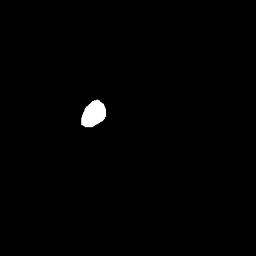

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_04_nuc.bmp
Extracted 91 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/078_04_cyt.dat


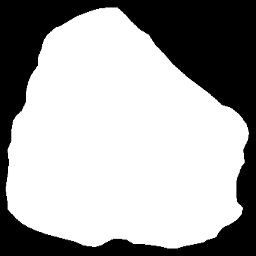

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_04_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_06_nuc.dat


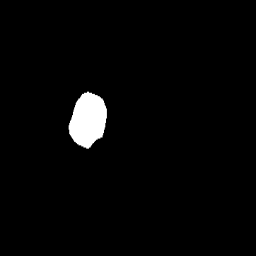

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_06_nuc.bmp
Extracted 37 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_06_cyt.dat


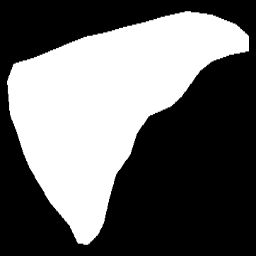

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_06_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/098_08_nuc.dat


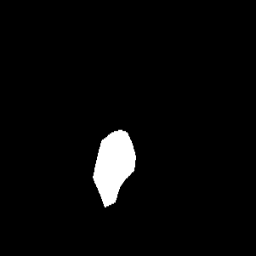

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_08_nuc.bmp
Extracted 40 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/098_08_cyt.dat


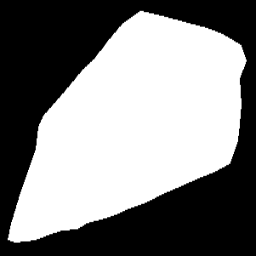

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_08_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/070_04_nuc.dat


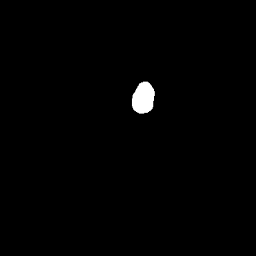

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_04_nuc.bmp
Extracted 60 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/070_04_cyt.dat


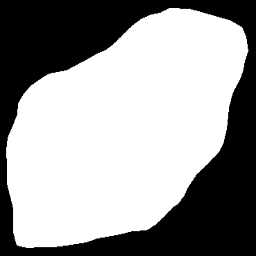

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_04_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/011_01_nuc.dat


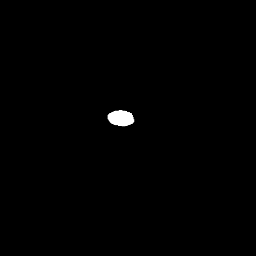

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_01_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/011_01_cyt.dat


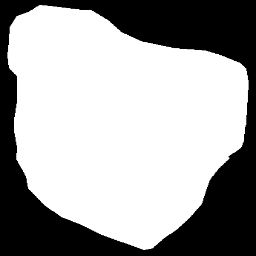

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_01_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_09_nuc.dat


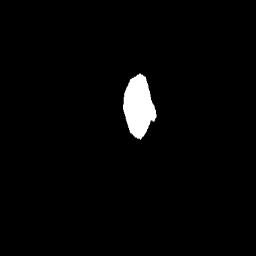

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_09_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_09_cyt.dat


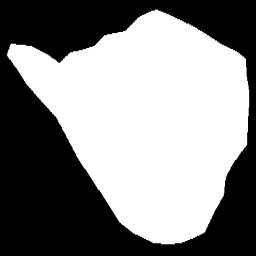

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_09_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/081_06_nuc.dat


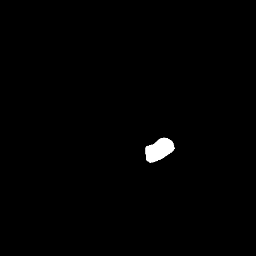

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_06_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/081_06_cyt.dat


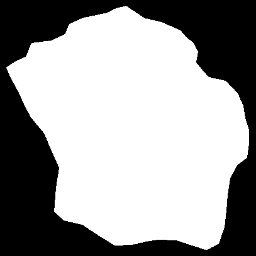

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_06_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/024_03_nuc.dat


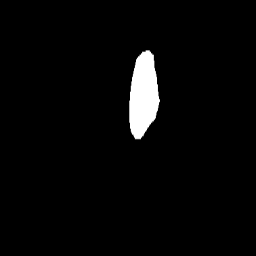

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/024_03_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/024_03_cyt.dat


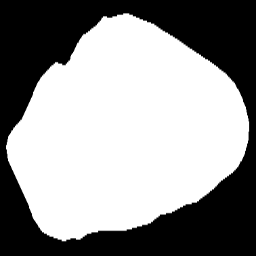

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/024_03_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_07_nuc.dat


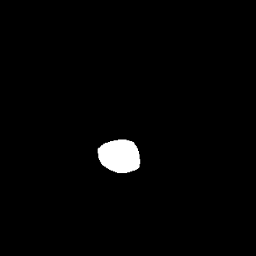

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_07_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_07_cyt.dat


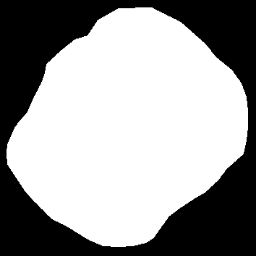

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_07_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_07_nuc.dat


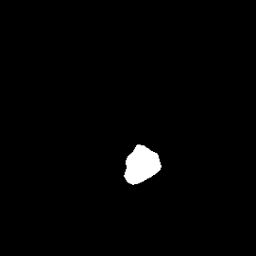

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/029_07_nuc.bmp
Extracted 74 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_07_cyt.dat


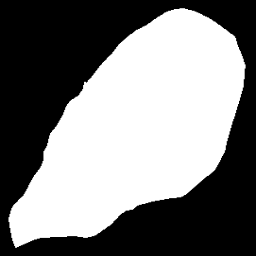

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/029_07_cyt.bmp
Extracted 34 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/031_03_nuc.dat


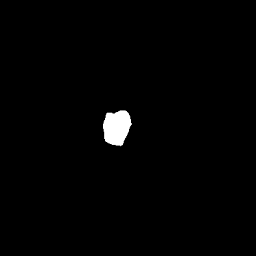

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/031_03_nuc.bmp
Extracted 122 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/031_03_cyt.dat


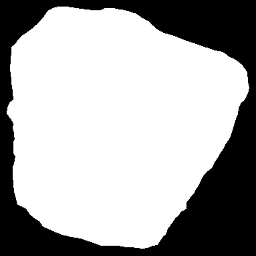

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/031_03_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_02_nuc.dat


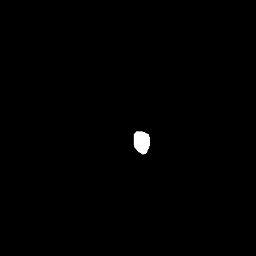

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_02_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_02_cyt.dat


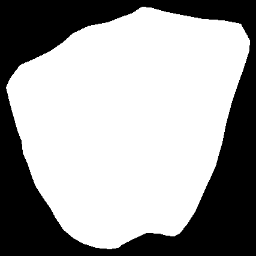

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_02_cyt.bmp
Extracted 26 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/044_01_nuc.dat


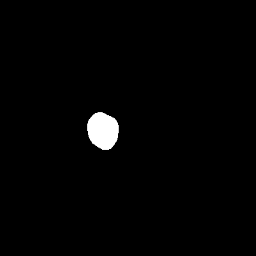

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_01_nuc.bmp
Extracted 103 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/044_01_cyt.dat


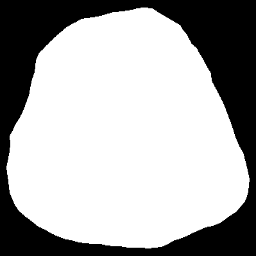

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_01_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_07_nuc.dat


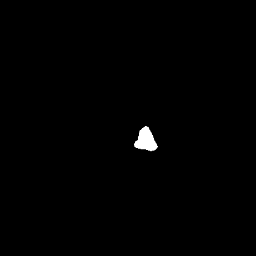

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_07_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_07_cyt.dat


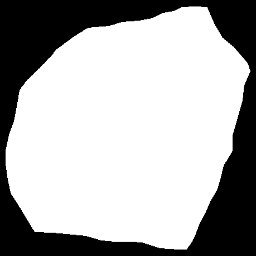

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_07_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_08_nuc.dat


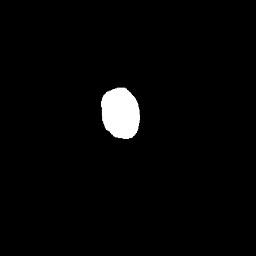

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_08_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_08_cyt.dat


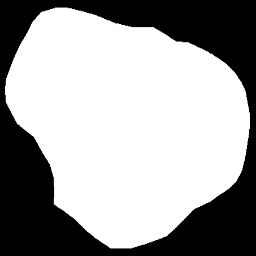

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_08_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_11_nuc.dat


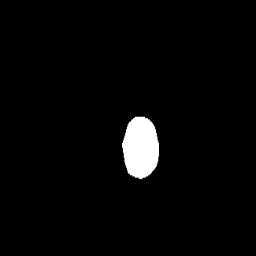

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_11_nuc.bmp
Extracted 76 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_11_cyt.dat


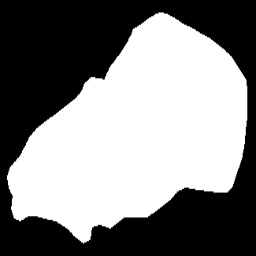

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_11_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_09_nuc.dat


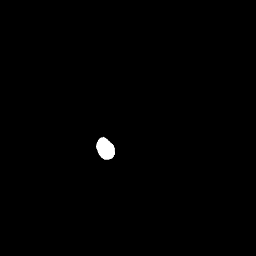

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_09_nuc.bmp
Extracted 68 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_09_cyt.dat


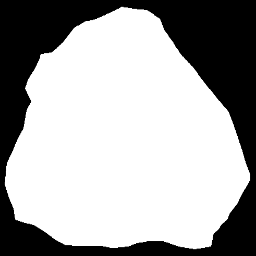

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_09_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/125_03_nuc.dat


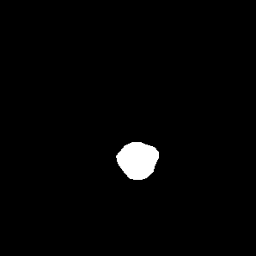

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/125_03_nuc.bmp
Extracted 45 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/125_03_cyt.dat


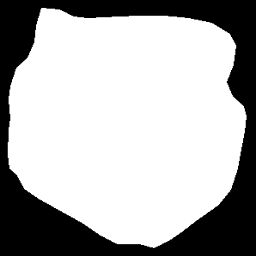

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/125_03_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/081_02_nuc.dat


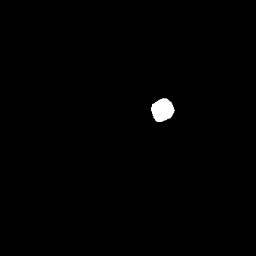

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_02_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/081_02_cyt.dat


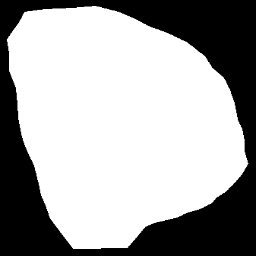

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_02_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_03_nuc.dat


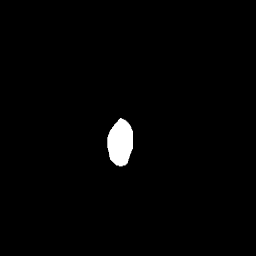

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/122_03_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_03_cyt.dat


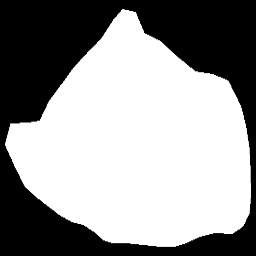

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/122_03_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/070_02_nuc.dat


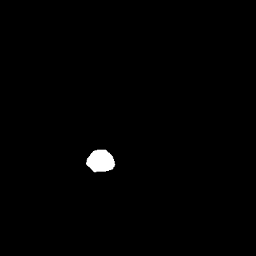

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_02_nuc.bmp
Extracted 66 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/070_02_cyt.dat


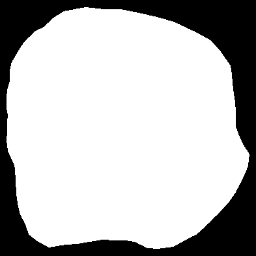

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_02_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_03_nuc.dat


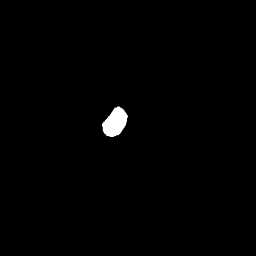

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_03_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_03_cyt.dat


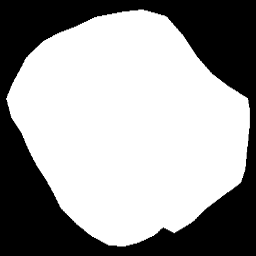

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_03_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_02_nuc.dat


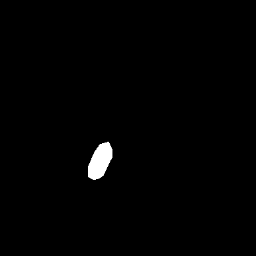

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_02_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_02_cyt.dat


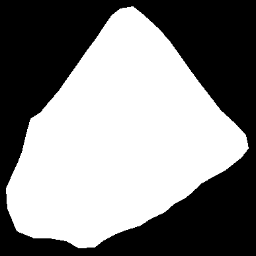

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_02_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/053_05_nuc.dat


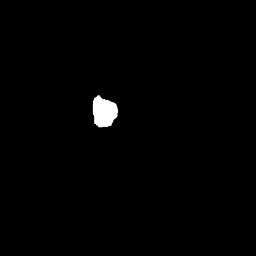

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_05_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/053_05_cyt.dat


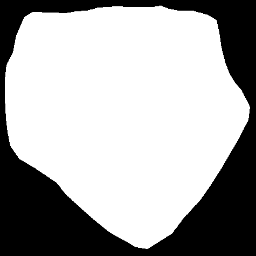

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_05_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_06_nuc.dat


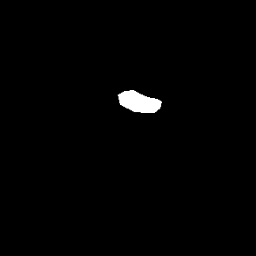

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_06_nuc.bmp
Extracted 45 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_06_cyt.dat


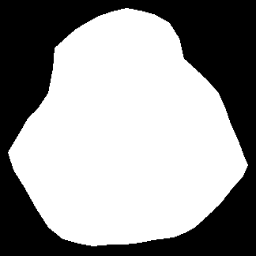

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_06_cyt.bmp
Extracted 31 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_07_nuc.dat


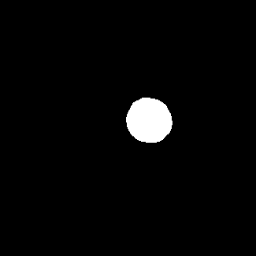

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_07_nuc.bmp
Extracted 109 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_07_cyt.dat


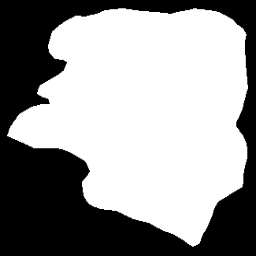

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_07_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/123_06_nuc.dat


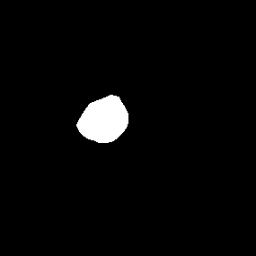

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_06_nuc.bmp
Extracted 36 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/123_06_cyt.dat


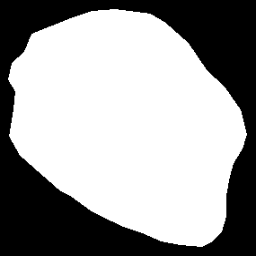

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_06_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_08_nuc.dat


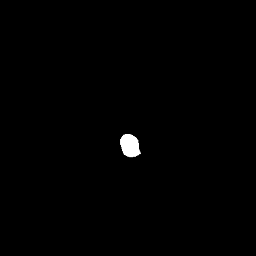

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_08_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_08_cyt.dat


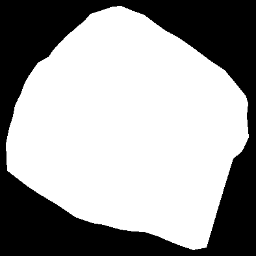

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_08_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/098_09_nuc.dat


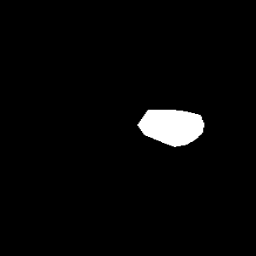

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_09_nuc.bmp
Extracted 45 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/098_09_cyt.dat


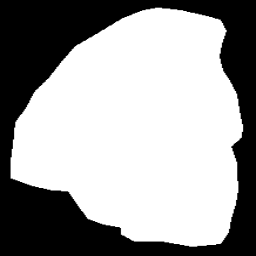

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_09_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/002_01_nuc.dat


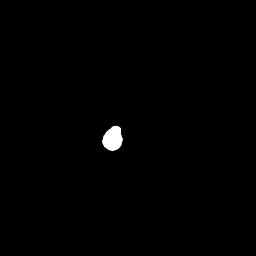

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/002_01_nuc.bmp
Extracted 70 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/002_01_cyt.dat


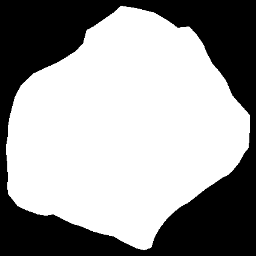

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/002_01_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_07_nuc.dat


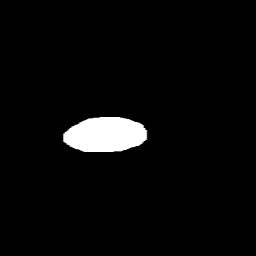

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_07_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_07_cyt.dat


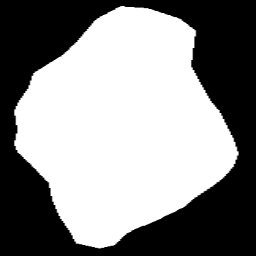

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_07_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/059_04_nuc.dat


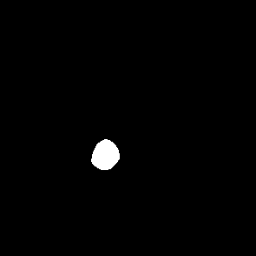

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/059_04_nuc.bmp
Extracted 74 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/059_04_cyt.dat


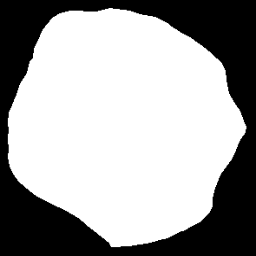

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/059_04_cyt.bmp
Extracted 29 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/018_01_nuc.dat


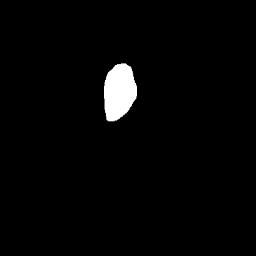

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_01_nuc.bmp
Extracted 84 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/018_01_cyt.dat


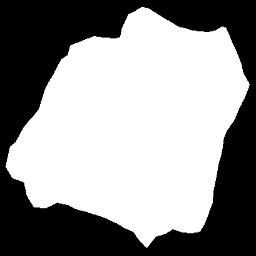

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_01_cyt.bmp
Extracted 33 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_04_nuc.dat


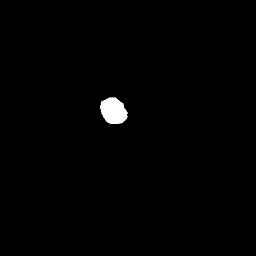

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_04_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_04_cyt.dat


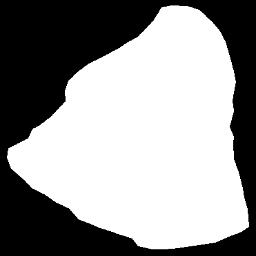

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_04_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/102_06_nuc.dat


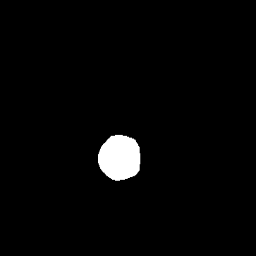

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_06_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/102_06_cyt.dat


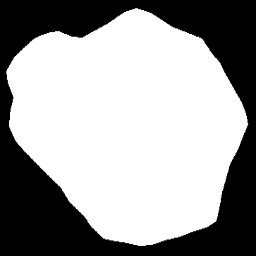

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_06_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/103_06_nuc.dat


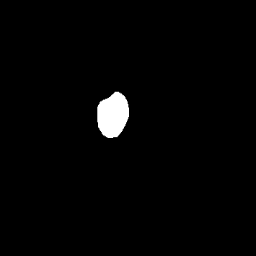

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/103_06_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/103_06_cyt.dat


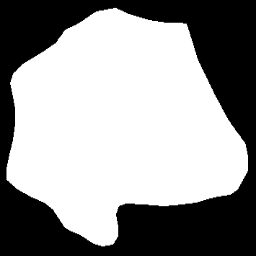

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/103_06_cyt.bmp
Extracted 28 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_06_nuc.dat


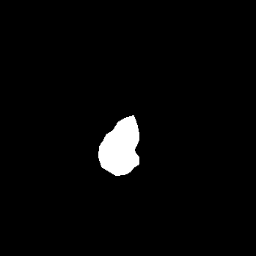

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_06_nuc.bmp
Extracted 90 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_06_cyt.dat


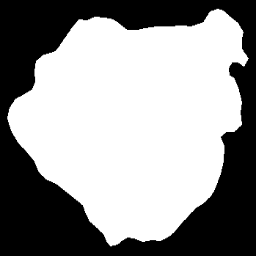

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_06_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/034_01_nuc.dat


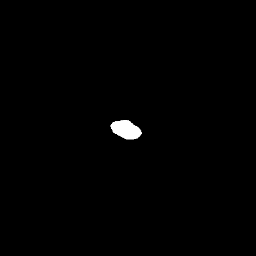

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_01_nuc.bmp
Extracted 72 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/034_01_cyt.dat


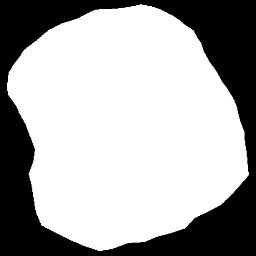

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_01_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/124_03_nuc.dat


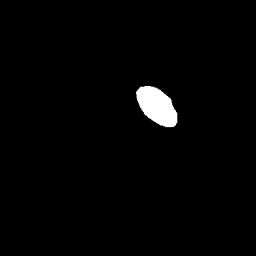

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/124_03_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/124_03_cyt.dat


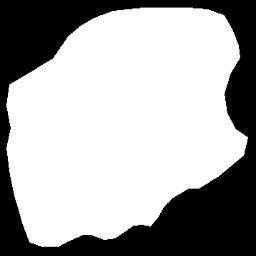

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/124_03_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_05_nuc.dat


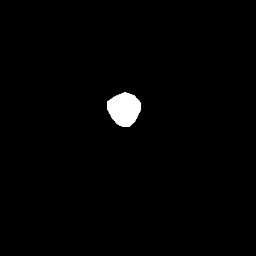

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_05_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_05_cyt.dat


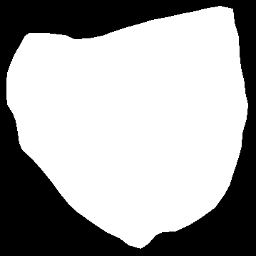

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_05_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/098_07_nuc.dat


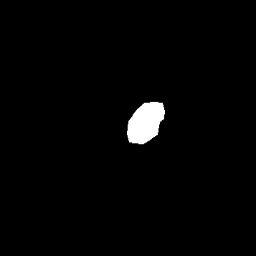

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_07_nuc.bmp
Extracted 42 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/098_07_cyt.dat


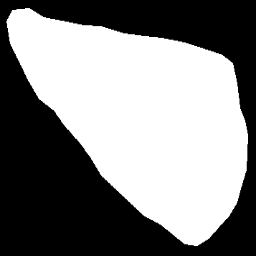

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_07_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/108_07_nuc.dat


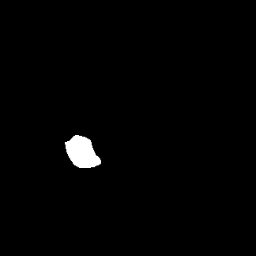

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_07_nuc.bmp
Extracted 37 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/108_07_cyt.dat


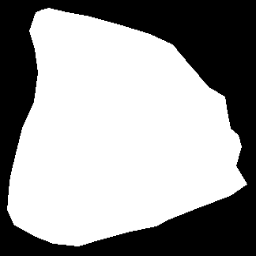

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_07_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/109_02_nuc.dat


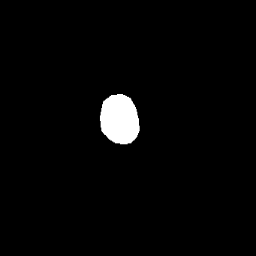

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/109_02_nuc.bmp
Extracted 42 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/109_02_cyt.dat


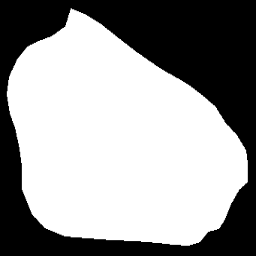

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/109_02_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_04_nuc.dat


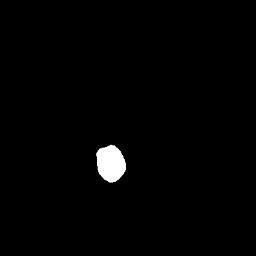

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_04_nuc.bmp
Extracted 76 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_04_cyt.dat


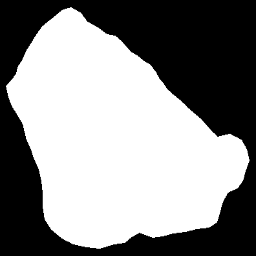

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_04_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/110_02_nuc.dat


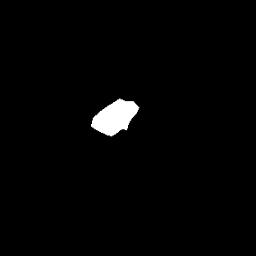

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/110_02_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/110_02_cyt.dat


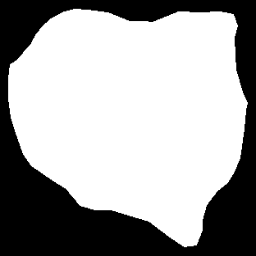

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/110_02_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_12_nuc.dat


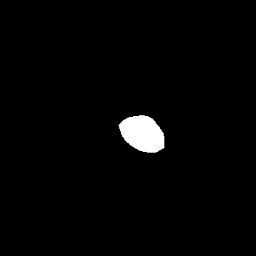

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_12_nuc.bmp
Extracted 82 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_12_cyt.dat


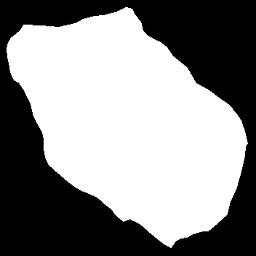

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_12_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/072_05_nuc.dat


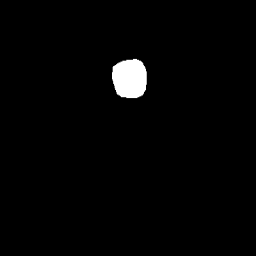

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_05_nuc.bmp
Extracted 61 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/072_05_cyt.dat


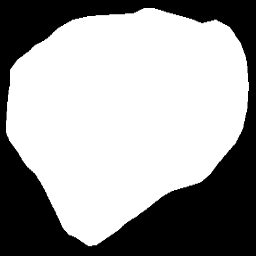

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_05_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/085_03_nuc.dat


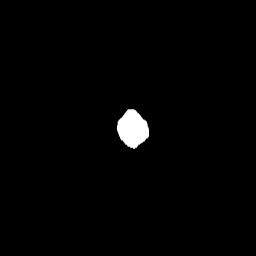

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/085_03_nuc.bmp
Extracted 41 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/085_03_cyt.dat


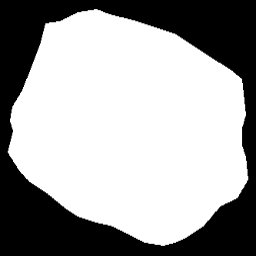

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/085_03_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/060_04_nuc.dat


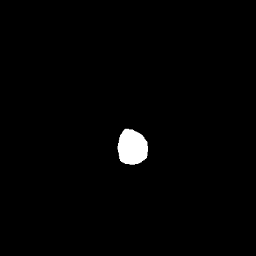

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_04_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/060_04_cyt.dat


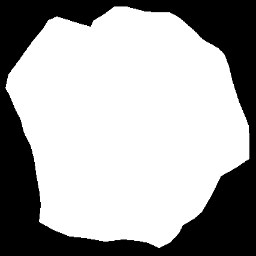

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_04_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/015_02_nuc.dat


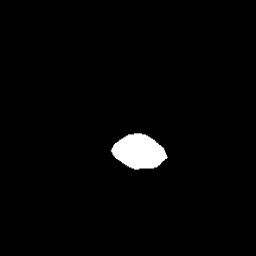

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_02_nuc.bmp
Extracted 66 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/015_02_cyt.dat


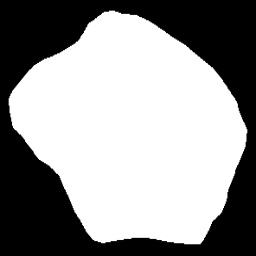

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_02_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/116_05_nuc.dat


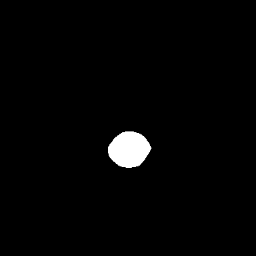

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/116_05_nuc.bmp
Extracted 31 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/116_05_cyt.dat


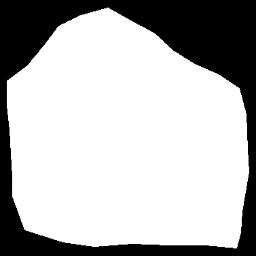

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/116_05_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_06_nuc.dat


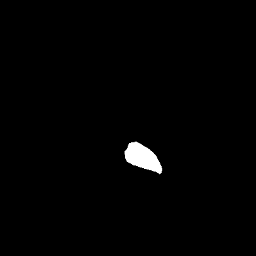

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_06_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_06_cyt.dat


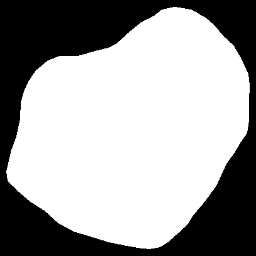

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_06_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/002_05_nuc.dat


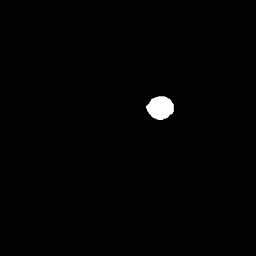

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/002_05_nuc.bmp
Extracted 85 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/002_05_cyt.dat


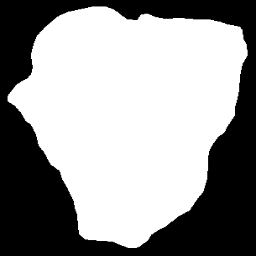

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/002_05_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/073_05_nuc.dat


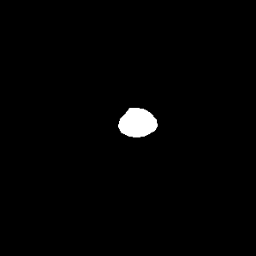

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/073_05_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/073_05_cyt.dat


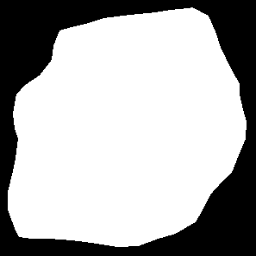

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/073_05_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_10_nuc.dat


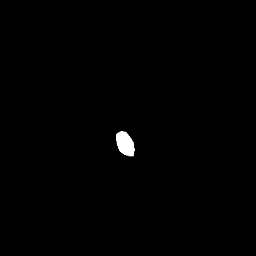

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_10_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_10_cyt.dat


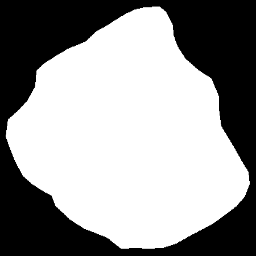

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_10_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_07_nuc.dat


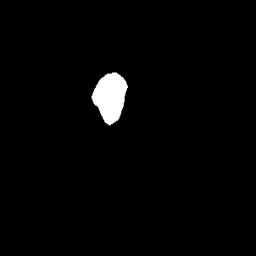

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/119_07_nuc.bmp
Extracted 32 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_07_cyt.dat


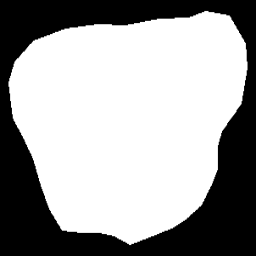

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/119_07_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/036_05_nuc.dat


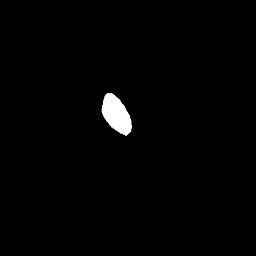

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/036_05_nuc.bmp
Extracted 94 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/036_05_cyt.dat


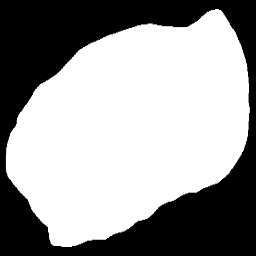

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/036_05_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/100_02_nuc.dat


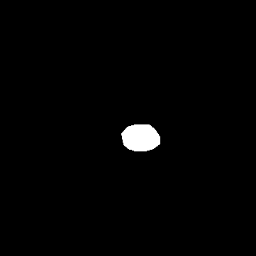

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_02_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/100_02_cyt.dat


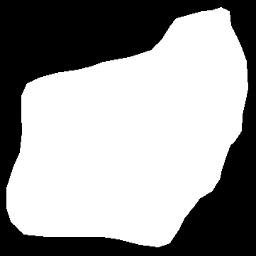

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_02_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_07_nuc.dat


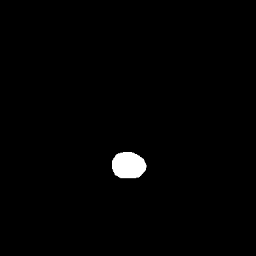

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_07_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_07_cyt.dat


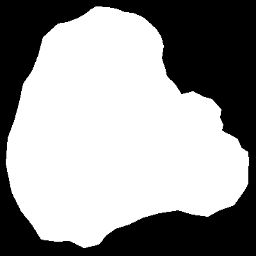

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_07_cyt.bmp
Extracted 30 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_04_nuc.dat


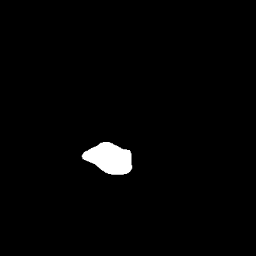

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/029_04_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_04_cyt.dat


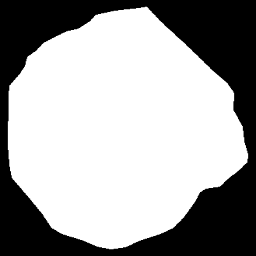

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/029_04_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_04_nuc.dat


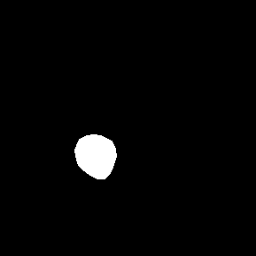

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_04_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_04_cyt.dat


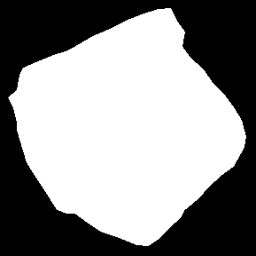

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_04_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/092_01_nuc.dat


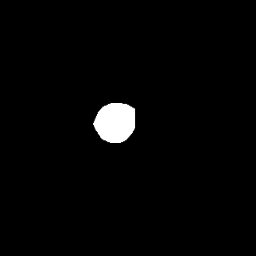

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/092_01_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/092_01_cyt.dat


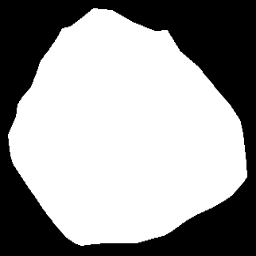

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/092_01_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_08_nuc.dat


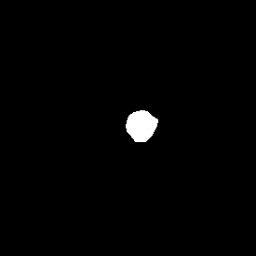

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_08_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_08_cyt.dat


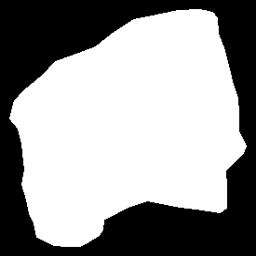

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_08_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_13_nuc.dat


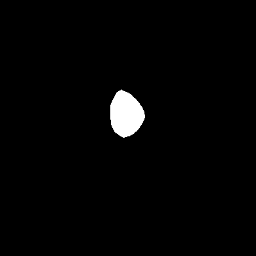

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_13_nuc.bmp
Extracted 45 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_13_cyt.dat


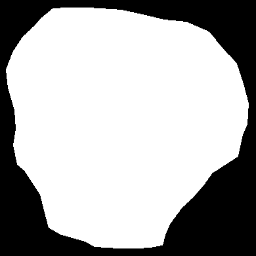

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_13_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_19_nuc.dat


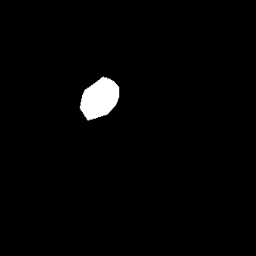

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_19_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_19_cyt.dat


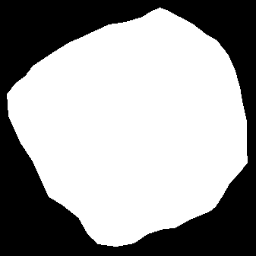

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_19_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_01_nuc.dat


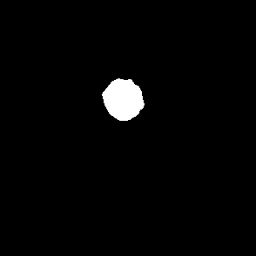

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/119_01_nuc.bmp
Extracted 38 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_01_cyt.dat


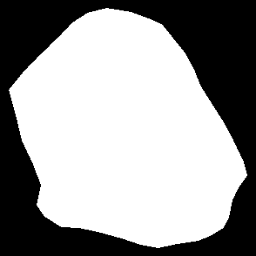

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/119_01_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_03_nuc.dat


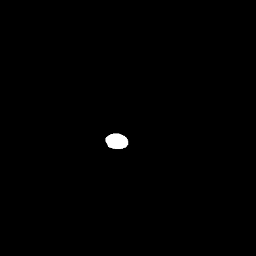

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_03_nuc.bmp
Extracted 78 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_03_cyt.dat


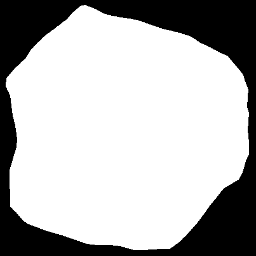

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_03_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/123_03_nuc.dat


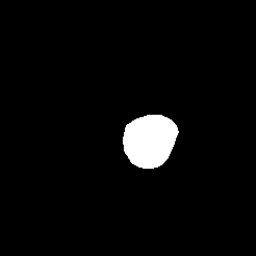

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_03_nuc.bmp
Extracted 47 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/123_03_cyt.dat


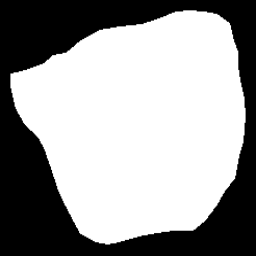

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_03_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/081_04_nuc.dat


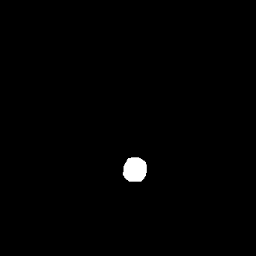

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_04_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/081_04_cyt.dat


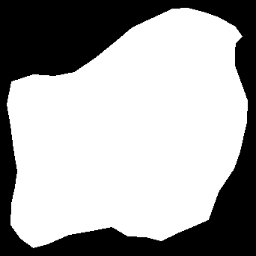

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_04_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_08_nuc.dat


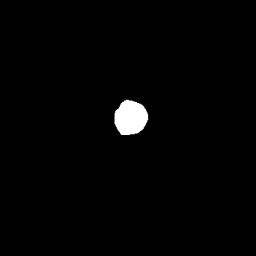

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_08_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_08_cyt.dat


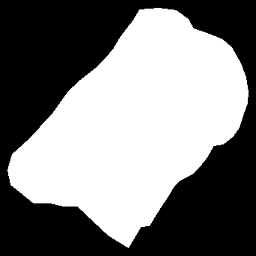

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_08_cyt.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_01_nuc.dat


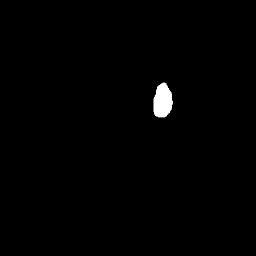

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_01_nuc.bmp
Extracted 139 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_01_cyt.dat


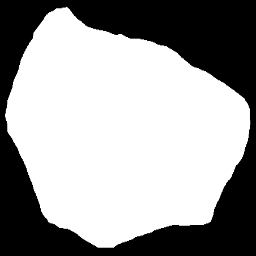

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_01_cyt.bmp
Extracted 32 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_01_nuc.dat


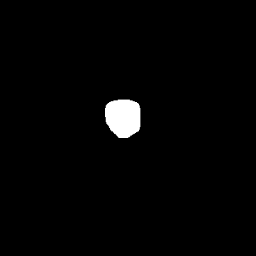

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_01_nuc.bmp
Extracted 100 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_01_cyt.dat


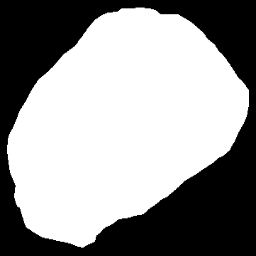

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_01_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_02_nuc.dat


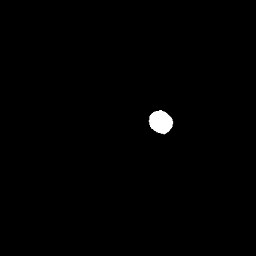

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_02_nuc.bmp
Extracted 104 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_02_cyt.dat


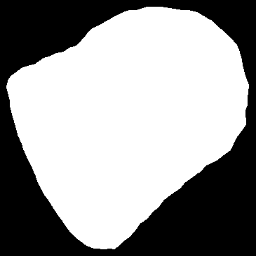

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_02_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_07_nuc.dat


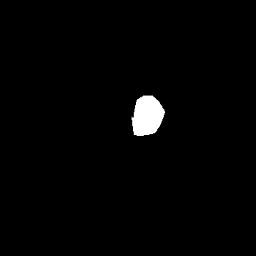

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/061_07_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_07_cyt.dat


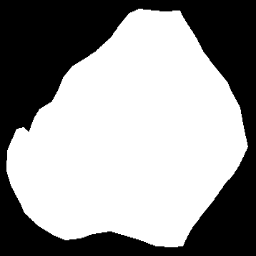

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/061_07_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_08_nuc.dat


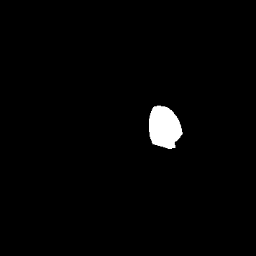

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/061_08_nuc.bmp
Extracted 47 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_08_cyt.dat


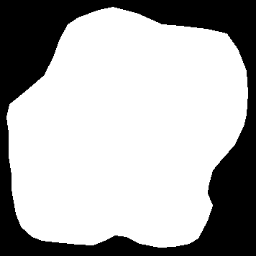

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/061_08_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/114_01_nuc.dat


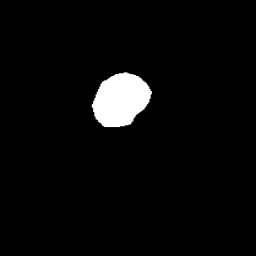

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/114_01_nuc.bmp
Extracted 36 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/114_01_cyt.dat


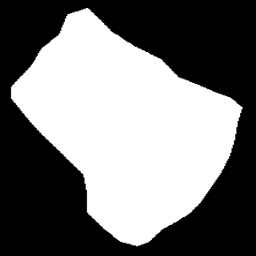

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/114_01_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_04_nuc.dat


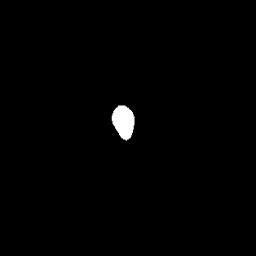

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_04_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_04_cyt.dat


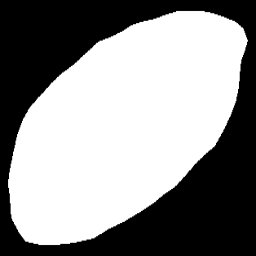

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_04_cyt.bmp
Extracted 34 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/001_03_nuc.dat


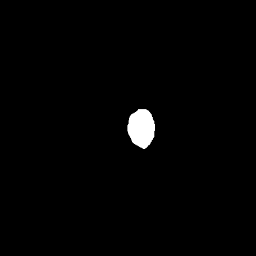

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_03_nuc.bmp
Extracted 69 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/001_03_cyt.dat


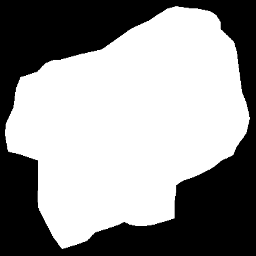

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_03_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/092_02_nuc.dat


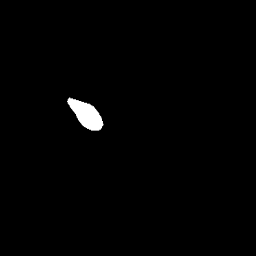

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/092_02_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/092_02_cyt.dat


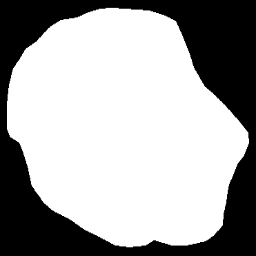

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/092_02_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_05_nuc.dat


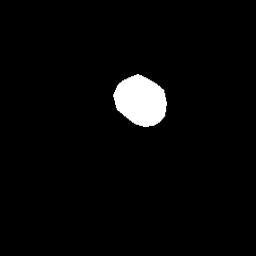

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_05_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_05_cyt.dat


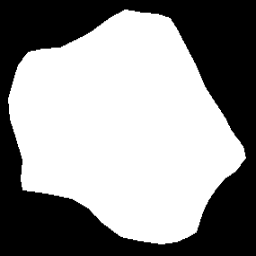

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_05_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/063_01_nuc.dat


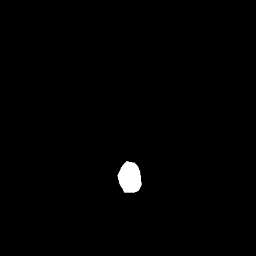

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_01_nuc.bmp
Extracted 69 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/063_01_cyt.dat


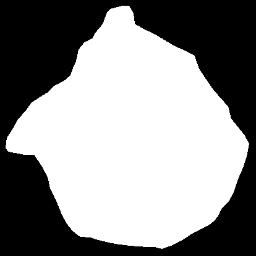

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_01_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/056_06_nuc.dat


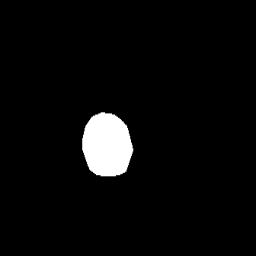

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_06_nuc.bmp
Extracted 70 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/056_06_cyt.dat


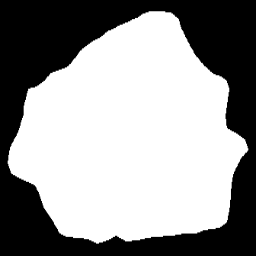

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_06_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/121_04_nuc.dat


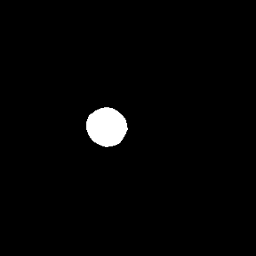

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/121_04_nuc.bmp
Extracted 65 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/121_04_cyt.dat


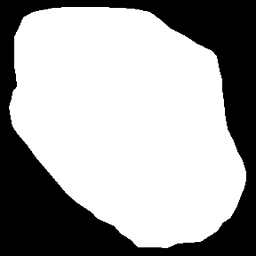

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/121_04_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/065_05_nuc.dat


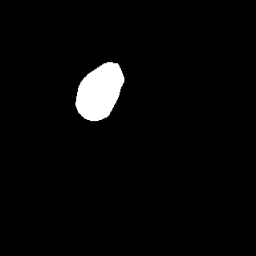

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/065_05_nuc.bmp
Extracted 73 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/065_05_cyt.dat


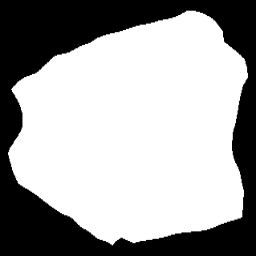

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/065_05_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_05_nuc.dat


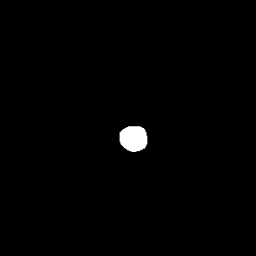

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_05_nuc.bmp
Extracted 85 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_05_cyt.dat


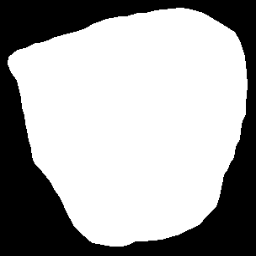

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_05_cyt.bmp
Extracted 26 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_01_nuc.dat


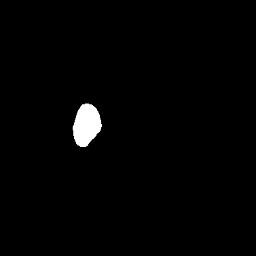

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_01_nuc.bmp
Extracted 60 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_01_cyt.dat


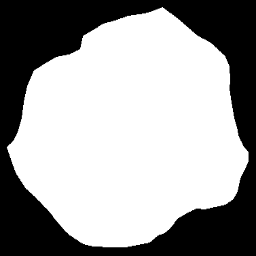

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_01_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_06_nuc.dat


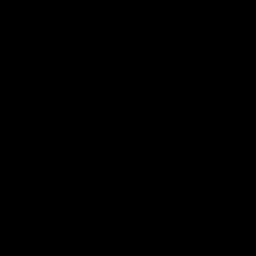

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_06_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_06_cyt.dat


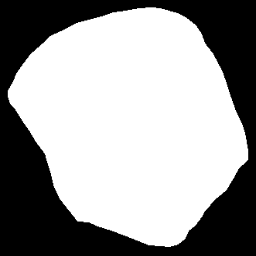

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_06_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/047_05_nuc.dat


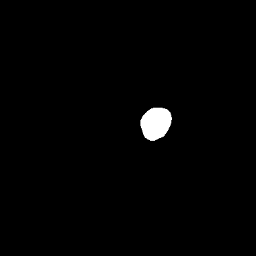

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_05_nuc.bmp
Extracted 83 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/047_05_cyt.dat


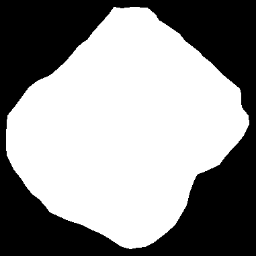

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_05_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_07_nuc.dat


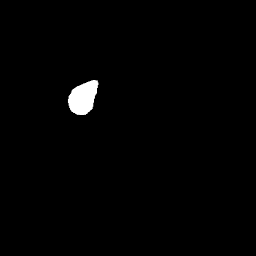

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_07_nuc.bmp
Extracted 70 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_07_cyt.dat


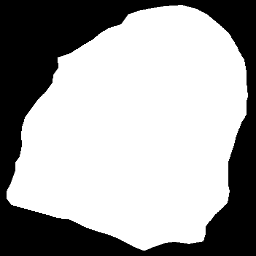

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_07_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_04_nuc.dat


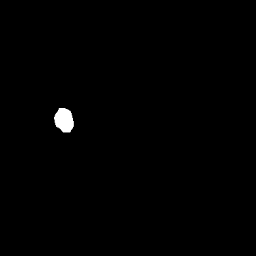

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_04_nuc.bmp
Extracted 97 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_04_cyt.dat


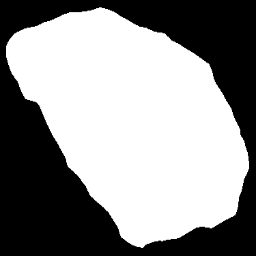

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_04_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/058_04_nuc.dat


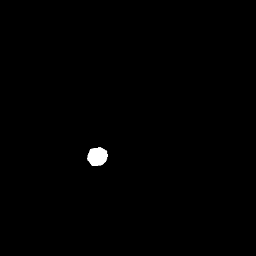

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_04_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/058_04_cyt.dat


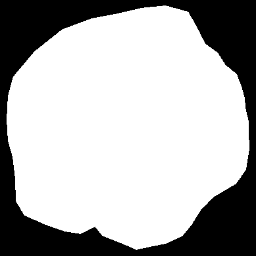

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_04_cyt.bmp
Extracted 27 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_01_nuc.dat


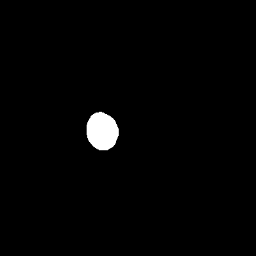

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_01_nuc.bmp
Extracted 88 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_01_cyt.dat


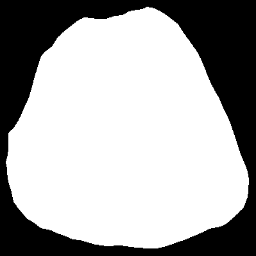

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_01_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_10_nuc.dat


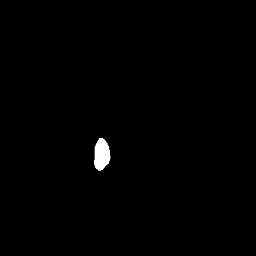

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_10_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_10_cyt.dat


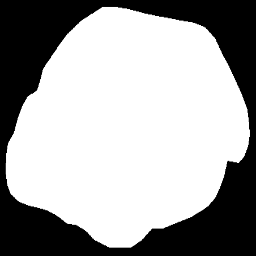

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_10_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/064_04_nuc.dat


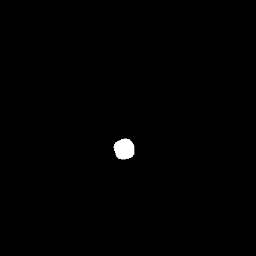

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_04_nuc.bmp
Extracted 84 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/064_04_cyt.dat


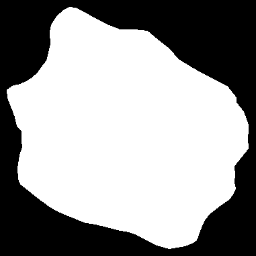

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_04_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/113_06_nuc.dat


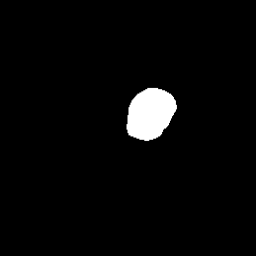

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/113_06_nuc.bmp
Extracted 40 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/113_06_cyt.dat


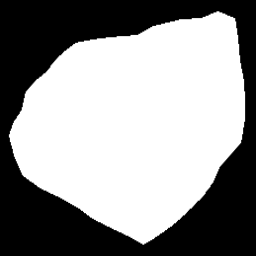

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/113_06_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_12_nuc.dat


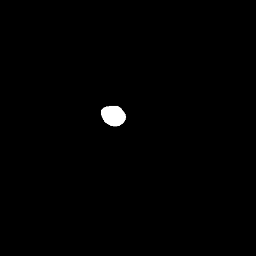

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_12_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_12_cyt.dat


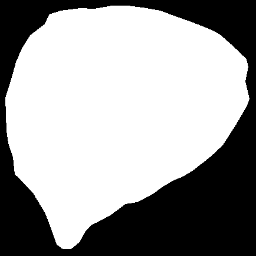

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_12_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/060_03_nuc.dat


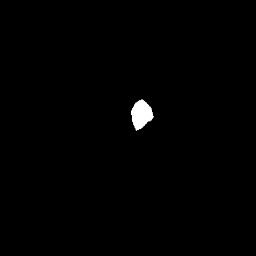

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_03_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/060_03_cyt.dat


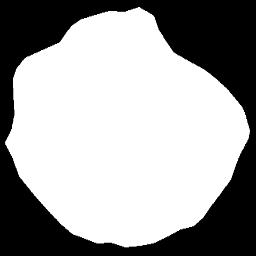

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_03_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/060_01_nuc.dat


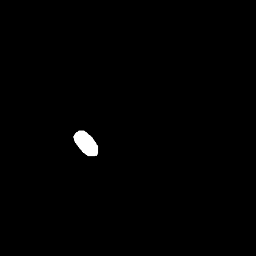

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_01_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/060_01_cyt.dat


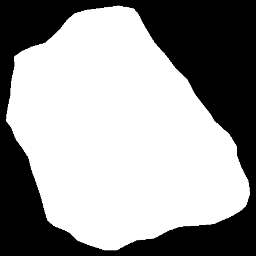

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/044_04_nuc.dat


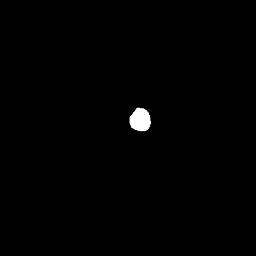

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_04_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/044_04_cyt.dat


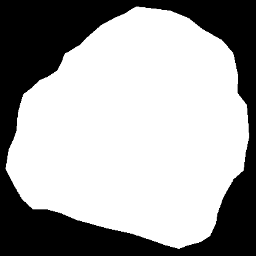

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_04_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/114_05_nuc.dat


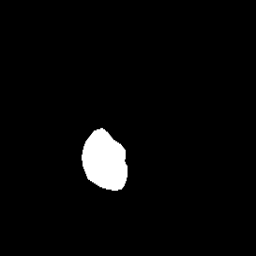

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/114_05_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/114_05_cyt.dat


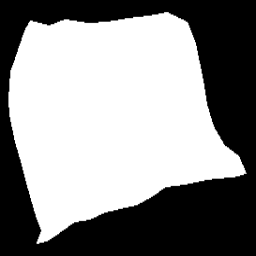

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/114_05_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_04_nuc.dat


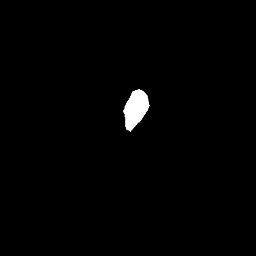

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_04_nuc.bmp
Extracted 58 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_04_cyt.dat


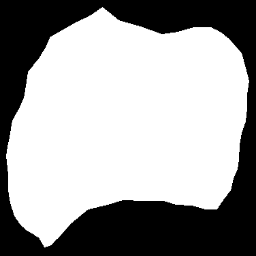

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_04_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/071_01_nuc.dat


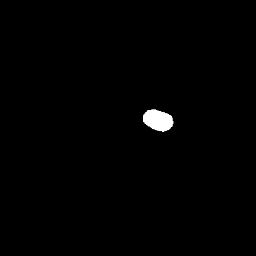

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_01_nuc.bmp
Extracted 68 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/071_01_cyt.dat


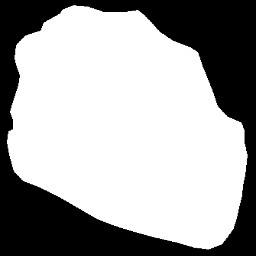

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_01_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/043_07_nuc.dat


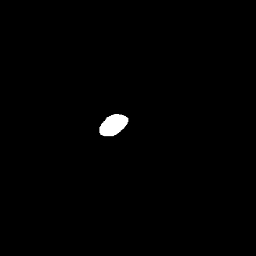

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_07_nuc.bmp
Extracted 64 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/043_07_cyt.dat


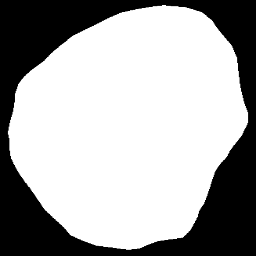

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_07_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/027_03_nuc.dat


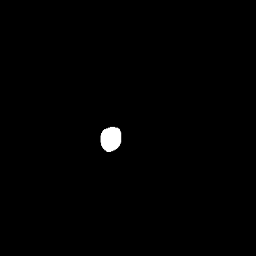

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_03_nuc.bmp
Extracted 81 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/027_03_cyt.dat


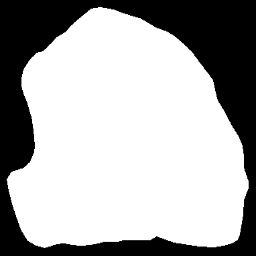

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_03_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/078_06_nuc.dat


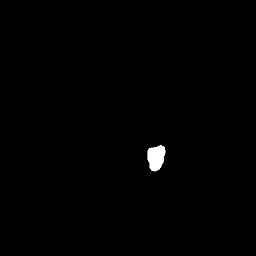

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_06_nuc.bmp
Extracted 58 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/078_06_cyt.dat


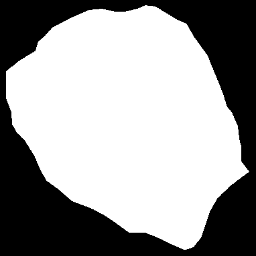

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_06_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/043_01_nuc.dat


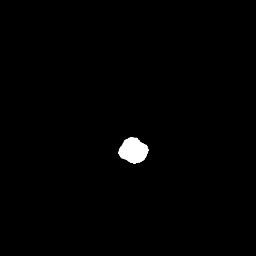

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_01_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/043_01_cyt.dat


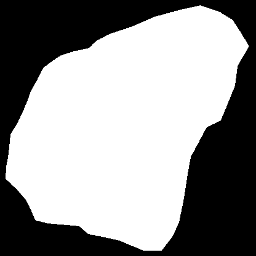

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_01_cyt.bmp
Extracted 40 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_10_nuc.dat


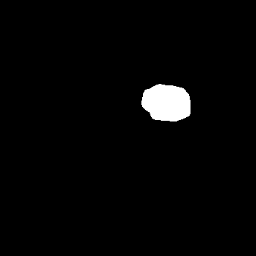

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/029_10_nuc.bmp
Extracted 88 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_10_cyt.dat


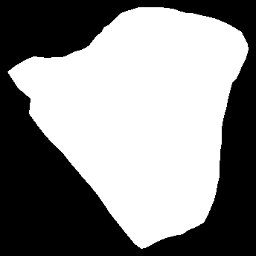

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/029_10_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_10_nuc.dat


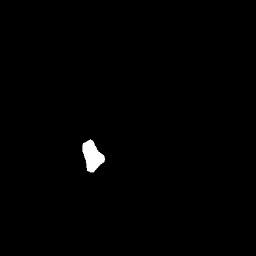

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_10_nuc.bmp
Extracted 85 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_10_cyt.dat


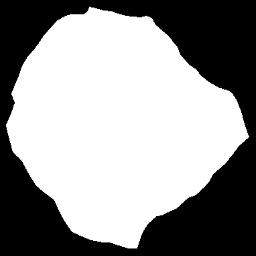

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_10_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/116_03_nuc.dat


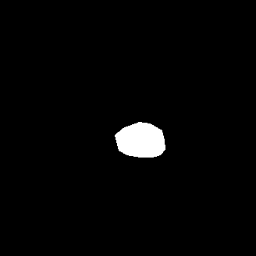

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/116_03_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/116_03_cyt.dat


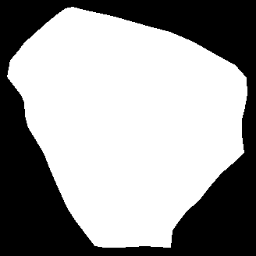

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/116_03_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/113_04_nuc.dat


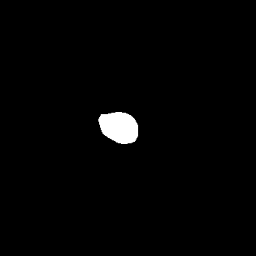

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/113_04_nuc.bmp
Extracted 32 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/113_04_cyt.dat


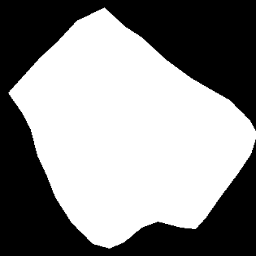

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/113_04_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/120_01_nuc.dat


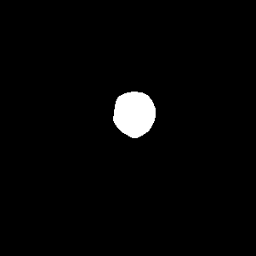

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/120_01_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/120_01_cyt.dat


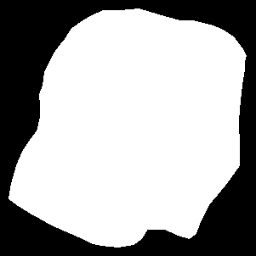

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/120_01_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/043_05_nuc.dat


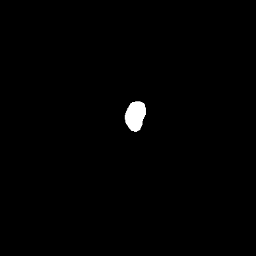

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_05_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/043_05_cyt.dat


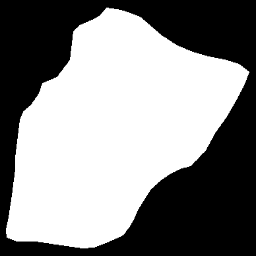

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_05_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_03_nuc.dat


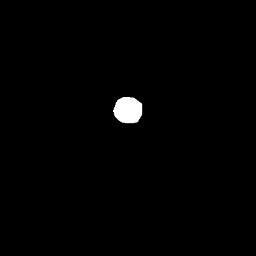

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_03_nuc.bmp
Extracted 45 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_03_cyt.dat


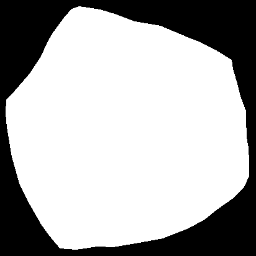

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_03_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/044_03_nuc.dat


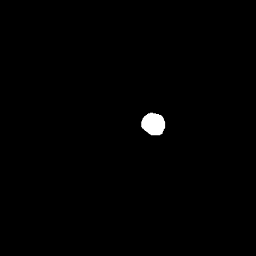

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_03_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/044_03_cyt.dat


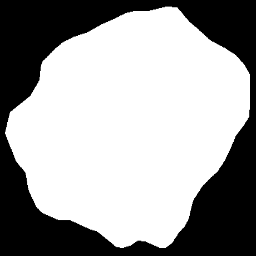

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_03_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/112_02_nuc.dat


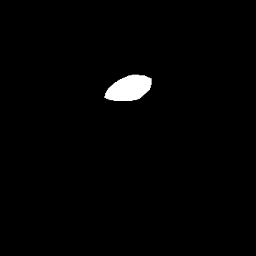

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/112_02_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/112_02_cyt.dat


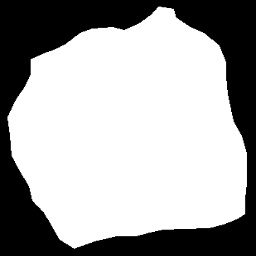

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/112_02_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/048_03_nuc.dat


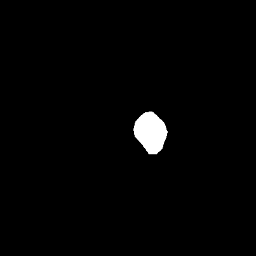

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_03_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/048_03_cyt.dat


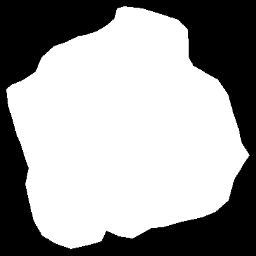

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_03_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/035_06_nuc.dat


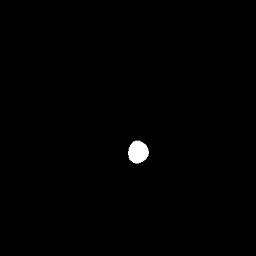

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/035_06_nuc.bmp
Extracted 67 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/035_06_cyt.dat


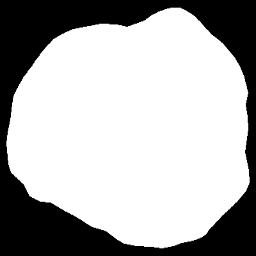

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/035_06_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/112_07_nuc.dat


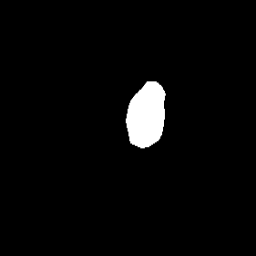

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/112_07_nuc.bmp
Extracted 33 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/112_07_cyt.dat


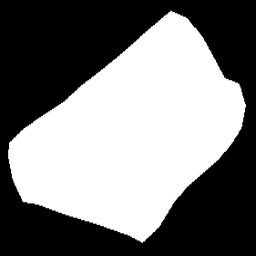

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/112_07_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/049_03_nuc.dat


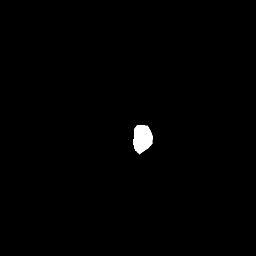

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_03_nuc.bmp
Extracted 69 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/049_03_cyt.dat


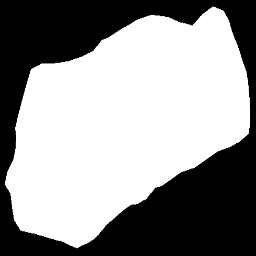

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_03_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/053_01_nuc.dat


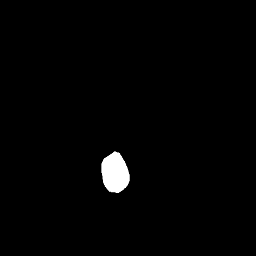

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_01_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/053_01_cyt.dat


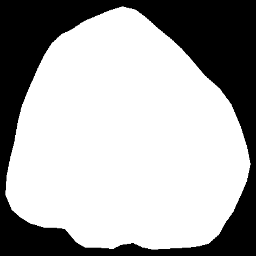

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_01_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/062_02_nuc.dat


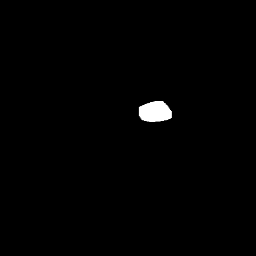

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_02_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/062_02_cyt.dat


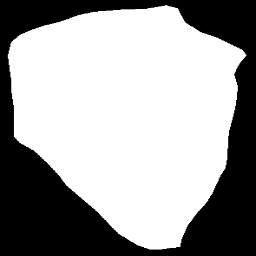

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_02_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/015_01_nuc.dat


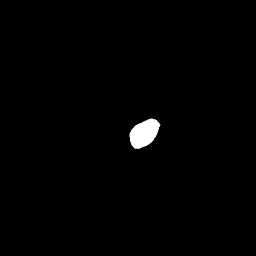

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_01_nuc.bmp
Extracted 81 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/015_01_cyt.dat


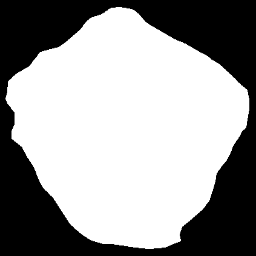

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_01_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/107_06_nuc.dat


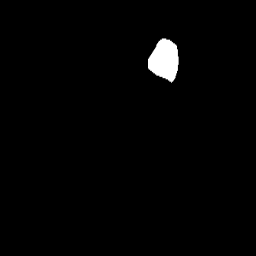

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_06_nuc.bmp
Extracted 68 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/107_06_cyt.dat


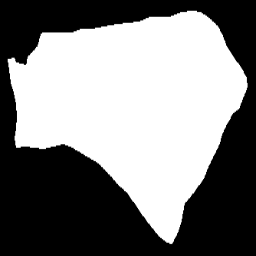

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_06_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/085_02_nuc.dat


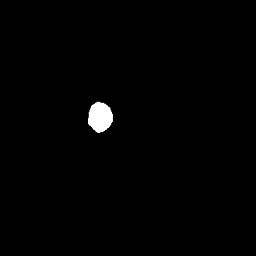

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/085_02_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/085_02_cyt.dat


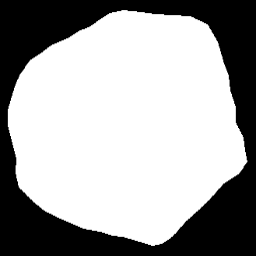

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/085_02_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_06_nuc.dat


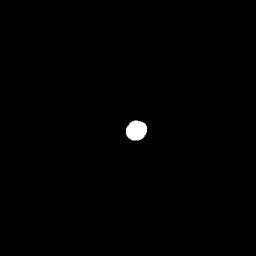

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_06_nuc.bmp
Extracted 103 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_06_cyt.dat


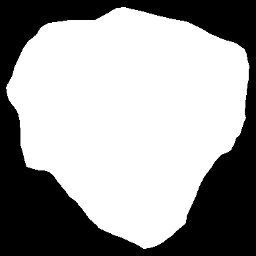

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_06_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/025_02_nuc.dat


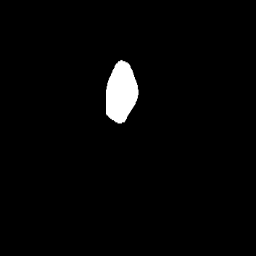

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_02_nuc.bmp
Extracted 66 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/025_02_cyt.dat


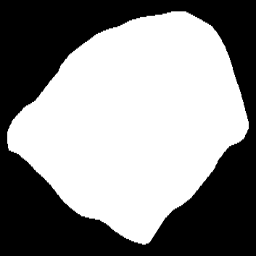

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_02_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_03_nuc.dat


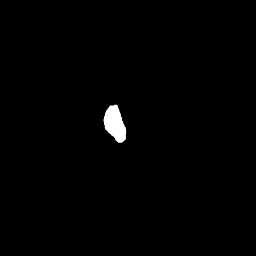

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_03_nuc.bmp
Extracted 65 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_03_cyt.dat


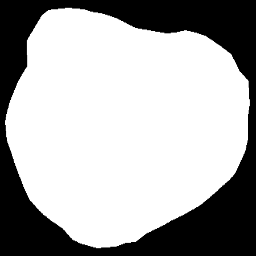

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_03_cyt.bmp
Extracted 27 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/034_05_nuc.dat


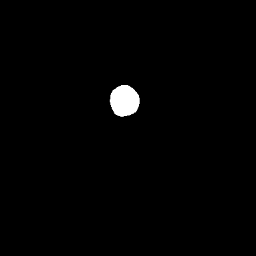

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_05_nuc.bmp
Extracted 77 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/034_05_cyt.dat


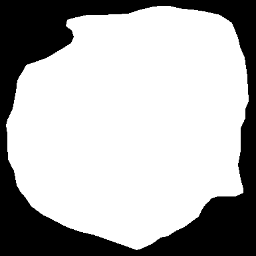

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_05_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/041_04_nuc.dat


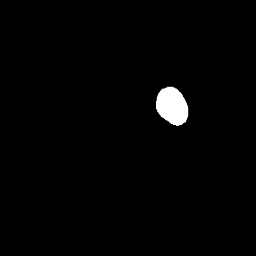

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/041_04_nuc.bmp
Extracted 82 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/041_04_cyt.dat


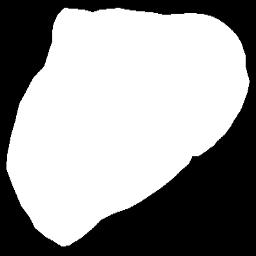

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/041_04_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_05_nuc.dat


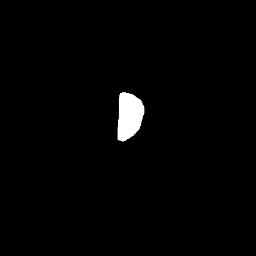

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_05_nuc.bmp
Extracted 96 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_05_cyt.dat


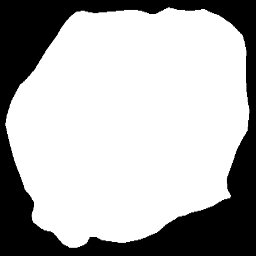

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_05_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/123_04_nuc.dat


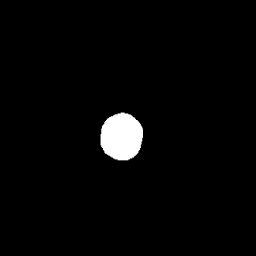

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_04_nuc.bmp
Extracted 37 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/123_04_cyt.dat


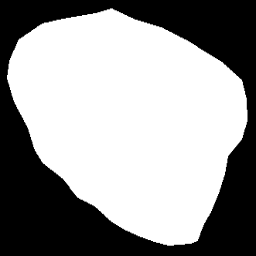

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_04_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_05_nuc.dat


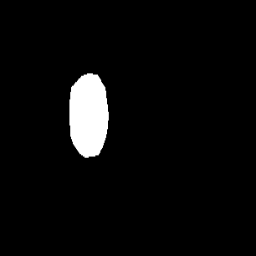

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_05_nuc.bmp
Extracted 45 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_05_cyt.dat


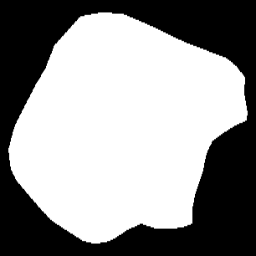

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_05_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_08_nuc.dat


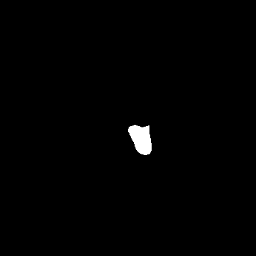

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_08_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_08_cyt.dat


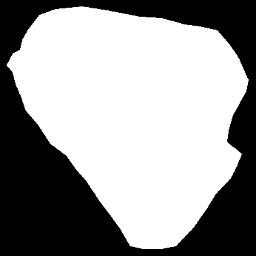

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_08_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_02_nuc.dat


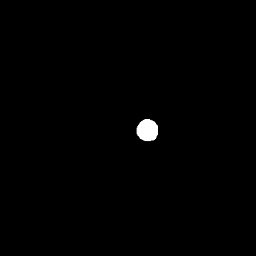

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/061_02_nuc.bmp
Extracted 82 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_02_cyt.dat


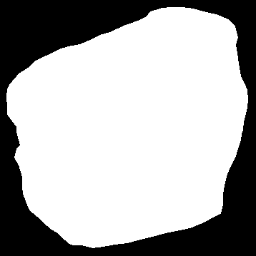

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/061_02_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_16_nuc.dat


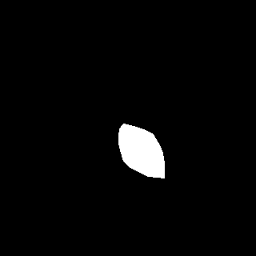

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_16_nuc.bmp
Extracted 78 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_16_cyt.dat


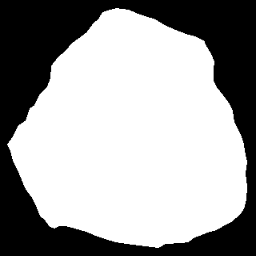

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_16_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/042_03_nuc.dat


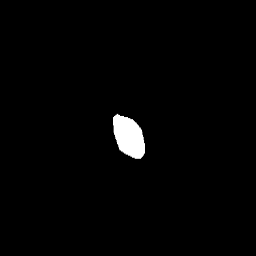

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_03_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/042_03_cyt.dat


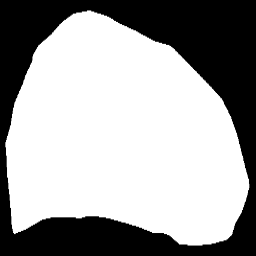

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_03_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/035_03_nuc.dat


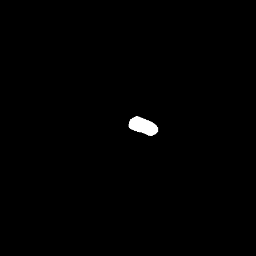

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/035_03_nuc.bmp
Extracted 68 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/035_03_cyt.dat


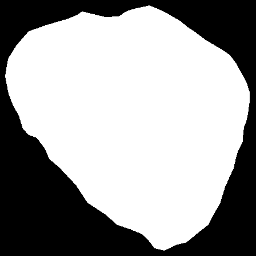

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/035_03_cyt.bmp
Extracted 42 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/030_05_nuc.dat


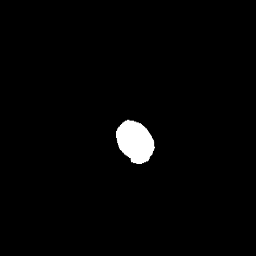

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/030_05_nuc.bmp
Extracted 110 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/030_05_cyt.dat


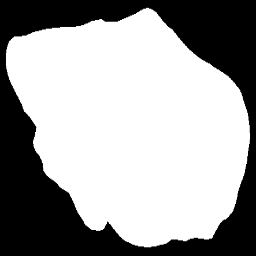

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/030_05_cyt.bmp
Extracted 28 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/005_01_nuc.dat


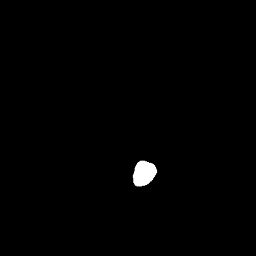

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_01_nuc.bmp
Extracted 58 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/005_01_cyt.dat


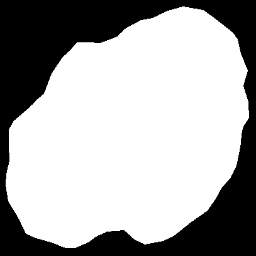

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_01_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/042_01_nuc.dat


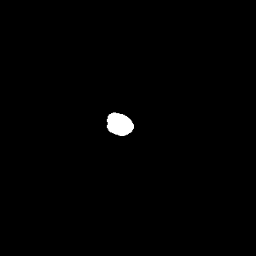

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_01_nuc.bmp
Extracted 65 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/042_01_cyt.dat


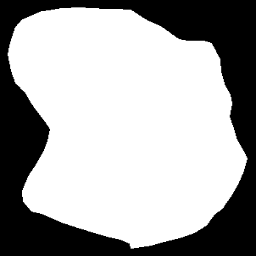

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_01_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/100_06_nuc.dat


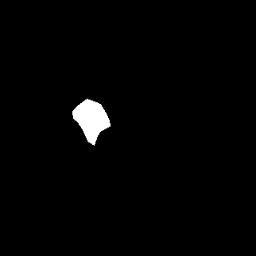

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_06_nuc.bmp
Extracted 91 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/100_06_cyt.dat


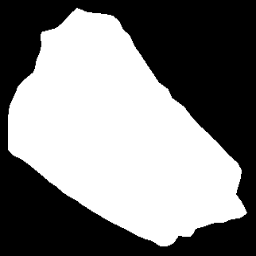

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_06_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/093_03_nuc.dat


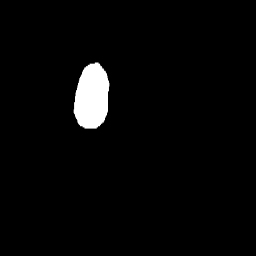

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_03_nuc.bmp
Extracted 33 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/093_03_cyt.dat


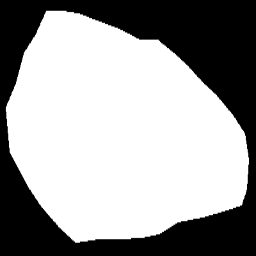

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_03_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/033_01_nuc.dat


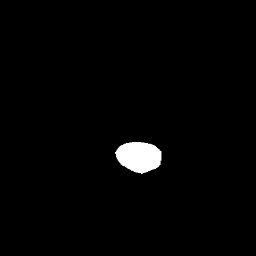

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/033_01_nuc.bmp
Extracted 68 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/033_01_cyt.dat


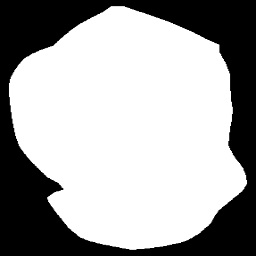

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/033_01_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_09_nuc.dat


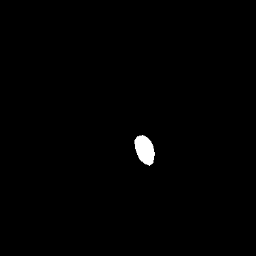

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_09_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_09_cyt.dat


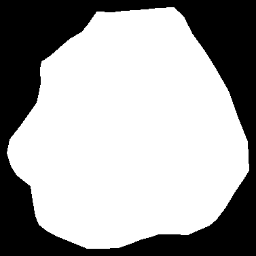

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_09_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_02_nuc.dat


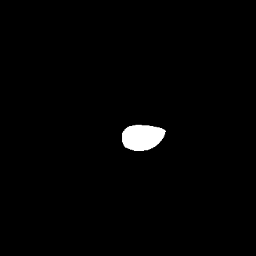

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_02_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_02_cyt.dat


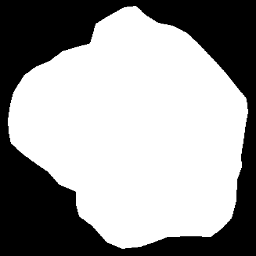

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_02_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_05_nuc.dat


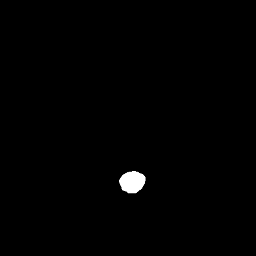

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_05_nuc.bmp
Extracted 64 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_05_cyt.dat


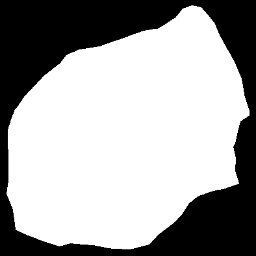

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_05_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_02_nuc.dat


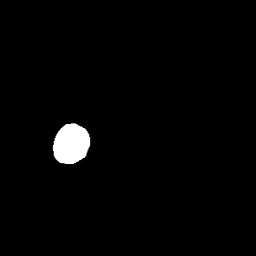

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_02_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_02_cyt.dat


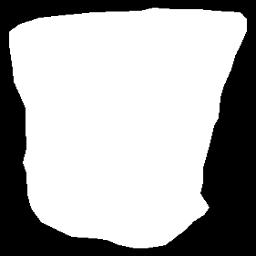

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_02_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_03_nuc.dat


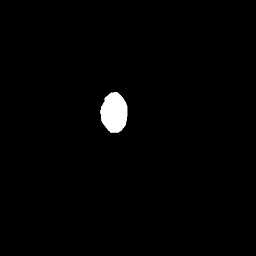

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_03_nuc.bmp
Extracted 65 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_03_cyt.dat


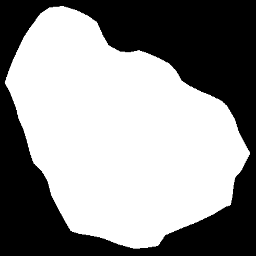

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_03_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/025_01_nuc.dat


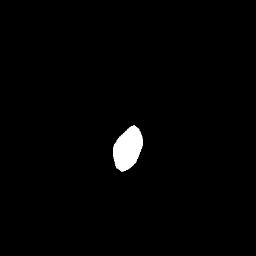

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_01_nuc.bmp
Extracted 81 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/025_01_cyt.dat


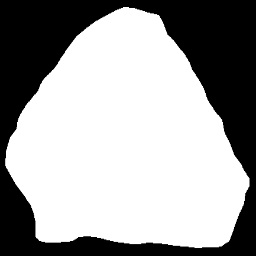

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_01_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_05_nuc.dat


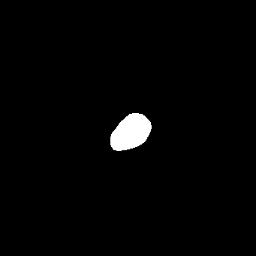

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/122_05_nuc.bmp
Extracted 37 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_05_cyt.dat


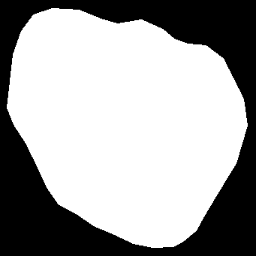

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/122_05_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/124_04_nuc.dat


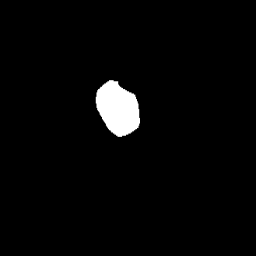

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/124_04_nuc.bmp
Extracted 60 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/124_04_cyt.dat


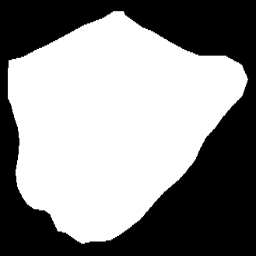

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/124_04_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_03_nuc.dat


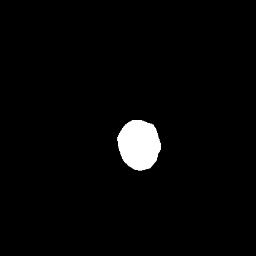

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_03_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_03_cyt.dat


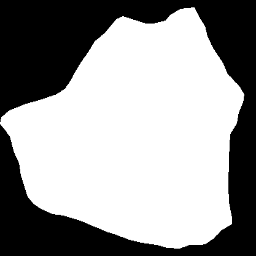

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_03_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/043_02_nuc.dat


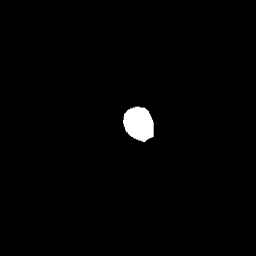

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_02_nuc.bmp
Extracted 69 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/043_02_cyt.dat


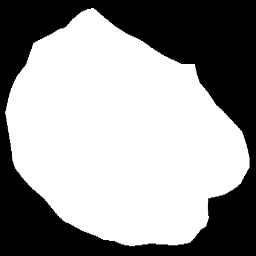

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_02_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_06_nuc.dat


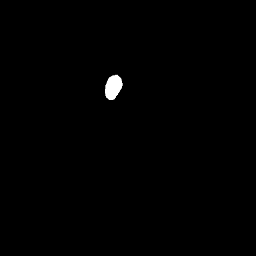

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_06_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_06_cyt.dat


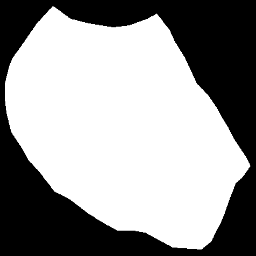

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_06_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_08_nuc.dat


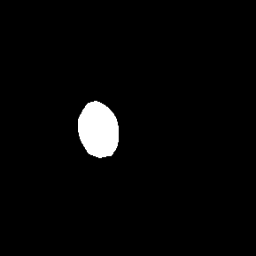

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_08_nuc.bmp
Extracted 65 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_08_cyt.dat


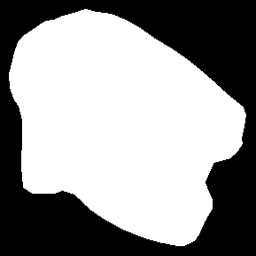

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_08_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_04_nuc.dat


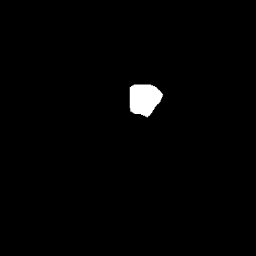

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_04_nuc.bmp
Extracted 41 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_04_cyt.dat


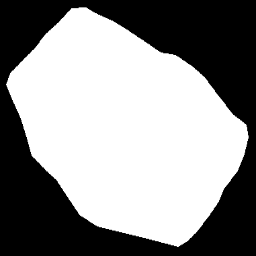

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_04_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/065_03_nuc.dat


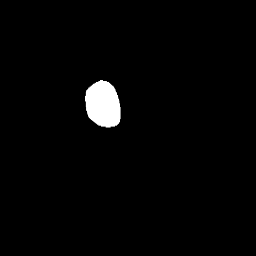

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/065_03_nuc.bmp
Extracted 70 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/065_03_cyt.dat


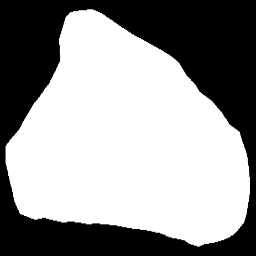

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/065_03_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_06_nuc.dat


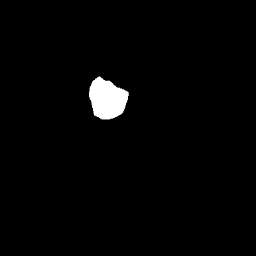

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/122_06_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_06_cyt.dat


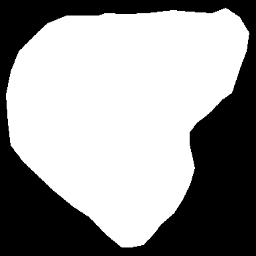

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/122_06_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/071_02_nuc.dat


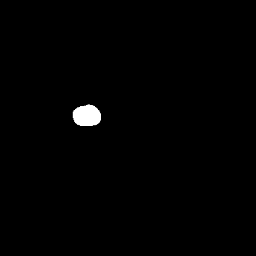

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_02_nuc.bmp
Extracted 67 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/071_02_cyt.dat


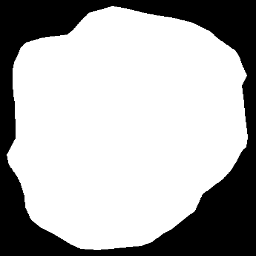

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_02_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/109_03_nuc.dat


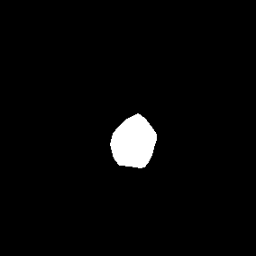

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/109_03_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/109_03_cyt.dat


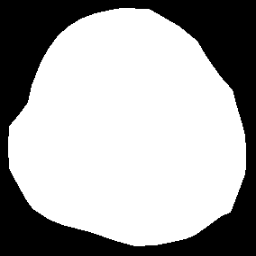

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/109_03_cyt.bmp
Extracted 26 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/050_02_nuc.dat


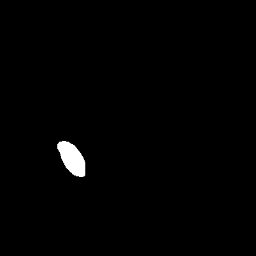

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_02_nuc.bmp
Extracted 60 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/050_02_cyt.dat


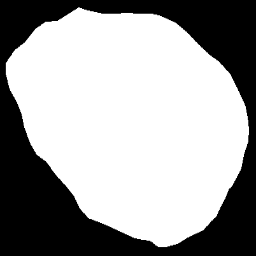

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_02_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_02_nuc.dat


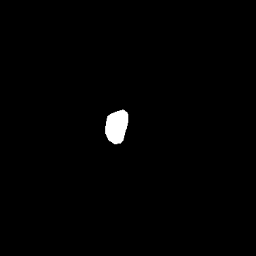

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_02_nuc.bmp
Extracted 47 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_02_cyt.dat


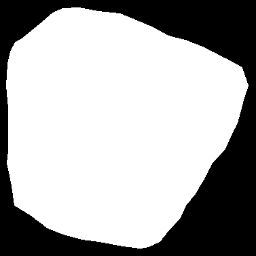

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_02_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_10_nuc.dat


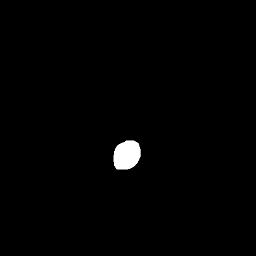

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_10_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_10_cyt.dat


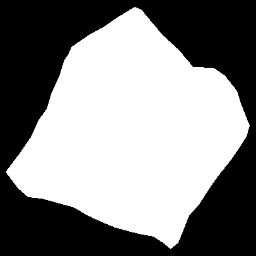

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_10_cyt.bmp
Extracted 30 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/034_04_nuc.dat


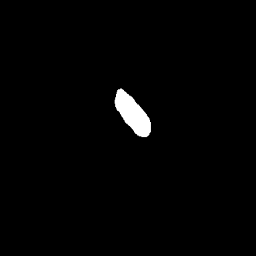

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_04_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/034_04_cyt.dat


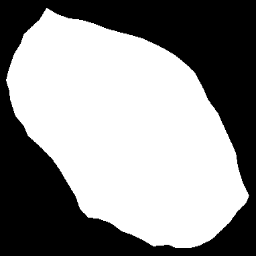

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_04_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/089_01_nuc.dat


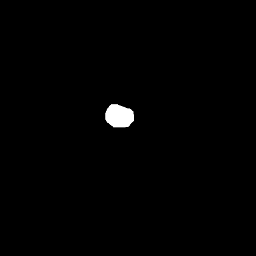

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_01_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/089_01_cyt.dat


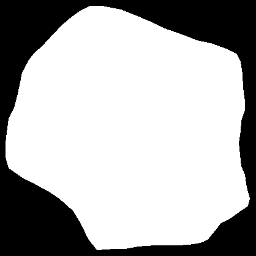

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_01_cyt.bmp
Extracted 31 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_10_nuc.dat


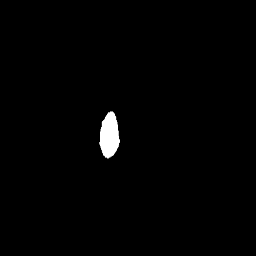

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_10_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_10_cyt.dat


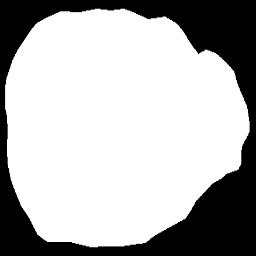

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_10_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/126_05_nuc.dat


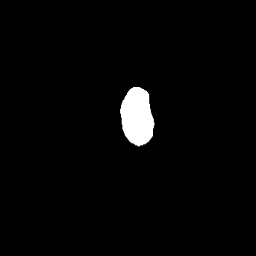

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/126_05_nuc.bmp
Extracted 35 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/126_05_cyt.dat


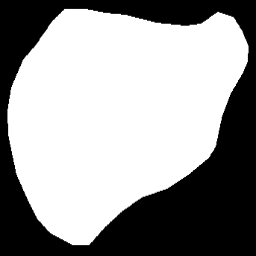

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/126_05_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_06_nuc.dat


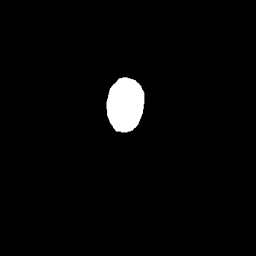

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_06_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_06_cyt.dat


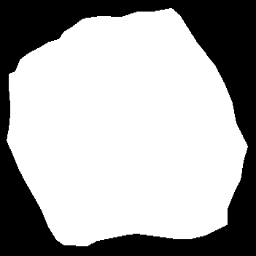

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_06_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/055_02_nuc.dat


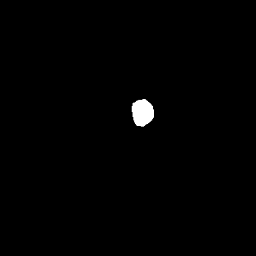

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/055_02_nuc.bmp
Extracted 66 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/055_02_cyt.dat


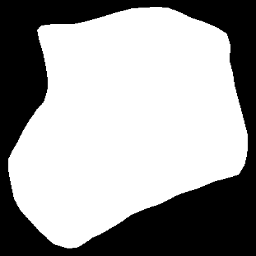

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/055_02_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/107_05_nuc.dat


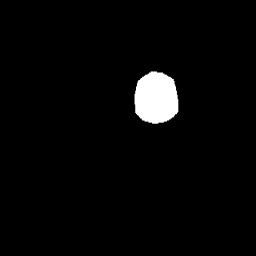

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_05_nuc.bmp
Extracted 36 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/107_05_cyt.dat


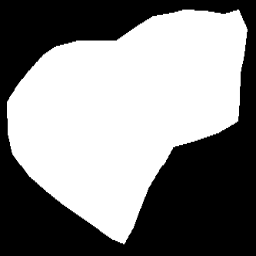

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_05_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_07_nuc.dat


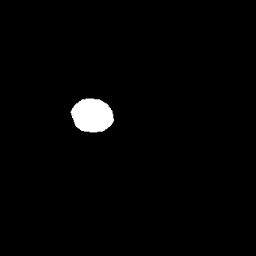

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_07_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_07_cyt.dat


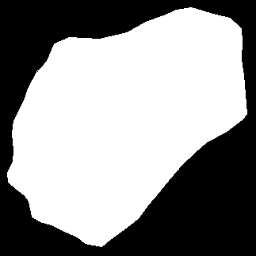

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_07_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_04_nuc.dat


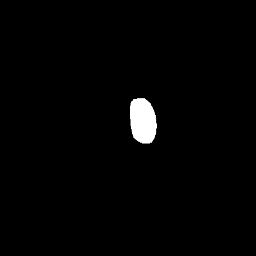

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_04_nuc.bmp
Extracted 87 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_04_cyt.dat


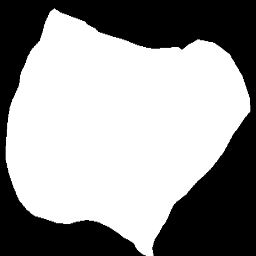

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_04_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/073_01_nuc.dat


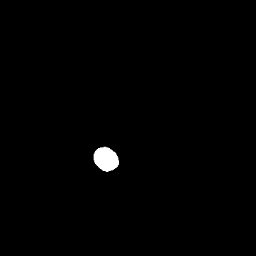

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/073_01_nuc.bmp
Extracted 58 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/073_01_cyt.dat


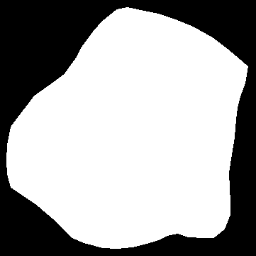

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/073_01_cyt.bmp
Extracted 27 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/042_04_nuc.dat


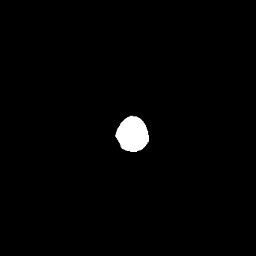

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_04_nuc.bmp
Extracted 70 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/042_04_cyt.dat


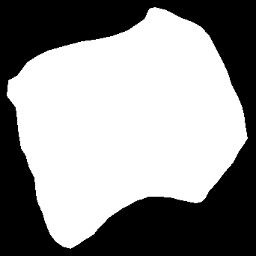

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_04_cyt.bmp
Extracted 12 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/058_05_nuc.dat


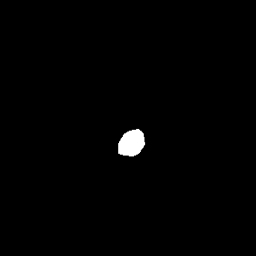

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_05_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/058_05_cyt.dat


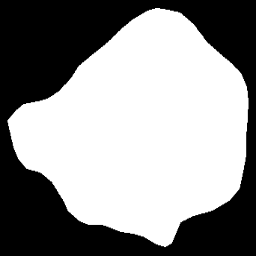

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_05_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/022_02_nuc.dat


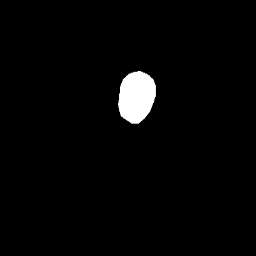

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/022_02_nuc.bmp
Extracted 65 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/022_02_cyt.dat


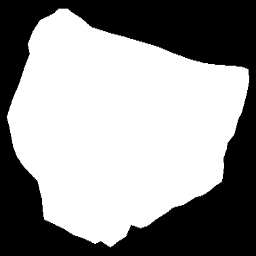

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/022_02_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/056_05_nuc.dat


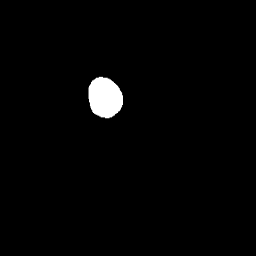

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_05_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/056_05_cyt.dat


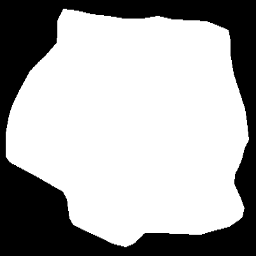

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_05_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_06_nuc.dat


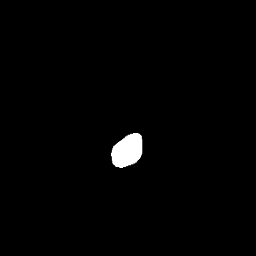

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_06_nuc.bmp
Extracted 68 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_06_cyt.dat


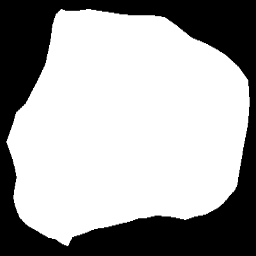

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_06_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_01_nuc.dat


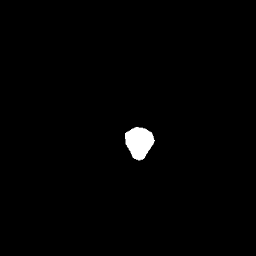

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_01_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_01_cyt.dat


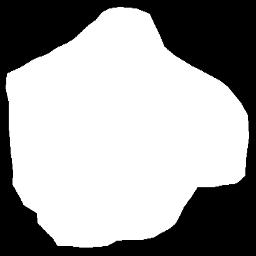

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_01_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_06_nuc.dat


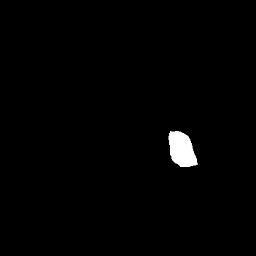

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/119_06_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_06_cyt.dat


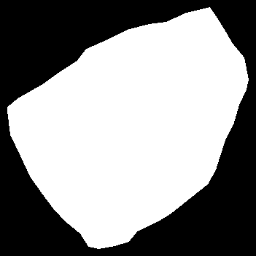

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/119_06_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/126_04_nuc.dat


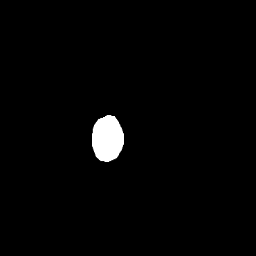

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/126_04_nuc.bmp
Extracted 38 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/126_04_cyt.dat


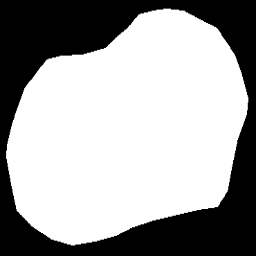

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/126_04_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_04_nuc.dat


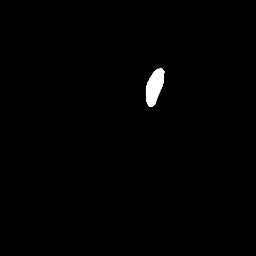

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_04_nuc.bmp
Extracted 75 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_04_cyt.dat


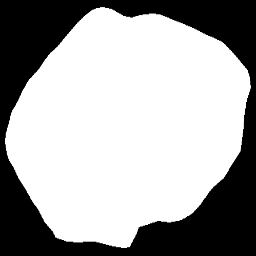

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_04_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/103_05_nuc.dat


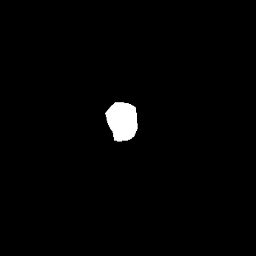

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/103_05_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/103_05_cyt.dat


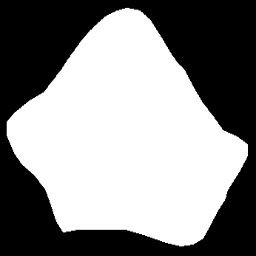

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/103_05_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/059_05_nuc.dat


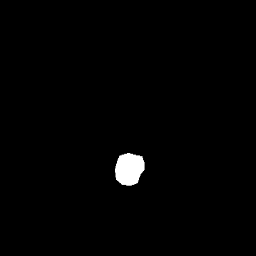

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/059_05_nuc.bmp
Extracted 58 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/059_05_cyt.dat


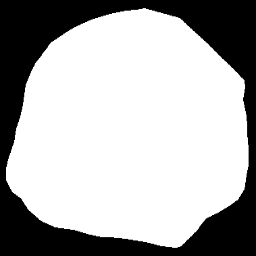

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/059_05_cyt.bmp
Extracted 27 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/050_05_nuc.dat


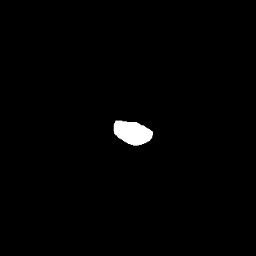

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_05_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/050_05_cyt.dat


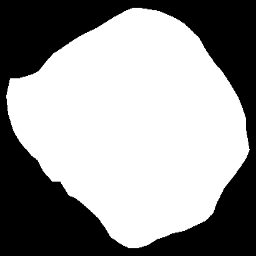

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_05_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/064_03_nuc.dat


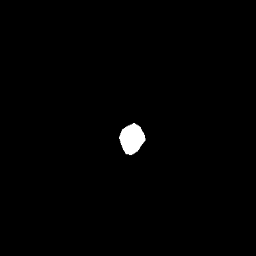

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_03_nuc.bmp
Extracted 69 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/064_03_cyt.dat


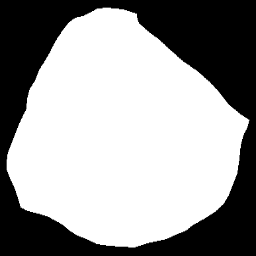

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_03_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/104_06_nuc.dat


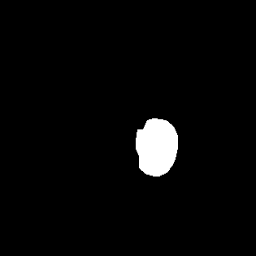

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/104_06_nuc.bmp
Extracted 42 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/104_06_cyt.dat


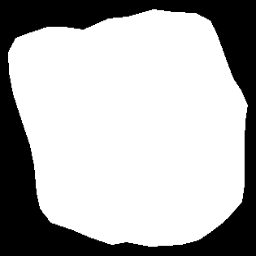

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/104_06_cyt.bmp
Extracted 27 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/117_04_nuc.dat


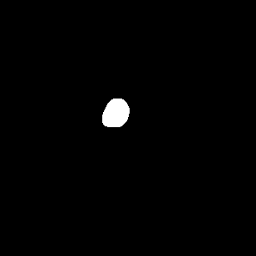

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/117_04_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/117_04_cyt.dat


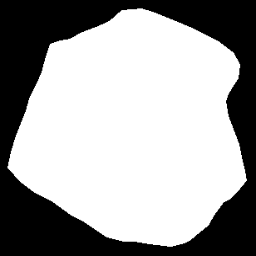

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/117_04_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/024_01_nuc.dat


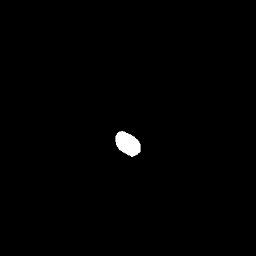

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/024_01_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/024_01_cyt.dat


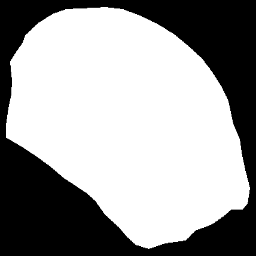

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/024_01_cyt.bmp
Extracted 34 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/081_05_nuc.dat


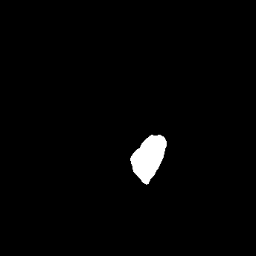

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_05_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/081_05_cyt.dat


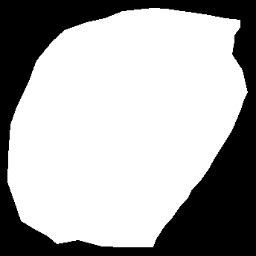

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_05_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_06_nuc.dat


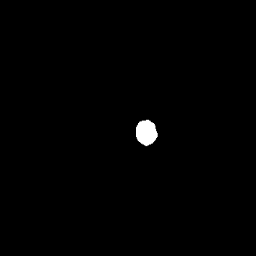

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_06_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_06_cyt.dat


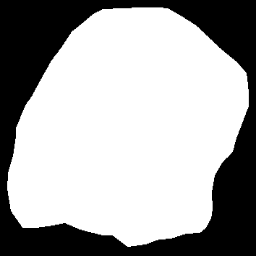

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_06_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/077_02_nuc.dat


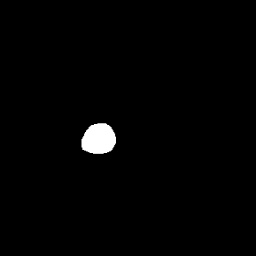

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/077_02_nuc.bmp
Extracted 80 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/077_02_cyt.dat


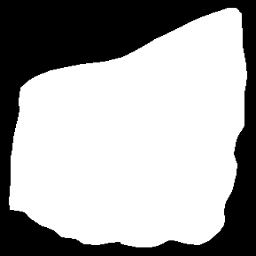

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/077_02_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_01_nuc.dat


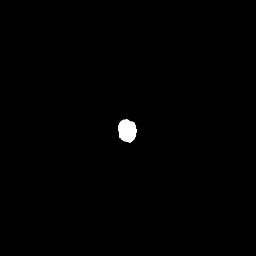

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_01_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_01_cyt.dat


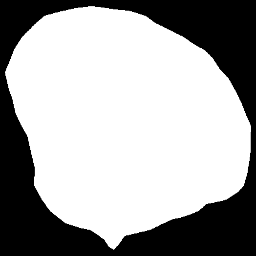

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_01_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_07_nuc.dat


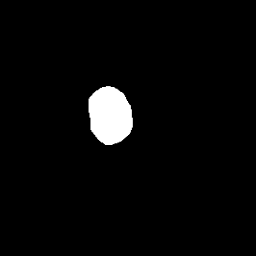

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_07_nuc.bmp
Extracted 84 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_07_cyt.dat


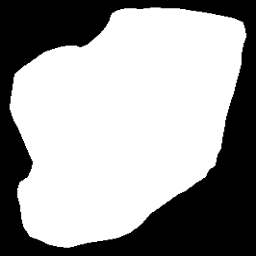

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_07_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_02_nuc.dat


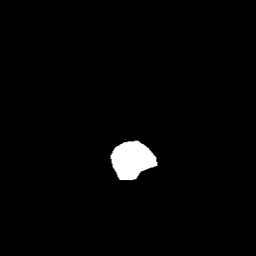

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_02_nuc.bmp
Extracted 75 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_02_cyt.dat


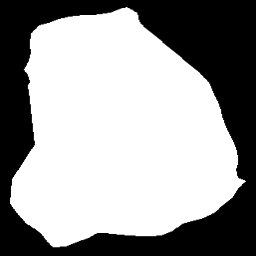

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_02_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_01_nuc.dat


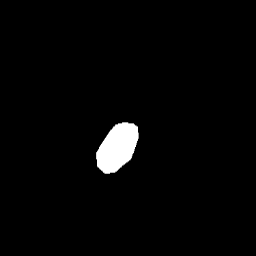

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_01_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_01_cyt.dat


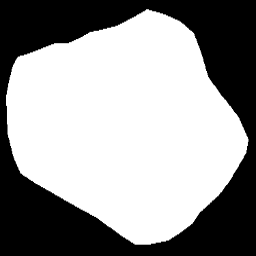

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_01_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/051_03_nuc.dat


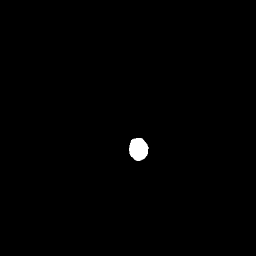

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/051_03_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/051_03_cyt.dat


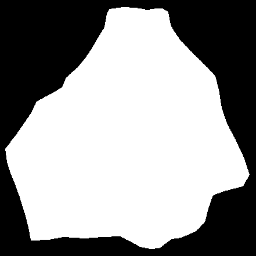

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/051_03_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/074_01_nuc.dat


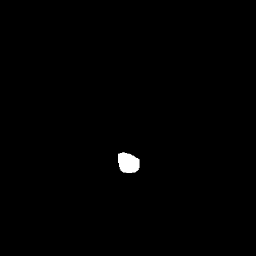

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/074_01_nuc.bmp
Extracted 58 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/074_01_cyt.dat


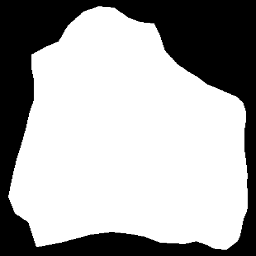

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/074_01_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/103_07_nuc.dat


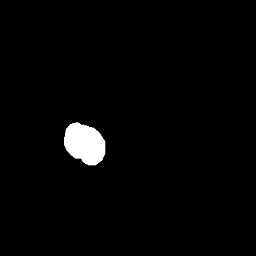

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/103_07_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/103_07_cyt.dat


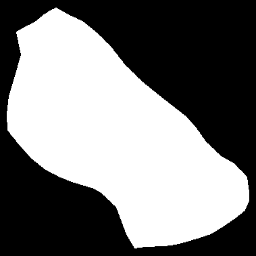

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/103_07_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/116_04_nuc.dat


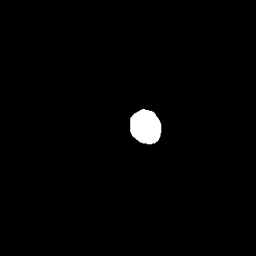

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/116_04_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/116_04_cyt.dat


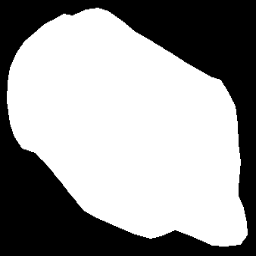

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/116_04_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_12_nuc.dat


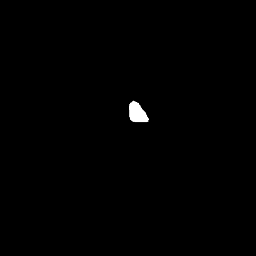

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_12_nuc.bmp
Extracted 65 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_12_cyt.dat


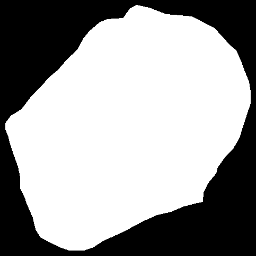

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_12_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_06_nuc.dat


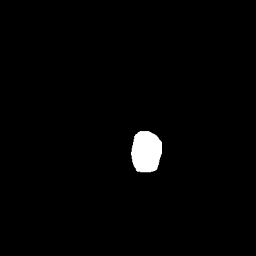

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_06_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_06_cyt.dat


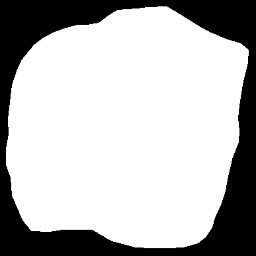

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_06_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/055_03_nuc.dat


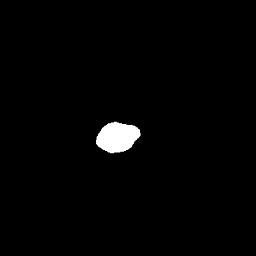

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/055_03_nuc.bmp
Extracted 78 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/055_03_cyt.dat


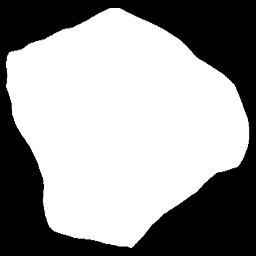

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/055_03_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/075_01_nuc.dat


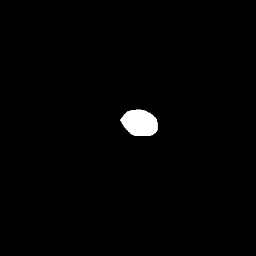

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_01_nuc.bmp
Extracted 64 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/075_01_cyt.dat


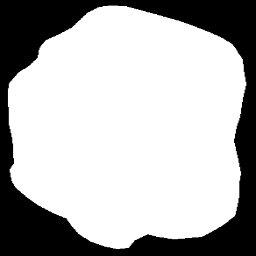

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_01_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/072_02_nuc.dat


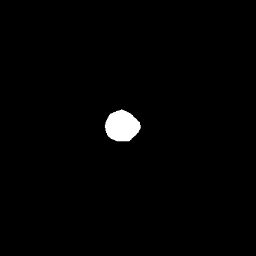

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_02_nuc.bmp
Extracted 75 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/072_02_cyt.dat


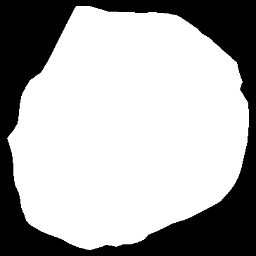

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_02_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/098_06_nuc.dat


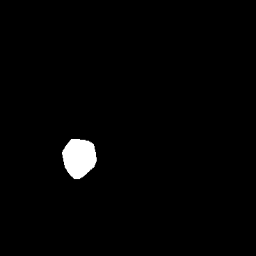

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_06_nuc.bmp
Extracted 47 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/098_06_cyt.dat


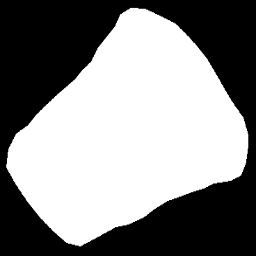

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_06_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_08_nuc.dat


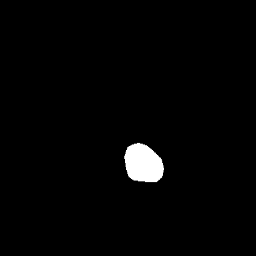

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_08_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_08_cyt.dat


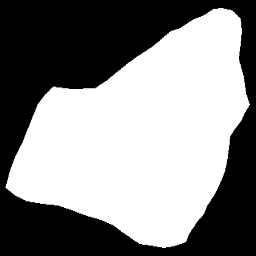

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_08_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/025_04_nuc.dat


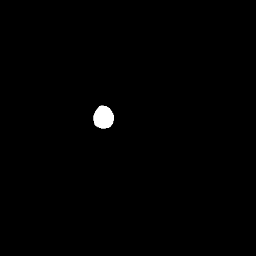

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_04_nuc.bmp
Extracted 61 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/025_04_cyt.dat


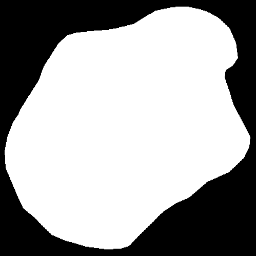

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_04_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/062_07_nuc.dat


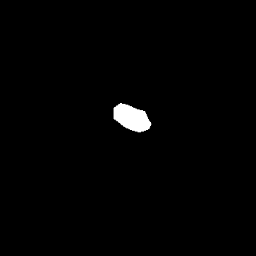

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_07_nuc.bmp
Extracted 60 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/062_07_cyt.dat


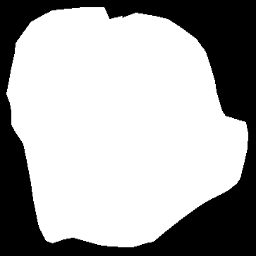

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_07_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/104_03_nuc.dat


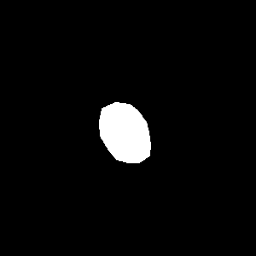

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/104_03_nuc.bmp
Extracted 45 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/104_03_cyt.dat


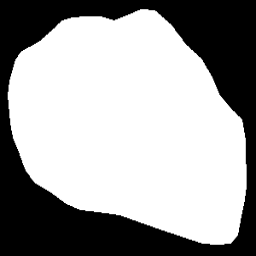

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/104_03_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/101_02_nuc.dat


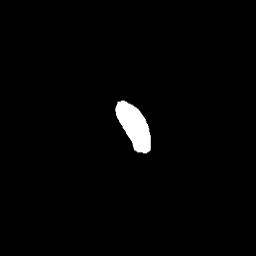

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/101_02_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/101_02_cyt.dat


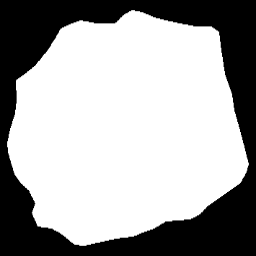

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/101_02_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/087_02_nuc.dat


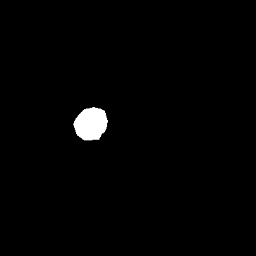

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/087_02_nuc.bmp
Extracted 78 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/087_02_cyt.dat


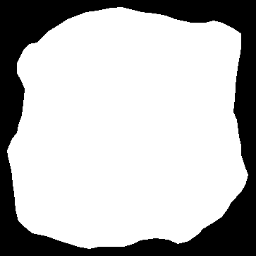

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/087_02_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/090_02_nuc.dat


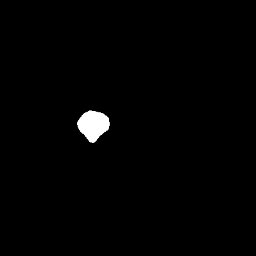

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/090_02_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/090_02_cyt.dat


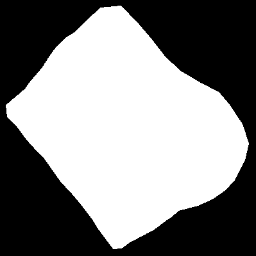

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/090_02_cyt.bmp
Extracted 26 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/056_04_nuc.dat


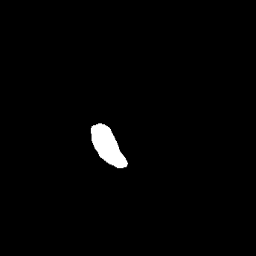

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_04_nuc.bmp
Extracted 64 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/056_04_cyt.dat


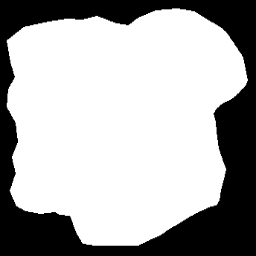

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_04_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_11_nuc.dat


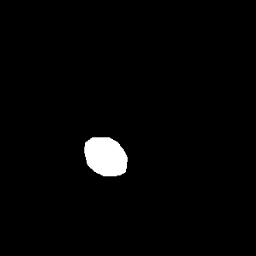

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_11_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_11_cyt.dat


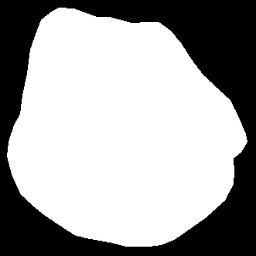

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_11_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/002_06_nuc.dat


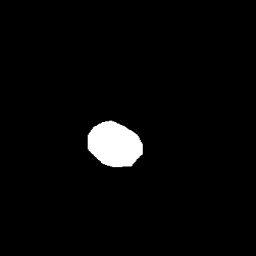

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/002_06_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/002_06_cyt.dat


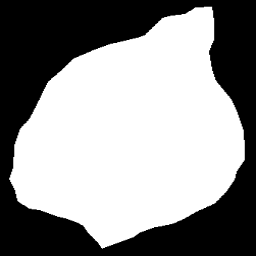

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/002_06_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_12_nuc.dat


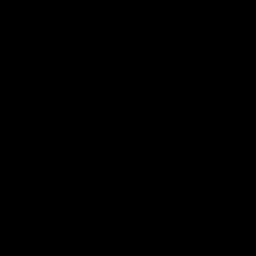

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_12_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_12_cyt.dat


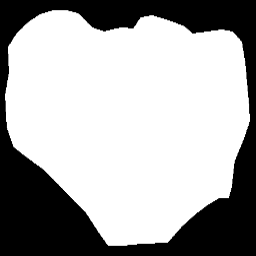

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_12_cyt.bmp
Extracted 34 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_01_nuc.dat


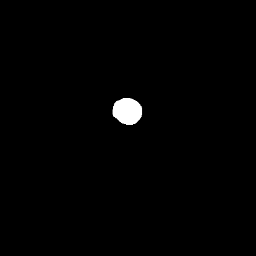

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_01_nuc.bmp
Extracted 76 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_01_cyt.dat


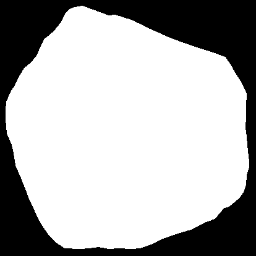

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/101_07_nuc.dat


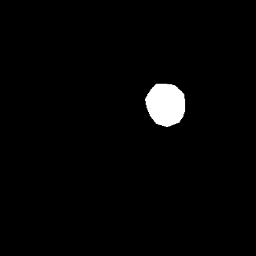

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/101_07_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/101_07_cyt.dat


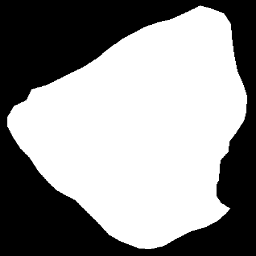

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/101_07_cyt.bmp
Extracted 29 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/052_01_nuc.dat


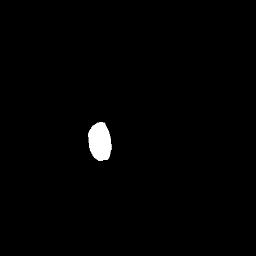

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_01_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/052_01_cyt.dat


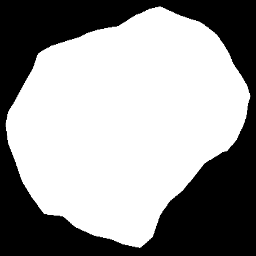

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_01_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_04_nuc.dat


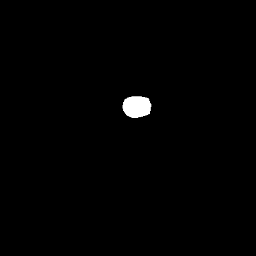

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_04_nuc.bmp
Extracted 65 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_04_cyt.dat


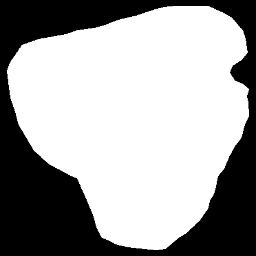

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_04_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_01_nuc.dat


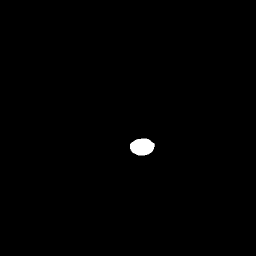

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/029_01_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_01_cyt.dat


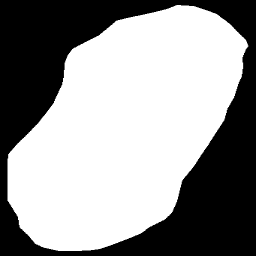

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/029_01_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/013_05_nuc.dat


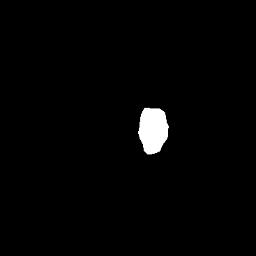

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/013_05_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/013_05_cyt.dat


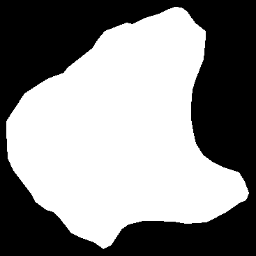

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/013_05_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_02_nuc.dat


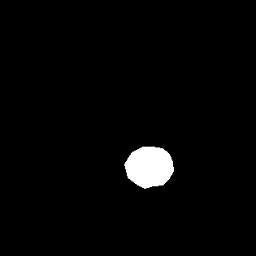

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_02_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_02_cyt.dat


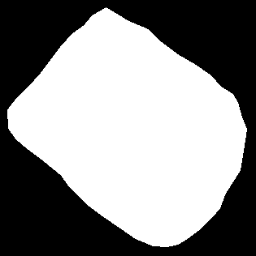

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_02_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/075_04_nuc.dat


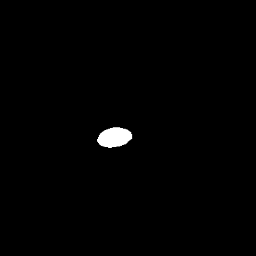

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_04_nuc.bmp
Extracted 79 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/075_04_cyt.dat


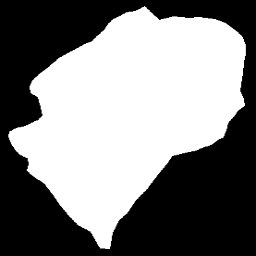

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_04_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_10_nuc.dat


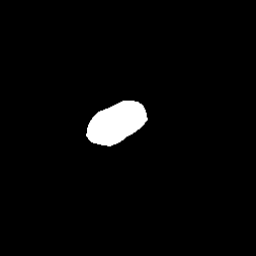

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/118_10_nuc.bmp
Extracted 36 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_10_cyt.dat


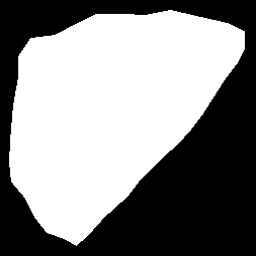

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/118_10_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/121_05_nuc.dat


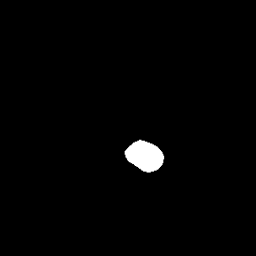

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/121_05_nuc.bmp
Extracted 42 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/121_05_cyt.dat


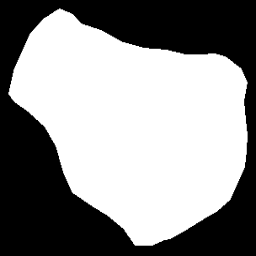

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/121_05_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_10_nuc.dat


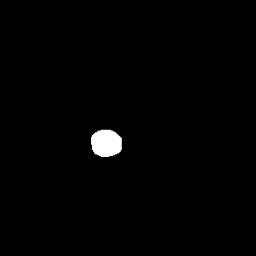

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_10_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_10_cyt.dat


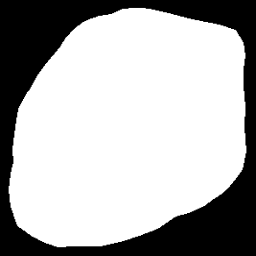

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_10_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/022_01_nuc.dat


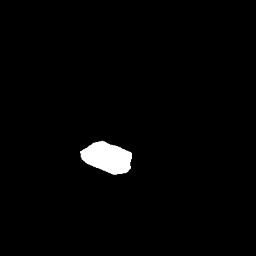

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/022_01_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/022_01_cyt.dat


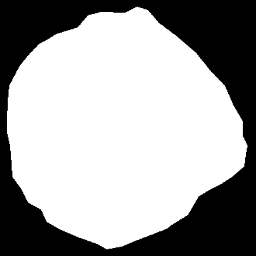

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/022_01_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/120_02_nuc.dat


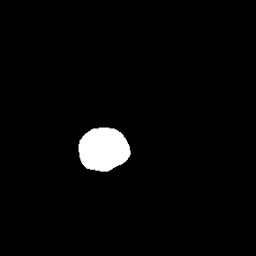

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/120_02_nuc.bmp
Extracted 35 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/120_02_cyt.dat


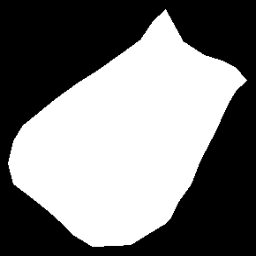

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/120_02_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_03_nuc.dat


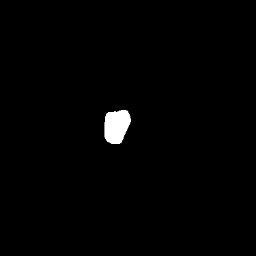

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_03_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_03_cyt.dat


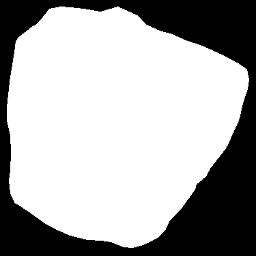

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_03_cyt.bmp
Extracted 27 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/015_04_nuc.dat


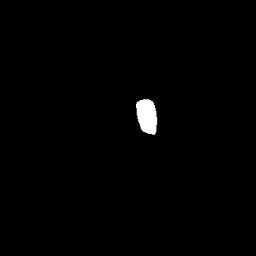

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_04_nuc.bmp
Extracted 74 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/015_04_cyt.dat


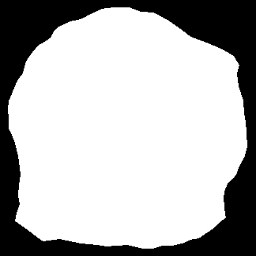

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_04_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/074_02_nuc.dat


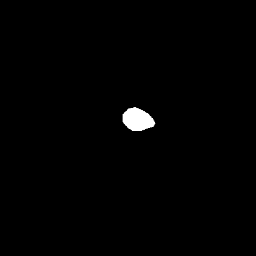

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/074_02_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/074_02_cyt.dat


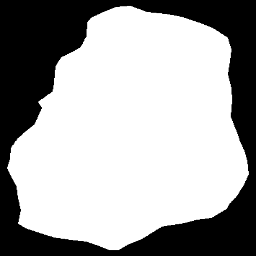

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/074_02_cyt.bmp
Extracted 33 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_02_nuc.dat


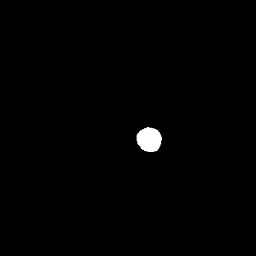

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_02_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_02_cyt.dat


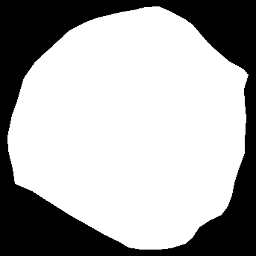

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_02_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_03_nuc.dat


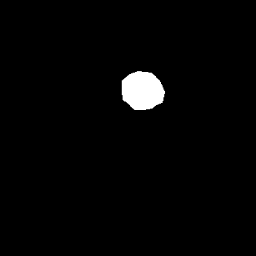

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_03_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_03_cyt.dat


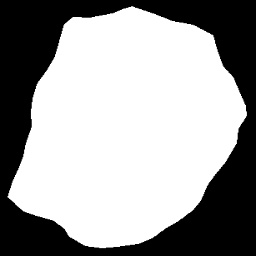

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_03_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/049_04_nuc.dat


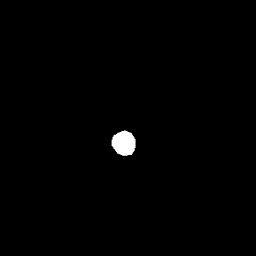

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_04_nuc.bmp
Extracted 64 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/049_04_cyt.dat


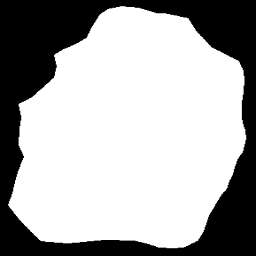

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_04_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/064_02_nuc.dat


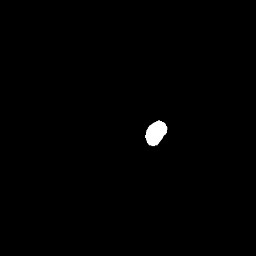

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_02_nuc.bmp
Extracted 96 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/064_02_cyt.dat


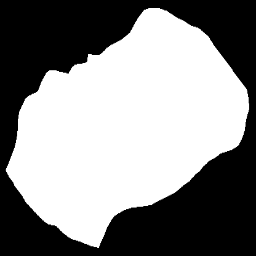

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_02_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_02_nuc.dat


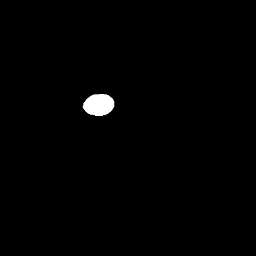

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_02_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_02_cyt.dat


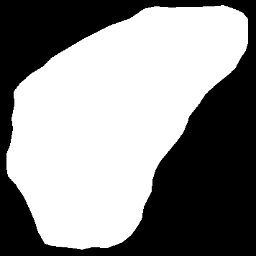

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_02_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_05_nuc.dat


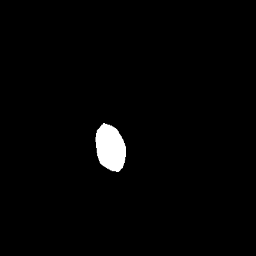

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_05_nuc.bmp
Extracted 75 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_05_cyt.dat


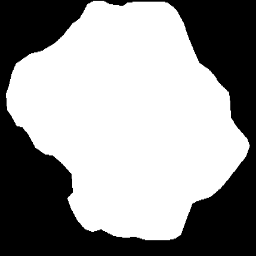

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_05_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_10_nuc.dat


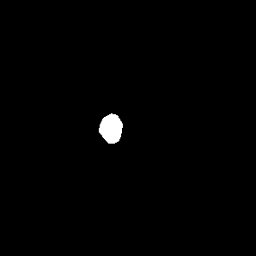

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_10_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_10_cyt.dat


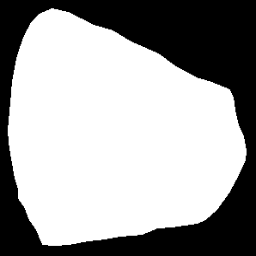

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_10_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/115_01_nuc.dat


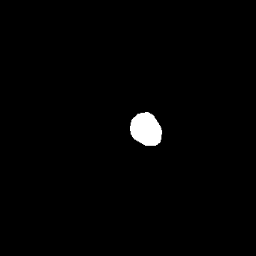

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/115_01_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/115_01_cyt.dat


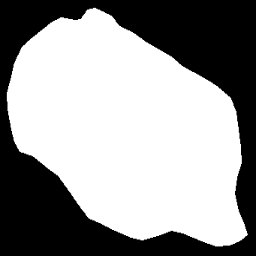

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/115_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_02_nuc.dat


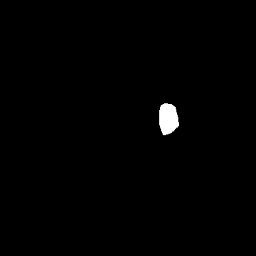

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_02_nuc.bmp
Extracted 76 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_02_cyt.dat


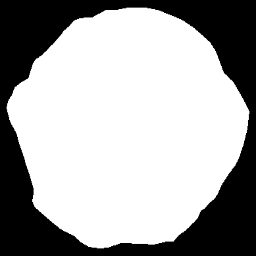

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_02_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/098_05_nuc.dat


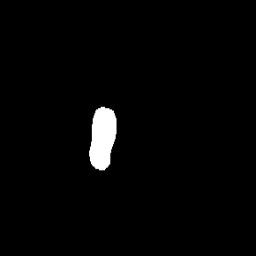

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_05_nuc.bmp
Extracted 40 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/098_05_cyt.dat


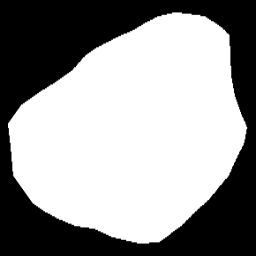

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_05_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/064_05_nuc.dat


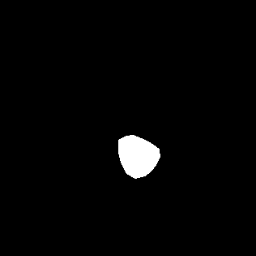

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_05_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/064_05_cyt.dat


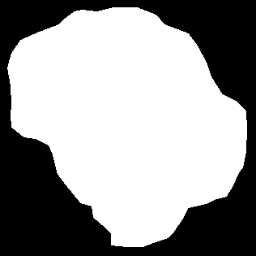

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_05_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_10_nuc.dat


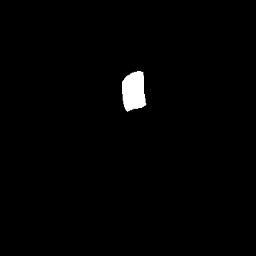

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_10_nuc.bmp
Extracted 65 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_10_cyt.dat


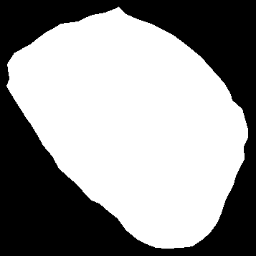

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_10_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/086_01_nuc.dat


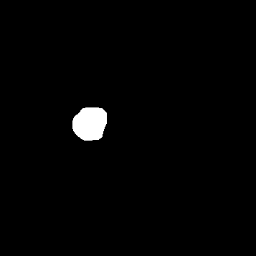

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_01_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/086_01_cyt.dat


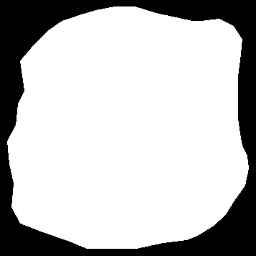

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_01_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/047_02_nuc.dat


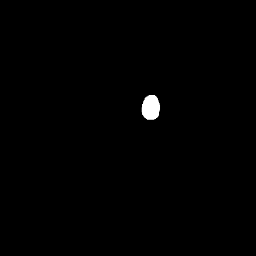

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_02_nuc.bmp
Extracted 107 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/047_02_cyt.dat


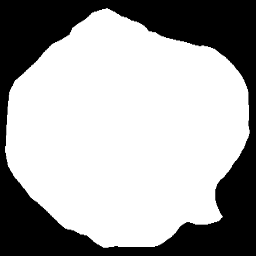

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_02_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_11_nuc.dat


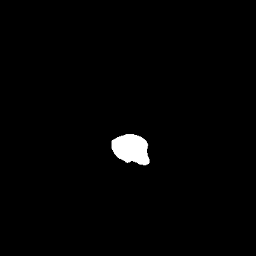

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_11_nuc.bmp
Extracted 72 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_11_cyt.dat


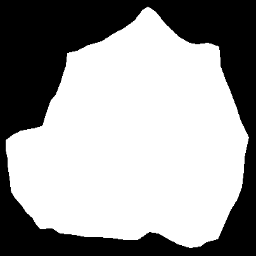

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_11_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_06_nuc.dat


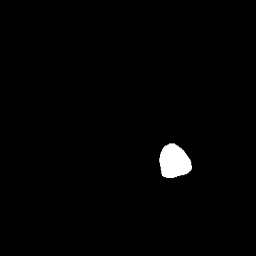

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_06_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_06_cyt.dat


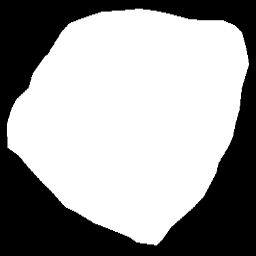

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_06_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/037_02_nuc.dat


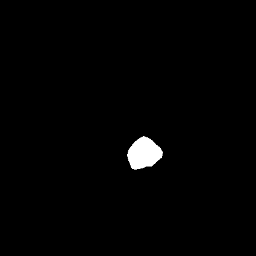

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/037_02_nuc.bmp
Extracted 72 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/037_02_cyt.dat


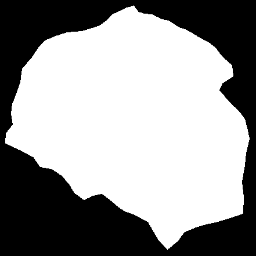

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/037_02_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/082_07_nuc.dat


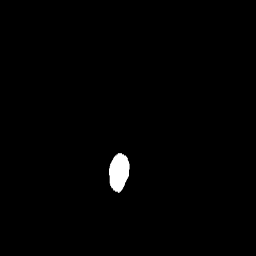

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/082_07_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/082_07_cyt.dat


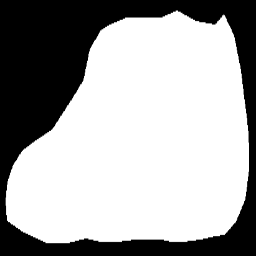

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/082_07_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/056_02_nuc.dat


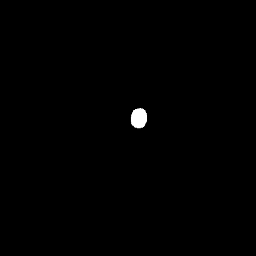

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_02_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/056_02_cyt.dat


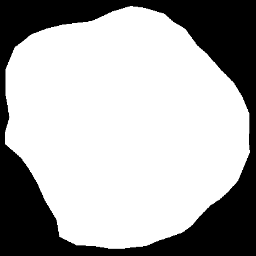

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_02_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/102_07_nuc.dat


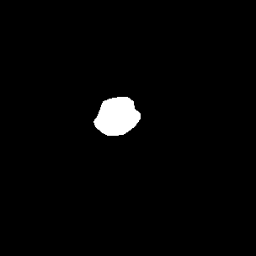

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_07_nuc.bmp
Extracted 78 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/102_07_cyt.dat


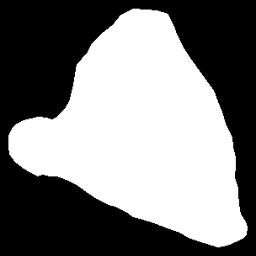

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_07_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/043_04_nuc.dat


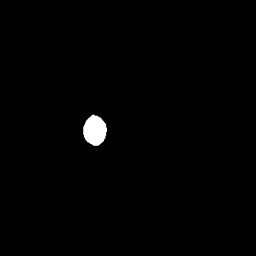

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_04_nuc.bmp
Extracted 66 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/043_04_cyt.dat


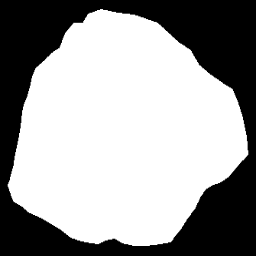

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_04_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/112_04_nuc.dat


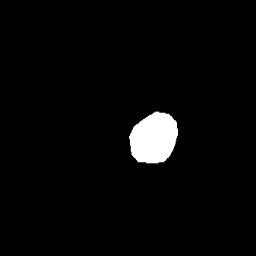

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/112_04_nuc.bmp
Extracted 38 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/112_04_cyt.dat


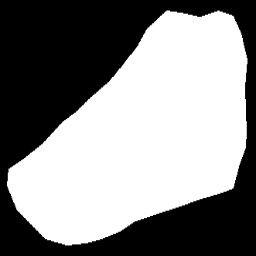

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/112_04_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_06_nuc.dat


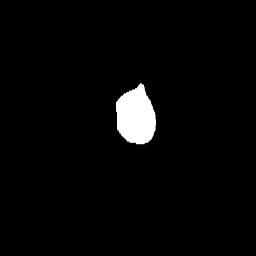

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_06_nuc.bmp
Extracted 83 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_06_cyt.dat


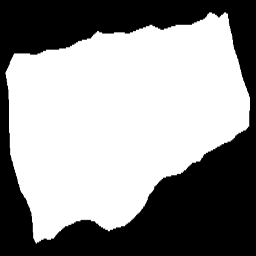

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_06_cyt.bmp
Extracted 32 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/027_02_nuc.dat


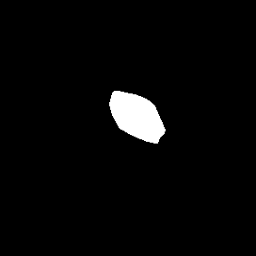

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_02_nuc.bmp
Extracted 75 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/027_02_cyt.dat


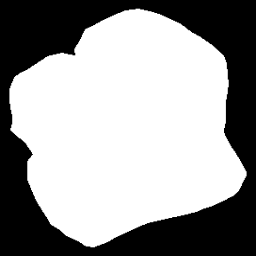

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_02_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_09_nuc.dat


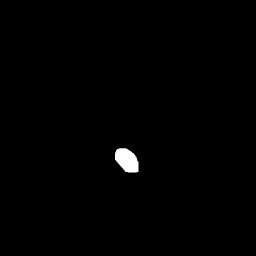

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_09_nuc.bmp
Extracted 85 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_09_cyt.dat


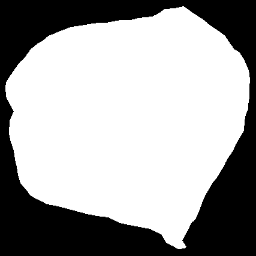

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_09_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/005_05_nuc.dat


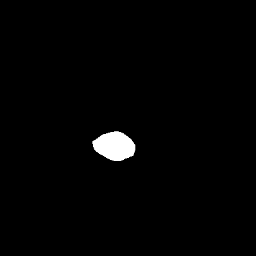

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_05_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/005_05_cyt.dat


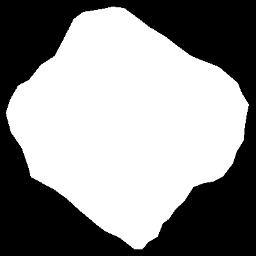

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_05_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_10_nuc.dat


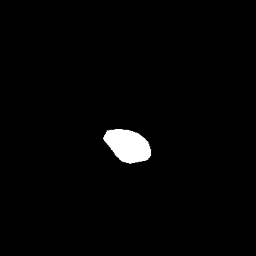

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_10_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_10_cyt.dat


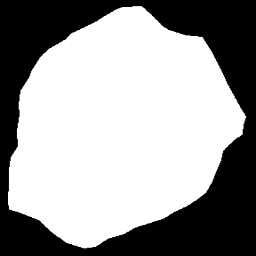

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_10_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/012_05_nuc.dat


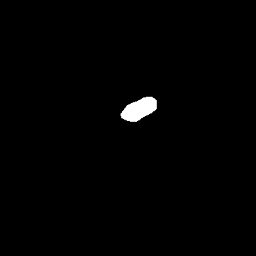

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_05_nuc.bmp
Extracted 71 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/012_05_cyt.dat


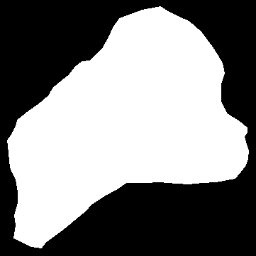

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_05_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/093_01_nuc.dat


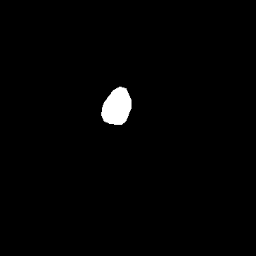

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_01_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/093_01_cyt.dat


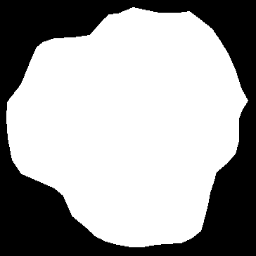

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_01_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/027_07_nuc.dat


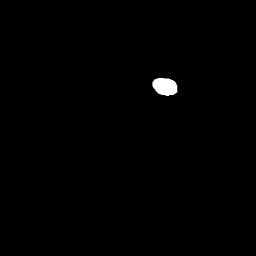

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_07_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/027_07_cyt.dat


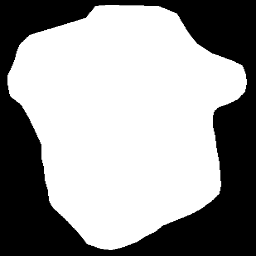

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_07_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/111_03_nuc.dat


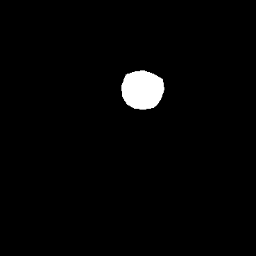

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/111_03_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/111_03_cyt.dat


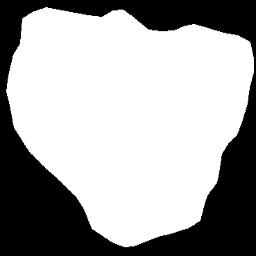

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/111_03_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_06_nuc.dat


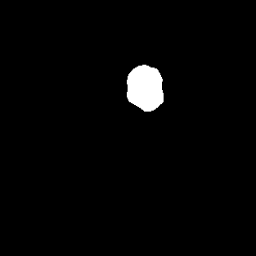

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_06_nuc.bmp
Extracted 68 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_06_cyt.dat


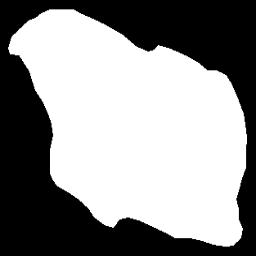

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_06_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_06_nuc.dat


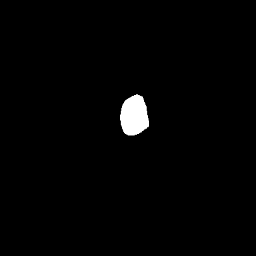

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_06_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_06_cyt.dat


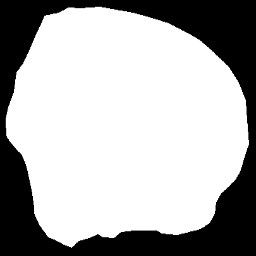

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_06_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/075_05_nuc.dat


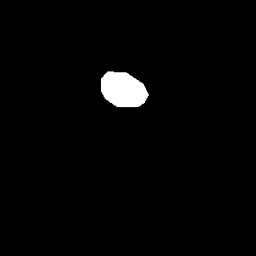

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_05_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/075_05_cyt.dat


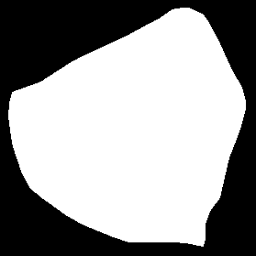

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_05_cyt.bmp
Extracted 11 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_09_nuc.dat


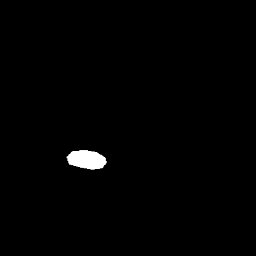

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/061_09_nuc.bmp
Extracted 42 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_09_cyt.dat


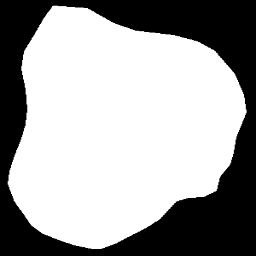

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/061_09_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_02_nuc.dat


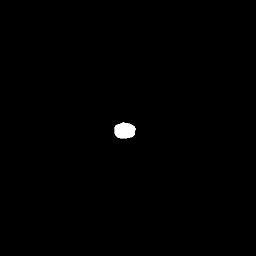

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_02_nuc.bmp
Extracted 64 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_02_cyt.dat


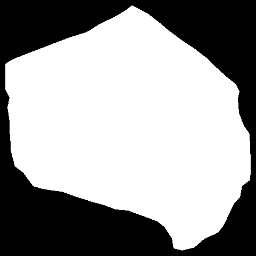

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_02_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/058_03_nuc.dat


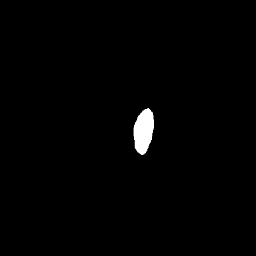

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_03_nuc.bmp
Extracted 96 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/058_03_cyt.dat


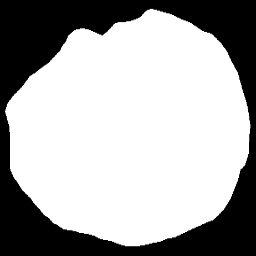

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_03_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/016_02_nuc.dat


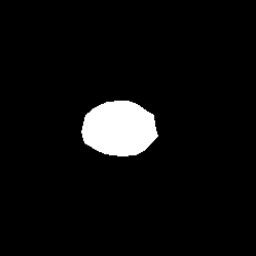

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/016_02_nuc.bmp
Extracted 64 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/016_02_cyt.dat


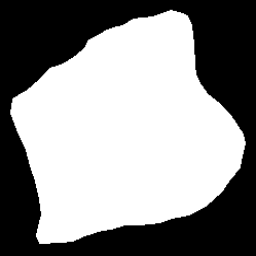

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/016_02_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/123_02_nuc.dat


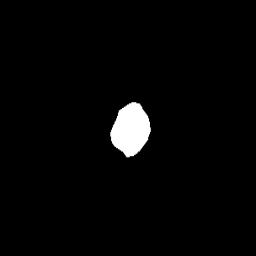

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_02_nuc.bmp
Extracted 32 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/123_02_cyt.dat


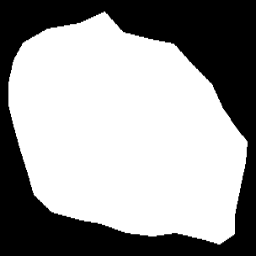

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_02_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_01_nuc.dat


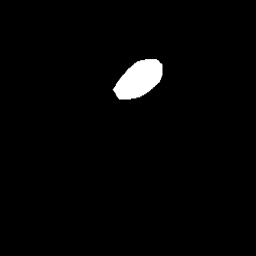

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_01_nuc.bmp
Extracted 47 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_01_cyt.dat


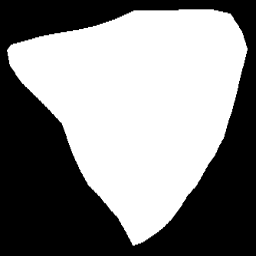

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_01_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/056_03_nuc.dat


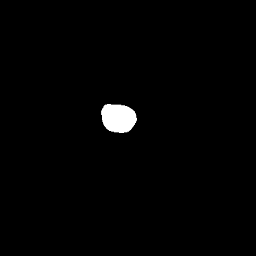

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_03_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/056_03_cyt.dat


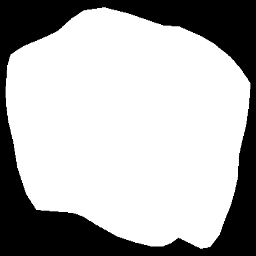

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_03_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/086_02_nuc.dat


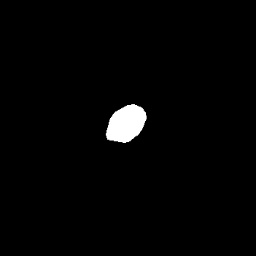

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_02_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/086_02_cyt.dat


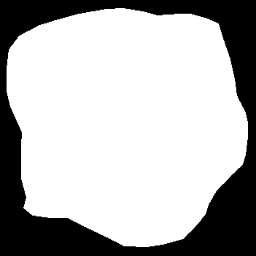

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_02_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/111_06_nuc.dat


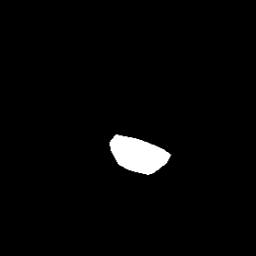

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/111_06_nuc.bmp
Extracted 42 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/111_06_cyt.dat


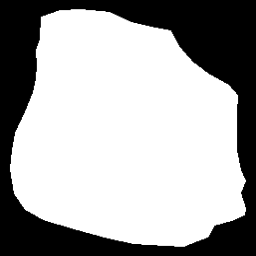

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/111_06_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/070_01_nuc.dat


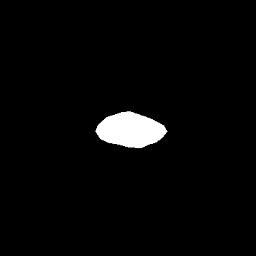

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_01_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/070_01_cyt.dat


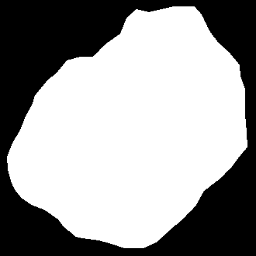

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_01_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/102_04_nuc.dat


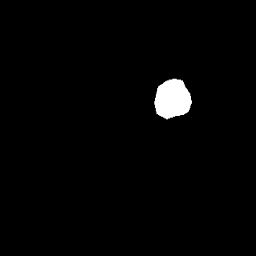

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_04_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/102_04_cyt.dat


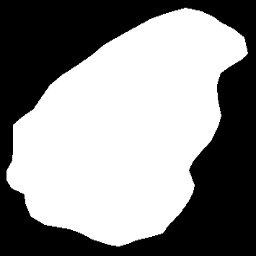

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_04_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/123_08_nuc.dat


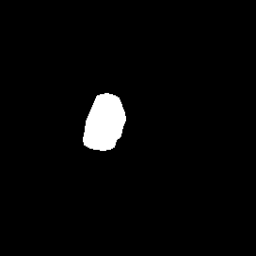

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_08_nuc.bmp
Extracted 29 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/123_08_cyt.dat


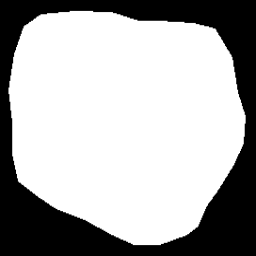

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_08_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/011_02_nuc.dat


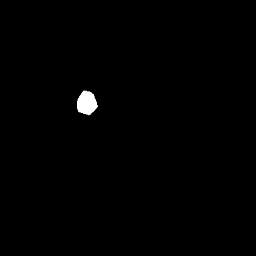

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_02_nuc.bmp
Extracted 80 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/011_02_cyt.dat


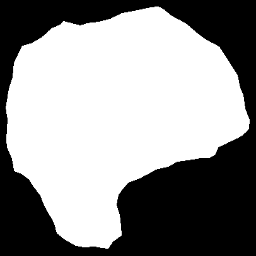

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_02_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_08_nuc.dat


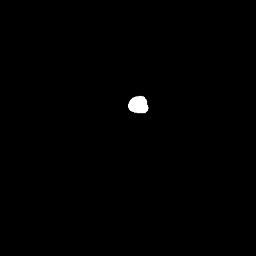

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_08_nuc.bmp
Extracted 80 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_08_cyt.dat


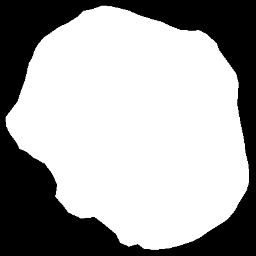

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_08_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_15_nuc.dat


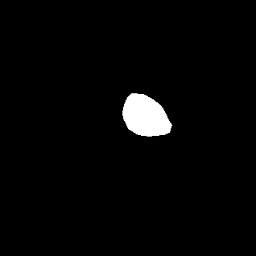

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_15_nuc.bmp
Extracted 92 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_15_cyt.dat


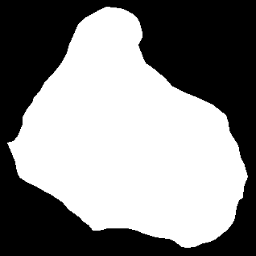

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_15_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/049_02_nuc.dat


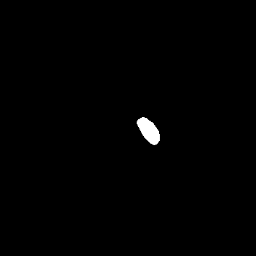

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_02_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/049_02_cyt.dat


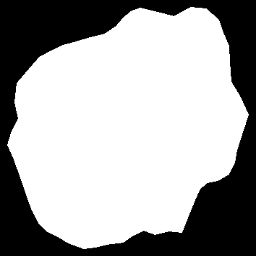

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_02_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/110_01_nuc.dat


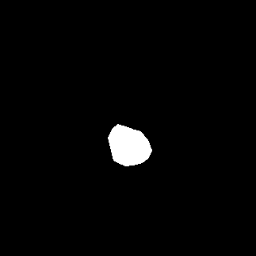

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/110_01_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/110_01_cyt.dat


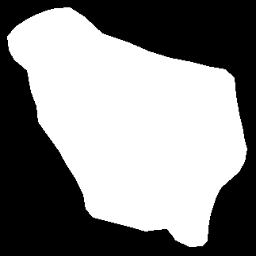

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/110_01_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_07_nuc.dat


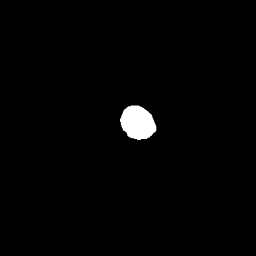

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/118_07_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_07_cyt.dat


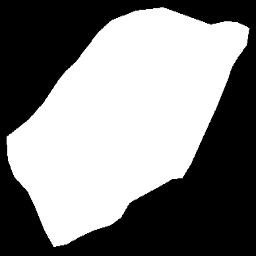

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/118_07_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/043_06_nuc.dat


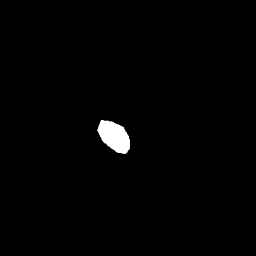

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_06_nuc.bmp
Extracted 64 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/043_06_cyt.dat


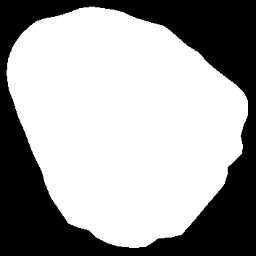

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_06_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/101_01_nuc.dat


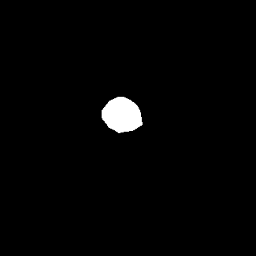

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/101_01_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/101_01_cyt.dat


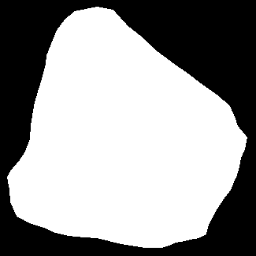

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/101_01_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_09_nuc.dat


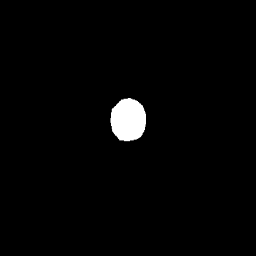

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_09_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_09_cyt.dat


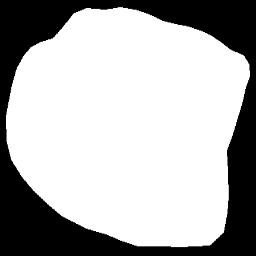

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_09_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/126_06_nuc.dat


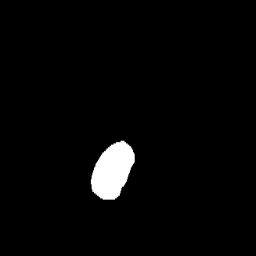

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/126_06_nuc.bmp
Extracted 28 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/126_06_cyt.dat


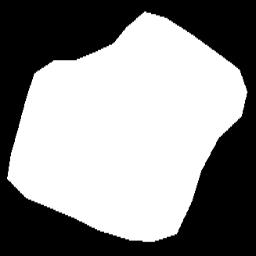

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/126_06_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_11_nuc.dat


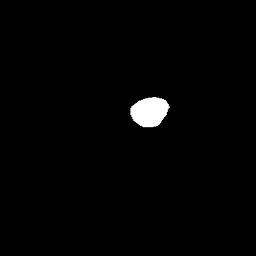

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_11_nuc.bmp
Extracted 60 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_11_cyt.dat


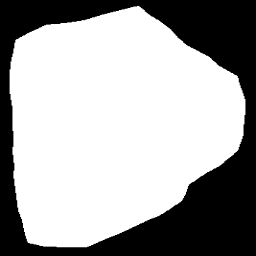

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_11_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/120_05_nuc.dat


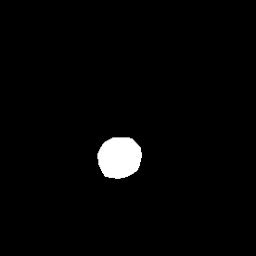

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/120_05_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/120_05_cyt.dat


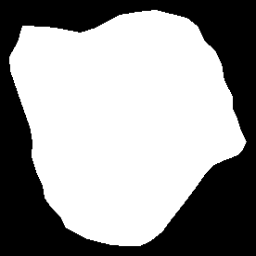

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/120_05_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_05_nuc.dat


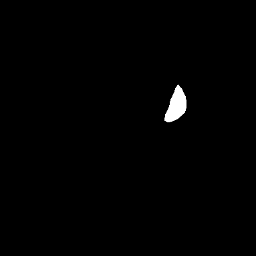

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_05_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_05_cyt.dat


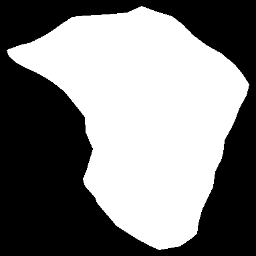

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_05_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/100_07_nuc.dat


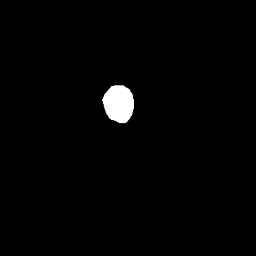

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_07_nuc.bmp
Extracted 61 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/100_07_cyt.dat


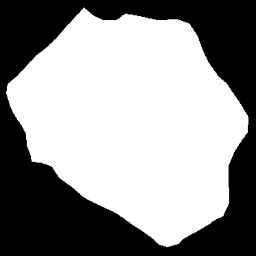

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_07_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_06_nuc.dat


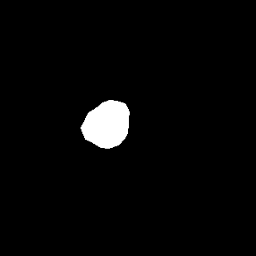

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_06_nuc.bmp
Extracted 37 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_06_cyt.dat


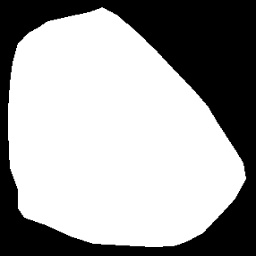

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_06_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_08_nuc.dat


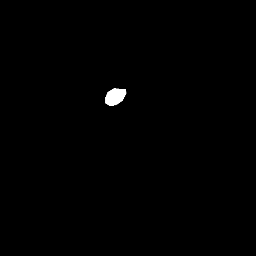

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_08_nuc.bmp
Extracted 69 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_08_cyt.dat


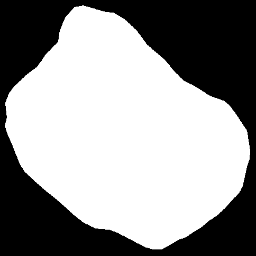

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_08_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_06_nuc.dat


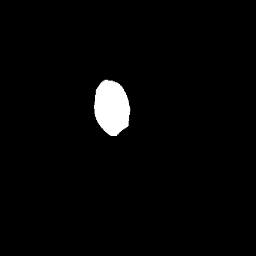

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_06_nuc.bmp
Extracted 58 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_06_cyt.dat


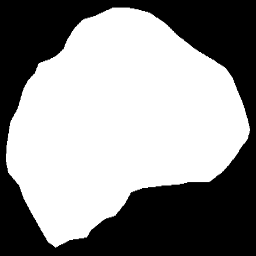

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_06_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/088_01_nuc.dat


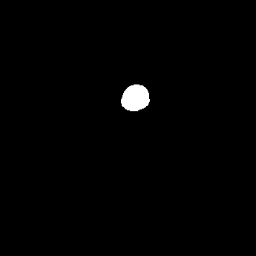

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/088_01_nuc.bmp
Extracted 76 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/088_01_cyt.dat


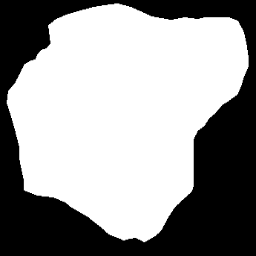

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/088_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/103_04_nuc.dat


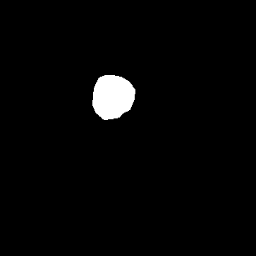

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/103_04_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/103_04_cyt.dat


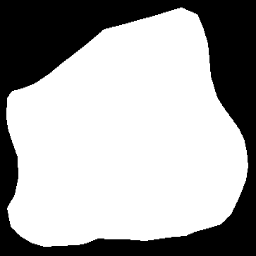

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/103_04_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_09_nuc.dat


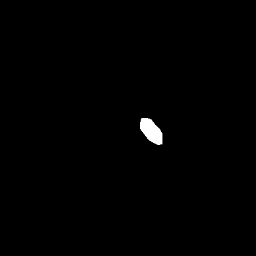

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_09_nuc.bmp
Extracted 68 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_09_cyt.dat


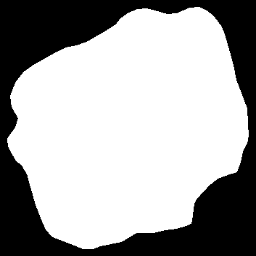

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_09_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/114_03_nuc.dat


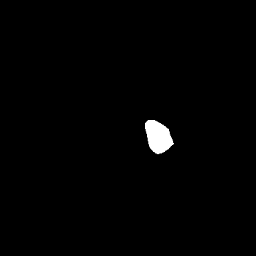

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/114_03_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/114_03_cyt.dat


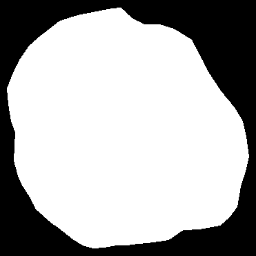

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/114_03_cyt.bmp
Extracted 10 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_03_nuc.dat


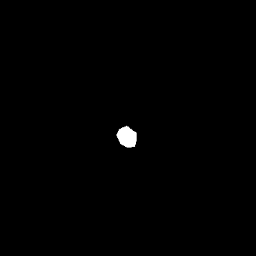

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_03_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_03_cyt.dat


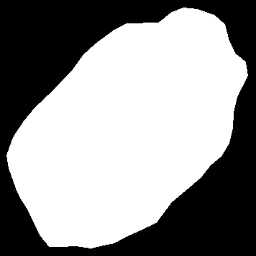

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_03_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/104_05_nuc.dat


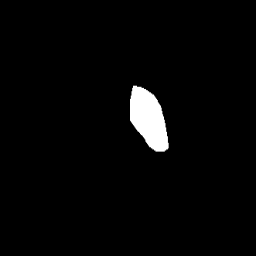

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/104_05_nuc.bmp
Extracted 42 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/104_05_cyt.dat


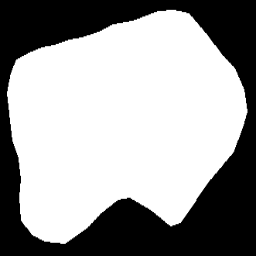

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/104_05_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_02_nuc.dat


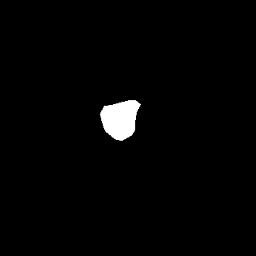

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_02_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_02_cyt.dat


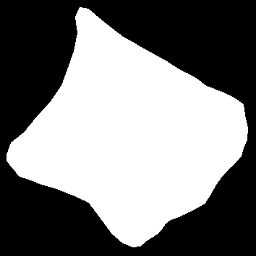

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_02_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_01_nuc.dat


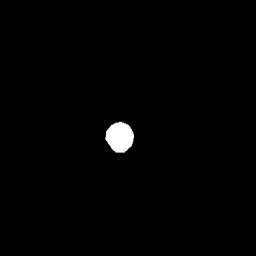

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_01_nuc.bmp
Extracted 103 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_01_cyt.dat


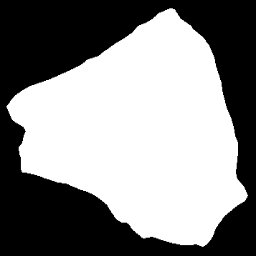

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_05_nuc.dat


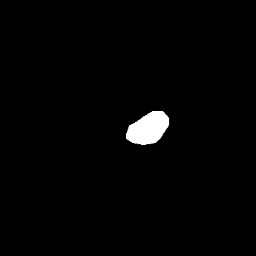

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_05_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_05_cyt.dat


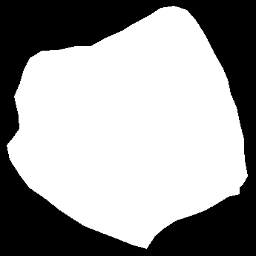

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_05_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_03_nuc.dat


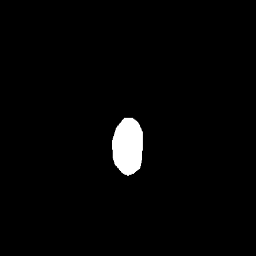

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_03_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_03_cyt.dat


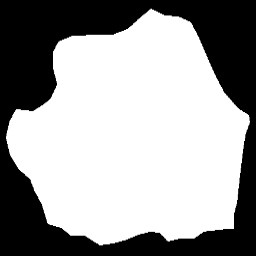

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_03_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/059_03_nuc.dat


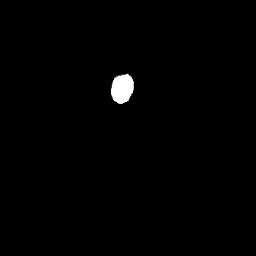

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/059_03_nuc.bmp
Extracted 87 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/059_03_cyt.dat


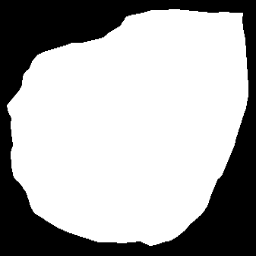

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/059_03_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/038_01_nuc.dat


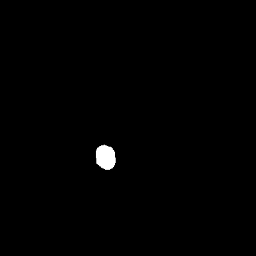

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/038_01_nuc.bmp
Extracted 84 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/038_01_cyt.dat


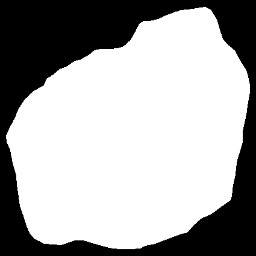

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/038_01_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_14_nuc.dat


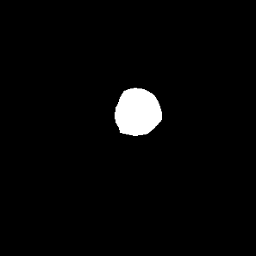

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_14_nuc.bmp
Extracted 83 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_14_cyt.dat


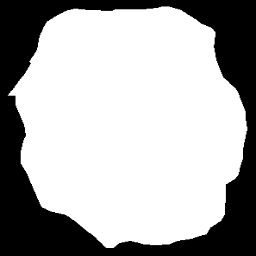

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_14_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/012_02_nuc.dat


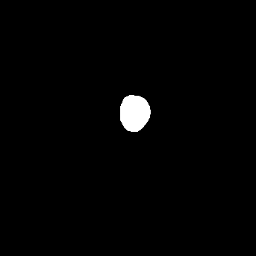

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_02_nuc.bmp
Extracted 94 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/012_02_cyt.dat


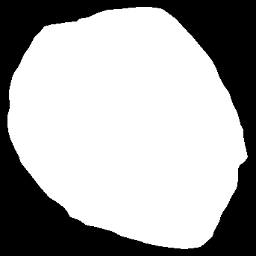

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_02_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_07_nuc.dat


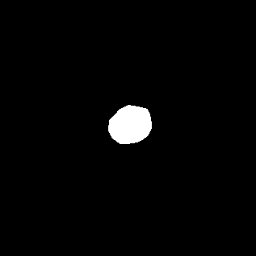

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_07_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_07_cyt.dat


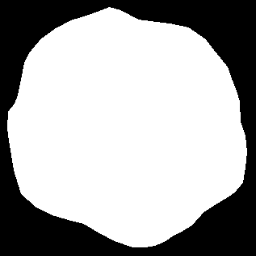

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_07_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/098_03_nuc.dat


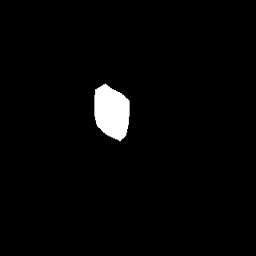

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_03_nuc.bmp
Extracted 45 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/098_03_cyt.dat


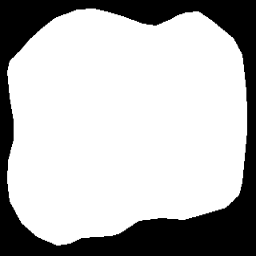

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_03_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_01_nuc.dat


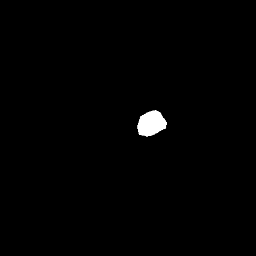

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_01_nuc.bmp
Extracted 66 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_01_cyt.dat


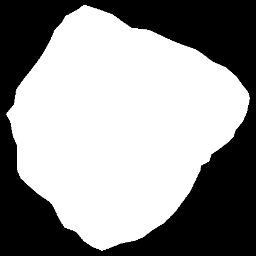

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/079_01_nuc.dat


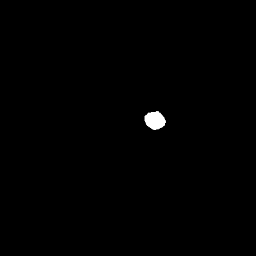

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/079_01_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/079_01_cyt.dat


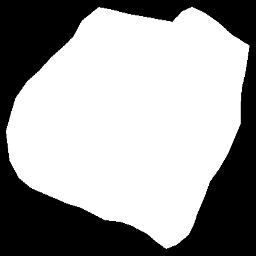

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/079_01_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/006_06_nuc.dat


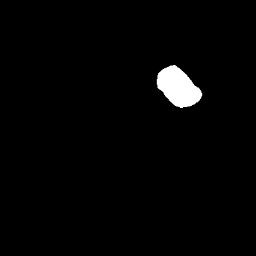

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_06_nuc.bmp
Extracted 67 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/006_06_cyt.dat


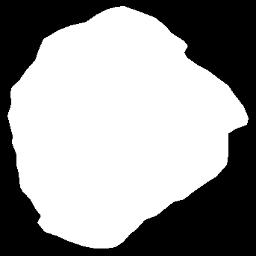

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_06_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/054_03_nuc.dat


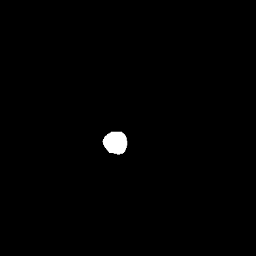

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_03_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/054_03_cyt.dat


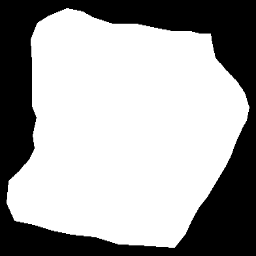

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_03_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/028_01_nuc.dat


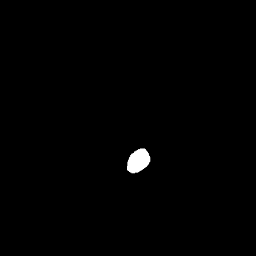

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_01_nuc.bmp
Extracted 67 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/028_01_cyt.dat


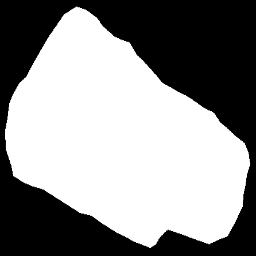

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_01_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_07_nuc.dat


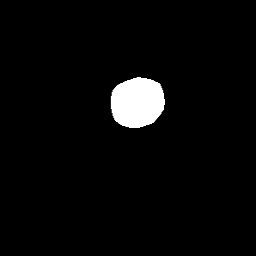

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/122_07_nuc.bmp
Extracted 36 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_07_cyt.dat


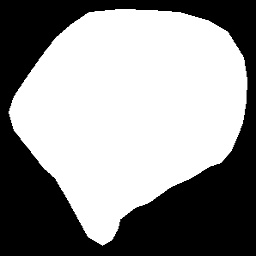

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/122_07_cyt.bmp
Extracted 12 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/063_04_nuc.dat


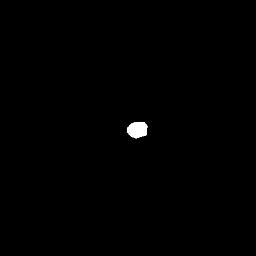

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_04_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/063_04_cyt.dat


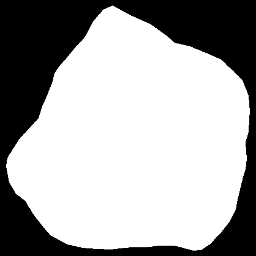

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_04_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_01_nuc.dat


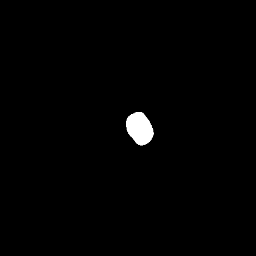

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_01_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_01_cyt.dat


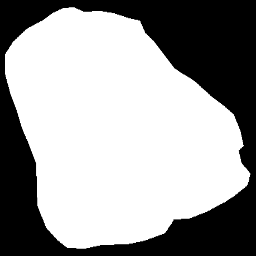

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_01_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/047_01_nuc.dat


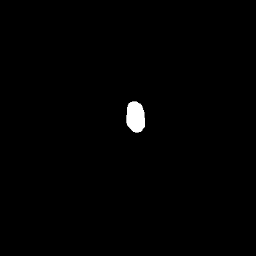

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_01_nuc.bmp
Extracted 108 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/047_01_cyt.dat


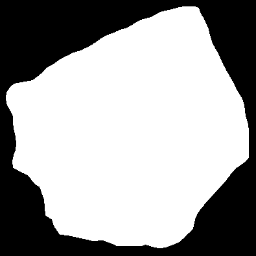

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_01_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/095_07_nuc.dat


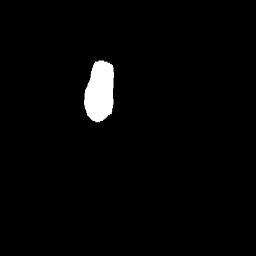

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_07_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/095_07_cyt.dat


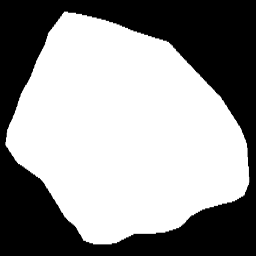

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_07_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/078_02_nuc.dat


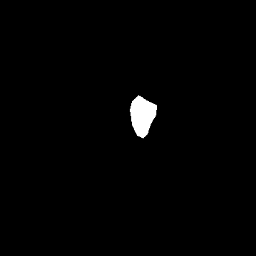

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_02_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/078_02_cyt.dat


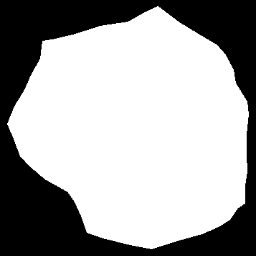

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_02_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/063_02_nuc.dat


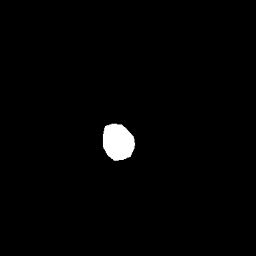

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_02_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/063_02_cyt.dat


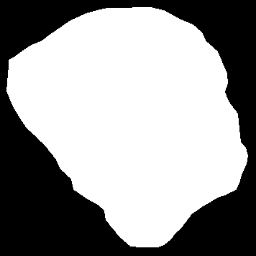

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_02_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/058_07_nuc.dat


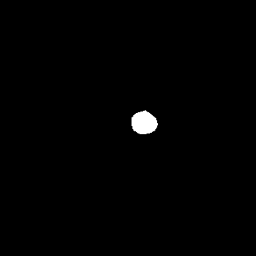

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_07_nuc.bmp
Extracted 77 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/058_07_cyt.dat


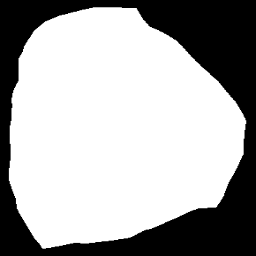

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_07_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/028_03_nuc.dat


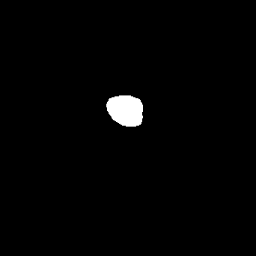

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_03_nuc.bmp
Extracted 72 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/028_03_cyt.dat


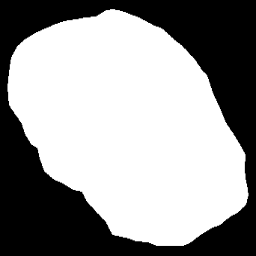

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_03_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_10_nuc.dat


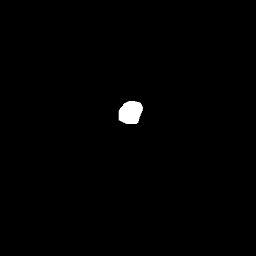

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_10_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_10_cyt.dat


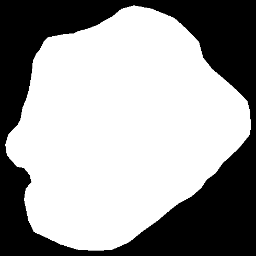

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_10_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/054_02_nuc.dat


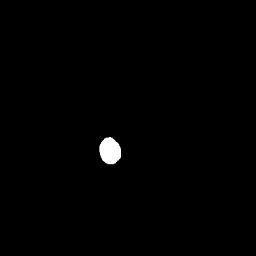

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_02_nuc.bmp
Extracted 97 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/054_02_cyt.dat


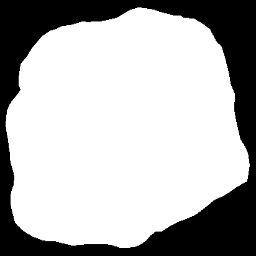

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_02_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/102_03_nuc.dat


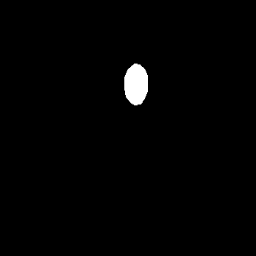

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_03_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/102_03_cyt.dat


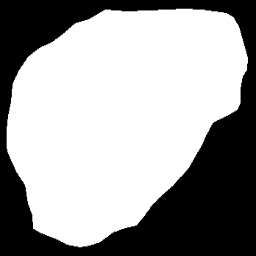

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_03_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/075_02_nuc.dat


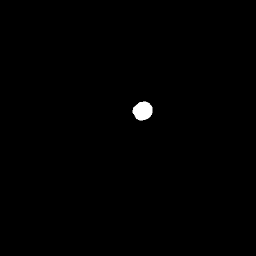

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_02_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/075_02_cyt.dat


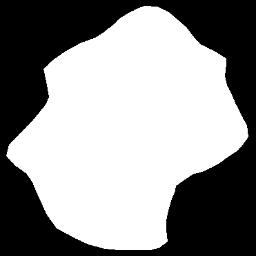

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_02_cyt.bmp
Extracted 11 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/001_01_nuc.dat


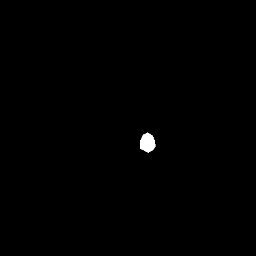

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_01_nuc.bmp
Extracted 68 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/001_01_cyt.dat


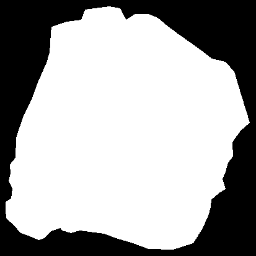

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/025_05_nuc.dat


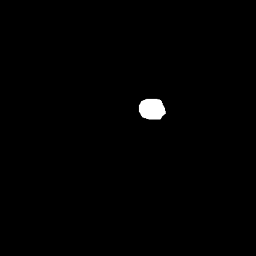

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_05_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/025_05_cyt.dat


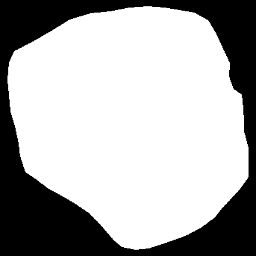

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_05_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/059_02_nuc.dat


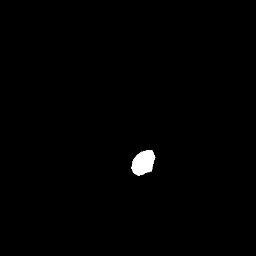

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/059_02_nuc.bmp
Extracted 58 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/059_02_cyt.dat


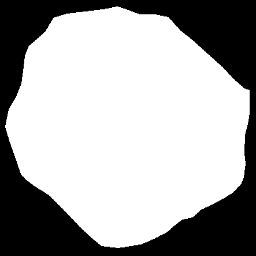

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/059_02_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/031_05_nuc.dat


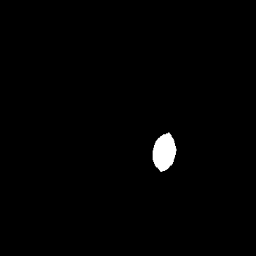

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/031_05_nuc.bmp
Extracted 103 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/031_05_cyt.dat


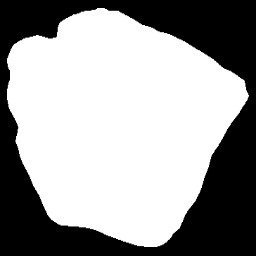

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/031_05_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_17_nuc.dat


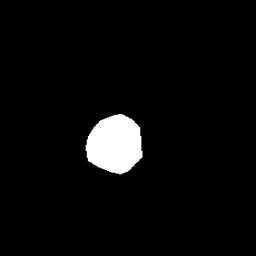

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_17_nuc.bmp
Extracted 33 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_17_cyt.dat


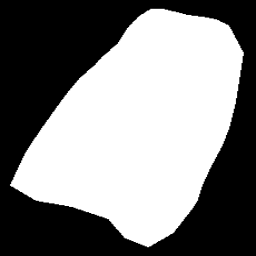

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_17_cyt.bmp
Extracted 10 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_06_nuc.dat


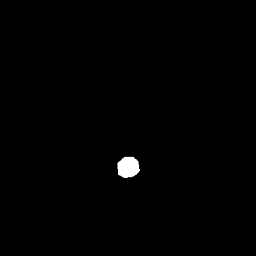

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_06_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_06_cyt.dat


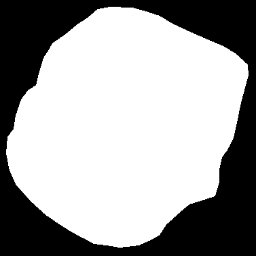

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_06_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/091_01_nuc.dat


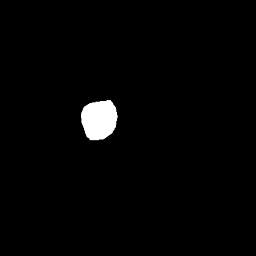

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/091_01_nuc.bmp
Extracted 41 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/091_01_cyt.dat


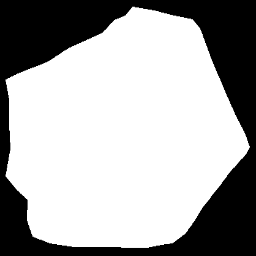

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/091_01_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_08_nuc.dat


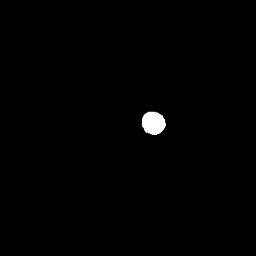

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_08_nuc.bmp
Extracted 96 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_08_cyt.dat


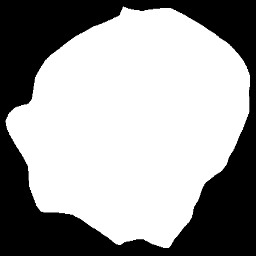

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_08_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/120_03_nuc.dat


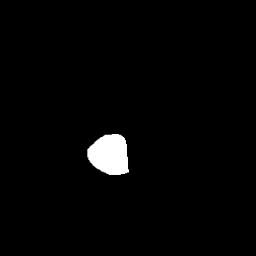

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/120_03_nuc.bmp
Extracted 40 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/120_03_cyt.dat


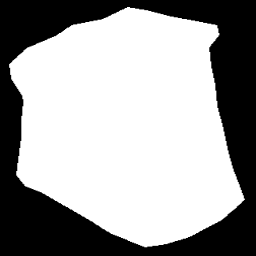

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/120_03_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/105_03_nuc.dat


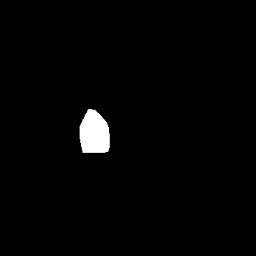

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/105_03_nuc.bmp
Extracted 47 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/105_03_cyt.dat


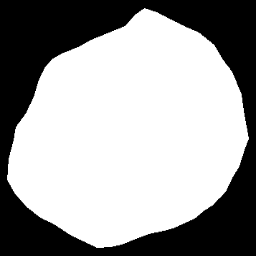

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/105_03_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/082_05_nuc.dat


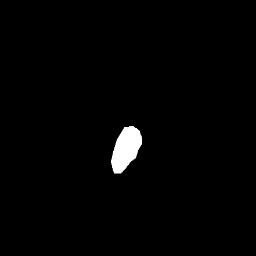

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/082_05_nuc.bmp
Extracted 60 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/082_05_cyt.dat


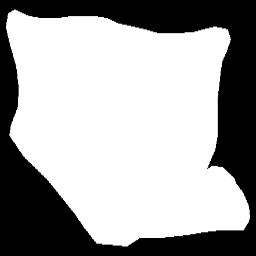

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/082_05_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/028_02_nuc.dat


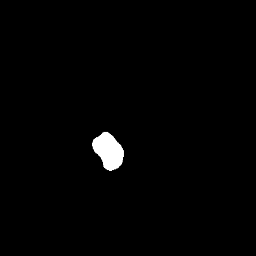

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_02_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/028_02_cyt.dat


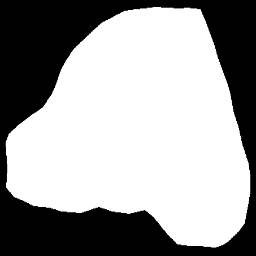

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_02_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/071_04_nuc.dat


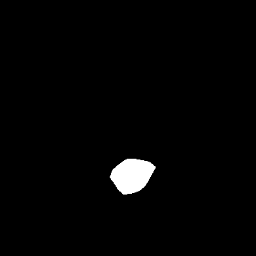

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_04_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/071_04_cyt.dat


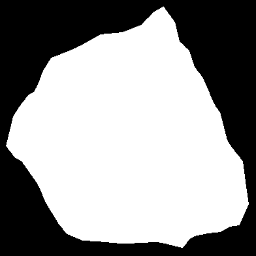

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_04_cyt.bmp
Extracted 38 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/030_04_nuc.dat


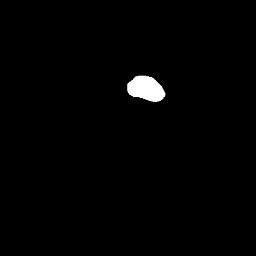

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/030_04_nuc.bmp
Extracted 68 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/030_04_cyt.dat


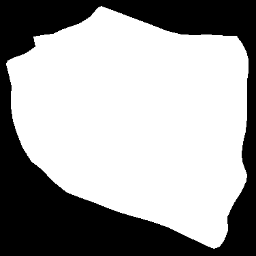

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/030_04_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/041_02_nuc.dat


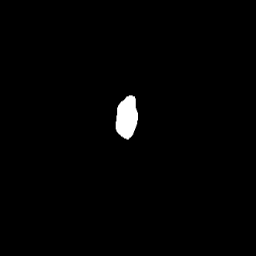

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/041_02_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/041_02_cyt.dat


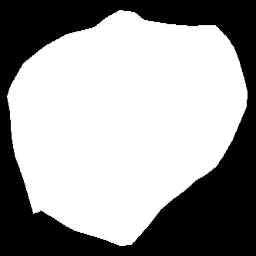

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/041_02_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_06_nuc.dat


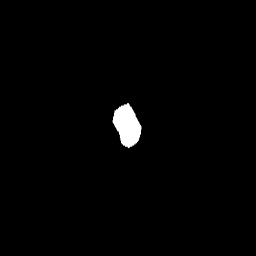

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_06_nuc.bmp
Extracted 75 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_06_cyt.dat


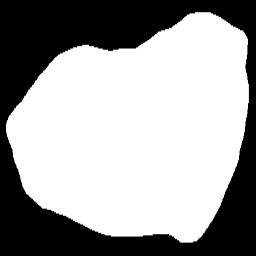

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_06_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_06_nuc.dat


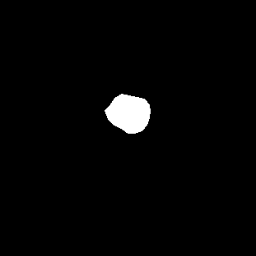

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_06_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_06_cyt.dat


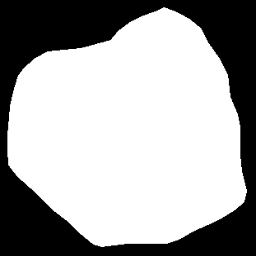

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_06_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_01_nuc.dat


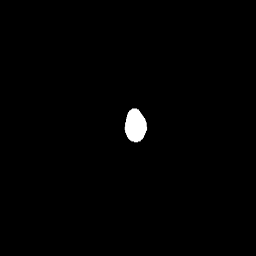

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_01_nuc.bmp
Extracted 95 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_01_cyt.dat


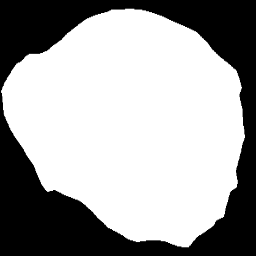

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_01_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/036_01_nuc.dat


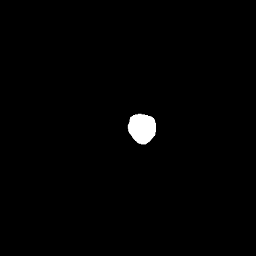

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/036_01_nuc.bmp
Extracted 112 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/036_01_cyt.dat


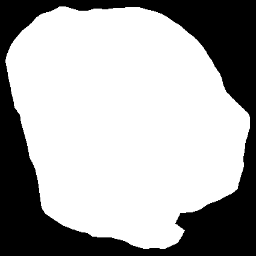

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/036_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/104_01_nuc.dat


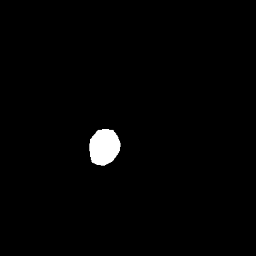

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/104_01_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/104_01_cyt.dat


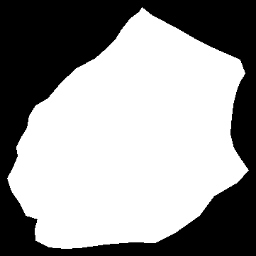

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/104_01_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/037_05_nuc.dat


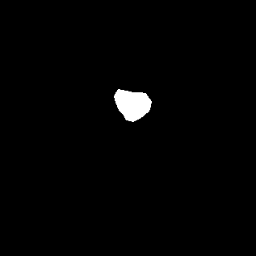

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/037_05_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/037_05_cyt.dat


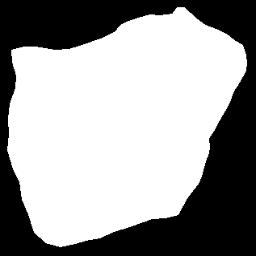

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/037_05_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_03_nuc.dat


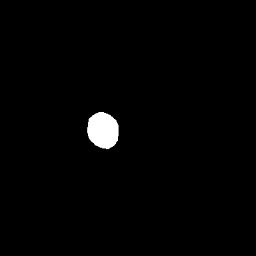

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_03_nuc.bmp
Extracted 76 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_03_cyt.dat


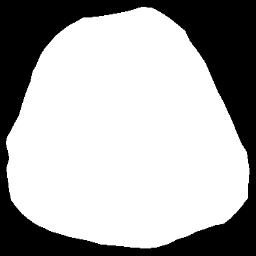

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_03_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_07_nuc.dat


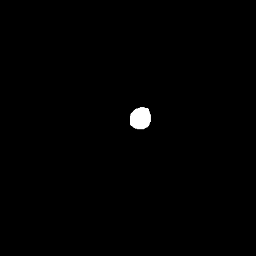

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_07_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_07_cyt.dat


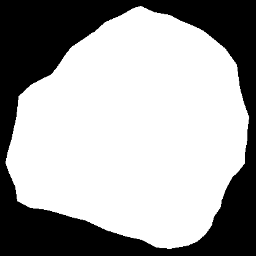

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_07_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/123_07_nuc.dat


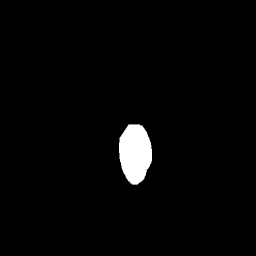

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_07_nuc.bmp
Extracted 26 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/123_07_cyt.dat


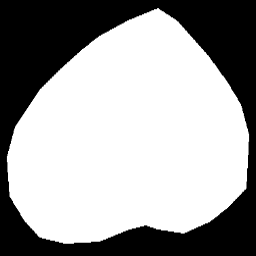

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_07_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/113_03_nuc.dat


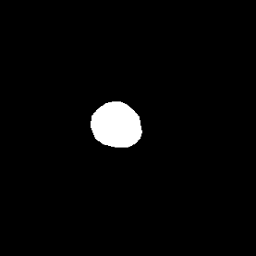

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/113_03_nuc.bmp
Extracted 40 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/113_03_cyt.dat


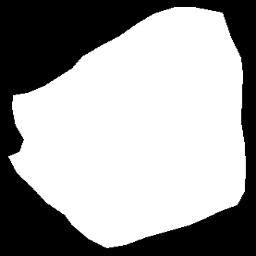

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/113_03_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/108_02_nuc.dat


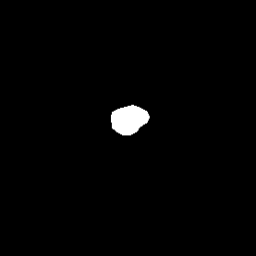

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_02_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/108_02_cyt.dat


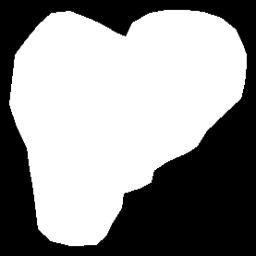

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_02_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_04_nuc.dat


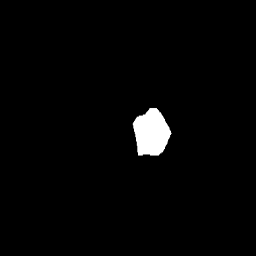

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/061_04_nuc.bmp
Extracted 69 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_04_cyt.dat


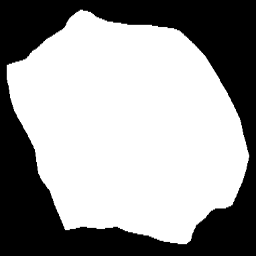

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/061_04_cyt.bmp
Extracted 28 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_09_nuc.dat


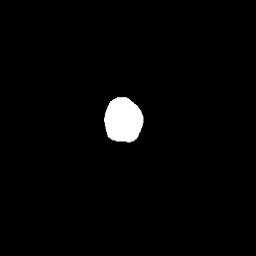

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_09_nuc.bmp
Extracted 99 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_09_cyt.dat


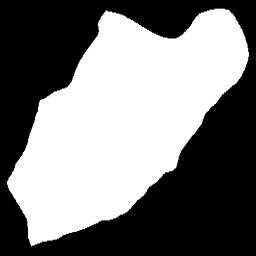

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_09_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_01_nuc.dat


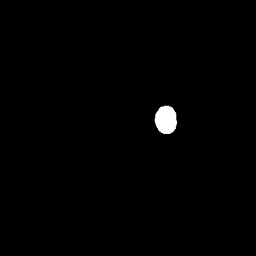

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_01_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_01_cyt.dat


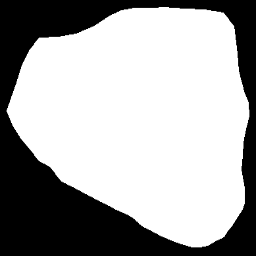

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_01_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/027_04_nuc.dat


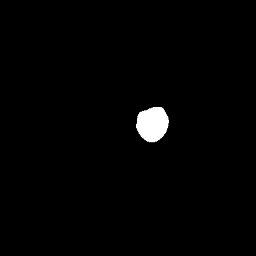

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_04_nuc.bmp
Extracted 92 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/027_04_cyt.dat


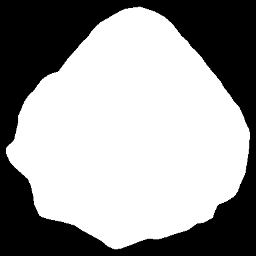

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_04_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/062_06_nuc.dat


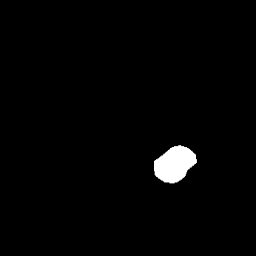

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_06_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/062_06_cyt.dat


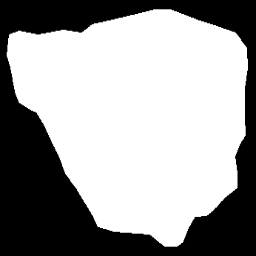

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_06_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/123_01_nuc.dat


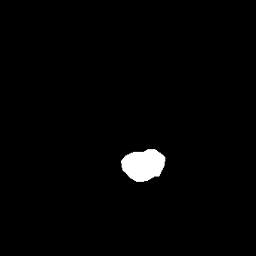

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_01_nuc.bmp
Extracted 37 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/123_01_cyt.dat


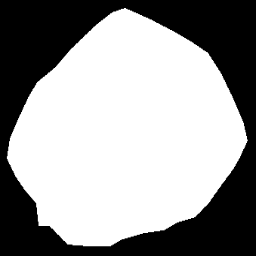

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_01_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_05_nuc.dat


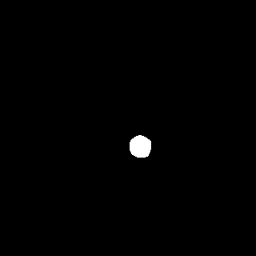

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_05_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_05_cyt.dat


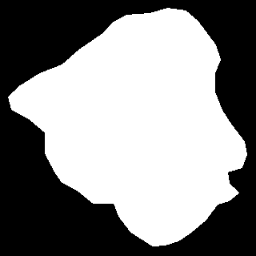

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_05_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/063_03_nuc.dat


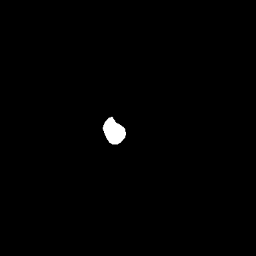

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_03_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/063_03_cyt.dat


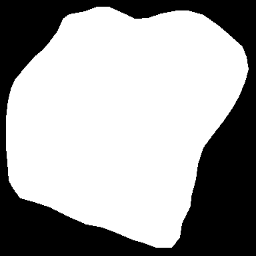

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_03_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/053_07_nuc.dat


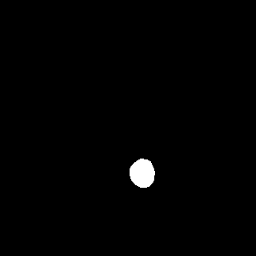

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_07_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/053_07_cyt.dat


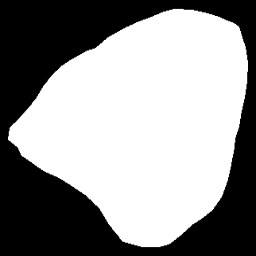

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_07_cyt.bmp
Extracted 12 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/052_02_nuc.dat


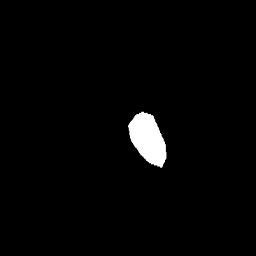

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_02_nuc.bmp
Extracted 38 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/052_02_cyt.dat


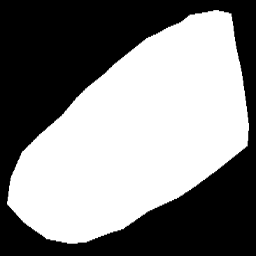

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_02_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_03_nuc.dat


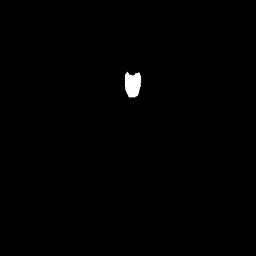

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_03_nuc.bmp
Extracted 77 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_03_cyt.dat


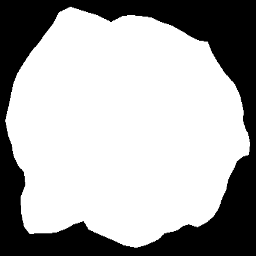

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_03_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_06_nuc.dat


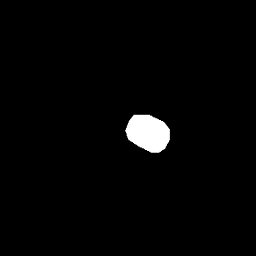

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_06_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_06_cyt.dat


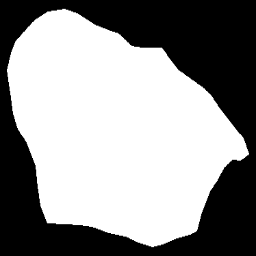

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_06_cyt.bmp
Extracted 26 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/040_01_nuc.dat


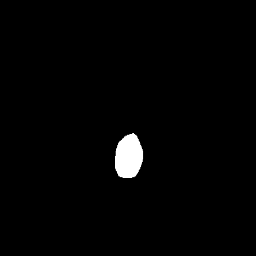

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/040_01_nuc.bmp
Extracted 112 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/040_01_cyt.dat


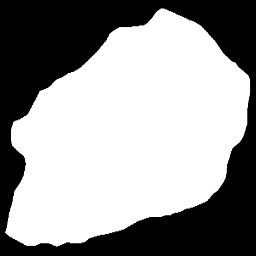

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/040_01_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/109_01_nuc.dat


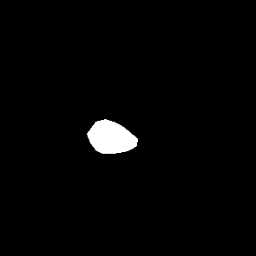

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/109_01_nuc.bmp
Extracted 35 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/109_01_cyt.dat


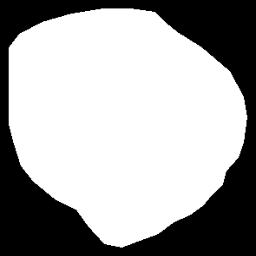

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/109_01_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_09_nuc.dat


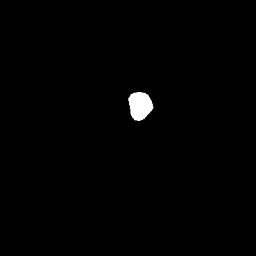

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_09_nuc.bmp
Extracted 79 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_09_cyt.dat


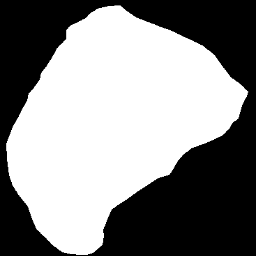

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_09_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/027_05_nuc.dat


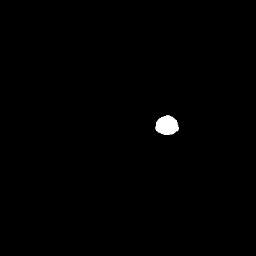

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_05_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/027_05_cyt.dat


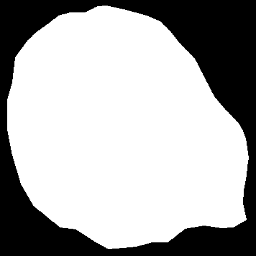

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_05_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/051_04_nuc.dat


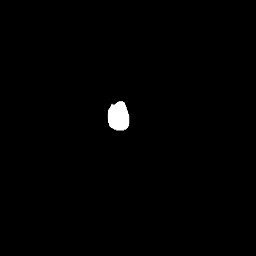

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/051_04_nuc.bmp
Extracted 58 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/051_04_cyt.dat


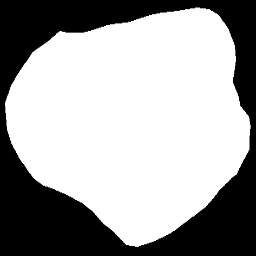

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/051_04_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_06_nuc.dat


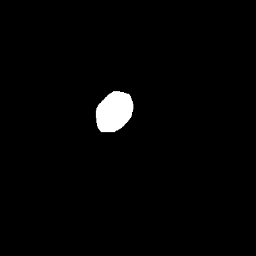

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_06_nuc.bmp
Extracted 90 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_06_cyt.dat


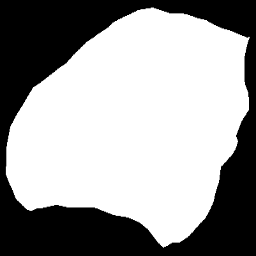

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_06_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_21_nuc.dat


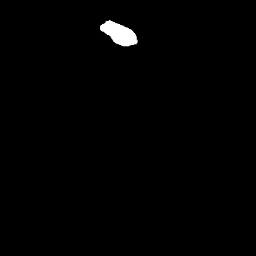

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_21_nuc.bmp
Extracted 106 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_21_cyt.dat


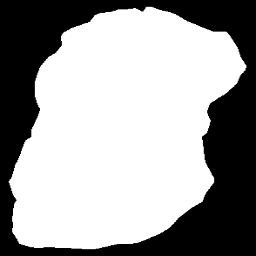

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_21_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_05_nuc.dat


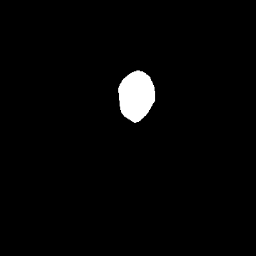

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/029_05_nuc.bmp
Extracted 71 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_05_cyt.dat


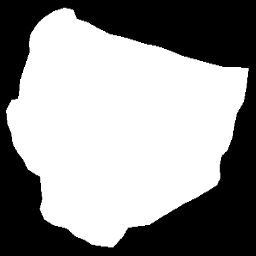

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/029_05_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/056_07_nuc.dat


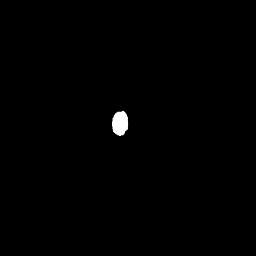

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_07_nuc.bmp
Extracted 87 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/056_07_cyt.dat


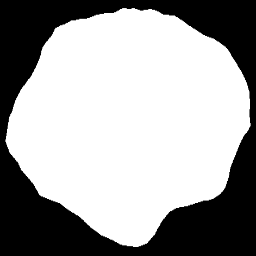

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_07_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_07_nuc.dat


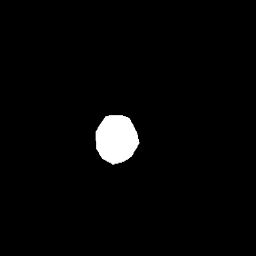

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_07_nuc.bmp
Extracted 41 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_07_cyt.dat


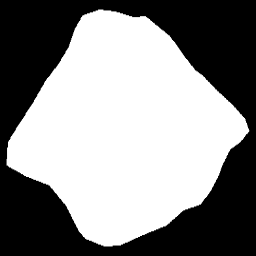

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_07_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/107_01_nuc.dat


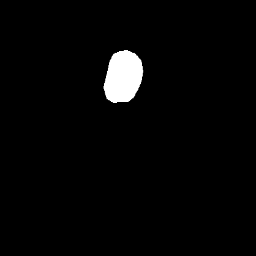

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_01_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/107_01_cyt.dat


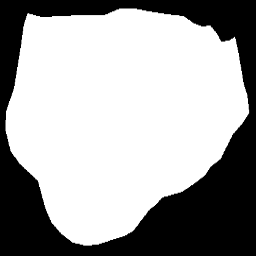

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_01_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/075_03_nuc.dat


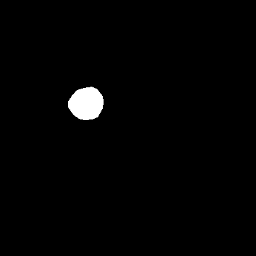

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_03_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/075_03_cyt.dat


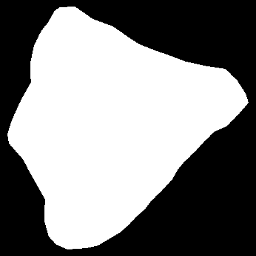

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_03_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/115_06_nuc.dat


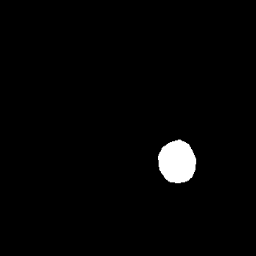

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/115_06_nuc.bmp
Extracted 41 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/115_06_cyt.dat


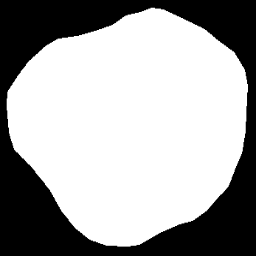

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/115_06_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/026_04_nuc.dat


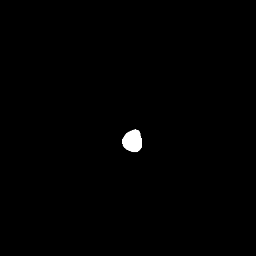

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/026_04_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/026_04_cyt.dat


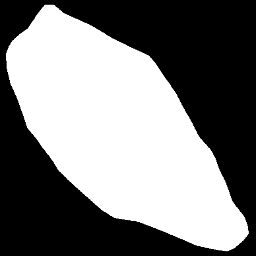

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/026_04_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/063_06_nuc.dat


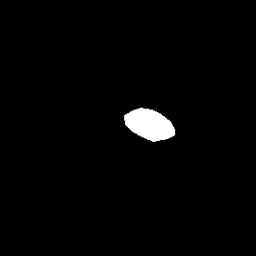

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_06_nuc.bmp
Extracted 79 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/063_06_cyt.dat


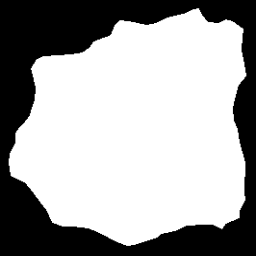

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_06_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_09_nuc.dat


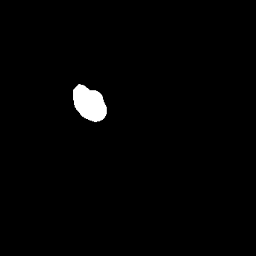

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/118_09_nuc.bmp
Extracted 36 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_09_cyt.dat


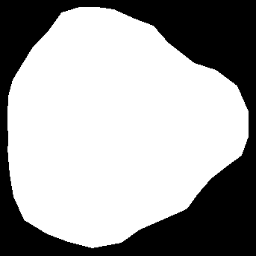

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/118_09_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/114_07_nuc.dat


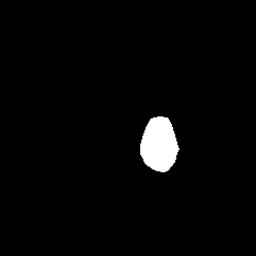

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/114_07_nuc.bmp
Extracted 40 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/114_07_cyt.dat


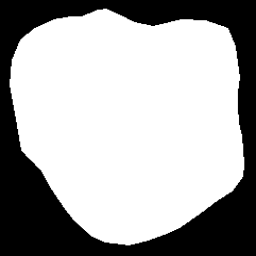

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/114_07_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/005_03_nuc.dat


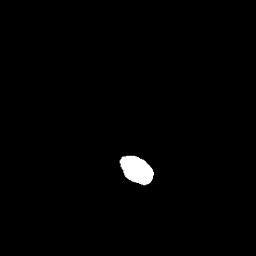

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_03_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/005_03_cyt.dat


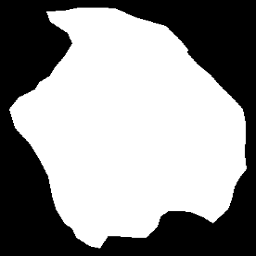

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_03_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_04_nuc.dat


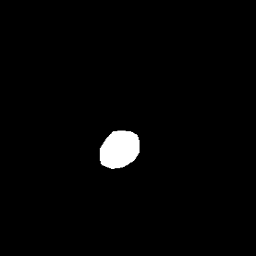

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_04_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_04_cyt.dat


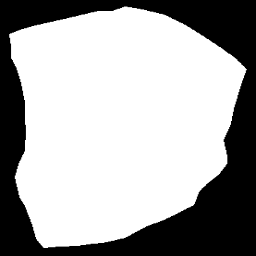

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_04_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_02_nuc.dat


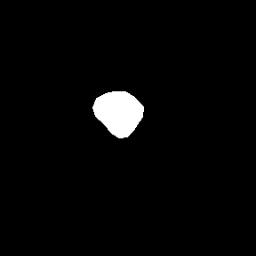

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_02_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_02_cyt.dat


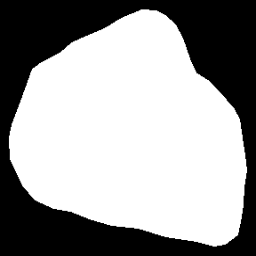

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_02_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_03_nuc.dat


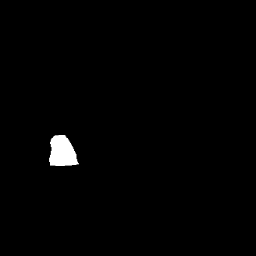

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_03_nuc.bmp
Extracted 66 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_03_cyt.dat


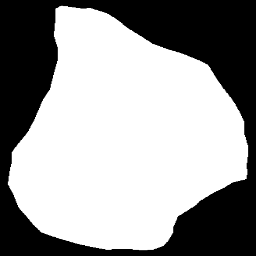

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_03_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/051_01_nuc.dat


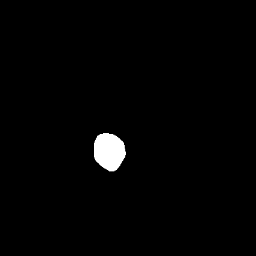

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/051_01_nuc.bmp
Extracted 95 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/051_01_cyt.dat


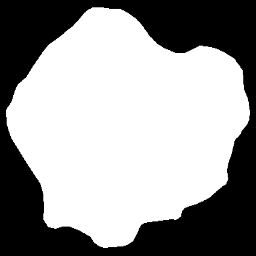

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/051_01_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_12_nuc.dat


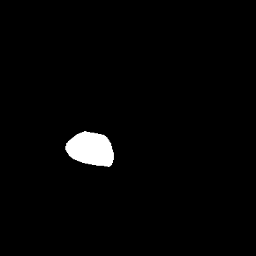

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_12_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_12_cyt.dat


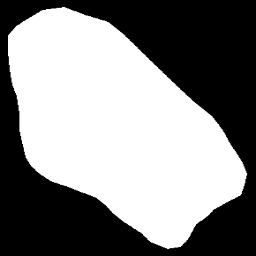

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_12_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/051_02_nuc.dat


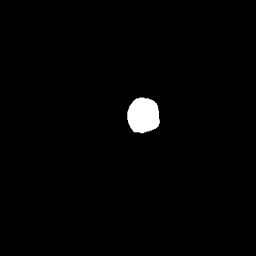

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/051_02_nuc.bmp
Extracted 85 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/051_02_cyt.dat


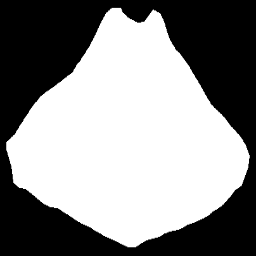

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/051_02_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_04_nuc.dat


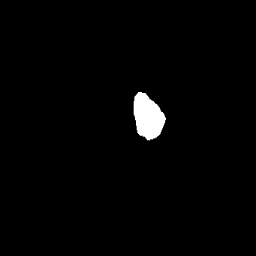

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/119_04_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_04_cyt.dat


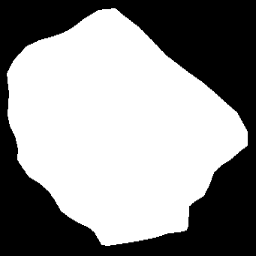

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/119_04_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/055_07_nuc.dat


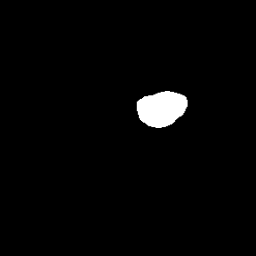

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/055_07_nuc.bmp
Extracted 58 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/055_07_cyt.dat


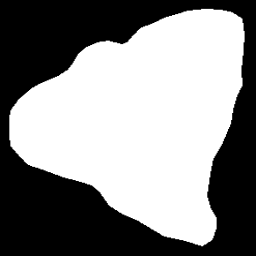

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/055_07_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_03_nuc.dat


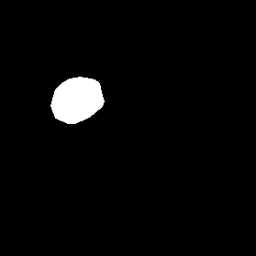

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_03_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_03_cyt.dat


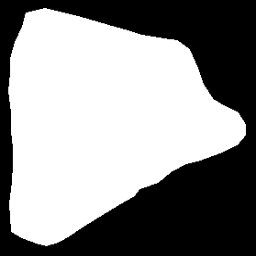

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_03_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_08_nuc.dat


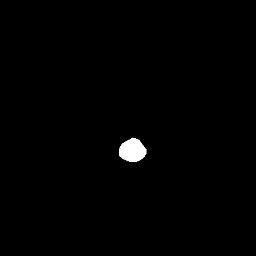

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_08_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_08_cyt.dat


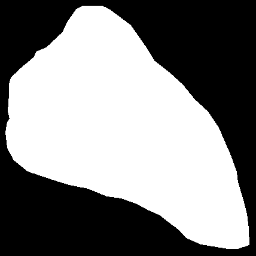

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_08_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_12_nuc.dat


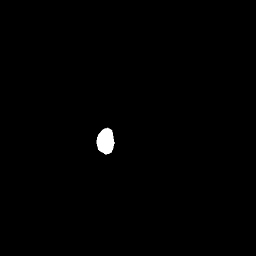

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_12_nuc.bmp
Extracted 64 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_12_cyt.dat


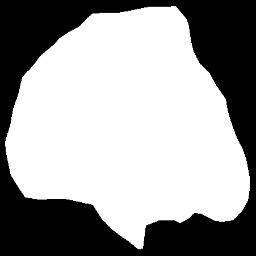

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_12_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_08_nuc.dat


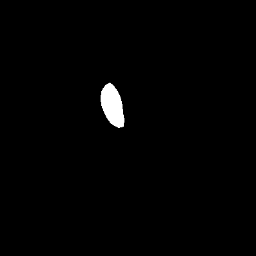

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_08_nuc.bmp
Extracted 97 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_08_cyt.dat


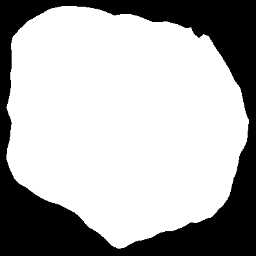

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_08_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_06_nuc.dat


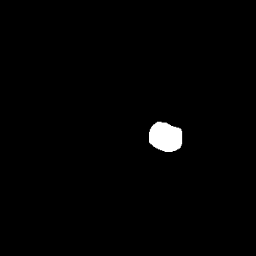

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_06_nuc.bmp
Extracted 87 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_06_cyt.dat


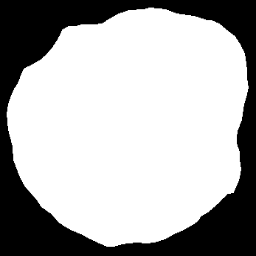

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_06_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/050_01_nuc.dat


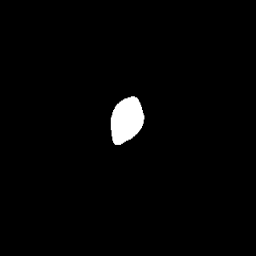

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_01_nuc.bmp
Extracted 93 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/050_01_cyt.dat


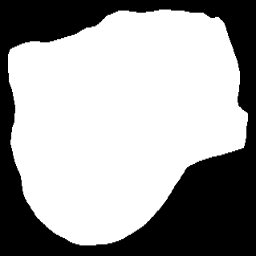

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_01_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_08_nuc.dat


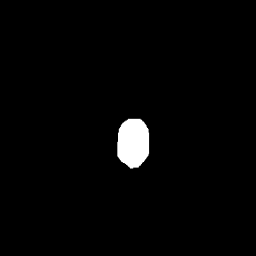

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/119_08_nuc.bmp
Extracted 42 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_08_cyt.dat


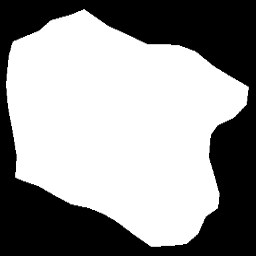

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/119_08_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/049_01_nuc.dat


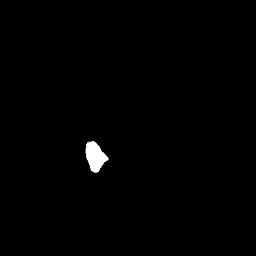

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_01_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/049_01_cyt.dat


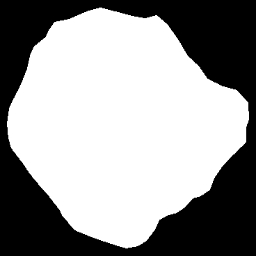

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_01_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_06_nuc.dat


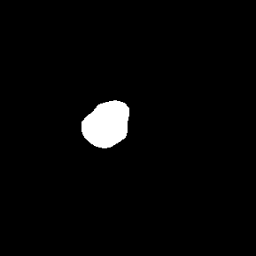

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/029_06_nuc.bmp
Extracted 65 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_06_cyt.dat


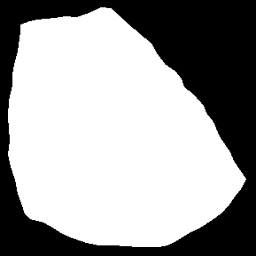

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/029_06_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_11_nuc.dat


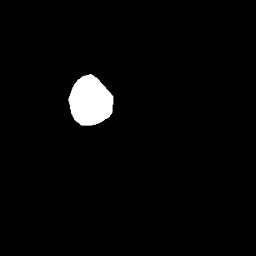

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_11_nuc.bmp
Extracted 77 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_11_cyt.dat


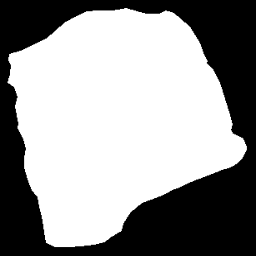

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_11_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_08_nuc.dat


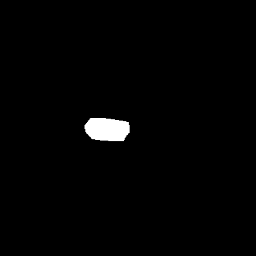

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_08_nuc.bmp
Extracted 73 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_08_cyt.dat


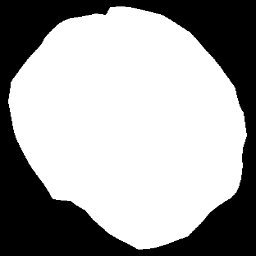

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_08_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/026_02_nuc.dat


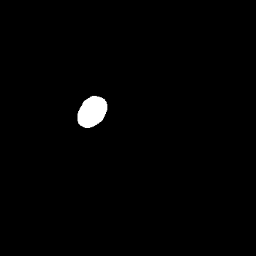

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/026_02_nuc.bmp
Extracted 83 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/026_02_cyt.dat


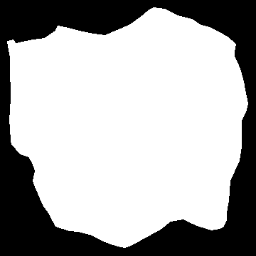

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/026_02_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/018_02_nuc.dat


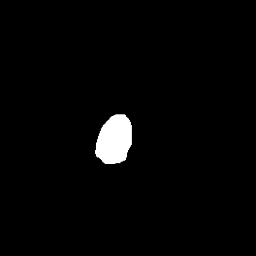

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_02_nuc.bmp
Extracted 83 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/018_02_cyt.dat


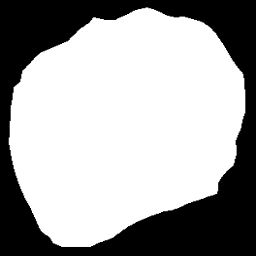

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_02_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_04_nuc.dat


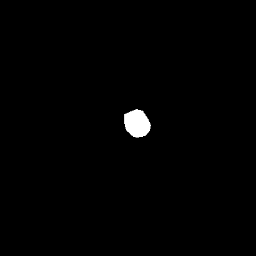

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_04_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_04_cyt.dat


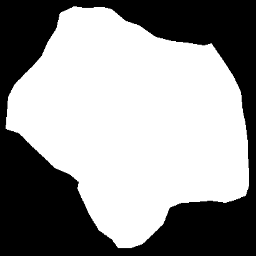

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_04_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/104_02_nuc.dat


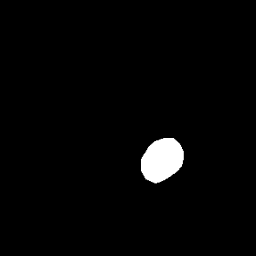

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/104_02_nuc.bmp
Extracted 31 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/104_02_cyt.dat


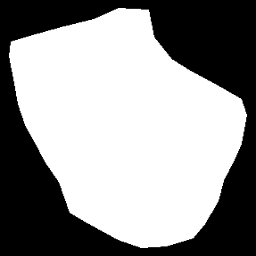

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/104_02_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/111_01_nuc.dat


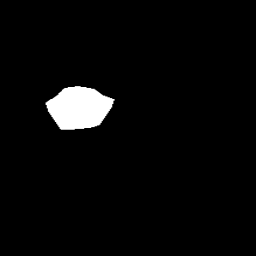

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/111_01_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/111_01_cyt.dat


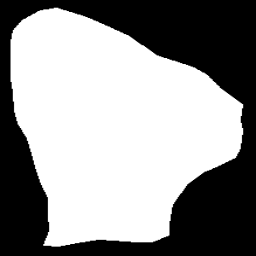

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/111_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_05_nuc.dat


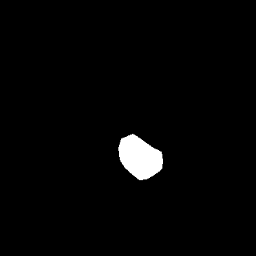

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_05_nuc.bmp
Extracted 47 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_05_cyt.dat


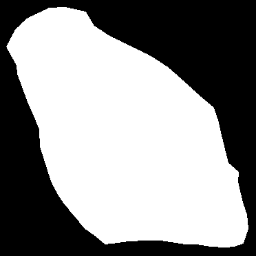

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_05_cyt.bmp
Extracted 27 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_03_nuc.dat


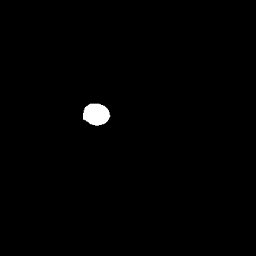

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_03_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_03_cyt.dat


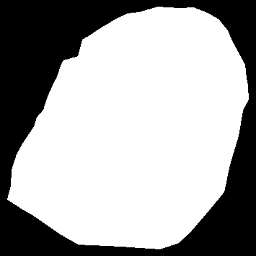

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_03_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/005_02_nuc.dat


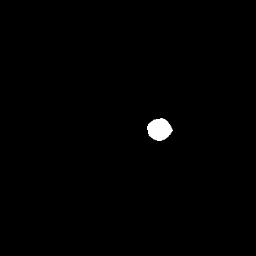

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_02_nuc.bmp
Extracted 71 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/005_02_cyt.dat


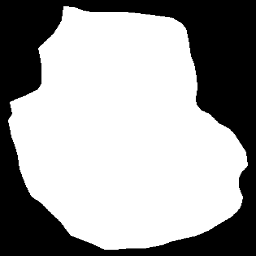

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_02_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/098_04_nuc.dat


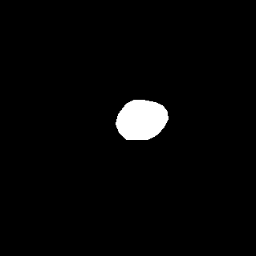

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_04_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/098_04_cyt.dat


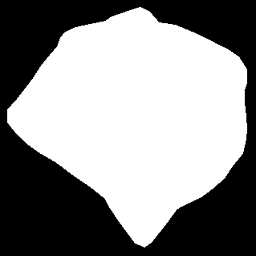

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_04_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/006_01_nuc.dat


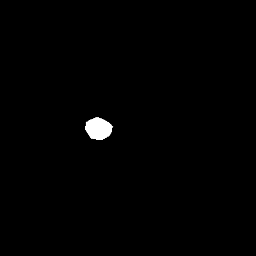

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_01_nuc.bmp
Extracted 72 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/006_01_cyt.dat


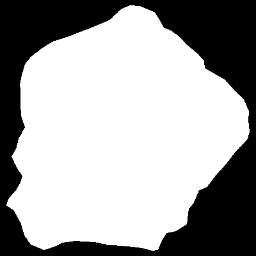

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_01_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/062_05_nuc.dat


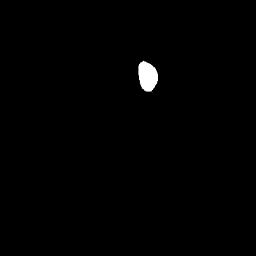

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_05_nuc.bmp
Extracted 61 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/062_05_cyt.dat


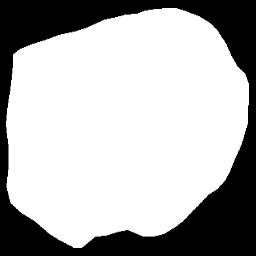

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_05_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/076_04_nuc.dat


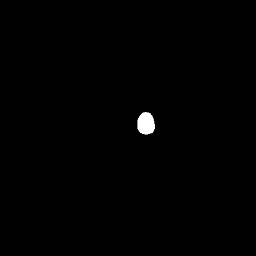

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/076_04_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/076_04_cyt.dat


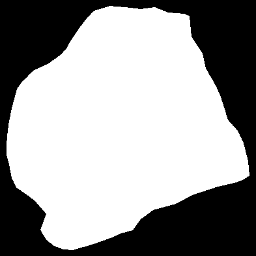

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/076_04_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/018_03_nuc.dat


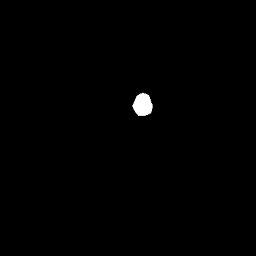

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_03_nuc.bmp
Extracted 97 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/018_03_cyt.dat


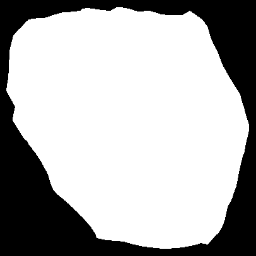

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_03_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_01_nuc.dat


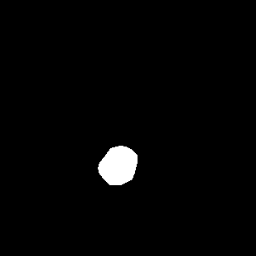

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_01_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_01_cyt.dat


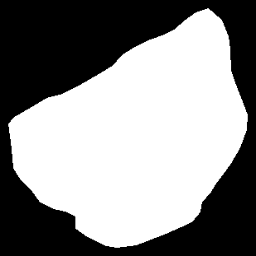

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_01_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/113_02_nuc.dat


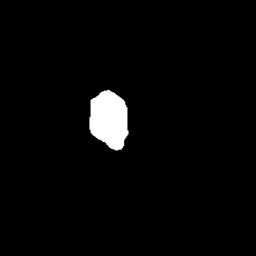

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/113_02_nuc.bmp
Extracted 65 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/113_02_cyt.dat


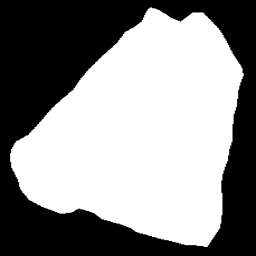

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/113_02_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_07_nuc.dat


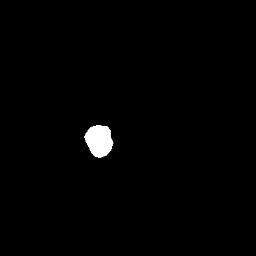

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_07_nuc.bmp
Extracted 85 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_07_cyt.dat


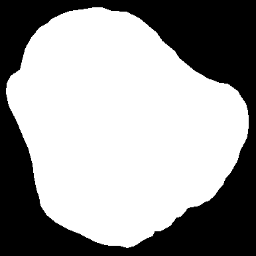

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_07_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/111_04_nuc.dat


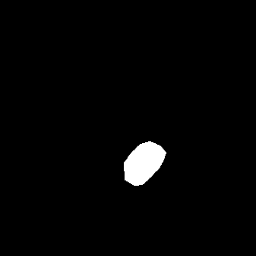

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/111_04_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/111_04_cyt.dat


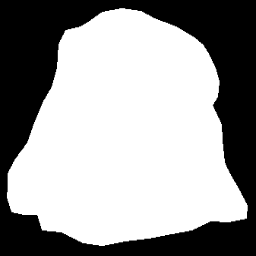

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/111_04_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/088_02_nuc.dat


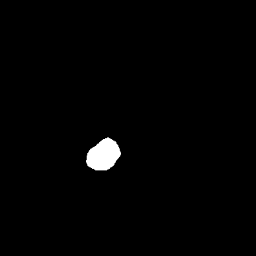

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/088_02_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/088_02_cyt.dat


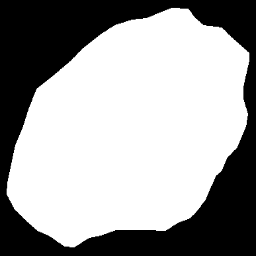

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/088_02_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_10_nuc.dat


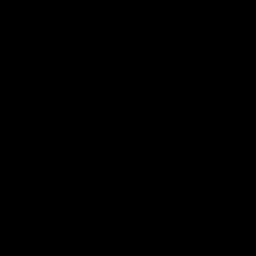

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_10_nuc.bmp
Extracted 75 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_10_cyt.dat


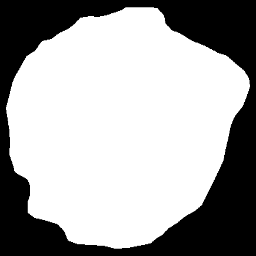

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_10_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/090_01_nuc.dat


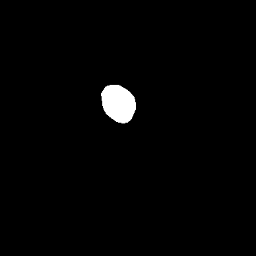

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/090_01_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/090_01_cyt.dat


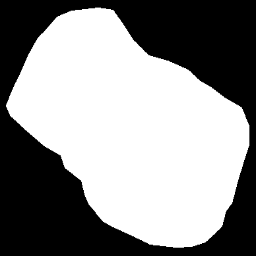

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/090_01_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_09_nuc.dat


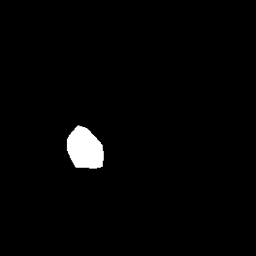

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_09_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_09_cyt.dat


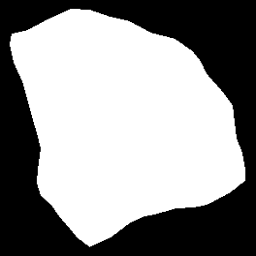

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_09_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/041_03_nuc.dat


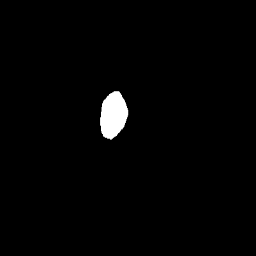

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/041_03_nuc.bmp
Extracted 61 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/041_03_cyt.dat


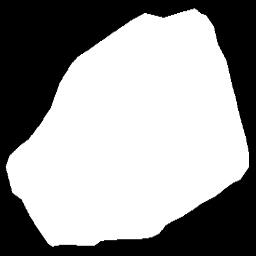

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/041_03_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_07_nuc.dat


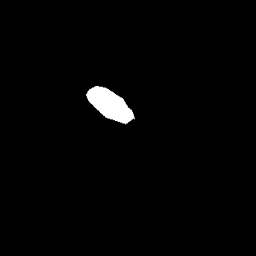

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_07_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_07_cyt.dat


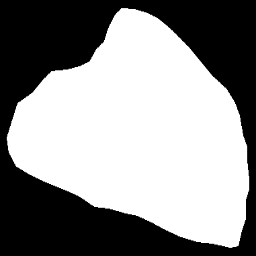

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_07_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/001_02_nuc.dat


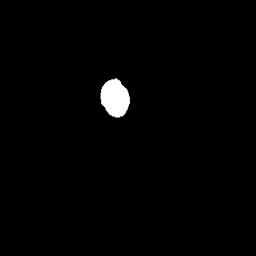

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_02_nuc.bmp
Extracted 74 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/001_02_cyt.dat


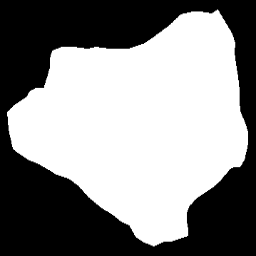

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_02_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/070_05_nuc.dat


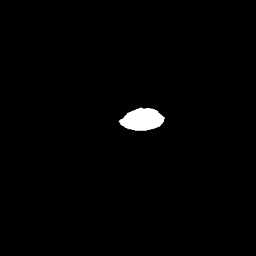

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_05_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/070_05_cyt.dat


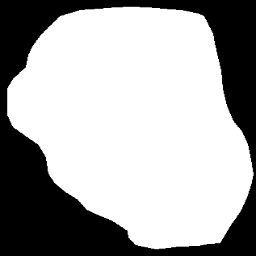

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_05_cyt.bmp
Extracted 26 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_10_nuc.dat


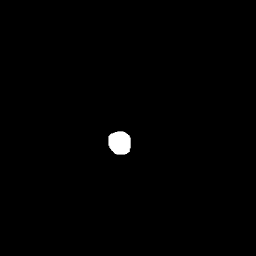

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_10_nuc.bmp
Extracted 78 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_10_cyt.dat


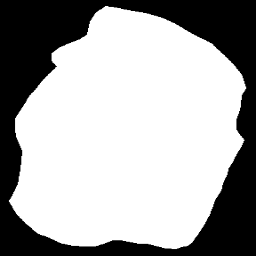

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_10_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/124_05_nuc.dat


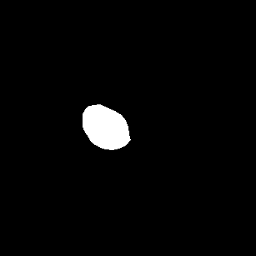

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/124_05_nuc.bmp
Extracted 42 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/124_05_cyt.dat


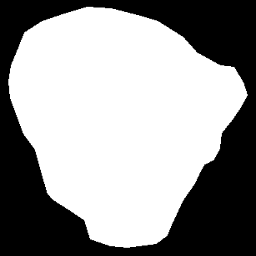

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/124_05_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/048_02_nuc.dat


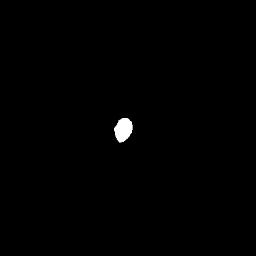

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_02_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/048_02_cyt.dat


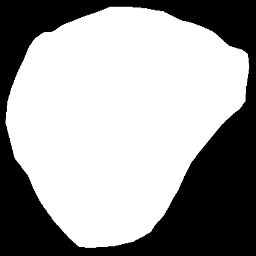

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_02_cyt.bmp
Extracted 11 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/062_04_nuc.dat


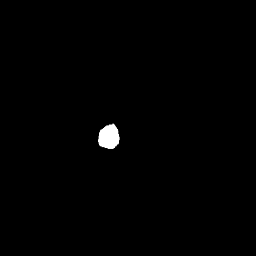

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_04_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/062_04_cyt.dat


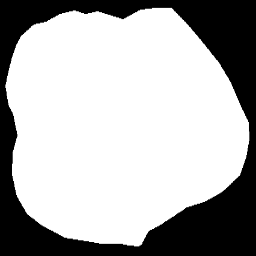

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_04_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_04_nuc.dat


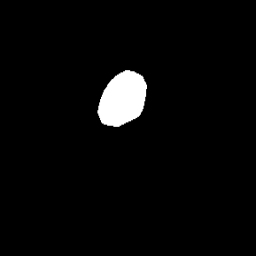

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_04_nuc.bmp
Extracted 45 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_04_cyt.dat


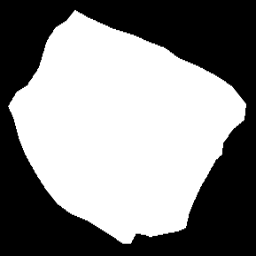

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_04_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/037_04_nuc.dat


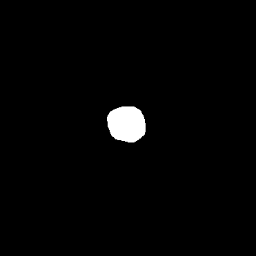

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/037_04_nuc.bmp
Extracted 80 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/037_04_cyt.dat


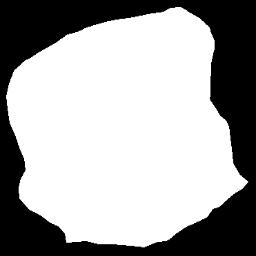

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/037_04_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_02_nuc.dat


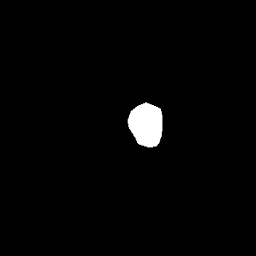

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_02_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_02_cyt.dat


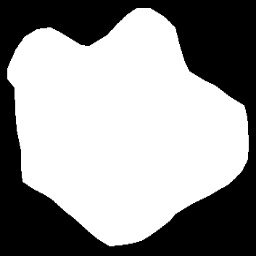

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_02_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/105_02_nuc.dat


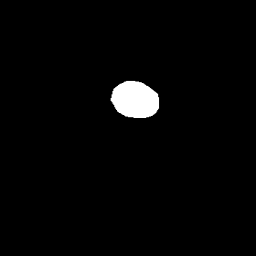

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/105_02_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/105_02_cyt.dat


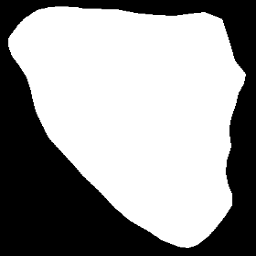

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/105_02_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_22_nuc.dat


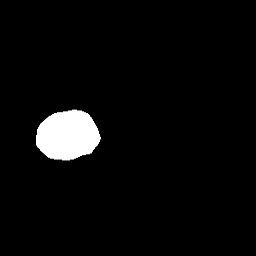

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_22_nuc.bmp
Extracted 77 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_22_cyt.dat


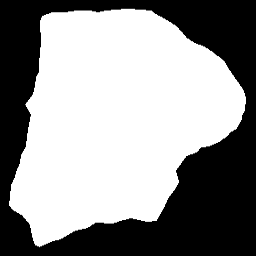

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_22_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_09_nuc.dat


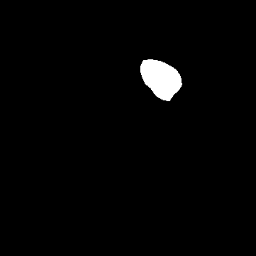

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_09_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_09_cyt.dat


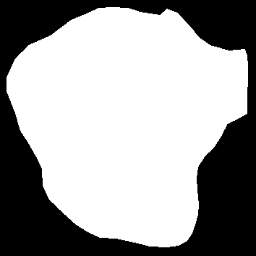

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_09_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_05_nuc.dat


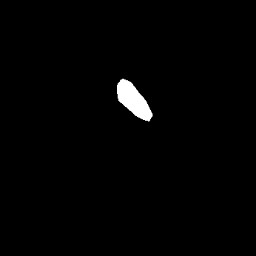

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_05_nuc.bmp
Extracted 41 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_05_cyt.dat


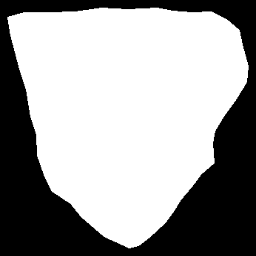

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_05_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/081_03_nuc.dat


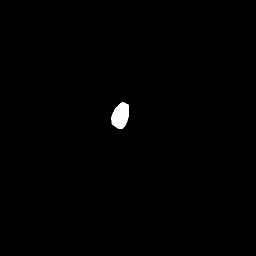

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_03_nuc.bmp
Extracted 61 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/081_03_cyt.dat


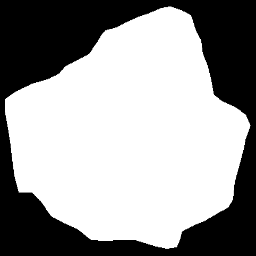

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_03_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/040_02_nuc.dat


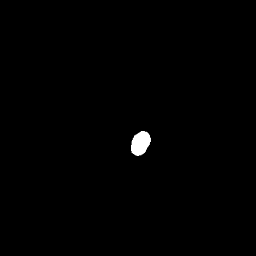

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/040_02_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/040_02_cyt.dat


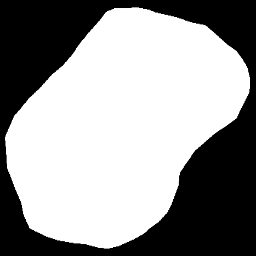

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/040_02_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/033_02_nuc.dat


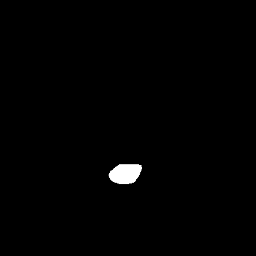

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/033_02_nuc.bmp
Extracted 64 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/033_02_cyt.dat


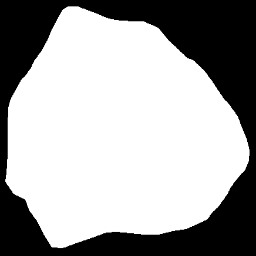

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/033_02_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/039_01_nuc.dat


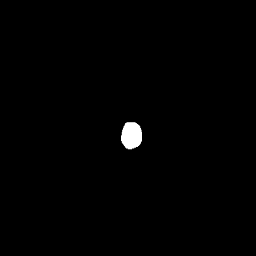

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/039_01_nuc.bmp
Extracted 117 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/039_01_cyt.dat


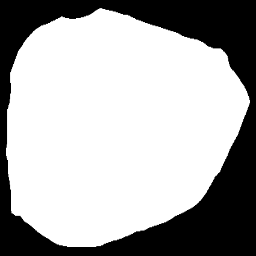

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/039_01_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_11_nuc.dat


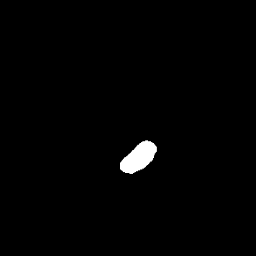

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_11_nuc.bmp
Extracted 67 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_11_cyt.dat


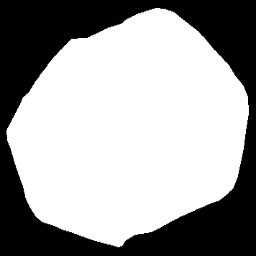

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_11_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_12_nuc.dat


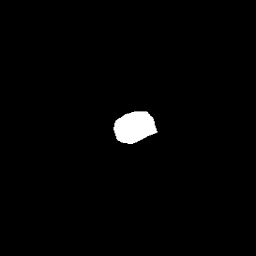

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_12_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_12_cyt.dat


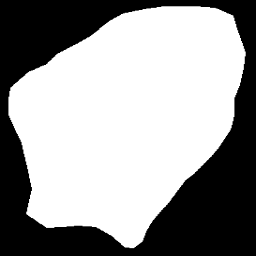

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_12_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/059_01_nuc.dat


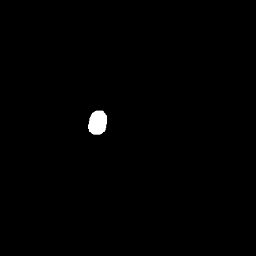

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/059_01_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/059_01_cyt.dat


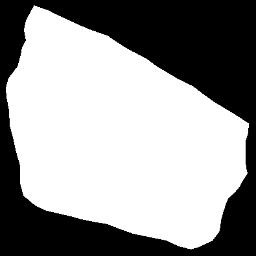

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/059_01_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/072_03_nuc.dat


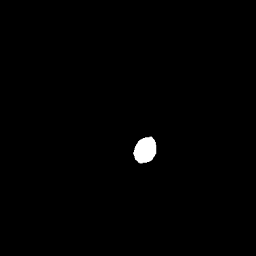

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_03_nuc.bmp
Extracted 58 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/072_03_cyt.dat


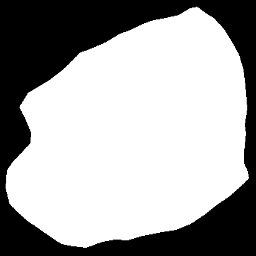

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_03_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_03_nuc.dat


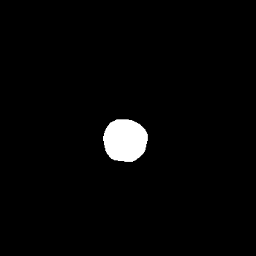

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/118_03_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_03_cyt.dat


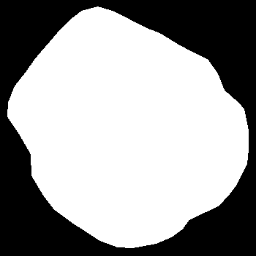

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/118_03_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/113_01_nuc.dat


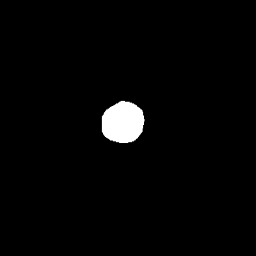

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/113_01_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/113_01_cyt.dat


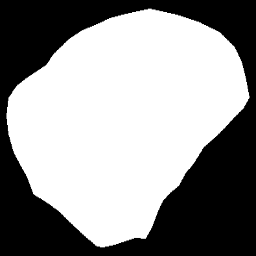

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/113_01_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_05_nuc.dat


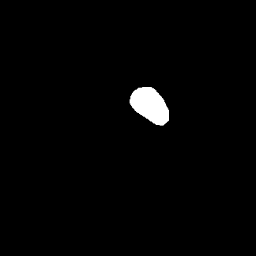

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_05_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_05_cyt.dat


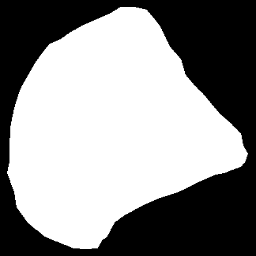

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_05_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_02_nuc.dat


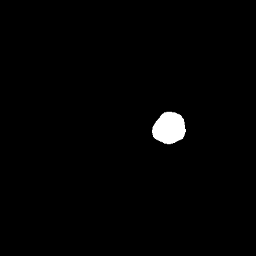

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_02_nuc.bmp
Extracted 76 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_02_cyt.dat


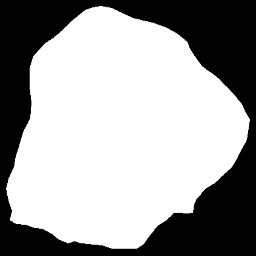

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_02_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_05_nuc.dat


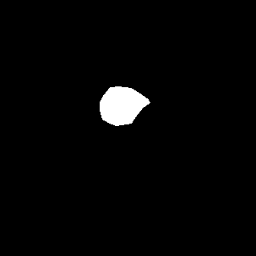

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_05_nuc.bmp
Extracted 60 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_05_cyt.dat


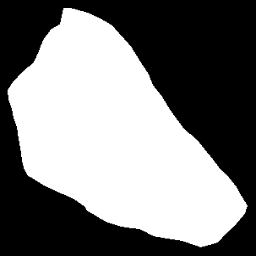

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_05_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_05_nuc.dat


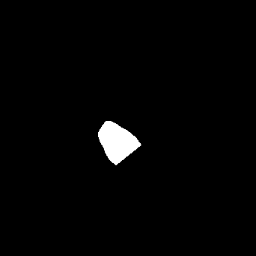

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_05_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_05_cyt.dat


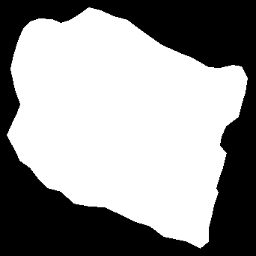

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_05_cyt.bmp
Extracted 11 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/062_03_nuc.dat


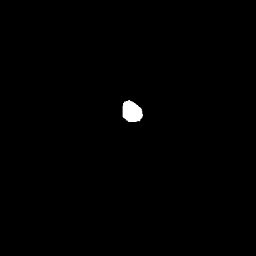

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_03_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/062_03_cyt.dat


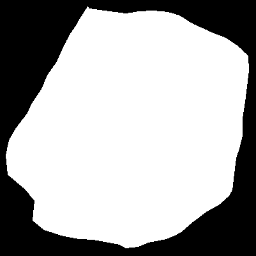

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_03_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_03_nuc.dat


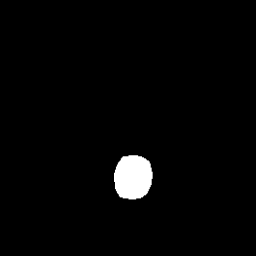

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_03_nuc.bmp
Extracted 47 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_03_cyt.dat


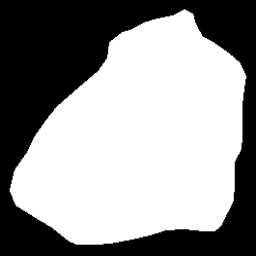

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_03_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_02_nuc.dat


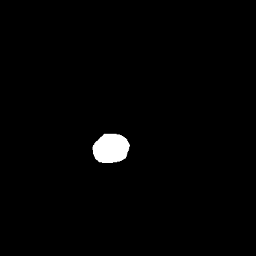

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_02_nuc.bmp
Extracted 74 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_02_cyt.dat


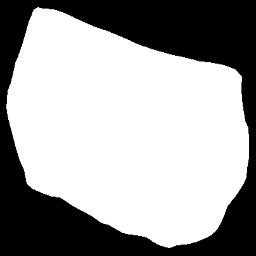

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_02_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/107_03_nuc.dat


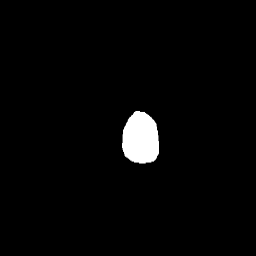

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_03_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/107_03_cyt.dat


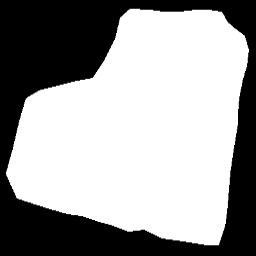

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_03_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_08_nuc.dat


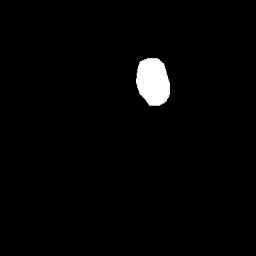

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_08_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_08_cyt.dat


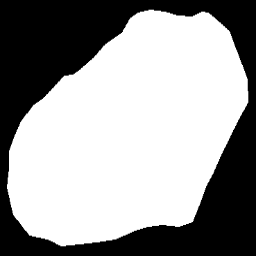

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_08_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_08_nuc.dat


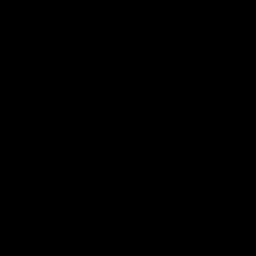

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_08_nuc.bmp
Extracted 45 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_08_cyt.dat


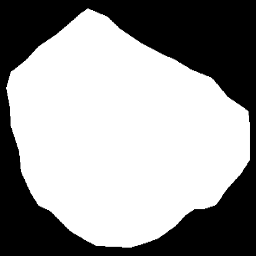

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_08_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/086_04_nuc.dat


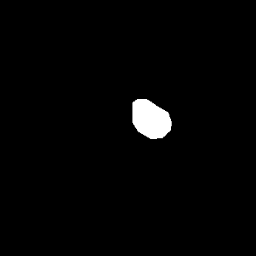

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_04_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/086_04_cyt.dat


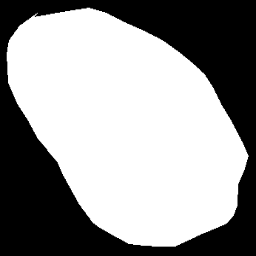

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_04_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/074_03_nuc.dat


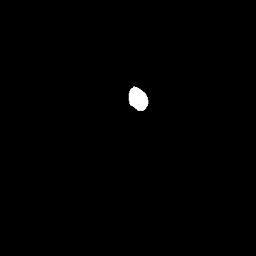

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/074_03_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/074_03_cyt.dat


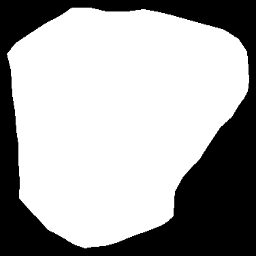

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/074_03_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/053_04_nuc.dat


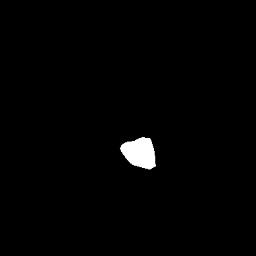

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_04_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/053_04_cyt.dat


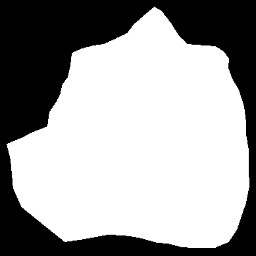

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_04_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/108_04_nuc.dat


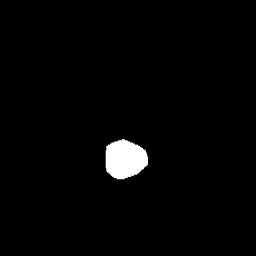

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_04_nuc.bmp
Extracted 41 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/108_04_cyt.dat


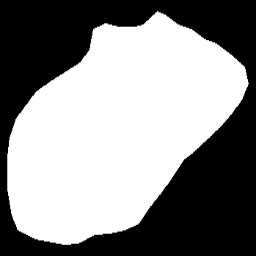

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_04_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_09_nuc.dat


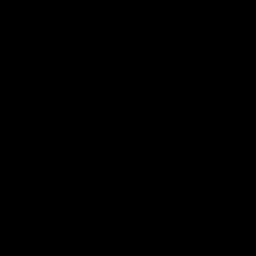

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_09_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_09_cyt.dat


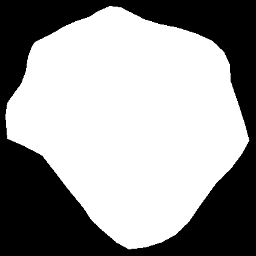

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_09_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_03_nuc.dat


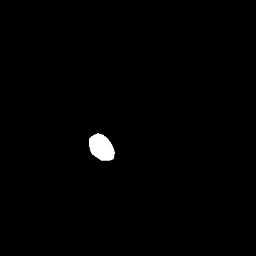

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_03_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_03_cyt.dat


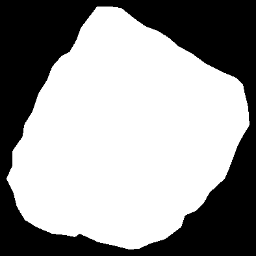

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_03_cyt.bmp
Extracted 10 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/060_05_nuc.dat


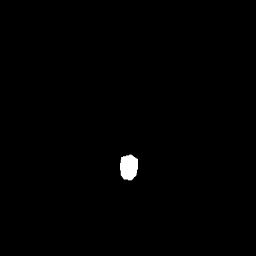

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_05_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/060_05_cyt.dat


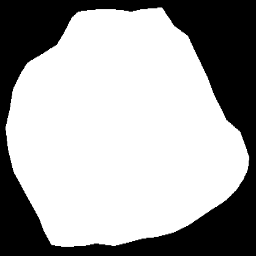

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_05_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_07_nuc.dat


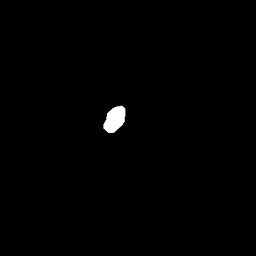

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_07_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_07_cyt.dat


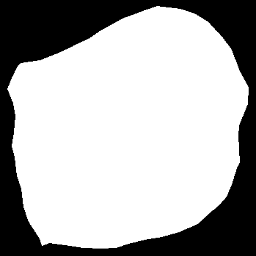

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_07_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_01_nuc.dat


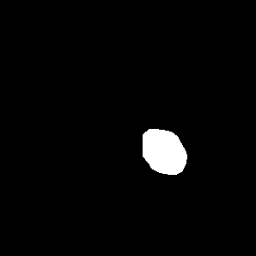

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/118_01_nuc.bmp
Extracted 41 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_01_cyt.dat


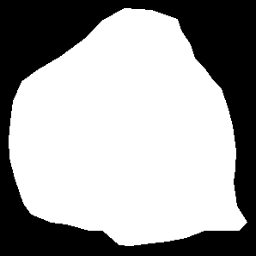

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/118_01_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_05_nuc.dat


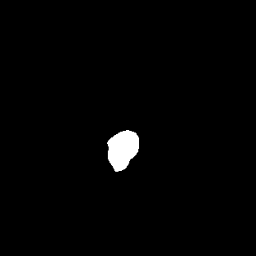

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/118_05_nuc.bmp
Extracted 41 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_05_cyt.dat


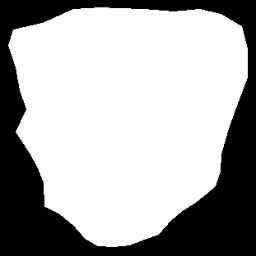

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/118_05_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/058_02_nuc.dat


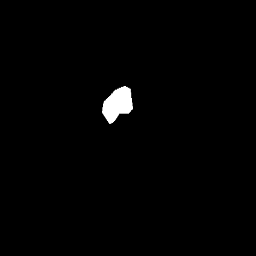

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_02_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/058_02_cyt.dat


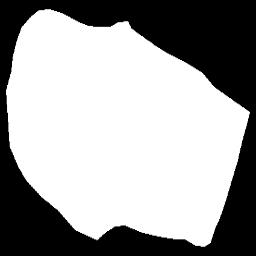

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_02_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_09_nuc.dat


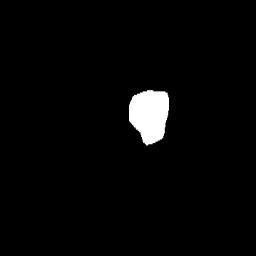

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/122_09_nuc.bmp
Extracted 33 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_09_cyt.dat


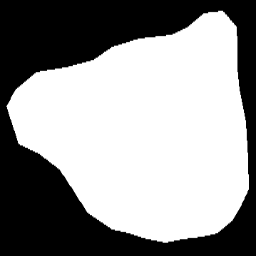

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/122_09_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/078_07_nuc.dat


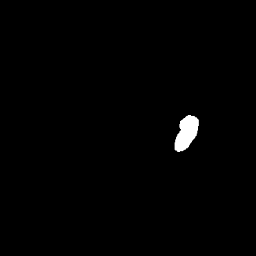

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_07_nuc.bmp
Extracted 85 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/078_07_cyt.dat


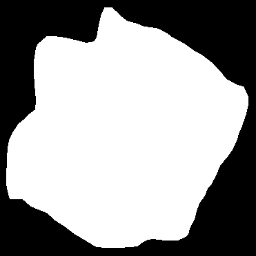

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_07_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_01_nuc.dat


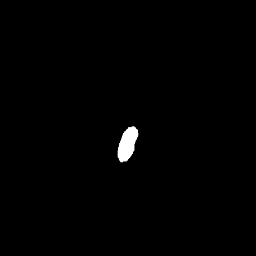

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_01_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_01_cyt.dat


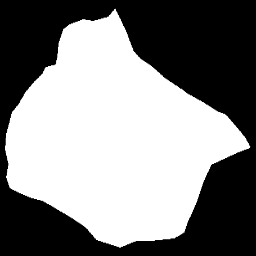

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/060_02_nuc.dat


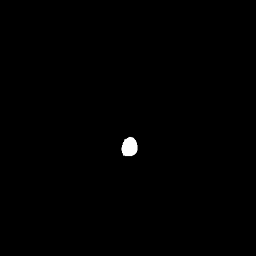

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_02_nuc.bmp
Extracted 60 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/060_02_cyt.dat


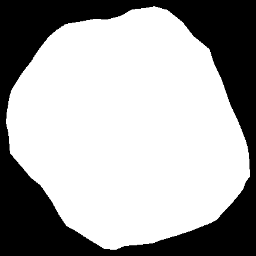

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_02_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/126_07_nuc.dat


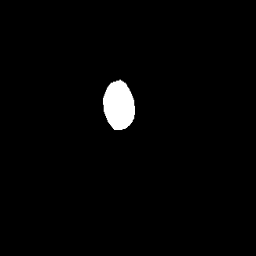

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/126_07_nuc.bmp
Extracted 32 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/126_07_cyt.dat


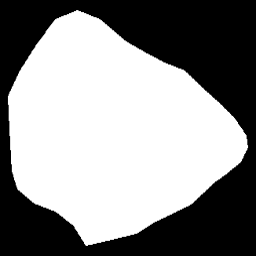

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/126_07_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_07_nuc.dat


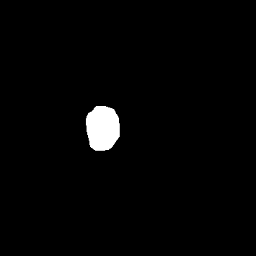

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_07_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_07_cyt.dat


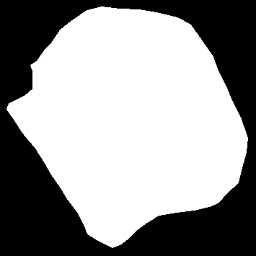

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_07_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/054_05_nuc.dat


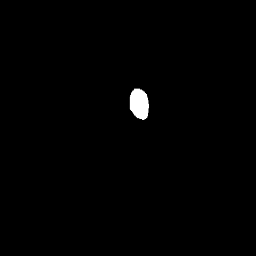

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_05_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/054_05_cyt.dat


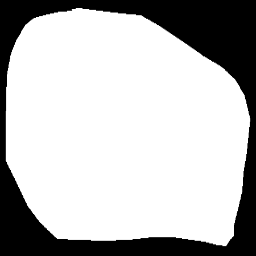

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_05_cyt.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_07_nuc.dat


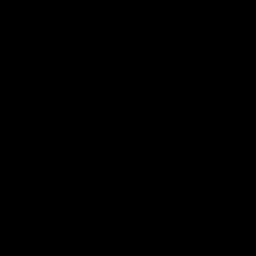

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_07_nuc.bmp
Extracted 66 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_07_cyt.dat


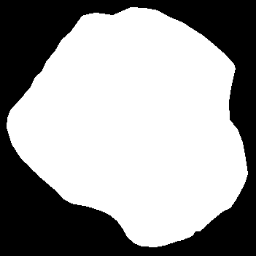

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_07_cyt.bmp
Extracted 26 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_09_nuc.dat


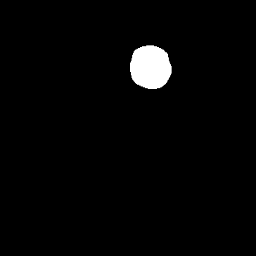

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_09_nuc.bmp
Extracted 101 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_09_cyt.dat


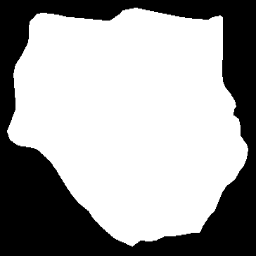

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_09_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/055_06_nuc.dat


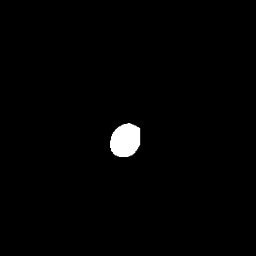

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/055_06_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/055_06_cyt.dat


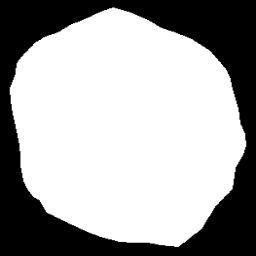

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/055_06_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/003_01_nuc.dat


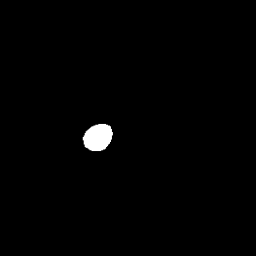

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_01_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/003_01_cyt.dat


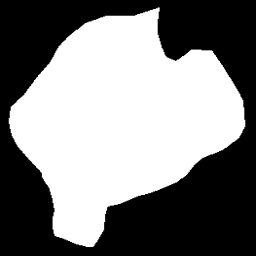

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_01_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/072_04_nuc.dat


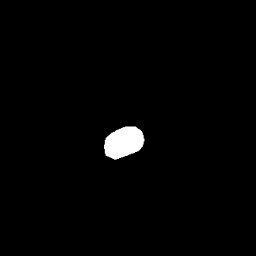

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_04_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/072_04_cyt.dat


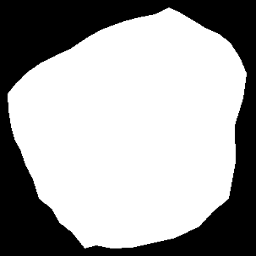

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_04_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/108_05_nuc.dat


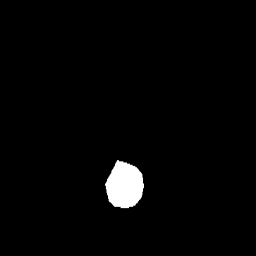

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_05_nuc.bmp
Extracted 33 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/108_05_cyt.dat


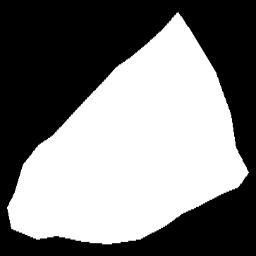

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_05_cyt.bmp
Extracted 26 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/028_04_nuc.dat


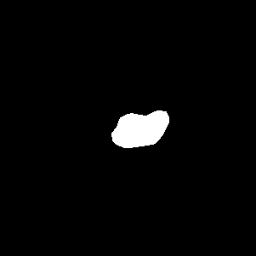

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_04_nuc.bmp
Extracted 83 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/028_04_cyt.dat


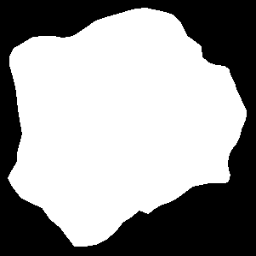

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_04_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/108_06_nuc.dat


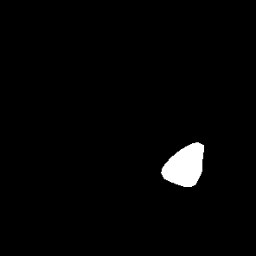

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_06_nuc.bmp
Extracted 40 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/108_06_cyt.dat


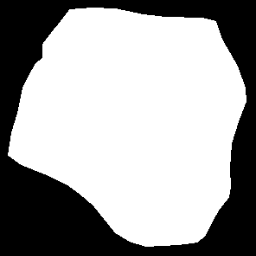

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_06_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/012_01_nuc.dat


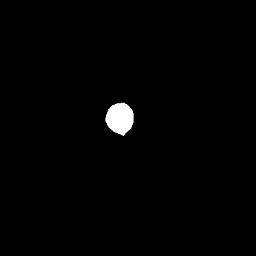

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_01_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/012_01_cyt.dat


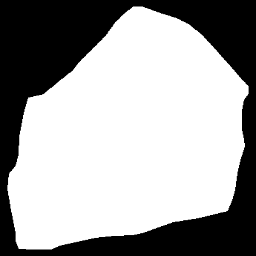

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_01_cyt.bmp
Extracted 27 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_08_nuc.dat


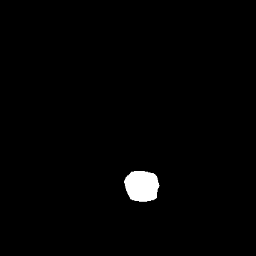

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_08_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_08_cyt.dat


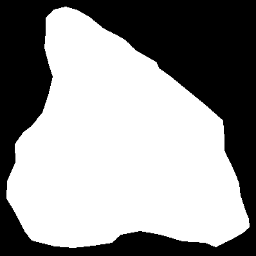

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_08_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/051_05_nuc.dat


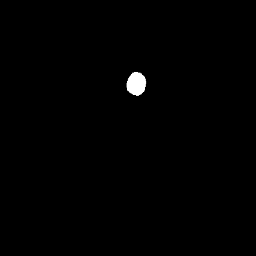

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/051_05_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/051_05_cyt.dat


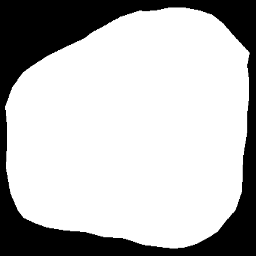

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/051_05_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/053_06_nuc.dat


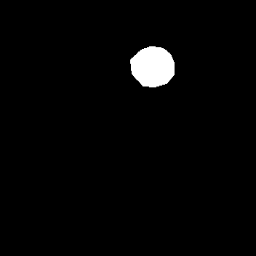

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_06_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/053_06_cyt.dat


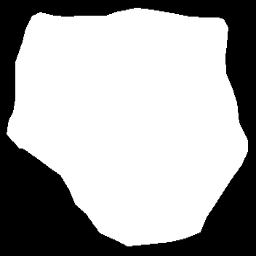

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_06_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/034_02_nuc.dat


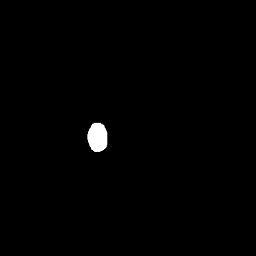

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_02_nuc.bmp
Extracted 106 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/034_02_cyt.dat


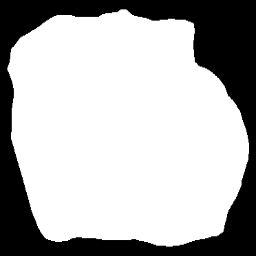

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_02_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_11_nuc.dat


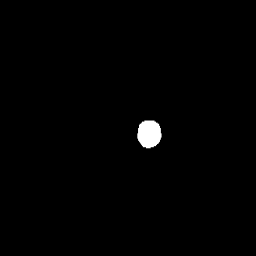

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_11_nuc.bmp
Extracted 69 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_11_cyt.dat


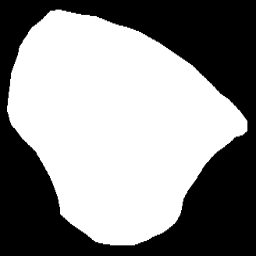

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_11_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/126_01_nuc.dat


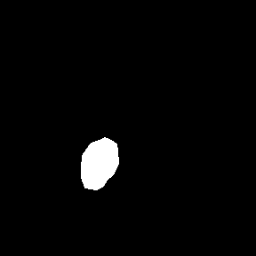

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/126_01_nuc.bmp
Extracted 34 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/126_01_cyt.dat


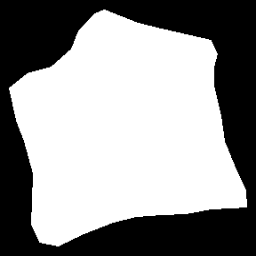

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/126_01_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/047_04_nuc.dat


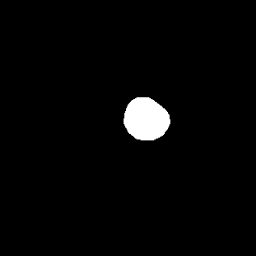

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_04_nuc.bmp
Extracted 112 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/047_04_cyt.dat


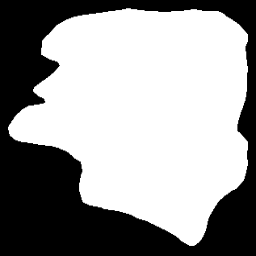

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_04_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_02_nuc.dat


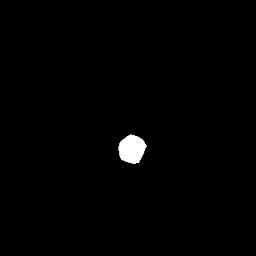

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_02_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_02_cyt.dat


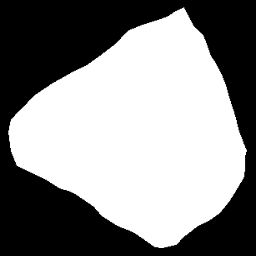

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_02_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/095_02_nuc.dat


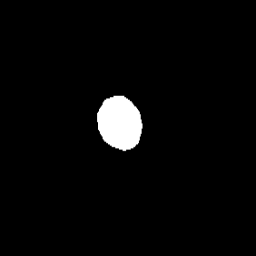

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_02_nuc.bmp
Extracted 42 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/095_02_cyt.dat


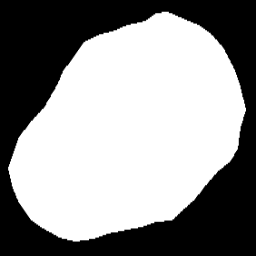

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_02_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_08_nuc.dat


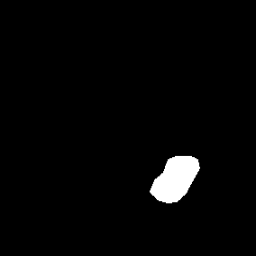

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_08_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_08_cyt.dat


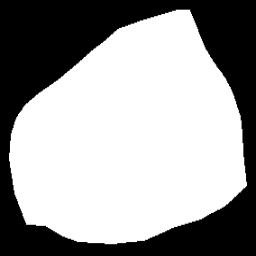

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_08_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/013_04_nuc.dat


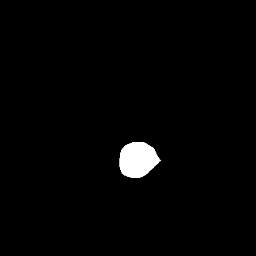

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/013_04_nuc.bmp
Extracted 71 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/013_04_cyt.dat


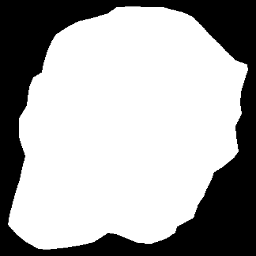

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/013_04_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_16_nuc.dat


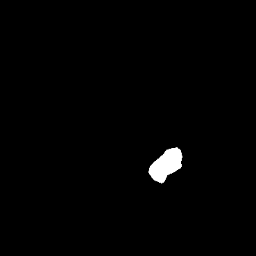

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_16_nuc.bmp
Extracted 45 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_16_cyt.dat


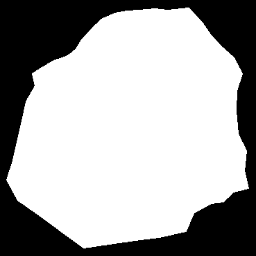

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_16_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_04_nuc.dat


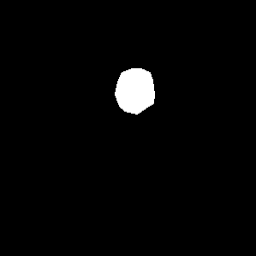

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_04_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_04_cyt.dat


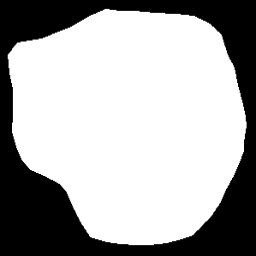

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_04_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/018_05_nuc.dat


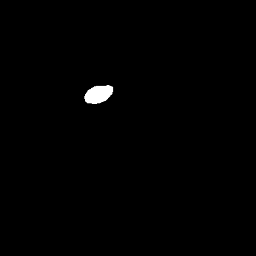

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_05_nuc.bmp
Extracted 39 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/018_05_cyt.dat


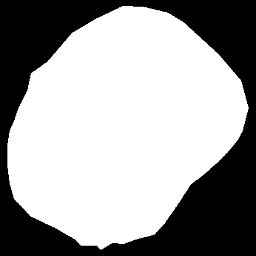

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_05_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/108_01_nuc.dat


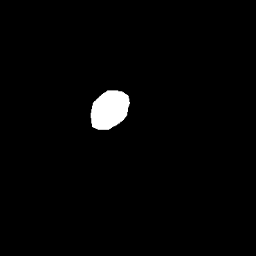

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_01_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/108_01_cyt.dat


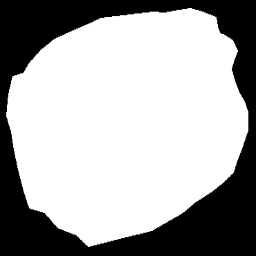

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_01_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_04_nuc.dat


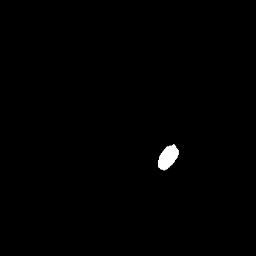

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_04_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_04_cyt.dat


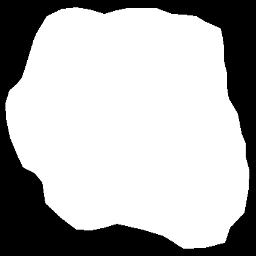

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_04_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_08_nuc.dat


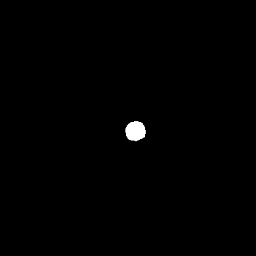

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_08_nuc.bmp
Extracted 73 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_08_cyt.dat


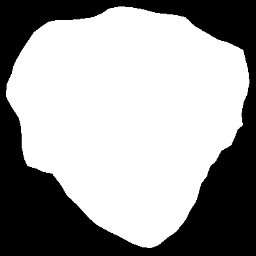

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_08_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/060_07_nuc.dat


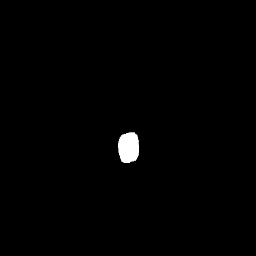

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_07_nuc.bmp
Extracted 47 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/060_07_cyt.dat


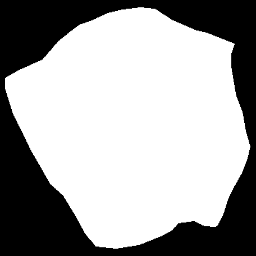

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_07_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/124_01_nuc.dat


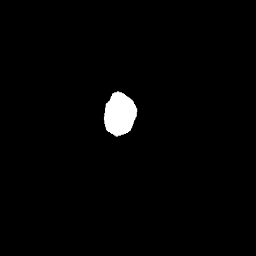

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/124_01_nuc.bmp
Extracted 38 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/124_01_cyt.dat


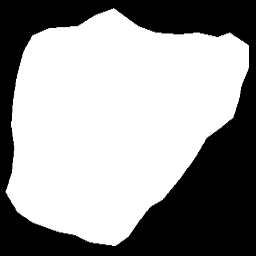

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/124_01_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/037_03_nuc.dat


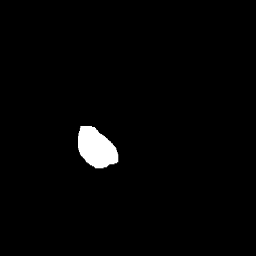

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/037_03_nuc.bmp
Extracted 73 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/037_03_cyt.dat


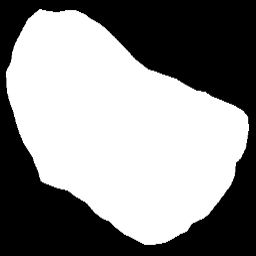

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/037_03_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_07_nuc.dat


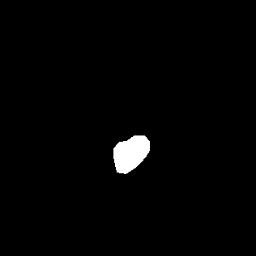

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_07_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_07_cyt.dat


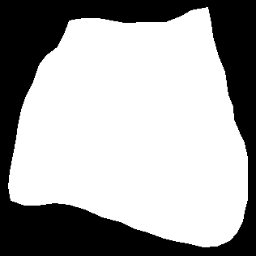

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_07_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/093_02_nuc.dat


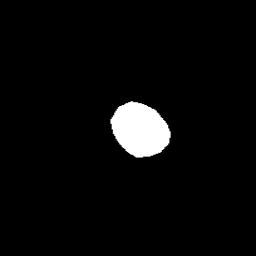

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_02_nuc.bmp
Extracted 35 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/093_02_cyt.dat


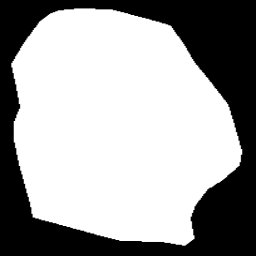

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_02_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_04_nuc.dat


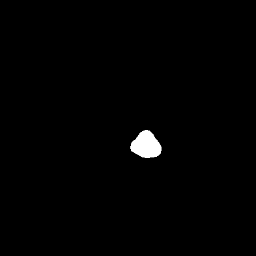

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_04_nuc.bmp
Extracted 85 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_04_cyt.dat


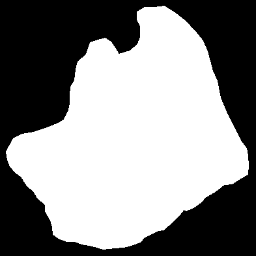

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_04_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_09_nuc.dat


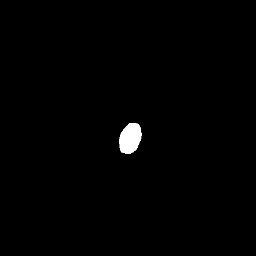

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_09_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_09_cyt.dat


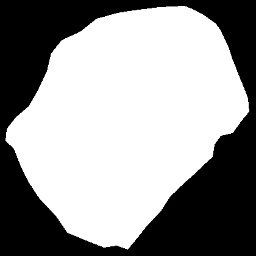

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_09_cyt.bmp
Extracted 27 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_07_nuc.dat


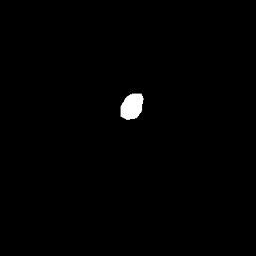

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_07_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_07_cyt.dat


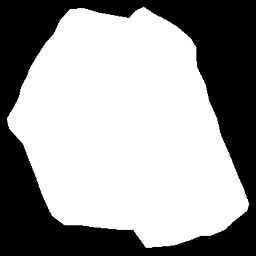

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_07_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/124_02_nuc.dat


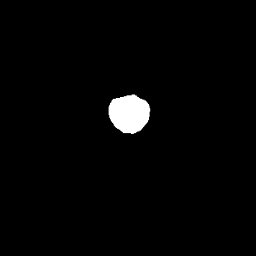

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/124_02_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/124_02_cyt.dat


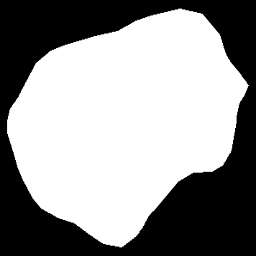

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/124_02_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/084_02_nuc.dat


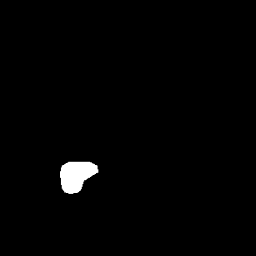

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/084_02_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/084_02_cyt.dat


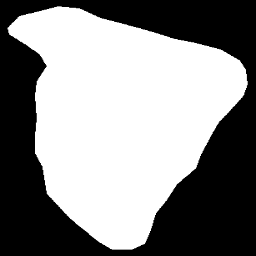

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/084_02_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/018_06_nuc.dat


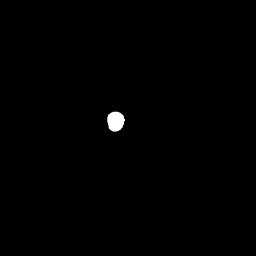

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_06_nuc.bmp
Extracted 61 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/018_06_cyt.dat


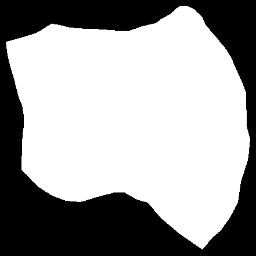

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_06_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/031_01_nuc.dat


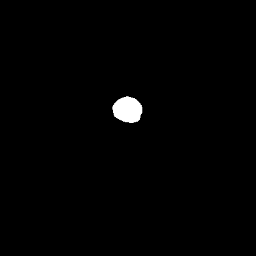

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/031_01_nuc.bmp
Extracted 68 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/031_01_cyt.dat


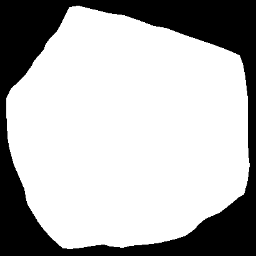

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/031_01_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/036_04_nuc.dat


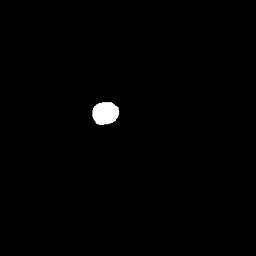

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/036_04_nuc.bmp
Extracted 109 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/036_04_cyt.dat


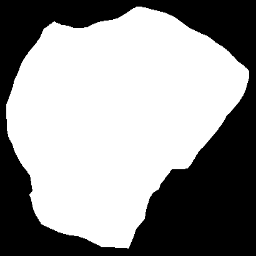

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/036_04_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_02_nuc.dat


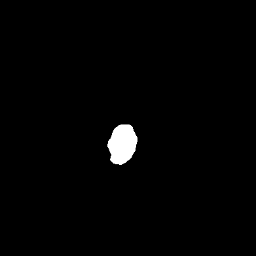

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_02_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_02_cyt.dat


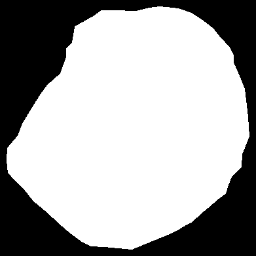

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_02_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_09_nuc.dat


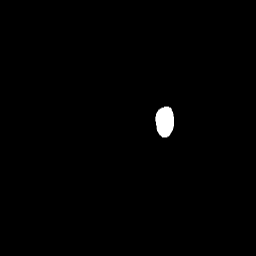

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_09_nuc.bmp
Extracted 101 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_09_cyt.dat


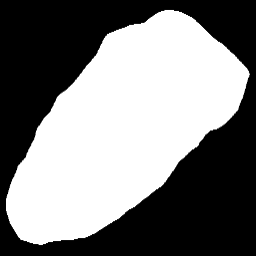

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_09_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/115_04_nuc.dat


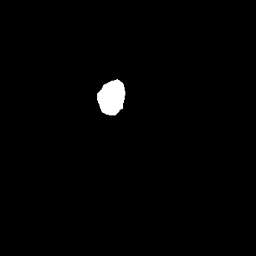

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/115_04_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/115_04_cyt.dat


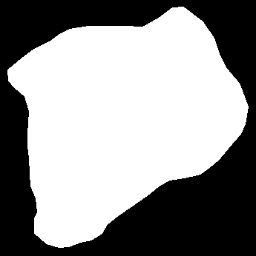

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/115_04_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/011_03_nuc.dat


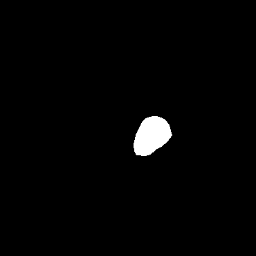

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_03_nuc.bmp
Extracted 61 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/011_03_cyt.dat


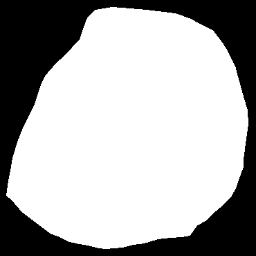

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_03_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_03_nuc.dat


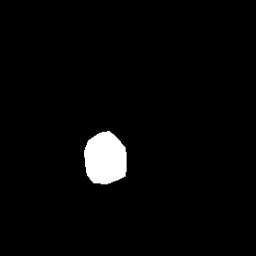

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_03_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_03_cyt.dat


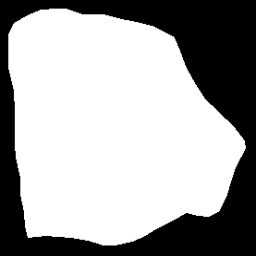

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_03_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/115_03_nuc.dat


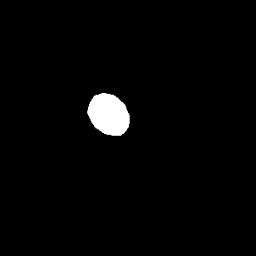

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/115_03_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/115_03_cyt.dat


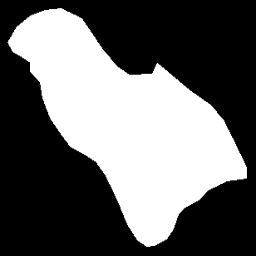

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/115_03_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/102_08_nuc.dat


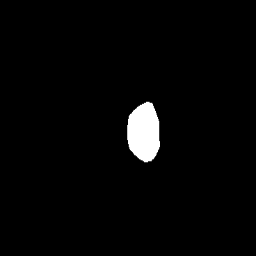

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_08_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/102_08_cyt.dat


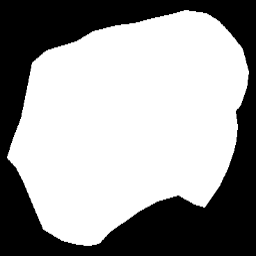

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_08_cyt.bmp
Extracted 12 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/095_03_nuc.dat


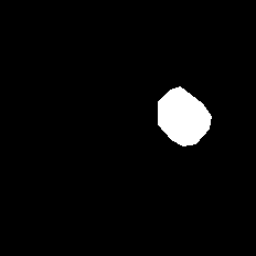

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_03_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/095_03_cyt.dat


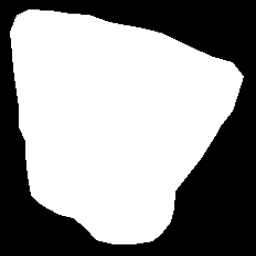

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_03_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_08_nuc.dat


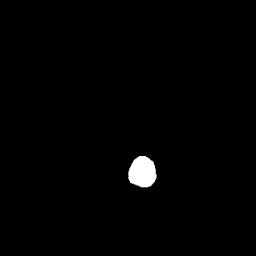

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_08_nuc.bmp
Extracted 74 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_08_cyt.dat


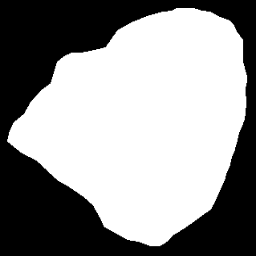

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_08_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/028_05_nuc.dat


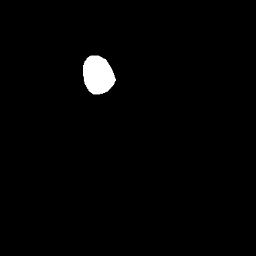

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_05_nuc.bmp
Extracted 96 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/028_05_cyt.dat


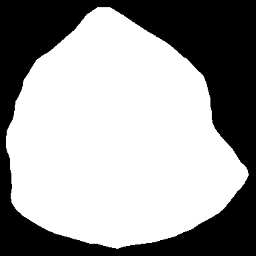

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_05_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_09_nuc.dat


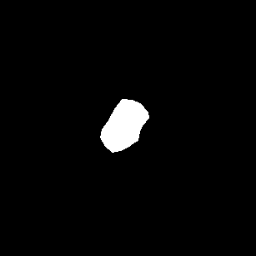

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_09_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_09_cyt.dat


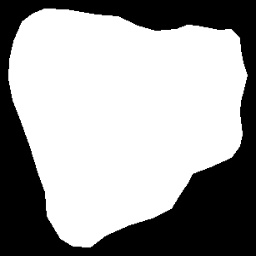

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_09_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/065_01_nuc.dat


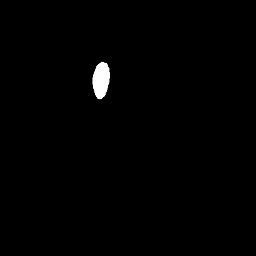

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/065_01_nuc.bmp
Extracted 69 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/065_01_cyt.dat


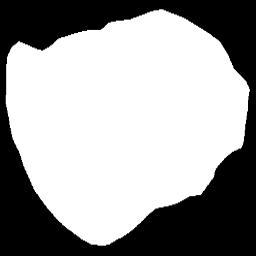

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/065_01_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_09_nuc.dat


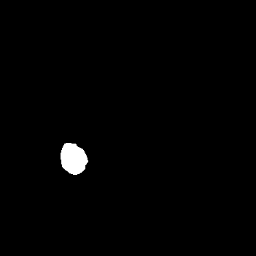

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_09_nuc.bmp
Extracted 73 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_09_cyt.dat


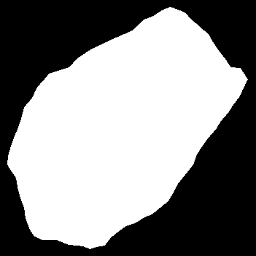

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_09_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_04_nuc.dat


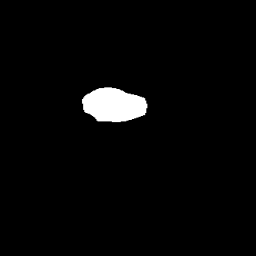

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/118_04_nuc.bmp
Extracted 40 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_04_cyt.dat


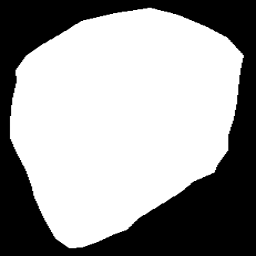

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/118_04_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/027_01_nuc.dat


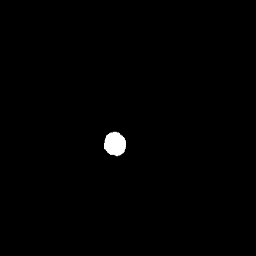

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_01_nuc.bmp
Extracted 90 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/027_01_cyt.dat


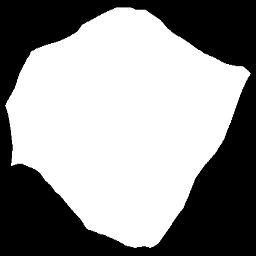

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_01_cyt.bmp
Extracted 37 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_09_nuc.dat


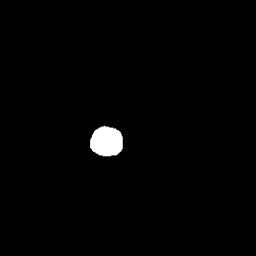

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/029_09_nuc.bmp
Extracted 67 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_09_cyt.dat


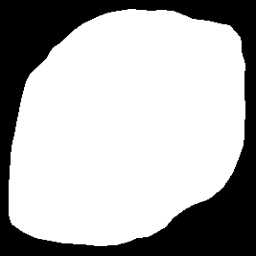

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/029_09_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/115_05_nuc.dat


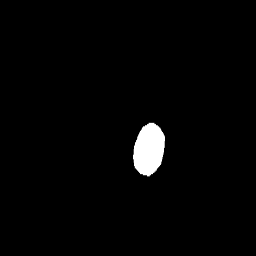

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/115_05_nuc.bmp
Extracted 42 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/115_05_cyt.dat


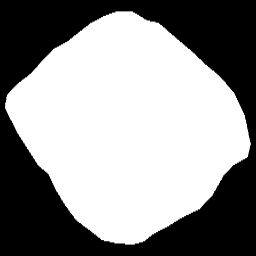

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/115_05_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_05_nuc.dat


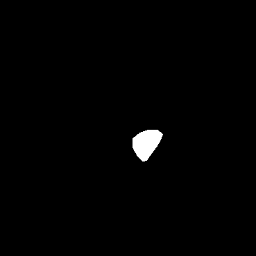

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_05_nuc.bmp
Extracted 41 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_05_cyt.dat


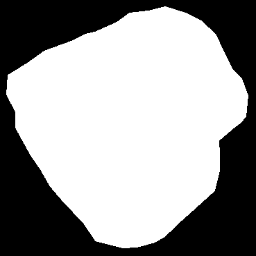

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_05_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_08_nuc.dat


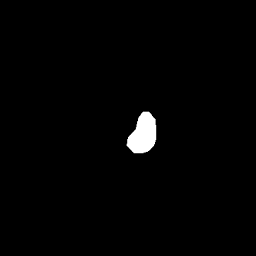

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_08_nuc.bmp
Extracted 67 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_08_cyt.dat


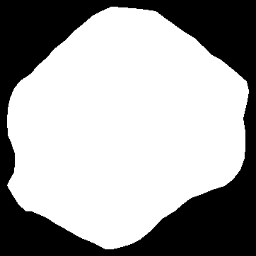

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_08_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_09_nuc.dat


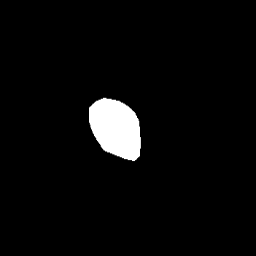

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_09_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/068_09_cyt.dat


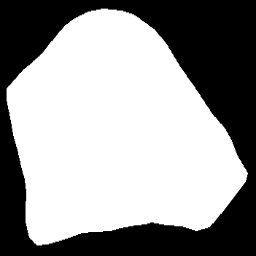

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_09_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/125_02_nuc.dat


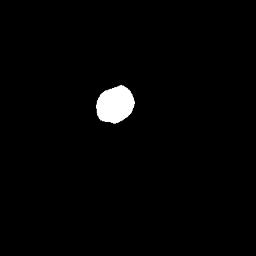

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/125_02_nuc.bmp
Extracted 47 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/125_02_cyt.dat


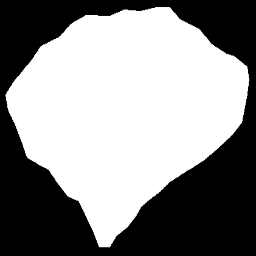

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/125_02_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/100_01_nuc.dat


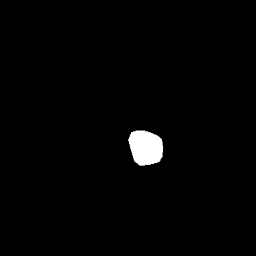

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_01_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/100_01_cyt.dat


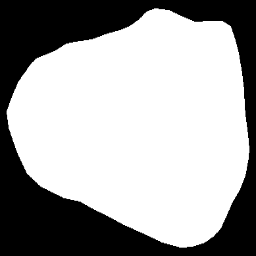

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_01_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_08_nuc.dat


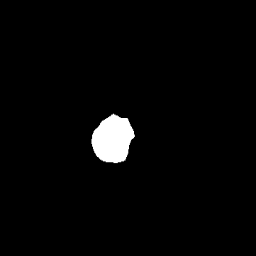

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/122_08_nuc.bmp
Extracted 38 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_08_cyt.dat


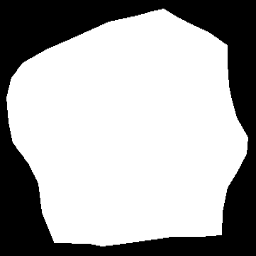

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/122_08_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_05_nuc.dat


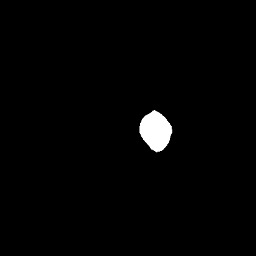

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_05_nuc.bmp
Extracted 88 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_05_cyt.dat


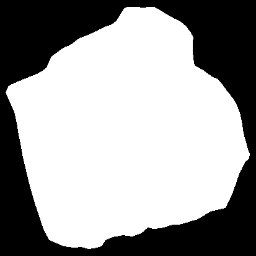

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_05_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/113_05_nuc.dat


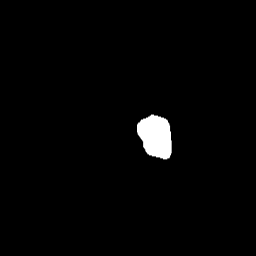

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/113_05_nuc.bmp
Extracted 60 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/113_05_cyt.dat


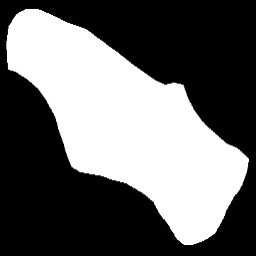

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/113_05_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_10_nuc.dat


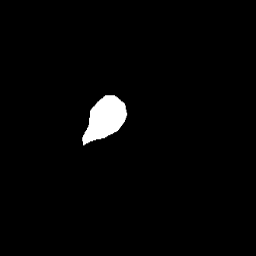

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_10_nuc.bmp
Extracted 40 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_10_cyt.dat


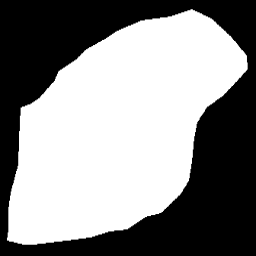

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_10_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/064_01_nuc.dat


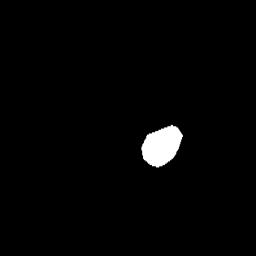

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_01_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/064_01_cyt.dat


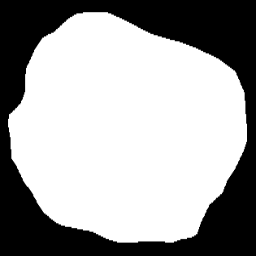

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_01_cyt.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/030_01_nuc.dat


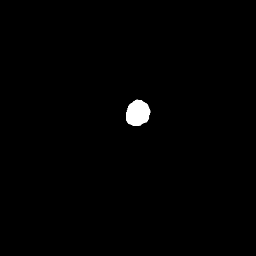

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/030_01_nuc.bmp
Extracted 70 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/030_01_cyt.dat


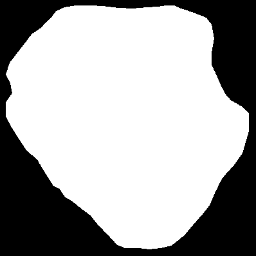

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/030_01_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/006_02_nuc.dat


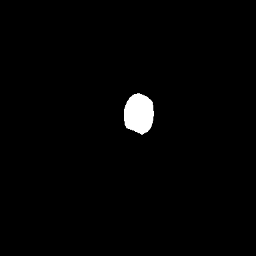

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_02_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/006_02_cyt.dat


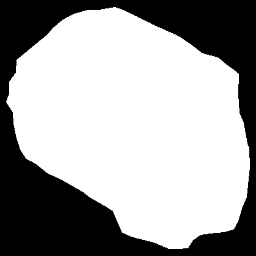

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_02_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/093_04_nuc.dat


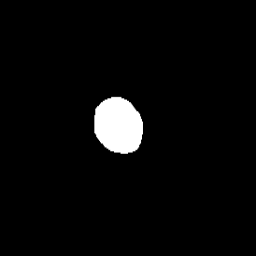

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_04_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/093_04_cyt.dat


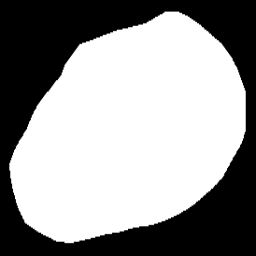

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_04_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_03_nuc.dat


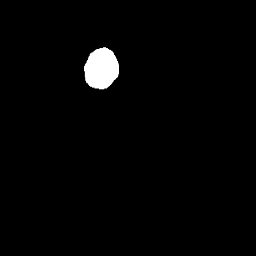

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_03_nuc.bmp
Extracted 67 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_03_cyt.dat


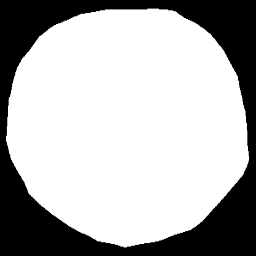

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_03_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_08_nuc.dat


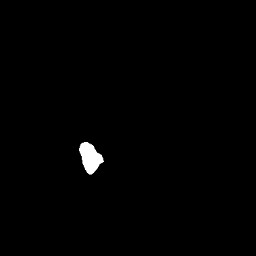

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_08_nuc.bmp
Extracted 61 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_08_cyt.dat


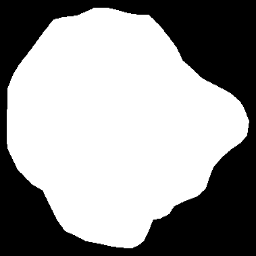

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_08_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_09_nuc.dat


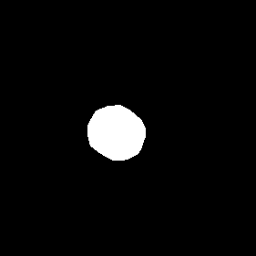

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/119_09_nuc.bmp
Extracted 36 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_09_cyt.dat


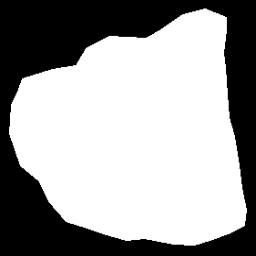

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/119_09_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_09_nuc.dat


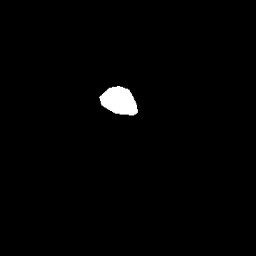

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/066_09_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_09_cyt.dat


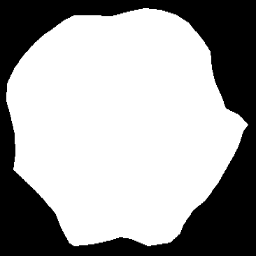

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/066_09_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/050_04_nuc.dat


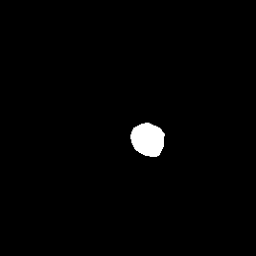

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/050_04_nuc.bmp
Extracted 78 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/050_04_cyt.dat


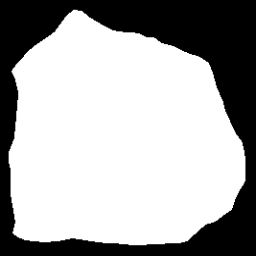

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/050_04_cyt.bmp
Extracted 34 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_08_nuc.dat


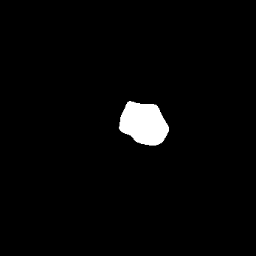

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/029_08_nuc.bmp
Extracted 97 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_08_cyt.dat


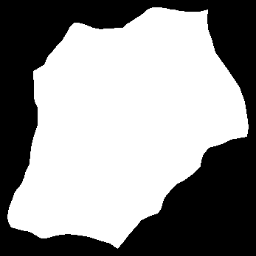

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/029_08_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/078_03_nuc.dat


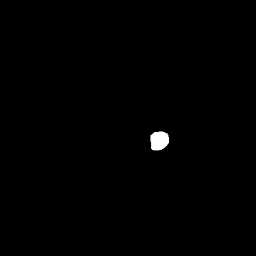

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/078_03_nuc.bmp
Extracted 58 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/078_03_cyt.dat


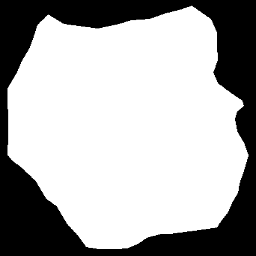

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/078_03_cyt.bmp
Extracted 35 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_02_nuc.dat


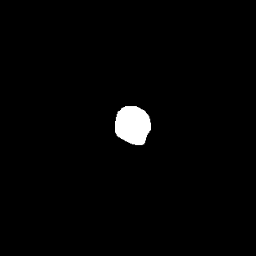

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/029_02_nuc.bmp
Extracted 80 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_02_cyt.dat


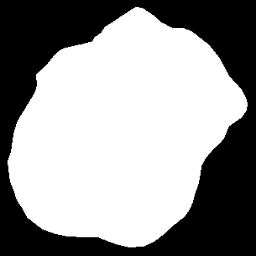

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/029_02_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/016_04_nuc.dat


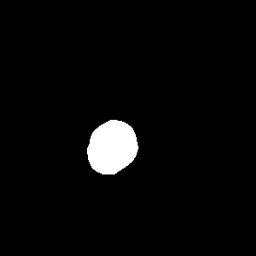

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/016_04_nuc.bmp
Extracted 72 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/016_04_cyt.dat


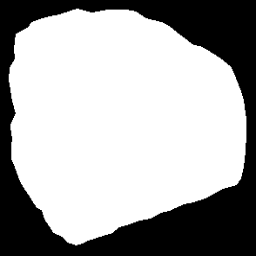

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/016_04_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/028_08_nuc.dat


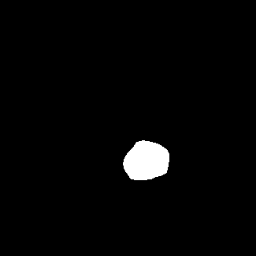

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/028_08_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/028_08_cyt.dat


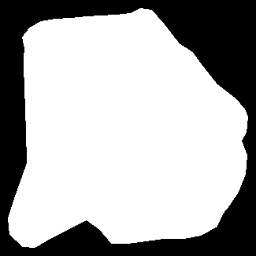

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/028_08_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/125_05_nuc.dat


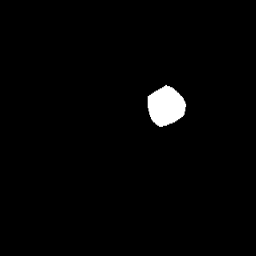

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/125_05_nuc.bmp
Extracted 34 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/125_05_cyt.dat


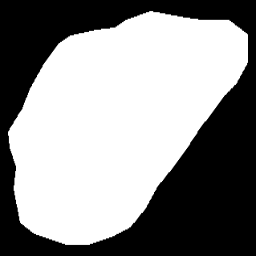

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/125_05_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/039_02_nuc.dat


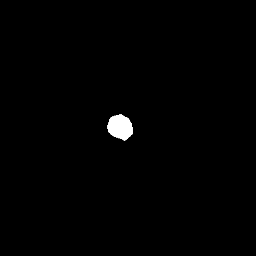

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/039_02_nuc.bmp
Extracted 71 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/039_02_cyt.dat


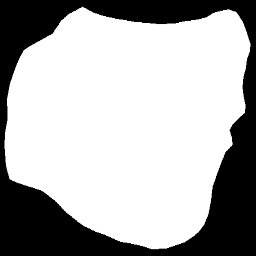

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/039_02_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_04_nuc.dat


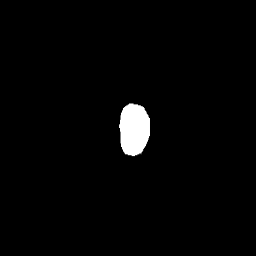

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/004_04_nuc.bmp
Extracted 75 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_04_cyt.dat


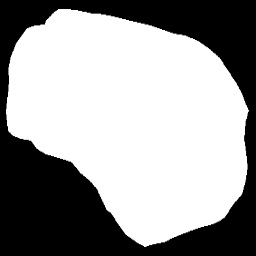

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/004_04_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_10_nuc.dat


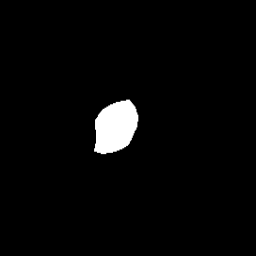

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/119_10_nuc.bmp
Extracted 30 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_10_cyt.dat


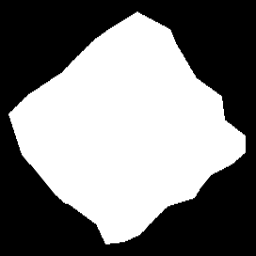

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/119_10_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/121_07_nuc.dat


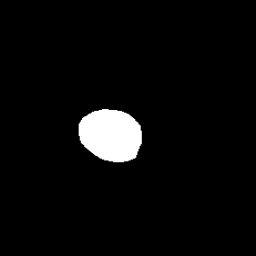

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/121_07_nuc.bmp
Extracted 33 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/121_07_cyt.dat


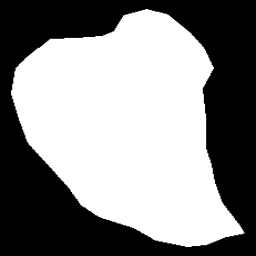

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/121_07_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_01_nuc.dat


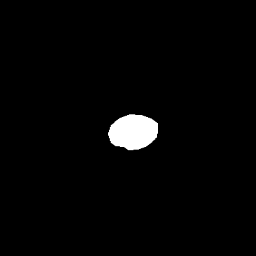

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/097_01_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_01_cyt.dat


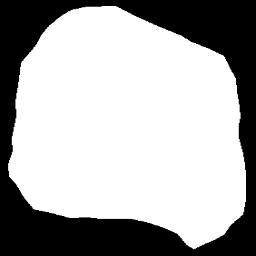

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/097_01_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_10_nuc.dat


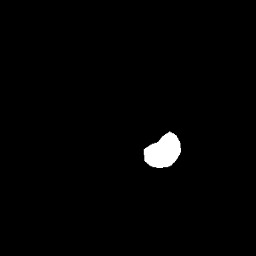

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/061_10_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_10_cyt.dat


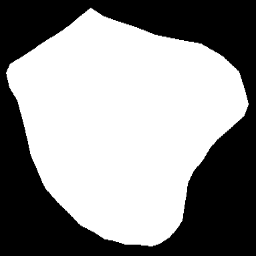

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/061_10_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_03_nuc.dat


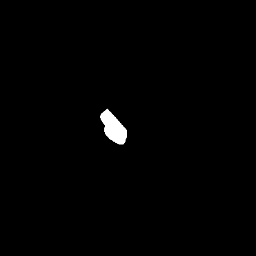

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/061_03_nuc.bmp
Extracted 61 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_03_cyt.dat


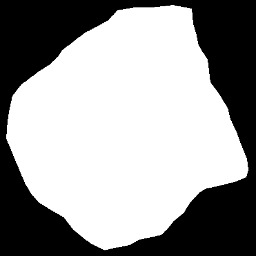

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/061_03_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/121_02_nuc.dat


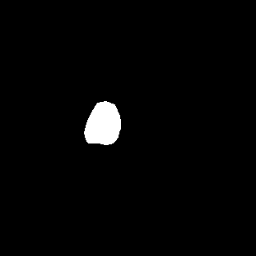

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/121_02_nuc.bmp
Extracted 39 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/121_02_cyt.dat


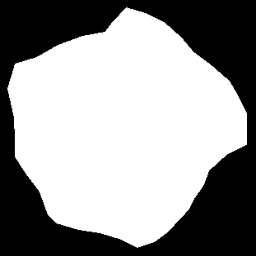

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/121_02_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/082_03_nuc.dat


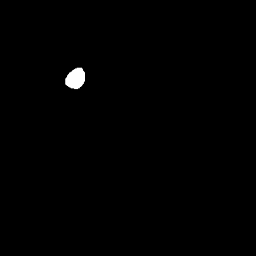

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/082_03_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/082_03_cyt.dat


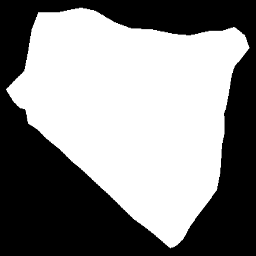

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/082_03_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/040_03_nuc.dat


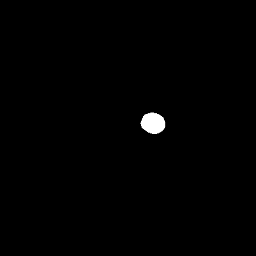

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/040_03_nuc.bmp
Extracted 109 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/040_03_cyt.dat


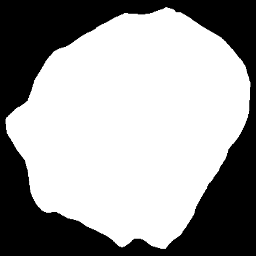

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/040_03_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/103_02_nuc.dat


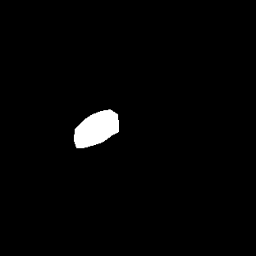

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/103_02_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/103_02_cyt.dat


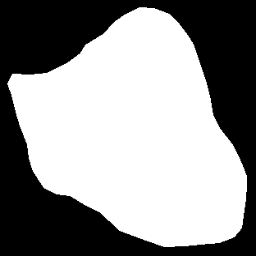

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/103_02_cyt.bmp
Extracted 33 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/005_04_nuc.dat


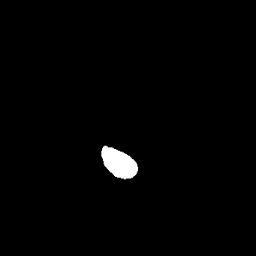

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/005_04_nuc.bmp
Extracted 85 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/005_04_cyt.dat


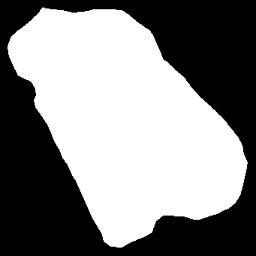

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/005_04_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/081_01_nuc.dat


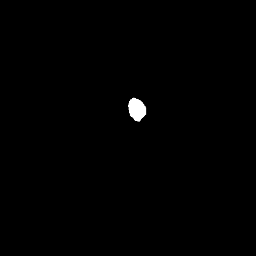

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/081_01_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/081_01_cyt.dat


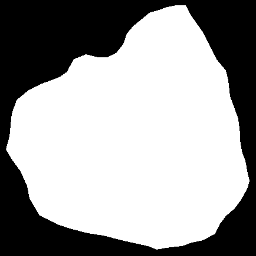

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/081_01_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_07_nuc.dat


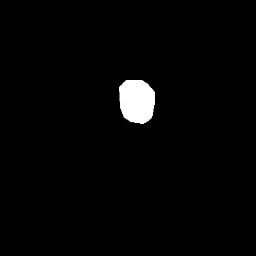

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/094_07_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_07_cyt.dat


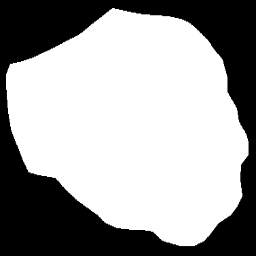

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/094_07_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_01_nuc.dat


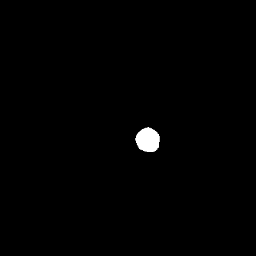

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/021_01_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_01_cyt.dat


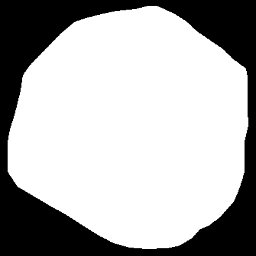

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/021_01_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_03_nuc.dat


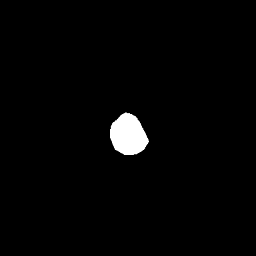

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/046_03_nuc.bmp
Extracted 108 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_03_cyt.dat


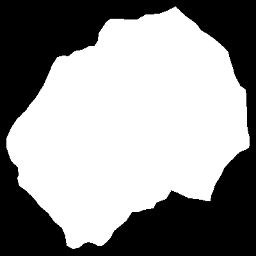

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/046_03_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/071_05_nuc.dat


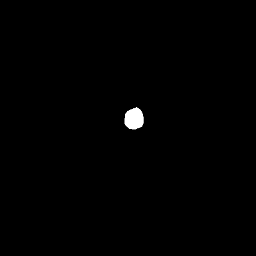

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/071_05_nuc.bmp
Extracted 79 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/071_05_cyt.dat


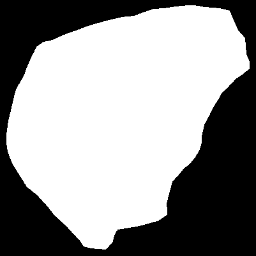

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/071_05_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/103_01_nuc.dat


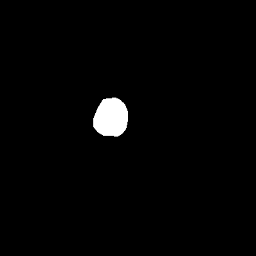

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/103_01_nuc.bmp
Extracted 58 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/103_01_cyt.dat


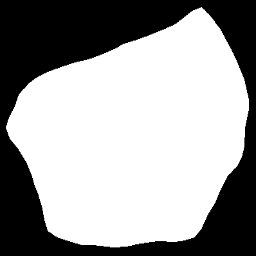

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/103_01_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_09_nuc.dat


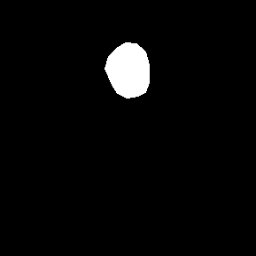

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/097_09_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_09_cyt.dat


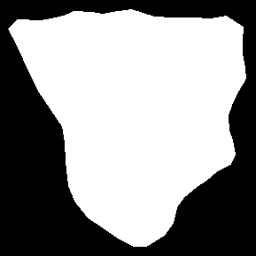

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/097_09_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/048_04_nuc.dat


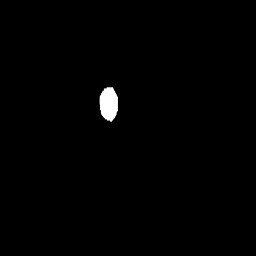

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/048_04_nuc.bmp
Extracted 76 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/048_04_cyt.dat


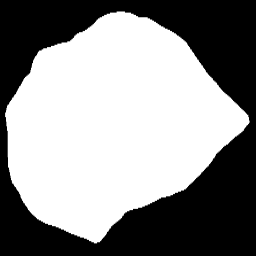

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/048_04_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_06_nuc.dat


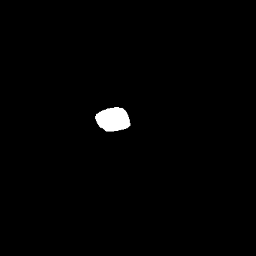

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/014_06_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_06_cyt.dat


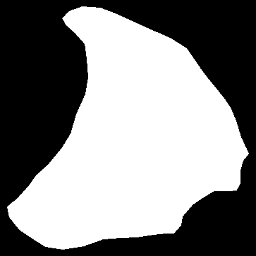

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/014_06_cyt.bmp
Extracted 38 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/031_02_nuc.dat


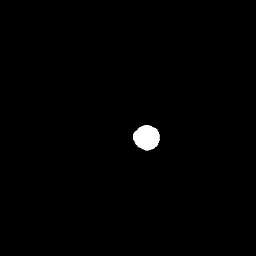

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/031_02_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/031_02_cyt.dat


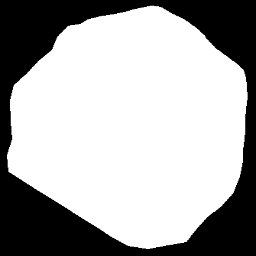

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/031_02_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_02_nuc.dat


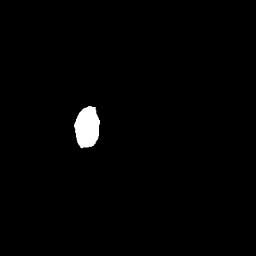

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/009_02_nuc.bmp
Extracted 92 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/009_02_cyt.dat


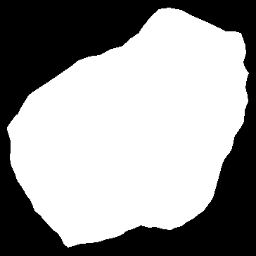

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/009_02_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_04_nuc.dat


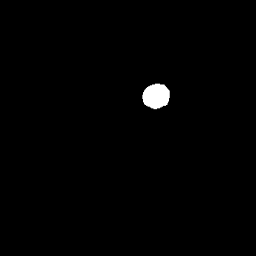

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/014_04_nuc.bmp
Extracted 83 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_04_cyt.dat


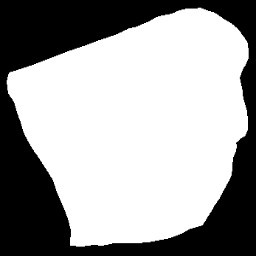

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/014_04_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_01_nuc.dat


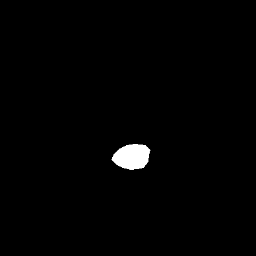

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/067_01_nuc.bmp
Extracted 69 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_01_cyt.dat


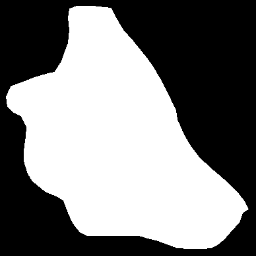

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/067_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_04_nuc.dat


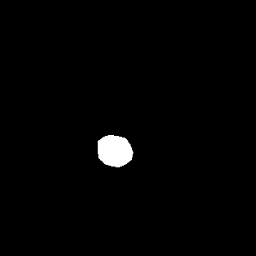

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/067_04_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_04_cyt.dat


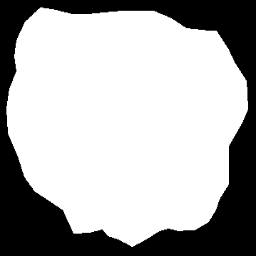

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/067_04_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_07_nuc.dat


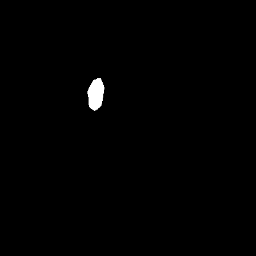

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/010_07_nuc.bmp
Extracted 60 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_07_cyt.dat


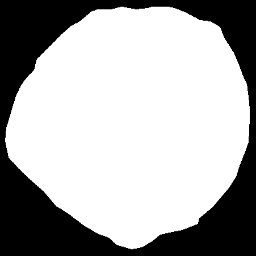

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/010_07_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/095_01_nuc.dat


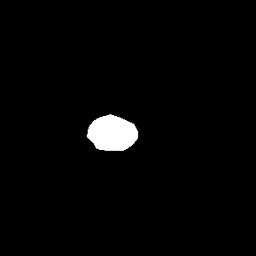

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/095_01_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/095_01_cyt.dat


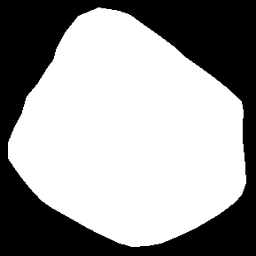

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/095_01_cyt.bmp
Extracted 27 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_08_nuc.dat


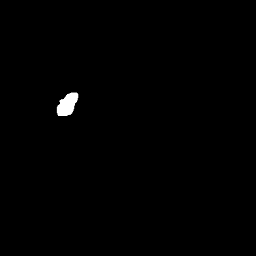

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/080_08_nuc.bmp
Extracted 67 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_08_cyt.dat


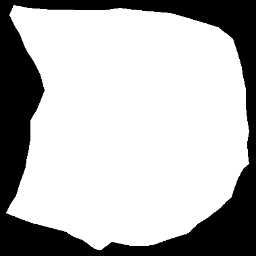

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/080_08_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_13_nuc.dat


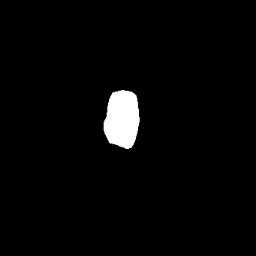

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/017_13_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_13_cyt.dat


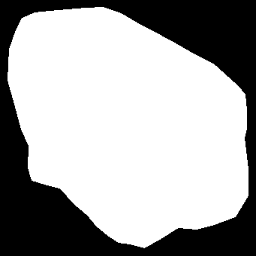

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/017_13_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/043_03_nuc.dat


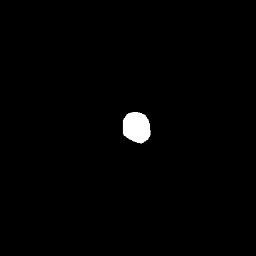

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/043_03_nuc.bmp
Extracted 116 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/043_03_cyt.dat


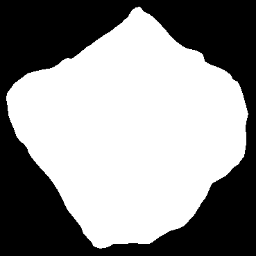

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/043_03_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/027_06_nuc.dat


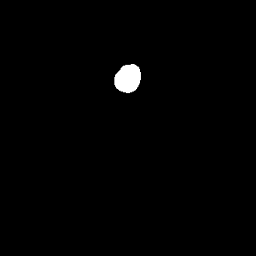

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/027_06_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/027_06_cyt.dat


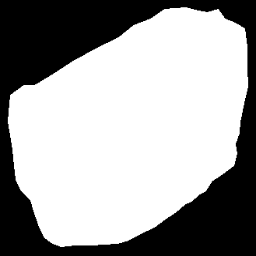

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/027_06_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/050_06_nuc.dat


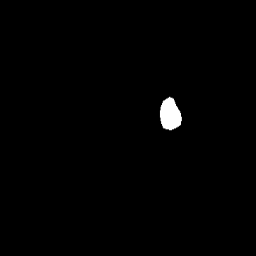

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/050_06_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/050_06_cyt.dat


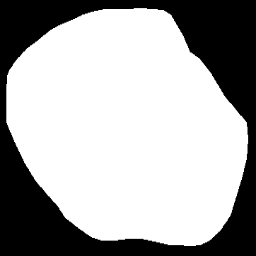

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/050_06_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_06_nuc.dat


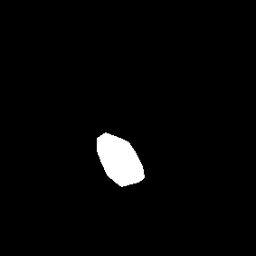

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/099_06_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_06_cyt.dat


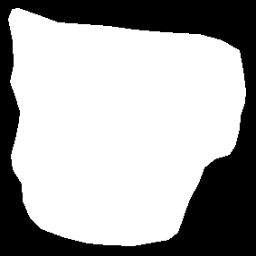

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/099_06_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_11_nuc.dat


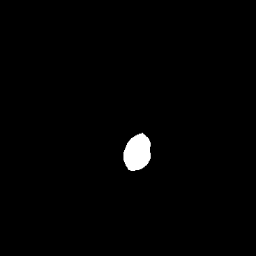

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/004_11_nuc.bmp
Extracted 60 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_11_cyt.dat


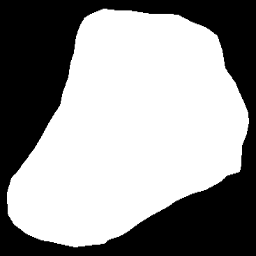

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/004_11_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_01_nuc.dat


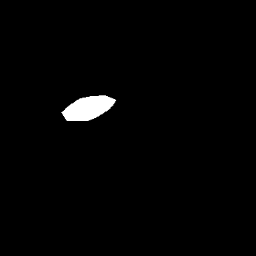

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/069_01_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_01_cyt.dat


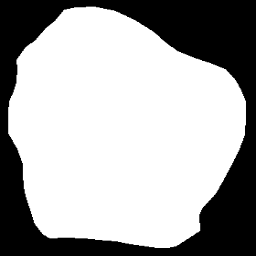

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/069_01_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/013_01_nuc.dat


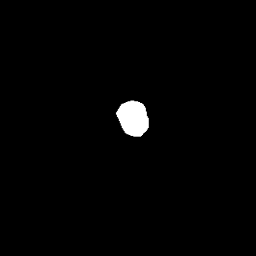

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/013_01_nuc.bmp
Extracted 80 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/013_01_cyt.dat


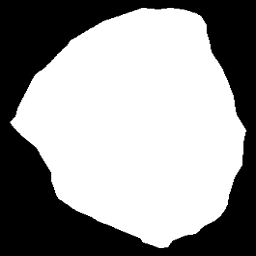

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/013_01_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_04_nuc.dat


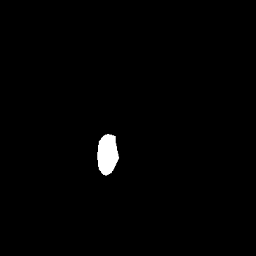

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/007_04_nuc.bmp
Extracted 65 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_04_cyt.dat


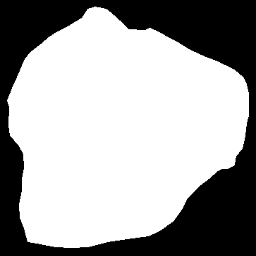

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/007_04_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/104_04_nuc.dat


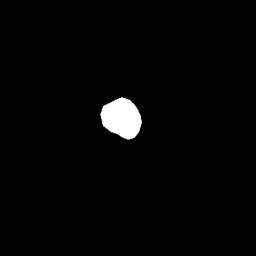

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/104_04_nuc.bmp
Extracted 32 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/104_04_cyt.dat


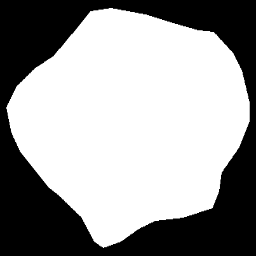

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/104_04_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/059_06_nuc.dat


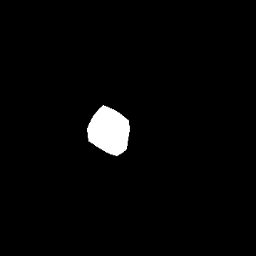

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/059_06_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/059_06_cyt.dat


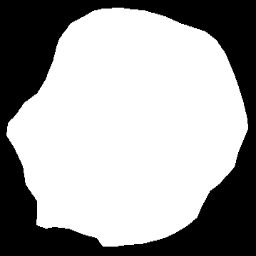

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/059_06_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/073_03_nuc.dat


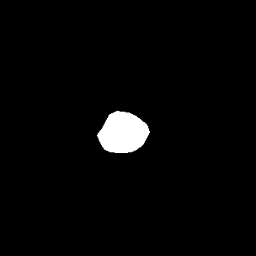

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/073_03_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/073_03_cyt.dat


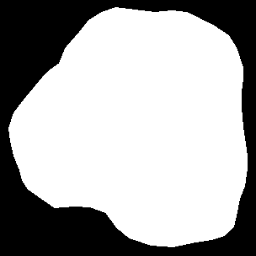

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/073_03_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_09_nuc.dat


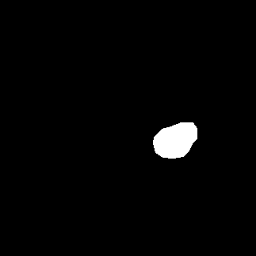

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/067_09_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/067_09_cyt.dat


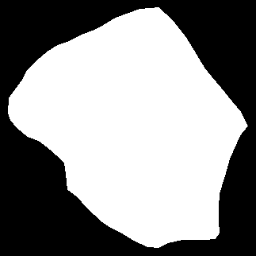

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/067_09_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/079_02_nuc.dat


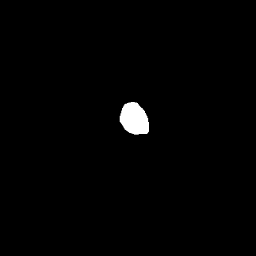

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/079_02_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/079_02_cyt.dat


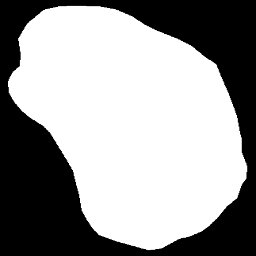

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/079_02_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/042_02_nuc.dat


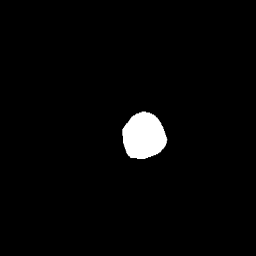

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/042_02_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/042_02_cyt.dat


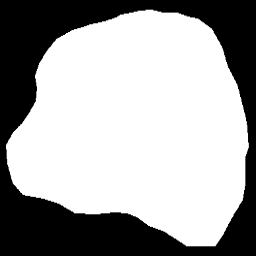

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/042_02_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/050_08_nuc.dat


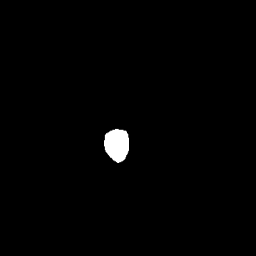

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/050_08_nuc.bmp
Extracted 89 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/050_08_cyt.dat


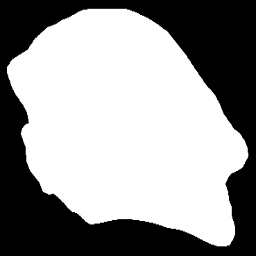

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/050_08_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/026_03_nuc.dat


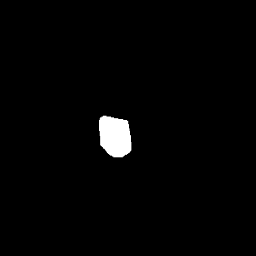

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/026_03_nuc.bmp
Extracted 93 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/026_03_cyt.dat


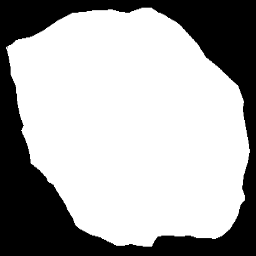

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/026_03_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/001_04_nuc.dat


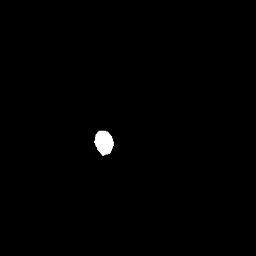

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/001_04_nuc.bmp
Extracted 68 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/001_04_cyt.dat


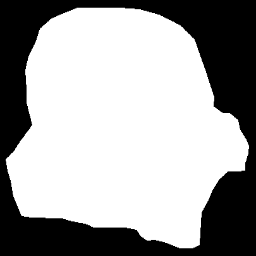

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/001_04_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/078_05_nuc.dat


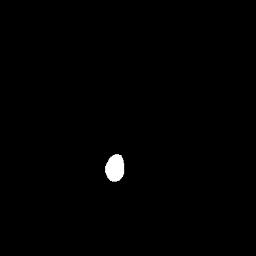

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/078_05_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/078_05_cyt.dat


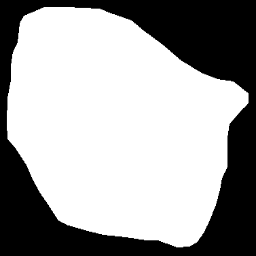

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/078_05_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/102_01_nuc.dat


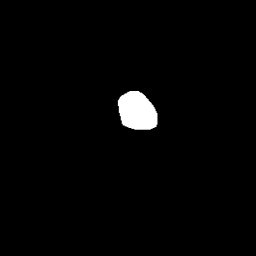

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/102_01_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/102_01_cyt.dat


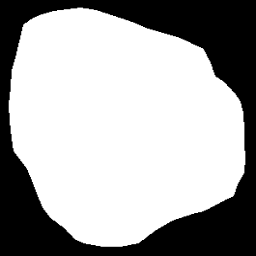

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/102_01_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_02_nuc.dat


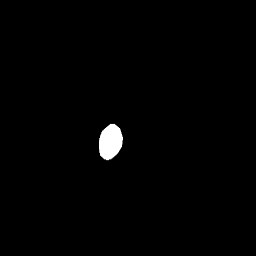

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/045_02_nuc.bmp
Extracted 76 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_02_cyt.dat


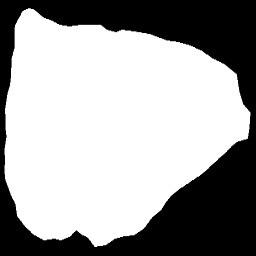

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/045_02_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/003_02_nuc.dat


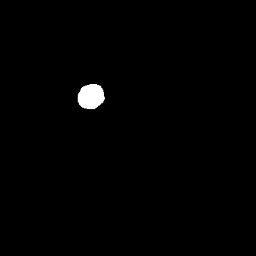

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/003_02_nuc.bmp
Extracted 94 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/003_02_cyt.dat


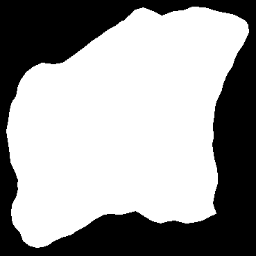

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/003_02_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/052_03_nuc.dat


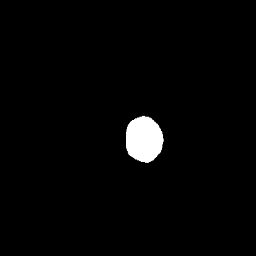

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/052_03_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/052_03_cyt.dat


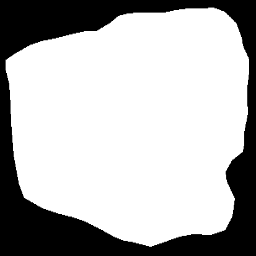

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/052_03_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/036_02_nuc.dat


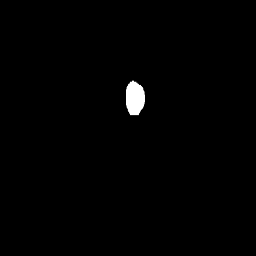

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/036_02_nuc.bmp
Extracted 75 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/036_02_cyt.dat


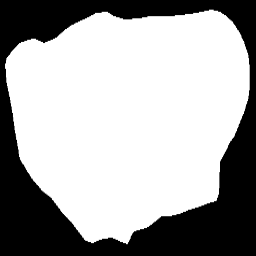

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/036_02_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_05_nuc.dat


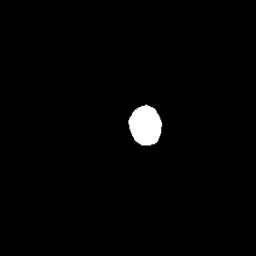

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/096_05_nuc.bmp
Extracted 70 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_05_cyt.dat


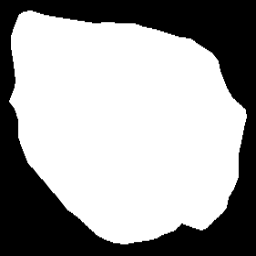

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/096_05_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/013_03_nuc.dat


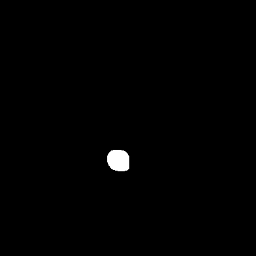

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/013_03_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/013_03_cyt.dat


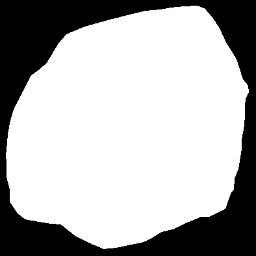

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/013_03_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_05_nuc.dat


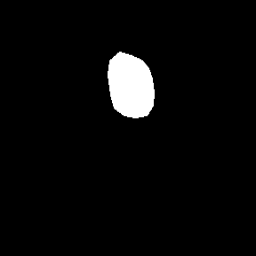

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/106_05_nuc.bmp
Extracted 38 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_05_cyt.dat


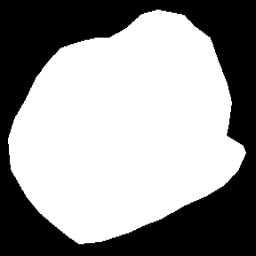

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/106_05_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_02_nuc.dat


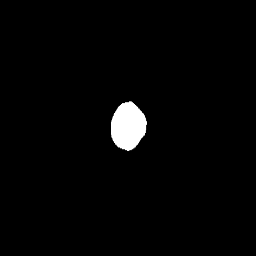

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/122_02_nuc.bmp
Extracted 33 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_02_cyt.dat


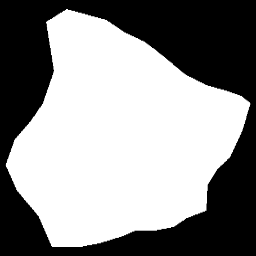

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/122_02_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/084_03_nuc.dat


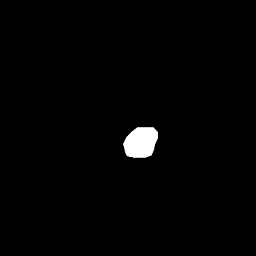

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/084_03_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/084_03_cyt.dat


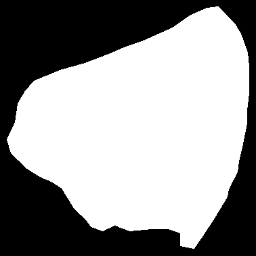

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/084_03_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/124_08_nuc.dat


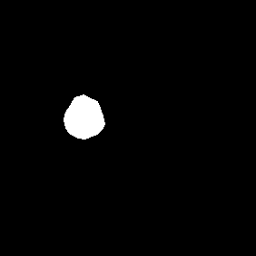

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/124_08_nuc.bmp
Extracted 35 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/124_08_cyt.dat


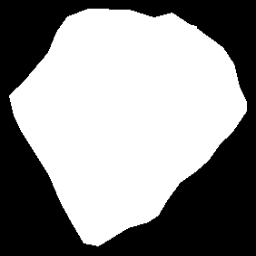

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/124_08_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/015_03_nuc.dat


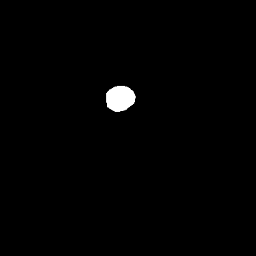

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/015_03_nuc.bmp
Extracted 73 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/015_03_cyt.dat


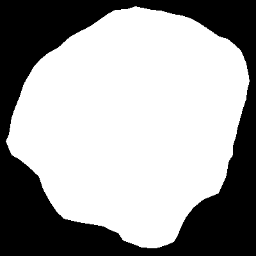

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/015_03_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/035_05_nuc.dat


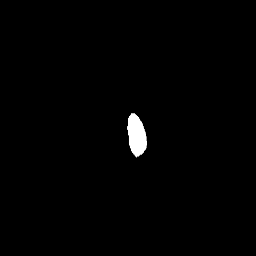

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/035_05_nuc.bmp
Extracted 67 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/035_05_cyt.dat


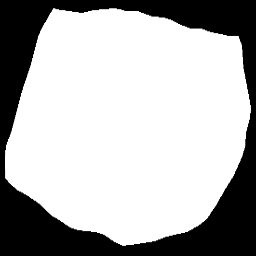

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/035_05_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/100_03_nuc.dat


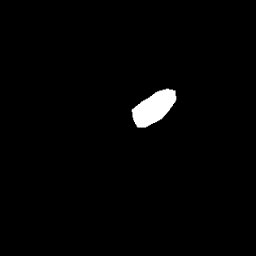

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/100_03_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/100_03_cyt.dat


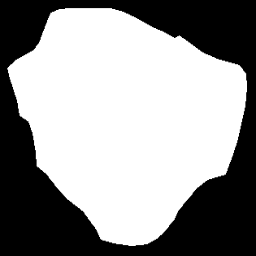

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/100_03_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_01_nuc.dat


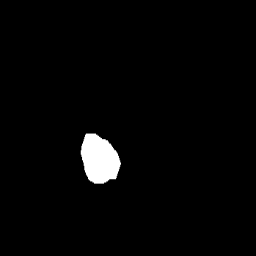

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/122_01_nuc.bmp
Extracted 33 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_01_cyt.dat


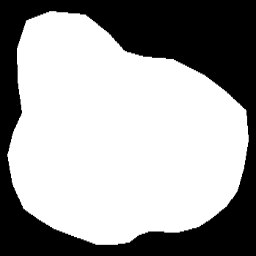

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/122_01_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/108_08_nuc.dat


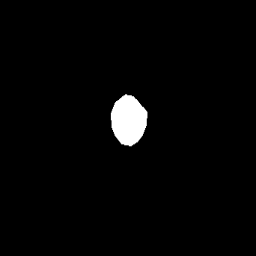

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/108_08_nuc.bmp
Extracted 41 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/108_08_cyt.dat


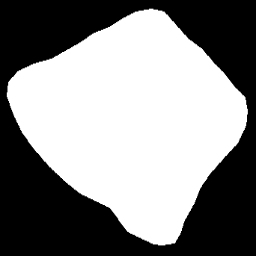

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/108_08_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/125_01_nuc.dat


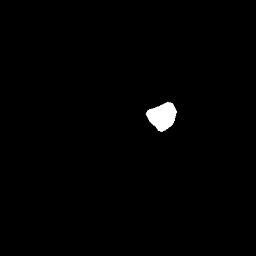

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/125_01_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/125_01_cyt.dat


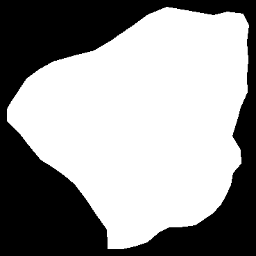

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/125_01_cyt.bmp
Extracted 35 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/006_07_nuc.dat


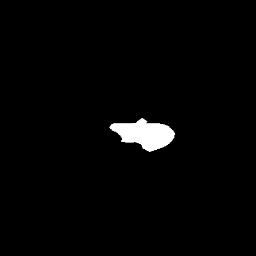

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/006_07_nuc.bmp
Extracted 68 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/006_07_cyt.dat


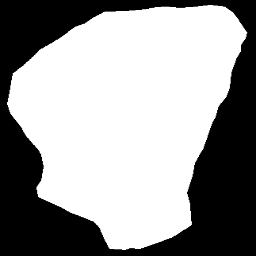

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/006_07_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_07_nuc.dat


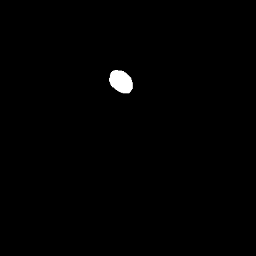

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/004_07_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_07_cyt.dat


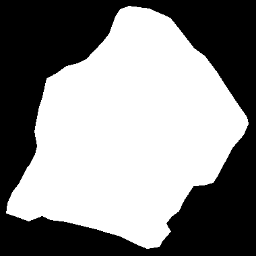

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/004_07_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_03_nuc.dat


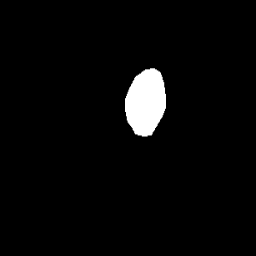

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/069_03_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_03_cyt.dat


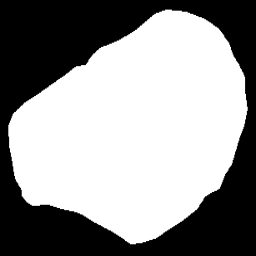

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/069_03_cyt.bmp
Extracted 27 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/053_02_nuc.dat


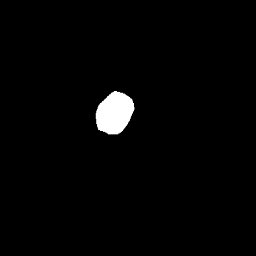

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/053_02_nuc.bmp
Extracted 85 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/053_02_cyt.dat


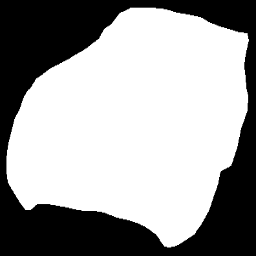

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/053_02_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_01_nuc.dat


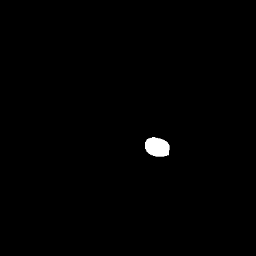

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/008_01_nuc.bmp
Extracted 68 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/008_01_cyt.dat


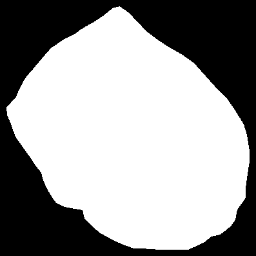

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/008_01_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/054_04_nuc.dat


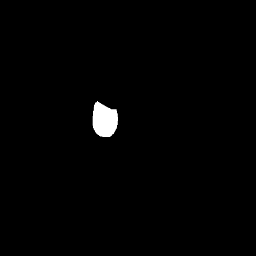

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/054_04_nuc.bmp
Extracted 47 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/054_04_cyt.dat


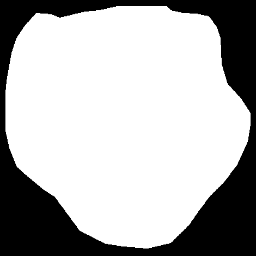

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/054_04_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/102_02_nuc.dat


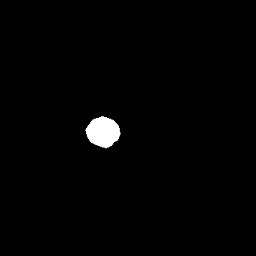

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/102_02_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/102_02_cyt.dat


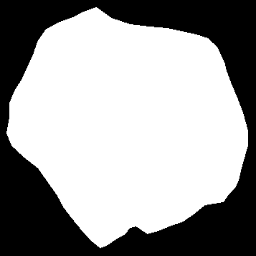

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/102_02_cyt.bmp
Extracted 26 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/087_01_nuc.dat


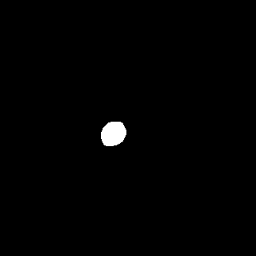

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/087_01_nuc.bmp
Extracted 77 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/087_01_cyt.dat


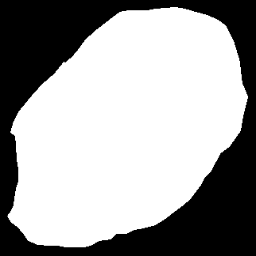

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/087_01_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_07_nuc.dat


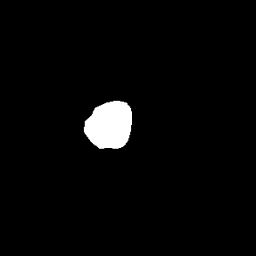

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/032_07_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_07_cyt.dat


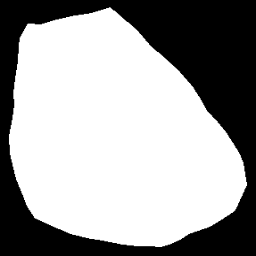

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/032_07_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/002_03_nuc.dat


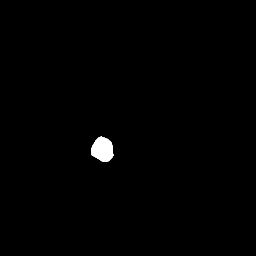

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/002_03_nuc.bmp
Extracted 69 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/002_03_cyt.dat


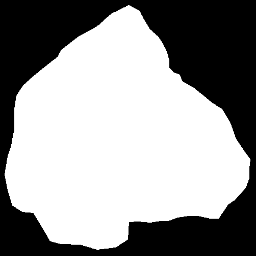

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/002_03_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/116_01_nuc.dat


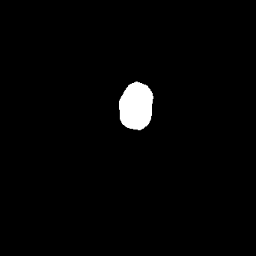

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/116_01_nuc.bmp
Extracted 45 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/116_01_cyt.dat


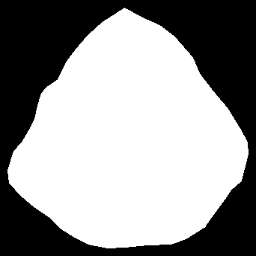

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/116_01_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/098_02_nuc.dat


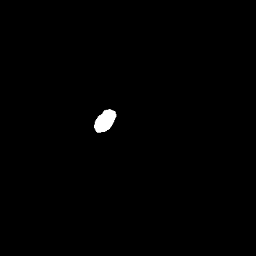

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/098_02_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/098_02_cyt.dat


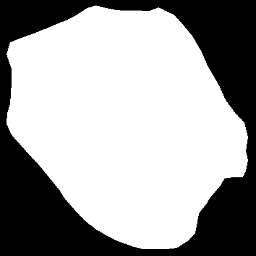

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/098_02_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_05_nuc.dat


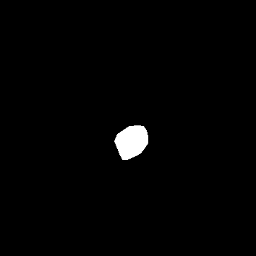

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/097_05_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_05_cyt.dat


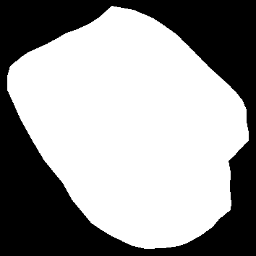

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/097_05_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_01_nuc.dat


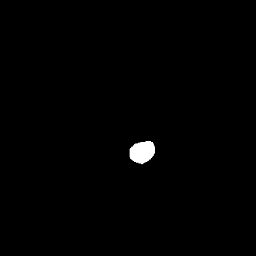

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/004_01_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_01_cyt.dat


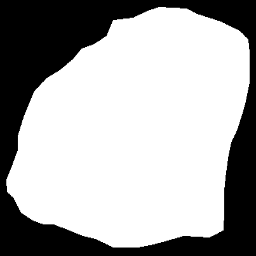

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/004_01_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_08_nuc.dat


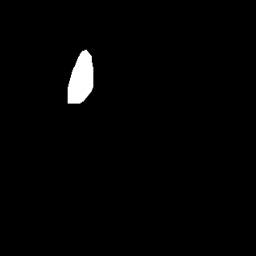

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/010_08_nuc.bmp
Extracted 67 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/010_08_cyt.dat


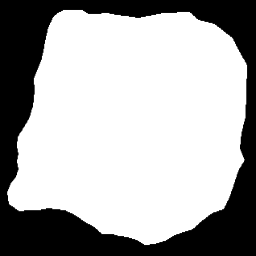

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/010_08_cyt.bmp
Extracted 26 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_04_nuc.dat


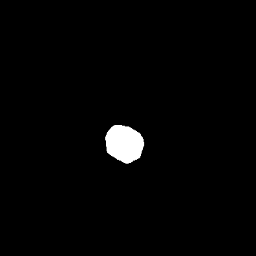

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/122_04_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/122_04_cyt.dat


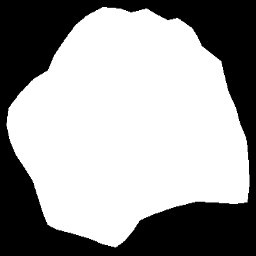

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/122_04_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_07_nuc.dat


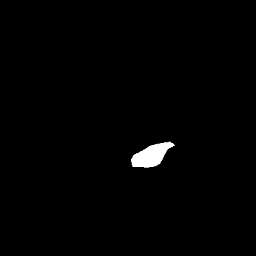

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/066_07_nuc.bmp
Extracted 53 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_07_cyt.dat


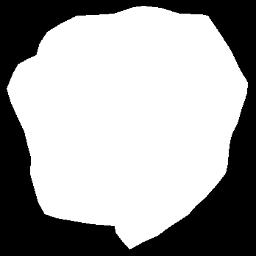

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/066_07_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/058_01_nuc.dat


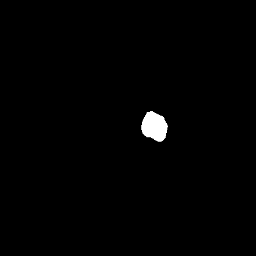

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/058_01_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/058_01_cyt.dat


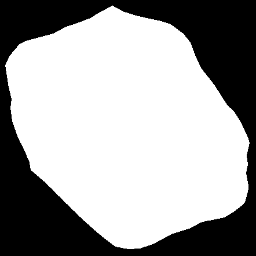

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/058_01_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/123_05_nuc.dat


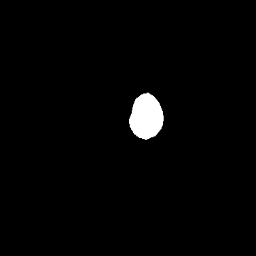

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/123_05_nuc.bmp
Extracted 41 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/123_05_cyt.dat


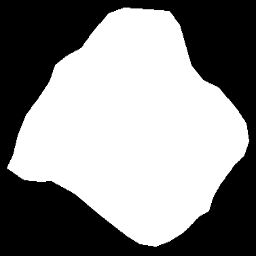

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/123_05_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_10_nuc.dat


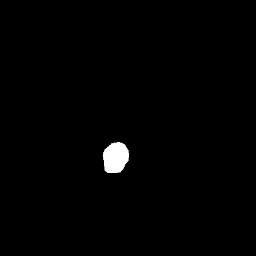

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/069_10_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_10_cyt.dat


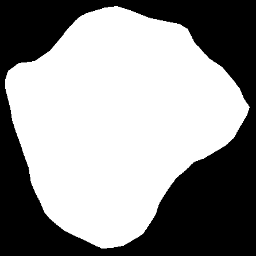

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/069_10_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/055_01_nuc.dat


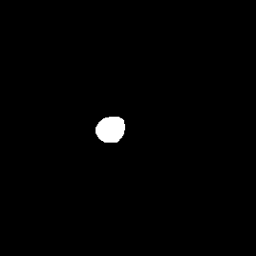

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/055_01_nuc.bmp
Extracted 61 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/055_01_cyt.dat


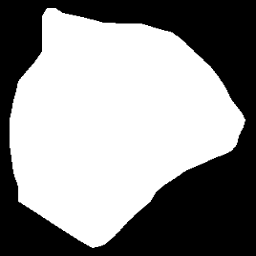

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/055_01_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/108_03_nuc.dat


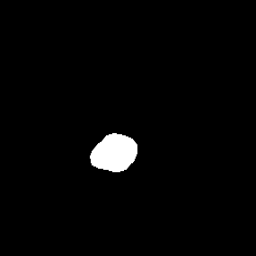

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/108_03_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/108_03_cyt.dat


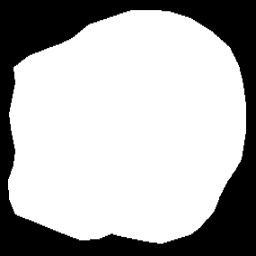

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/108_03_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/082_04_nuc.dat


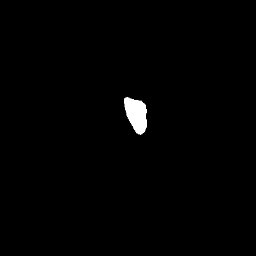

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/082_04_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/082_04_cyt.dat


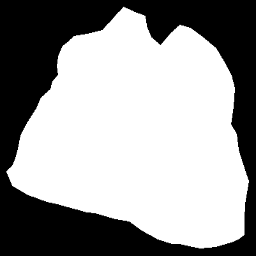

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/082_04_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_10_nuc.dat


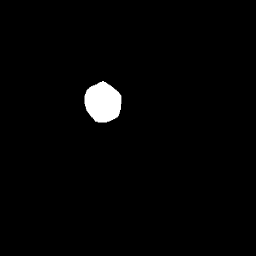

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/017_10_nuc.bmp
Extracted 84 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_10_cyt.dat


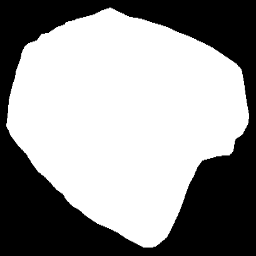

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/017_10_cyt.bmp
Extracted 31 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_04_nuc.dat


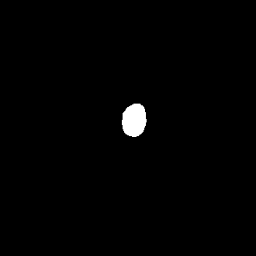

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/057_04_nuc.bmp
Extracted 70 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_04_cyt.dat


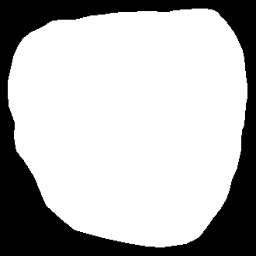

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/057_04_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/086_03_nuc.dat


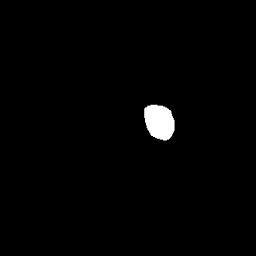

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/086_03_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/086_03_cyt.dat


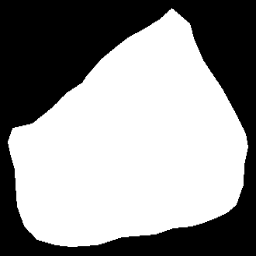

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/086_03_cyt.bmp
Extracted 40 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/003_03_nuc.dat


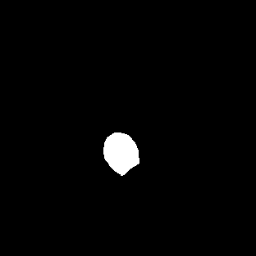

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/003_03_nuc.bmp
Extracted 88 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/003_03_cyt.dat


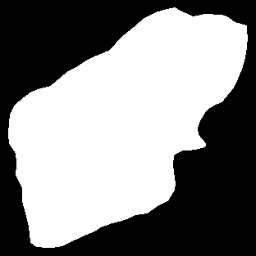

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/003_03_cyt.bmp
Extracted 27 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/006_05_nuc.dat


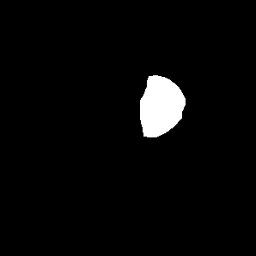

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/006_05_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/006_05_cyt.dat


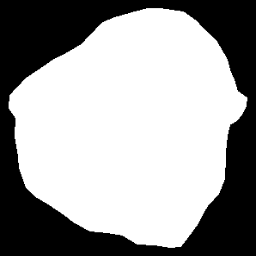

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/006_05_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_02_nuc.dat


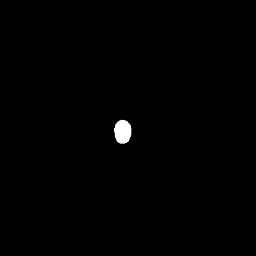

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/046_02_nuc.bmp
Extracted 81 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_02_cyt.dat


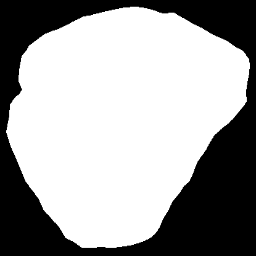

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/046_02_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_10_nuc.dat


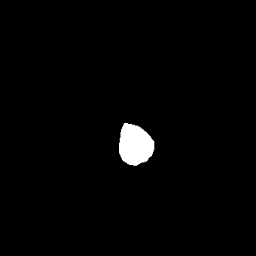

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/097_10_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_10_cyt.dat


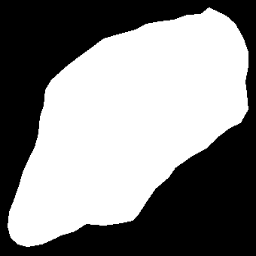

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/097_10_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_09_nuc.dat


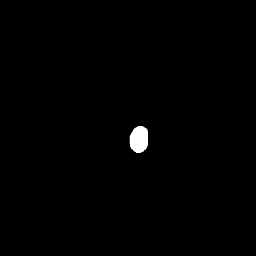

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/004_09_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_09_cyt.dat


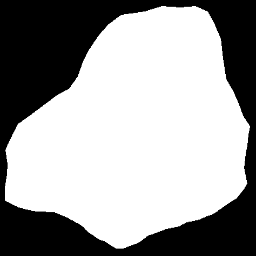

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/004_09_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_05_nuc.dat


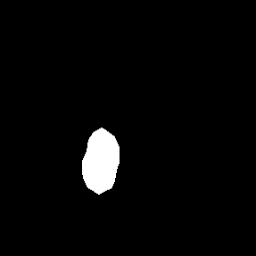

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/119_05_nuc.bmp
Extracted 29 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_05_cyt.dat


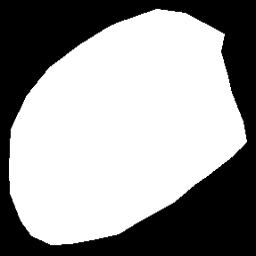

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/119_05_cyt.bmp
Extracted 12 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_06_nuc.dat


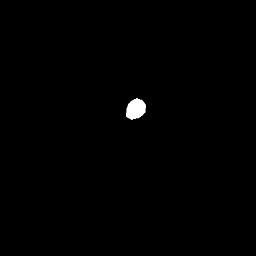

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/061_06_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_06_cyt.dat


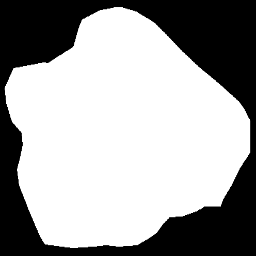

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/061_06_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/018_04_nuc.dat


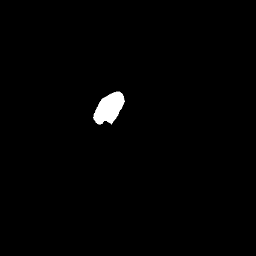

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/018_04_nuc.bmp
Extracted 65 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/018_04_cyt.dat


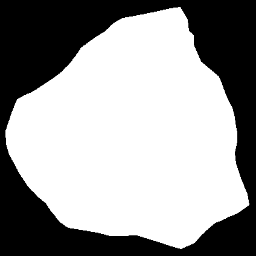

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/018_04_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/059_07_nuc.dat


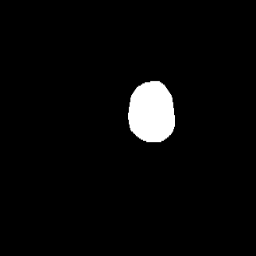

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/059_07_nuc.bmp
Extracted 72 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/059_07_cyt.dat


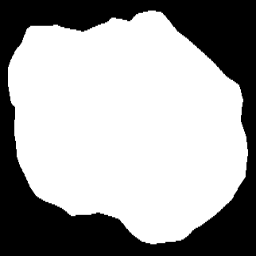

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/059_07_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/012_03_nuc.dat


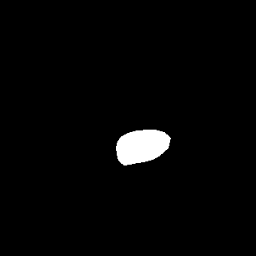

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/012_03_nuc.bmp
Extracted 100 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/012_03_cyt.dat


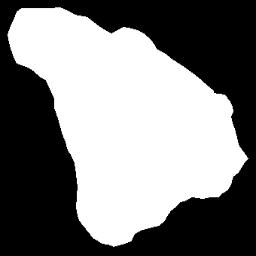

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/012_03_cyt.bmp
Extracted 39 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/031_04_nuc.dat


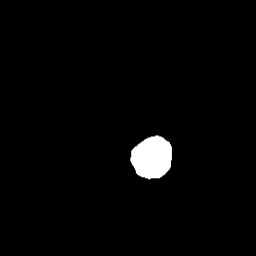

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/031_04_nuc.bmp
Extracted 72 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/031_04_cyt.dat


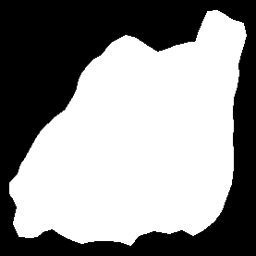

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/031_04_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/082_01_nuc.dat


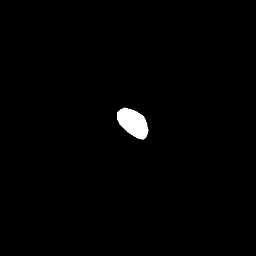

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/082_01_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/082_01_cyt.dat


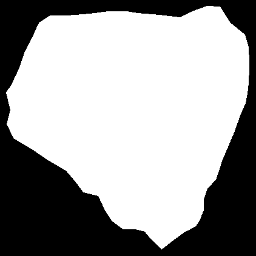

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/082_01_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/050_03_nuc.dat


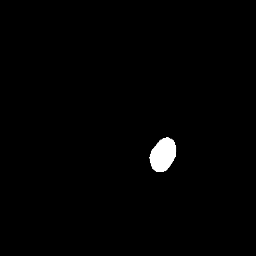

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/050_03_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/050_03_cyt.dat


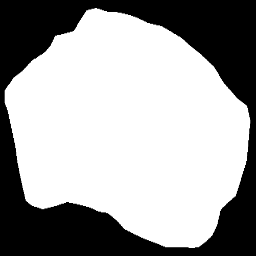

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/050_03_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_13_nuc.dat


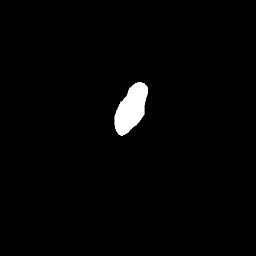

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/007_13_nuc.bmp
Extracted 69 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_13_cyt.dat


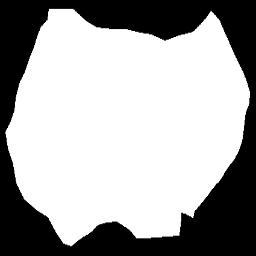

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/007_13_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_03_nuc.dat


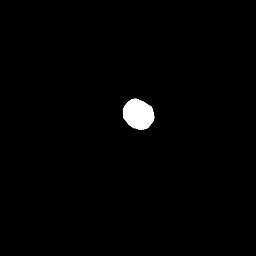

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/023_03_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_03_cyt.dat


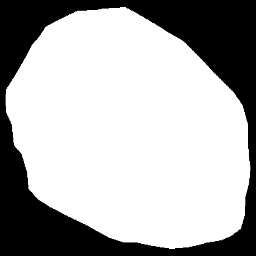

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/023_03_cyt.bmp
Extracted 40 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_11_nuc.dat


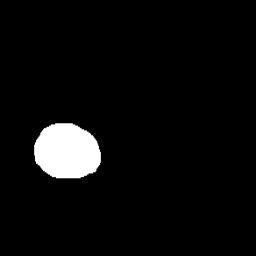

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/029_11_nuc.bmp
Extracted 64 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_11_cyt.dat


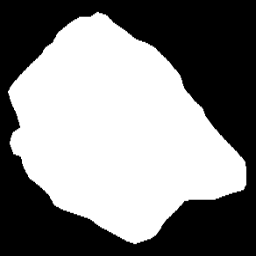

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/029_11_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/082_06_nuc.dat


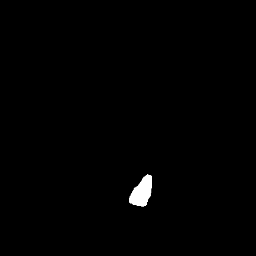

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/082_06_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/082_06_cyt.dat


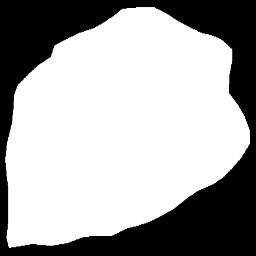

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/082_06_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_02_nuc.dat


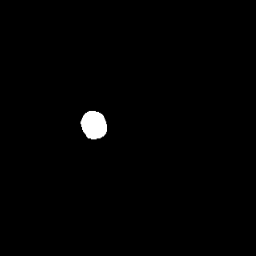

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/057_02_nuc.bmp
Extracted 69 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_02_cyt.dat


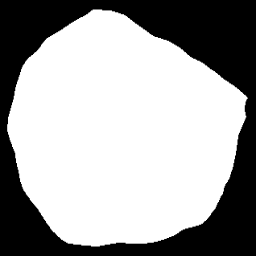

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/057_02_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/121_08_nuc.dat


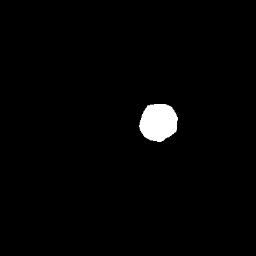

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/121_08_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/121_08_cyt.dat


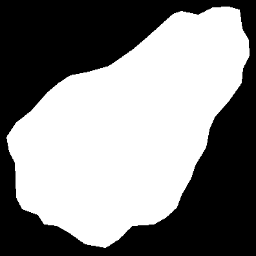

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/121_08_cyt.bmp
Extracted 39 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_02_nuc.dat


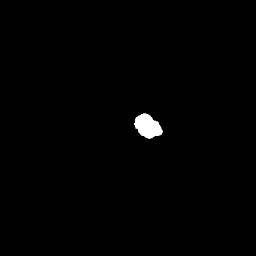

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/080_02_nuc.bmp
Extracted 101 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_02_cyt.dat


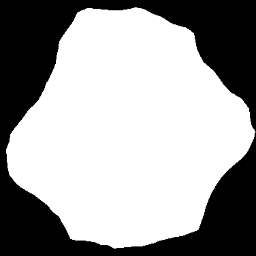

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/080_02_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/035_04_nuc.dat


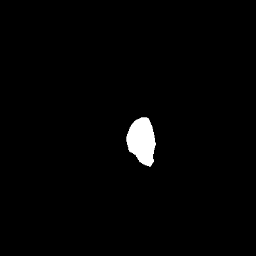

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/035_04_nuc.bmp
Extracted 94 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/035_04_cyt.dat


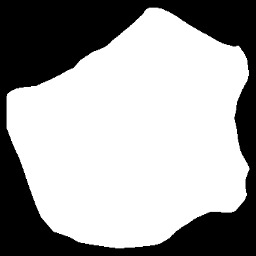

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/035_04_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/065_04_nuc.dat


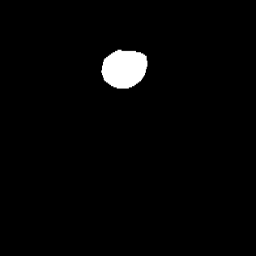

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/065_04_nuc.bmp
Extracted 62 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/065_04_cyt.dat


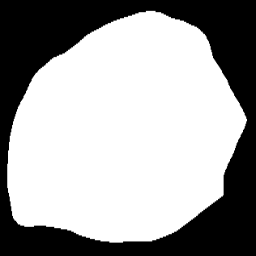

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/065_04_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/063_05_nuc.dat


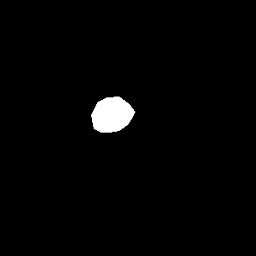

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/063_05_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/063_05_cyt.dat


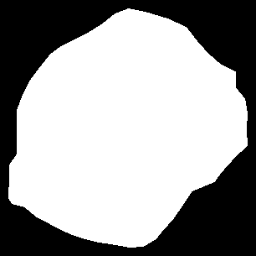

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/063_05_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/112_01_nuc.dat


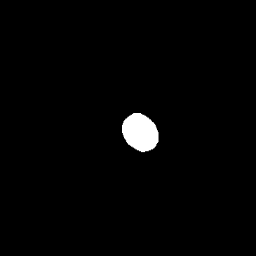

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/112_01_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/112_01_cyt.dat


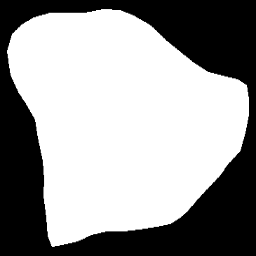

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/112_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_03_nuc.dat


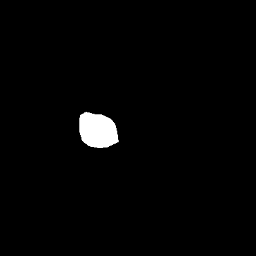

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/017_03_nuc.bmp
Extracted 69 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_03_cyt.dat


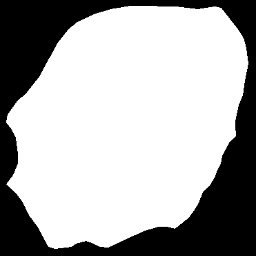

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/017_03_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/121_06_nuc.dat


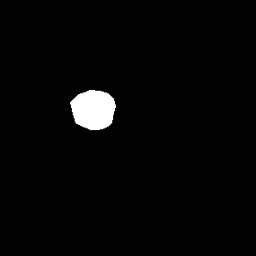

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/121_06_nuc.bmp
Extracted 65 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/121_06_cyt.dat


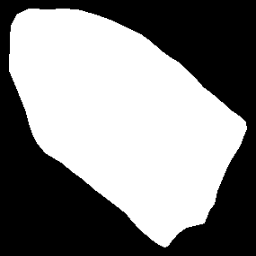

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/121_06_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/035_02_nuc.dat


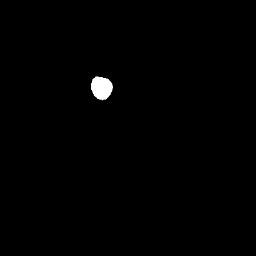

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/035_02_nuc.bmp
Extracted 63 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/035_02_cyt.dat


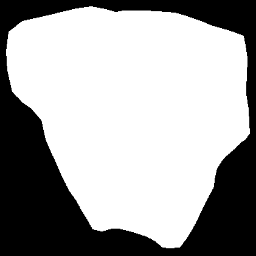

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/035_02_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/124_07_nuc.dat


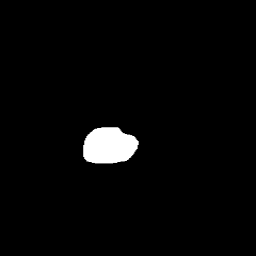

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/124_07_nuc.bmp
Extracted 42 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/124_07_cyt.dat


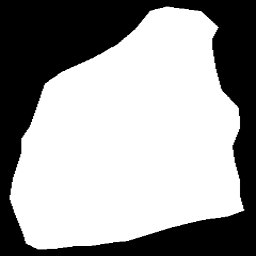

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/124_07_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_10_nuc.dat


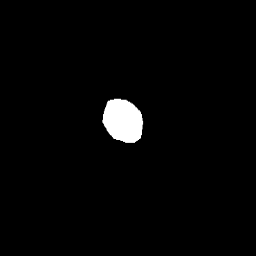

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/106_10_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_10_cyt.dat


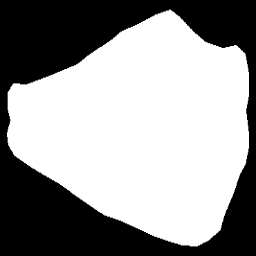

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/106_10_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/105_01_nuc.dat


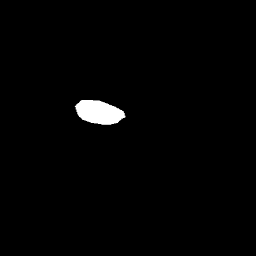

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/105_01_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/105_01_cyt.dat


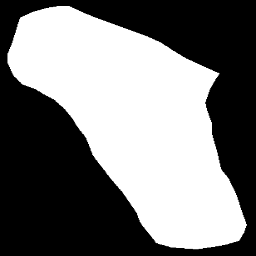

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/105_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/070_03_nuc.dat


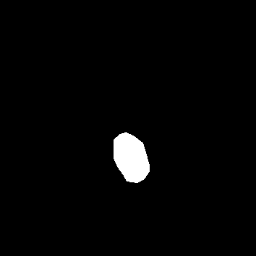

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/070_03_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/070_03_cyt.dat


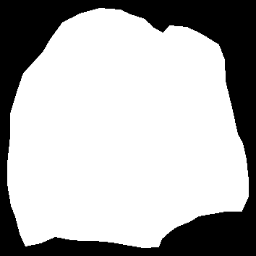

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/070_03_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_02_nuc.dat


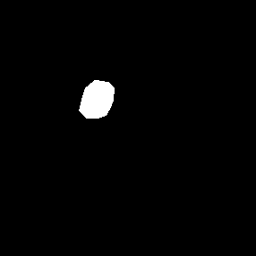

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/097_02_nuc.bmp
Extracted 66 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/097_02_cyt.dat


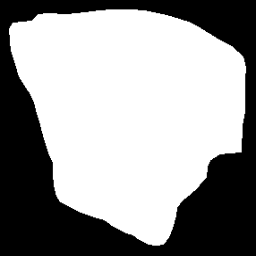

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/097_02_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/073_06_nuc.dat


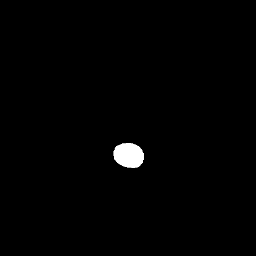

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/073_06_nuc.bmp
Extracted 73 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/073_06_cyt.dat


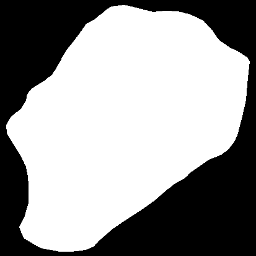

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/073_06_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_13_nuc.dat


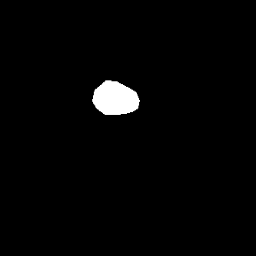

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/106_13_nuc.bmp
Extracted 41 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_13_cyt.dat


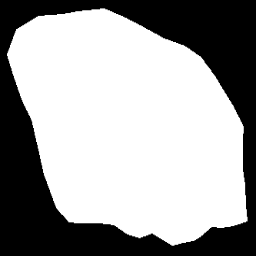

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/106_13_cyt.bmp
Extracted 36 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_12_nuc.dat


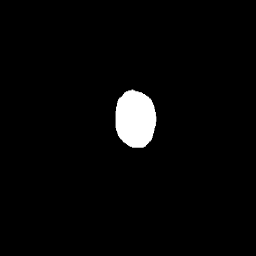

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/029_12_nuc.bmp
Extracted 93 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_12_cyt.dat


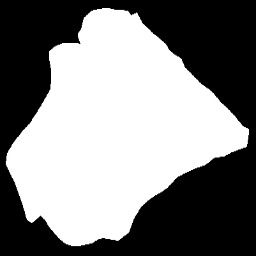

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/029_12_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/012_04_nuc.dat


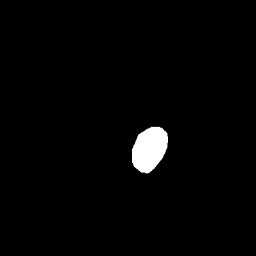

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/012_04_nuc.bmp
Extracted 97 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/012_04_cyt.dat


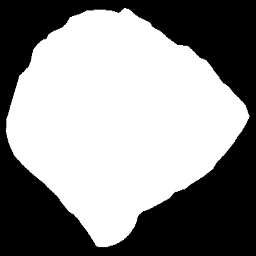

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/012_04_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/082_02_nuc.dat


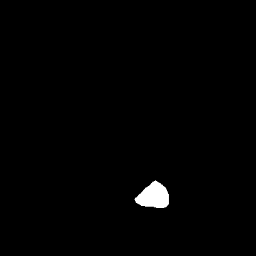

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/082_02_nuc.bmp
Extracted 47 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/082_02_cyt.dat


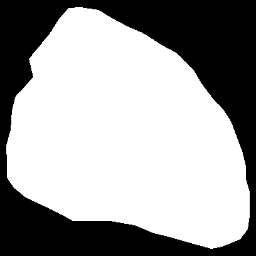

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/082_02_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_15_nuc.dat


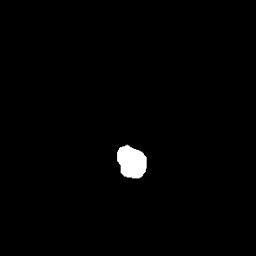

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/017_15_nuc.bmp
Extracted 64 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_15_cyt.dat


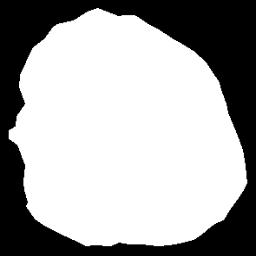

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/017_15_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_06_nuc.dat


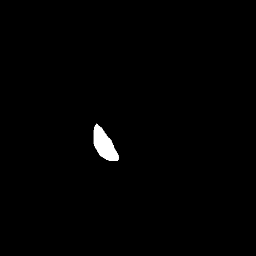

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/080_06_nuc.bmp
Extracted 64 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/080_06_cyt.dat


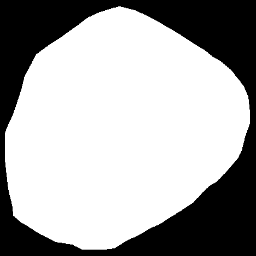

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/080_06_cyt.bmp
Extracted 26 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/117_03_nuc.dat


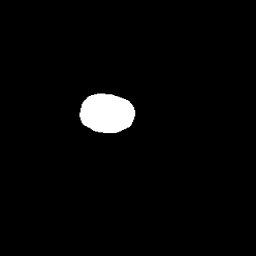

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/117_03_nuc.bmp
Extracted 61 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/117_03_cyt.dat


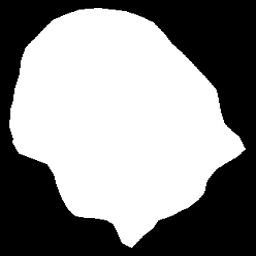

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/117_03_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_04_nuc.dat


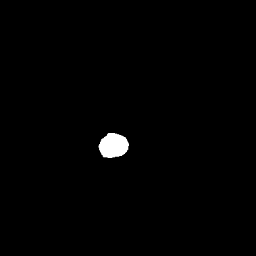

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/046_04_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/046_04_cyt.dat


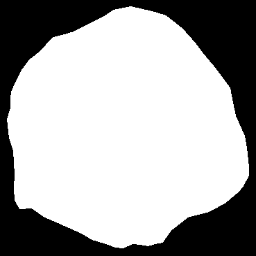

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/046_04_cyt.bmp
Extracted 12 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_11_nuc.dat


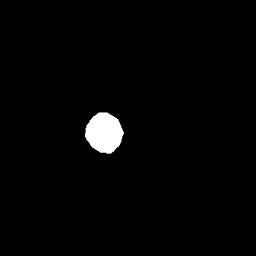

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/106_11_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/106_11_cyt.dat


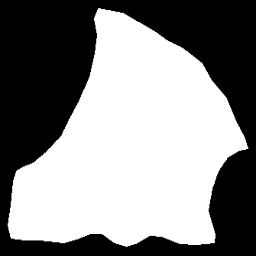

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/106_11_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/044_02_nuc.dat


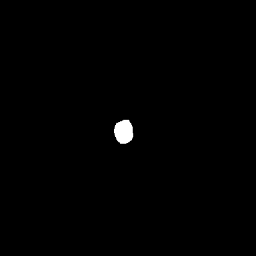

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/044_02_nuc.bmp
Extracted 61 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/044_02_cyt.dat


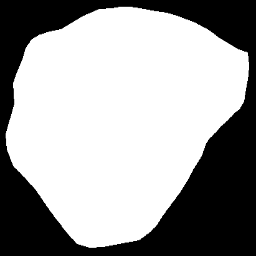

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/044_02_cyt.bmp
Extracted 27 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/028_06_nuc.dat


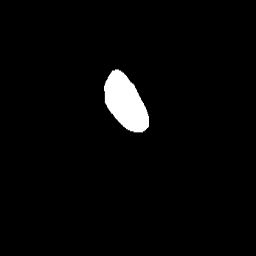

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/028_06_nuc.bmp
Extracted 79 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/028_06_cyt.dat


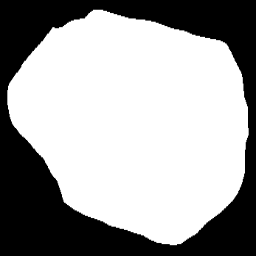

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/028_06_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_01_nuc.dat


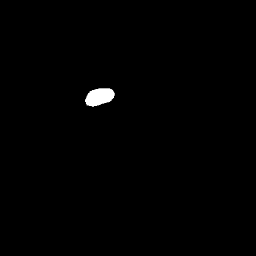

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/017_01_nuc.bmp
Extracted 96 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_01_cyt.dat


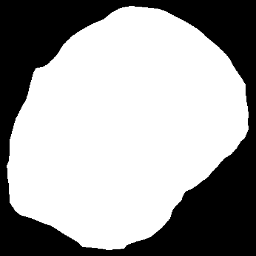

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/017_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_01_nuc.dat


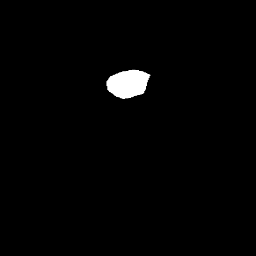

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/061_01_nuc.bmp
Extracted 61 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_01_cyt.dat


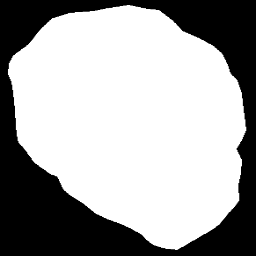

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/061_01_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/102_05_nuc.dat


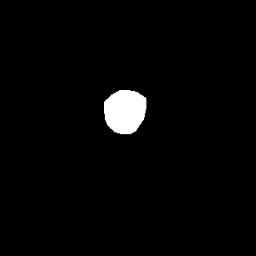

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/102_05_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/102_05_cyt.dat


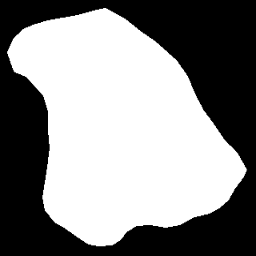

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/102_05_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_07_nuc.dat


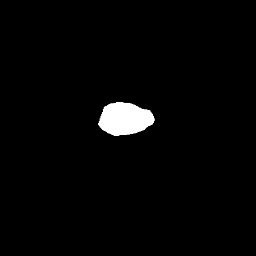

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/069_07_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_07_cyt.dat


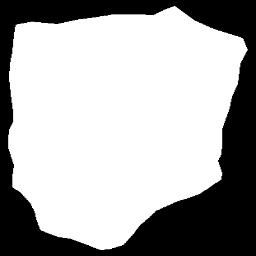

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/069_07_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/101_04_nuc.dat


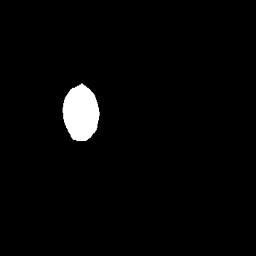

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/101_04_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/101_04_cyt.dat


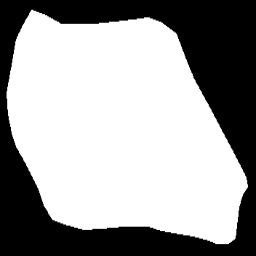

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/101_04_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/041_01_nuc.dat


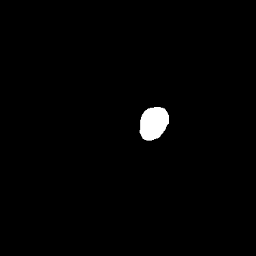

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/041_01_nuc.bmp
Extracted 89 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/041_01_cyt.dat


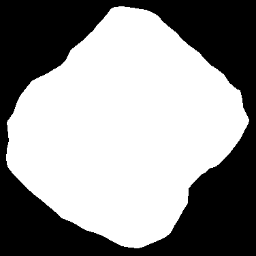

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/041_01_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/076_05_nuc.dat


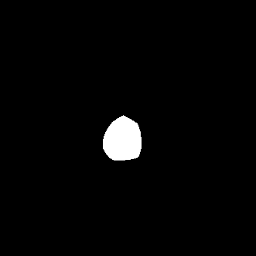

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/076_05_nuc.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/076_05_cyt.dat


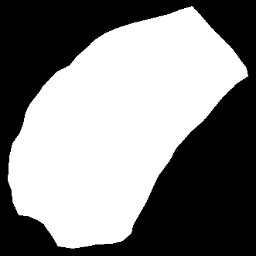

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/076_05_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/114_08_nuc.dat


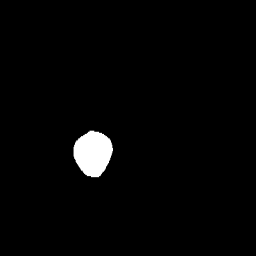

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/114_08_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/114_08_cyt.dat


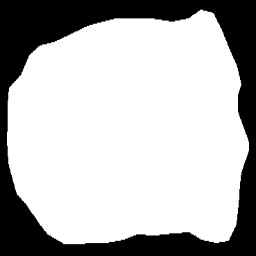

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/114_08_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/085_01_nuc.dat


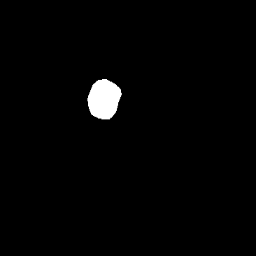

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/085_01_nuc.bmp
Extracted 67 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/085_01_cyt.dat


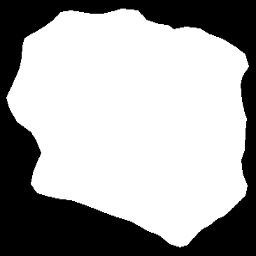

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/085_01_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/002_04_nuc.dat


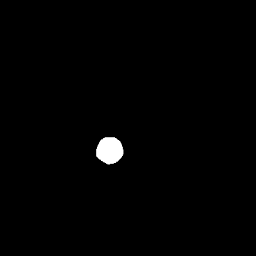

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/002_04_nuc.bmp
Extracted 50 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/002_04_cyt.dat


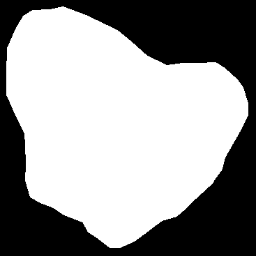

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/002_04_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/087_03_nuc.dat


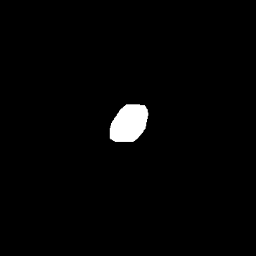

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/087_03_nuc.bmp
Extracted 78 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/087_03_cyt.dat


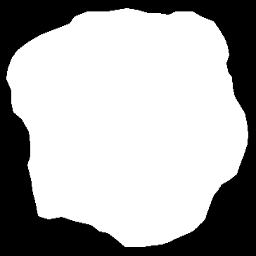

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/087_03_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_01_nuc.dat


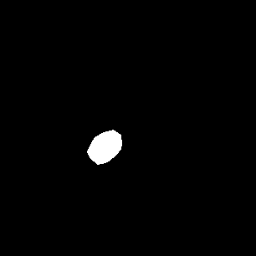

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/066_01_nuc.bmp
Extracted 48 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/066_01_cyt.dat


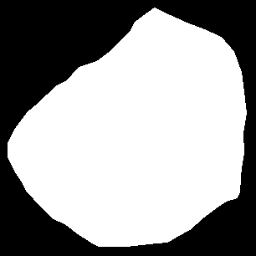

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/066_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_01_nuc.dat


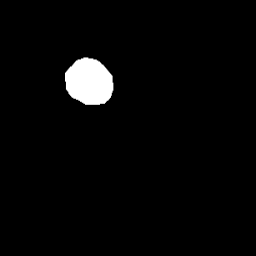

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/096_01_nuc.bmp
Extracted 47 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/096_01_cyt.dat


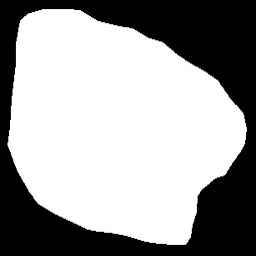

✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/096_01_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/071_07_nuc.dat


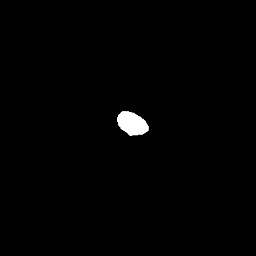

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/071_07_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/071_07_cyt.dat


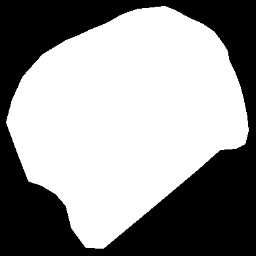

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/071_07_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/006_04_nuc.dat


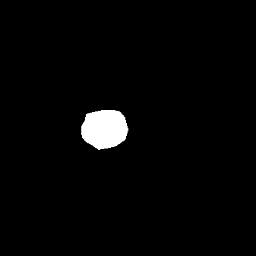

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/006_04_nuc.bmp
Extracted 66 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/006_04_cyt.dat


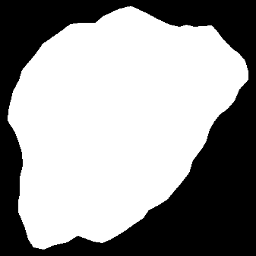

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/006_04_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/126_03_nuc.dat


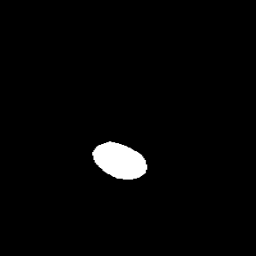

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/126_03_nuc.bmp
Extracted 32 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/126_03_cyt.dat


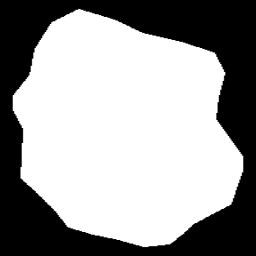

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/126_03_cyt.bmp
Extracted 28 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/033_03_nuc.dat


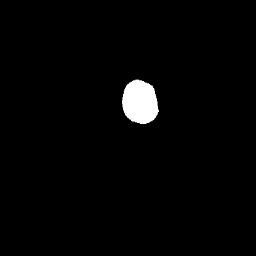

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/033_03_nuc.bmp
Extracted 72 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/033_03_cyt.dat


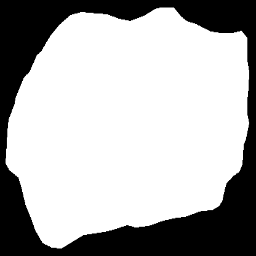

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/033_03_cyt.bmp
Extracted 28 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_05_nuc.dat


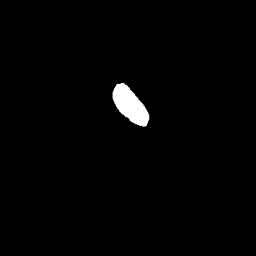

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/032_05_nuc.bmp
Extracted 39 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_05_cyt.dat


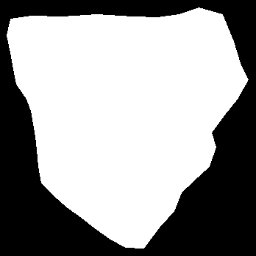

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/032_05_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_09_nuc.dat


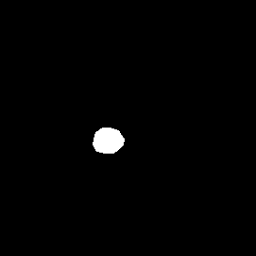

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/021_09_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_09_cyt.dat


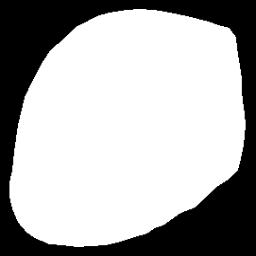

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/021_09_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/112_08_nuc.dat


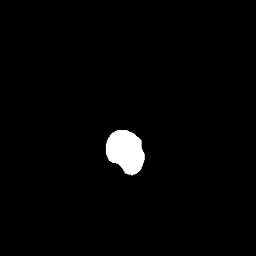

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/112_08_nuc.bmp
Extracted 45 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/112_08_cyt.dat


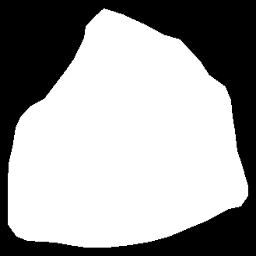

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/112_08_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/101_03_nuc.dat


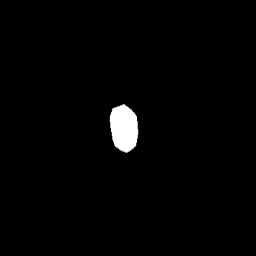

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/101_03_nuc.bmp
Extracted 61 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/101_03_cyt.dat


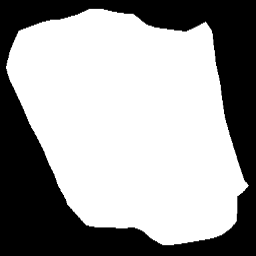

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/101_03_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_02_nuc.dat


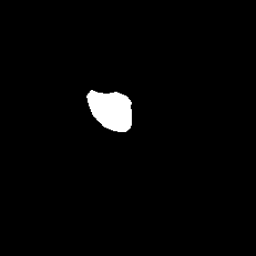

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/119_02_nuc.bmp
Extracted 60 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/119_02_cyt.dat


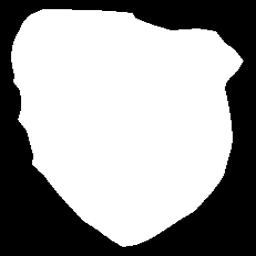

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/119_02_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_03_nuc.dat


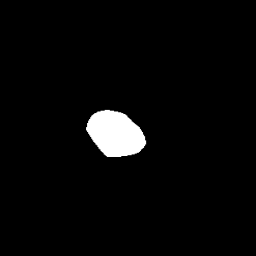

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/020_03_nuc.bmp
Extracted 84 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_03_cyt.dat


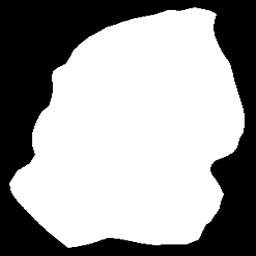

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/020_03_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_13_nuc.dat


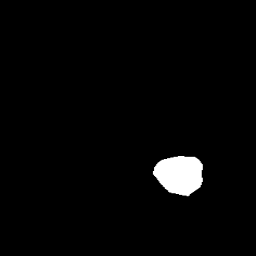

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/004_13_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/004_13_cyt.dat


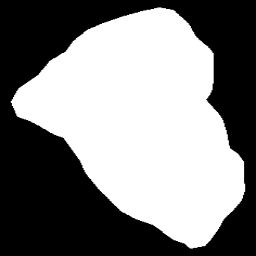

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/004_13_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/100_04_nuc.dat


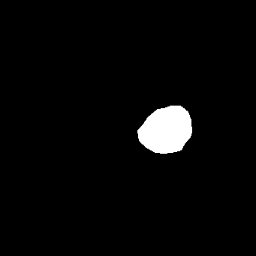

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/100_04_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/100_04_cyt.dat


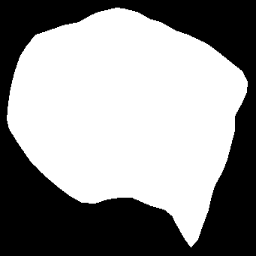

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/100_04_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_04_nuc.dat


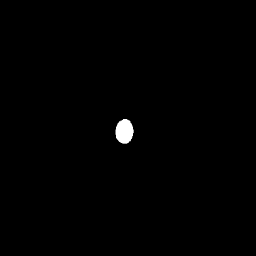

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/045_04_nuc.bmp
Extracted 77 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/045_04_cyt.dat


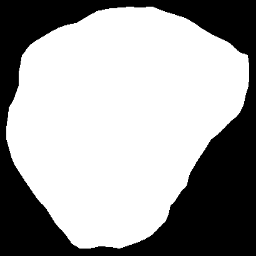

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/045_04_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/053_03_nuc.dat


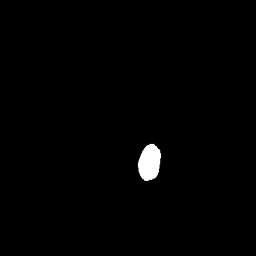

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/053_03_nuc.bmp
Extracted 80 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/053_03_cyt.dat


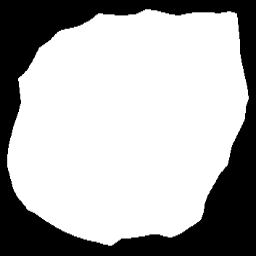

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/053_03_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/100_05_nuc.dat


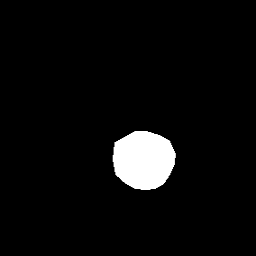

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/100_05_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/100_05_cyt.dat


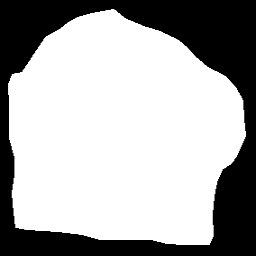

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/100_05_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_04_nuc.dat


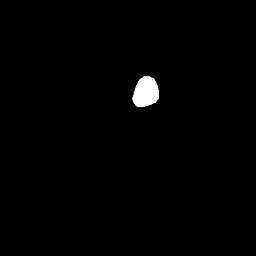

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/069_04_nuc.bmp
Extracted 60 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/069_04_cyt.dat


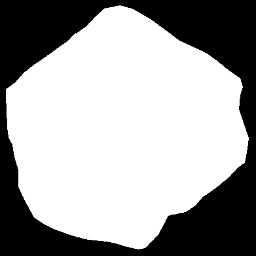

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/069_04_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/047_03_nuc.dat


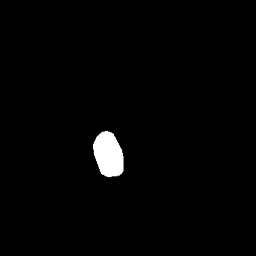

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/047_03_nuc.bmp
Extracted 84 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/047_03_cyt.dat


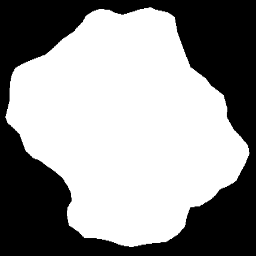

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/047_03_cyt.bmp
Extracted 25 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_02_nuc.dat


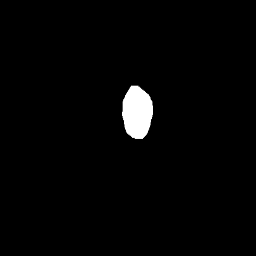

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/118_02_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_02_cyt.dat


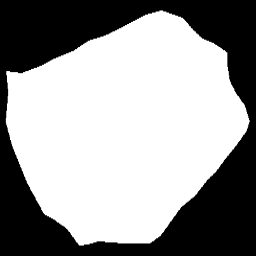

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/118_02_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_03_nuc.dat


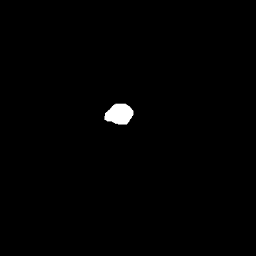

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/083_03_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_03_cyt.dat


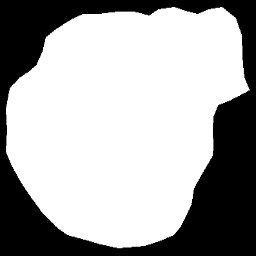

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/083_03_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/048_01_nuc.dat


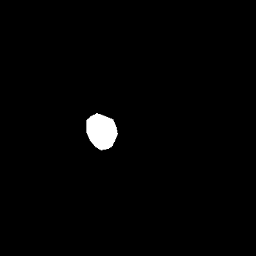

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/048_01_nuc.bmp
Extracted 66 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/048_01_cyt.dat


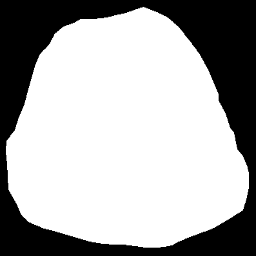

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/048_01_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/037_01_nuc.dat


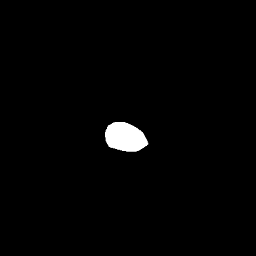

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/037_01_nuc.bmp
Extracted 66 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/037_01_cyt.dat


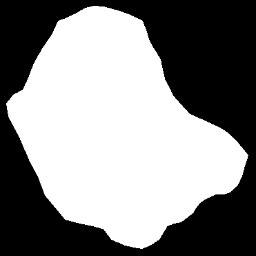

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/037_01_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/109_04_nuc.dat


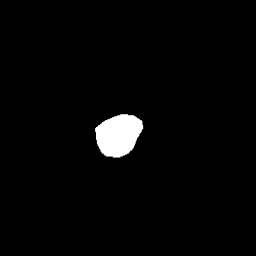

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/109_04_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/109_04_cyt.dat


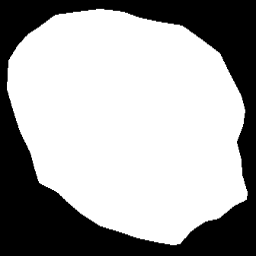

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/109_04_cyt.bmp
Extracted 27 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_04_nuc.dat


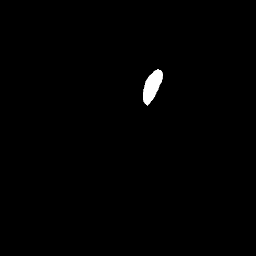

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/032_04_nuc.bmp
Extracted 64 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/032_04_cyt.dat


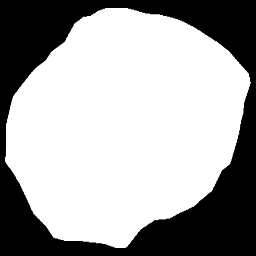

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/032_04_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/124_06_nuc.dat


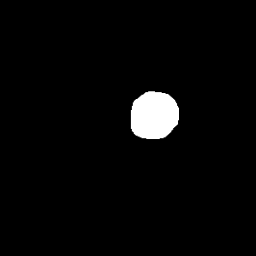

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/124_06_nuc.bmp
Extracted 36 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/124_06_cyt.dat


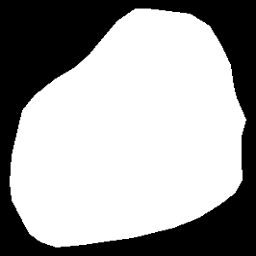

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/124_06_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/026_01_nuc.dat


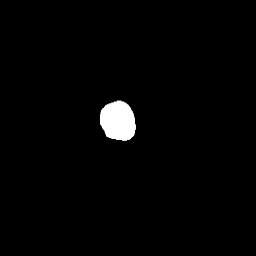

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/026_01_nuc.bmp
Extracted 82 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/026_01_cyt.dat


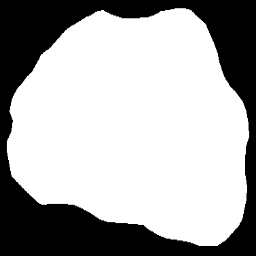

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/026_01_cyt.bmp
Extracted 28 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/035_01_nuc.dat


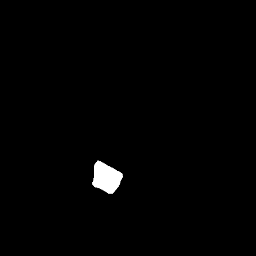

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/035_01_nuc.bmp
Extracted 73 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/035_01_cyt.dat


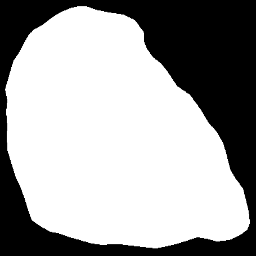

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/035_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/076_03_nuc.dat


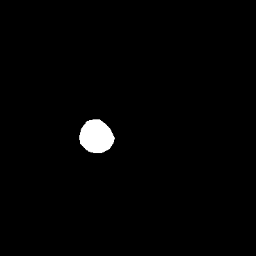

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/076_03_nuc.bmp
Extracted 55 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/076_03_cyt.dat


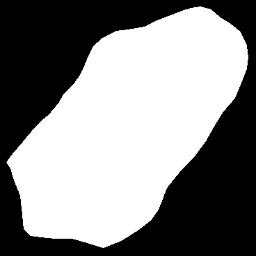

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/076_03_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/016_03_nuc.dat


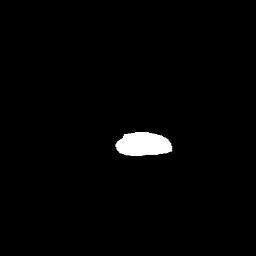

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/016_03_nuc.bmp
Extracted 67 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/016_03_cyt.dat


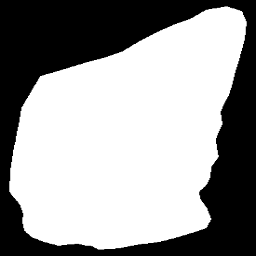

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/016_03_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/072_01_nuc.dat


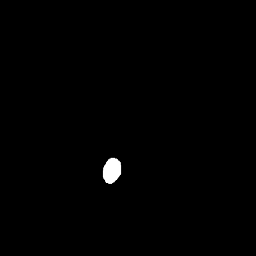

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/072_01_nuc.bmp
Extracted 78 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/072_01_cyt.dat


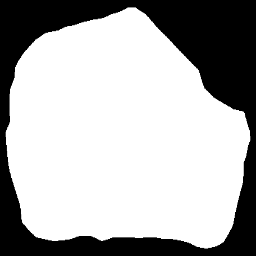

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/072_01_cyt.bmp
Extracted 12 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/060_06_nuc.dat


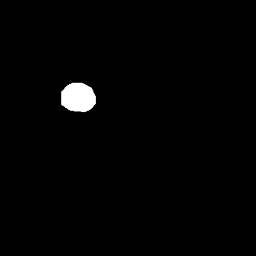

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/060_06_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/060_06_cyt.dat


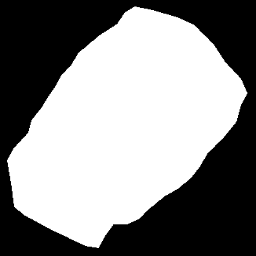

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/060_06_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_01_nuc.dat


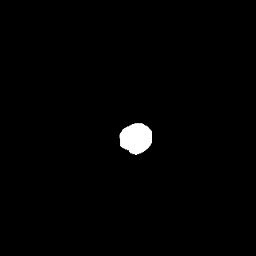

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/023_01_nuc.bmp
Extracted 74 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_01_cyt.dat


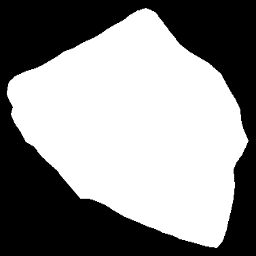

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/023_01_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/050_07_nuc.dat


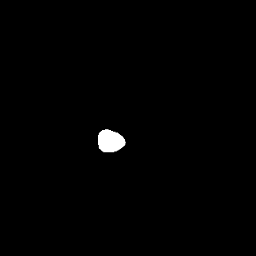

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/050_07_nuc.bmp
Extracted 106 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/050_07_cyt.dat


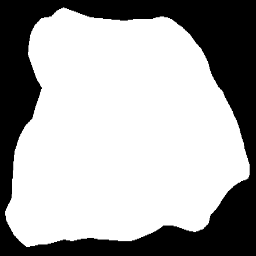

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/050_07_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_09_nuc.dat


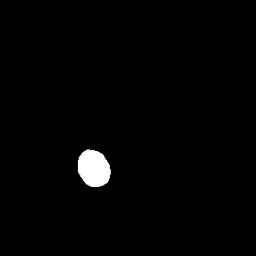

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/020_09_nuc.bmp
Extracted 73 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_09_cyt.dat


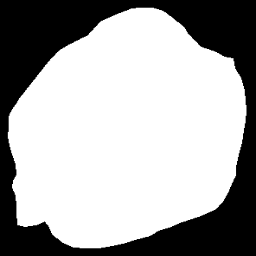

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/020_09_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_07_nuc.dat


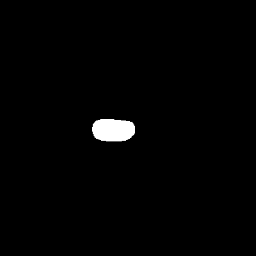

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/021_07_nuc.bmp
Extracted 40 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/021_07_cyt.dat


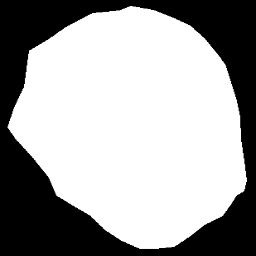

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/021_07_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/079_03_nuc.dat


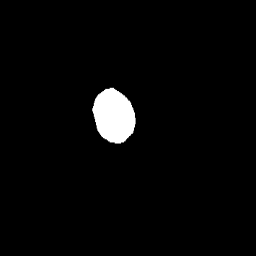

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/079_03_nuc.bmp
Extracted 79 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/079_03_cyt.dat


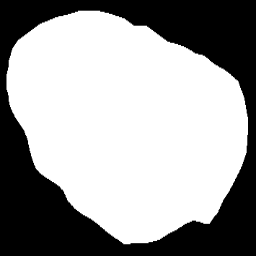

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/079_03_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/107_02_nuc.dat


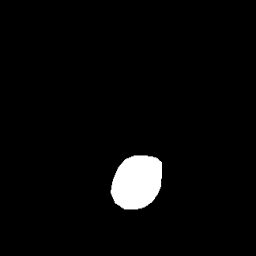

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/107_02_nuc.bmp
Extracted 45 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/107_02_cyt.dat


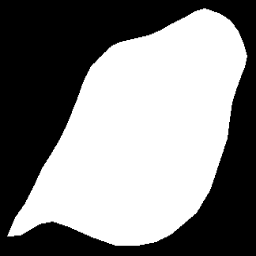

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/107_02_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_08_nuc.dat


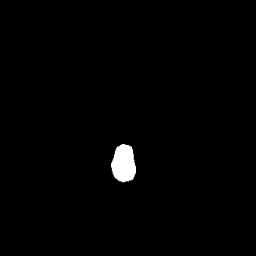

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/118_08_nuc.bmp
Extracted 36 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/118_08_cyt.dat


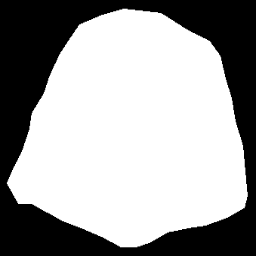

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/118_08_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_02_nuc.dat


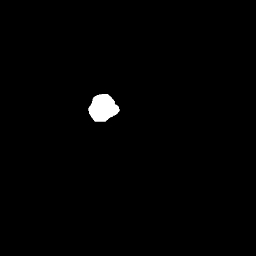

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/014_02_nuc.bmp
Extracted 57 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/014_02_cyt.dat


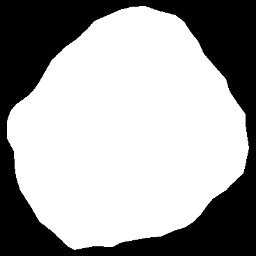

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/014_02_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_03_nuc.dat


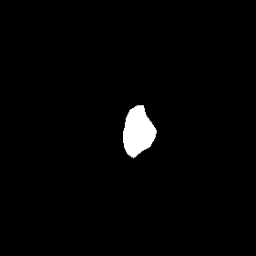

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/099_03_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/099_03_cyt.dat


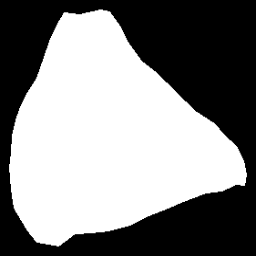

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/099_03_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/056_01_nuc.dat


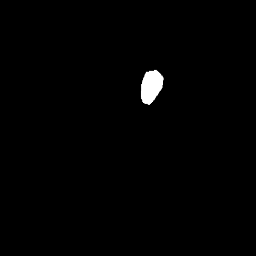

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/056_01_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/056_01_cyt.dat


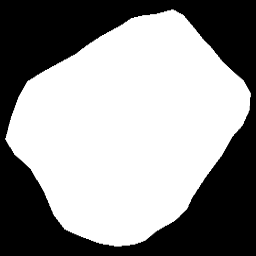

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/056_01_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/077_01_nuc.dat


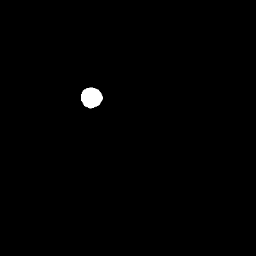

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/077_01_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/077_01_cyt.dat


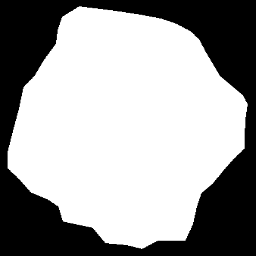

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/077_01_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/025_03_nuc.dat


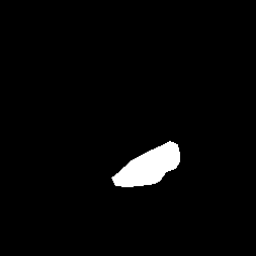

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/025_03_nuc.bmp
Extracted 60 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/025_03_cyt.dat


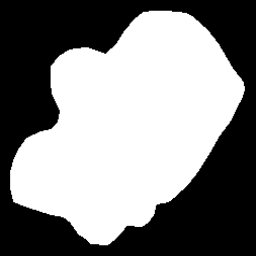

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/025_03_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_12_nuc.dat


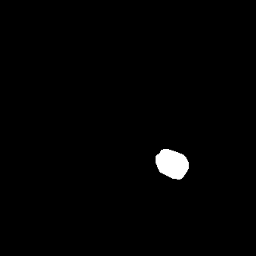

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/017_12_nuc.bmp
Extracted 44 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_12_cyt.dat


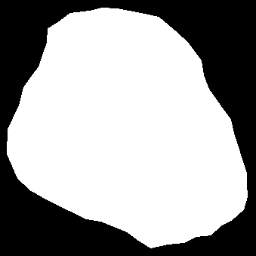

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/017_12_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/111_05_nuc.dat


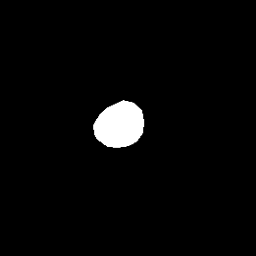

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/111_05_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/111_05_cyt.dat


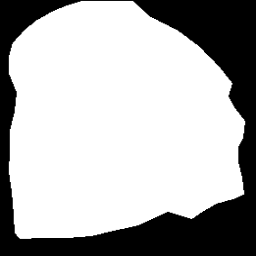

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/111_05_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/114_02_nuc.dat


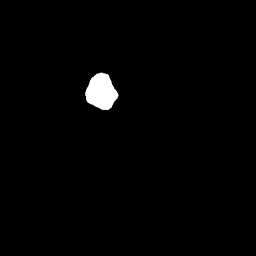

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/114_02_nuc.bmp
Extracted 49 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/114_02_cyt.dat


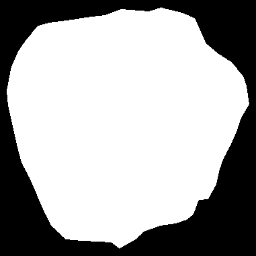

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/114_02_cyt.bmp
Extracted 15 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/062_01_nuc.dat


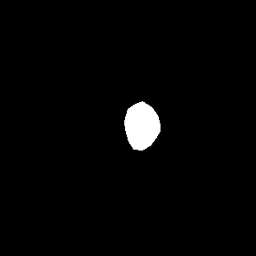

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/062_01_nuc.bmp
Extracted 46 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/062_01_cyt.dat


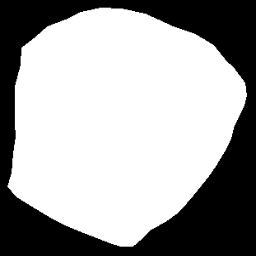

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/062_01_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/076_01_nuc.dat


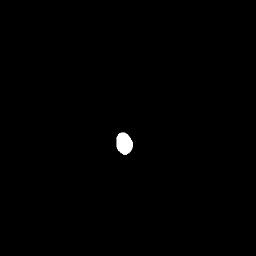

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/076_01_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/076_01_cyt.dat


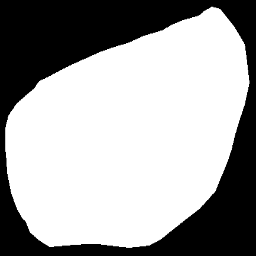

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/076_01_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_18_nuc.dat


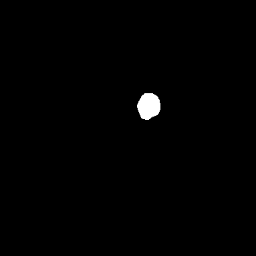

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/017_18_nuc.bmp
Extracted 85 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_18_cyt.dat


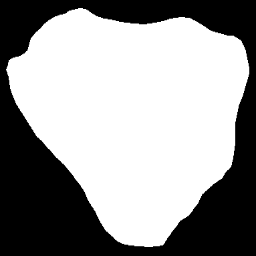

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/017_18_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_11_nuc.dat


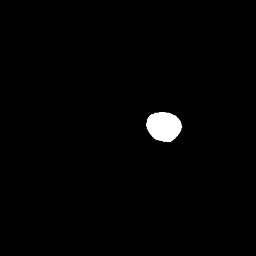

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/083_11_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/083_11_cyt.dat


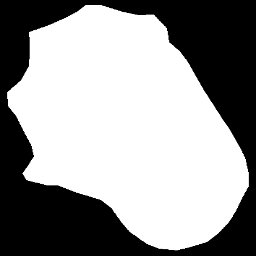

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/083_11_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/016_01_nuc.dat


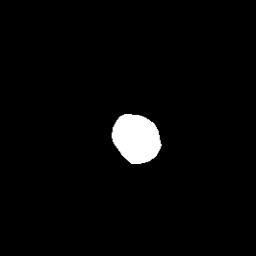

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/016_01_nuc.bmp
Extracted 71 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/016_01_cyt.dat


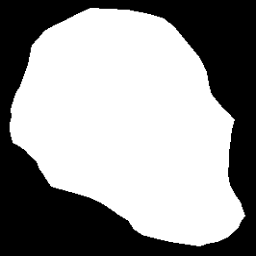

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/016_01_cyt.bmp
Extracted 24 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/121_03_nuc.dat


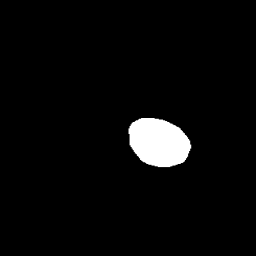

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/121_03_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/121_03_cyt.dat


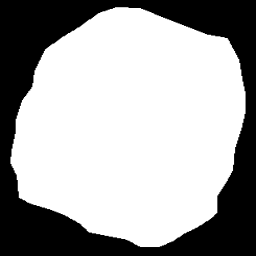

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/121_03_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/058_06_nuc.dat


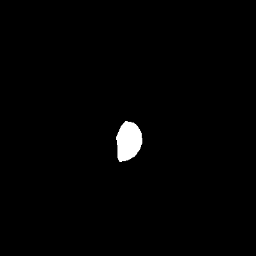

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/058_06_nuc.bmp
Extracted 56 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/058_06_cyt.dat


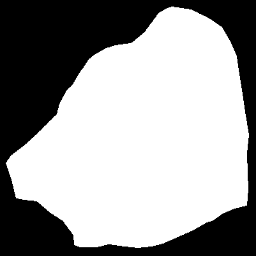

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/058_06_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_05_nuc.dat


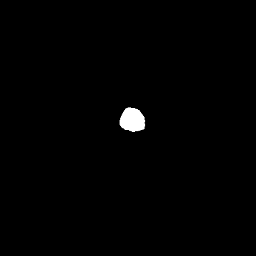

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/023_05_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/023_05_cyt.dat


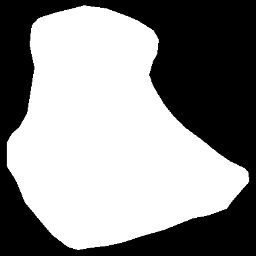

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/023_05_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_09_nuc.dat


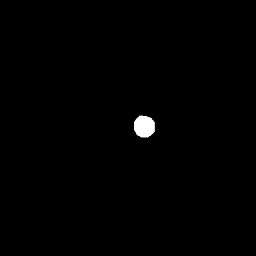

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/019_09_nuc.bmp
Extracted 70 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/019_09_cyt.dat


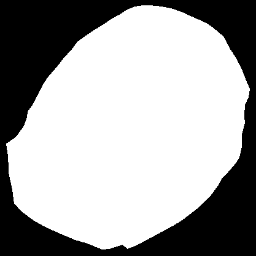

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/019_09_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_10_nuc.dat


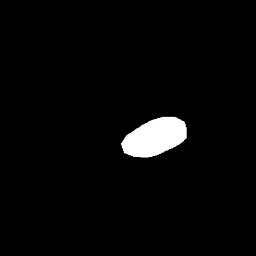

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/094_10_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/094_10_cyt.dat


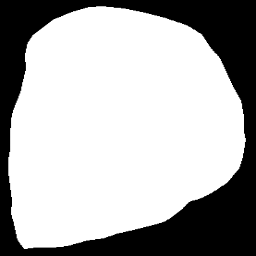

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/094_10_cyt.bmp
Extracted 59 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/030_02_nuc.dat


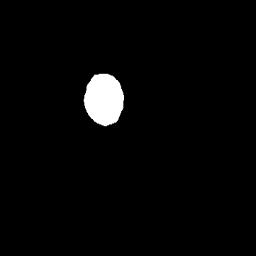

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/030_02_nuc.bmp
Extracted 91 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/030_02_cyt.dat


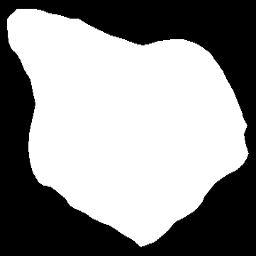

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/030_02_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/114_06_nuc.dat


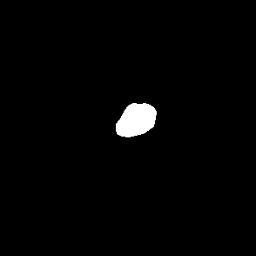

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/114_06_nuc.bmp
Extracted 43 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/114_06_cyt.dat


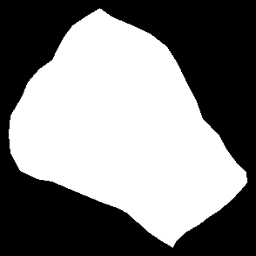

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/114_06_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/116_02_nuc.dat


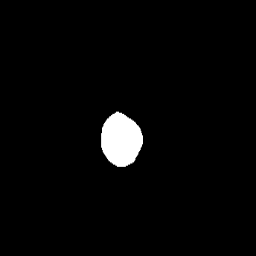

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/116_02_nuc.bmp
Extracted 41 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/116_02_cyt.dat


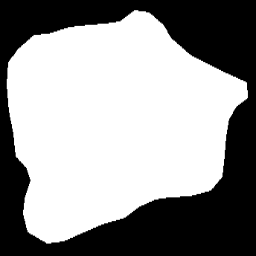

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/116_02_cyt.bmp
Extracted 34 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_03_nuc.dat


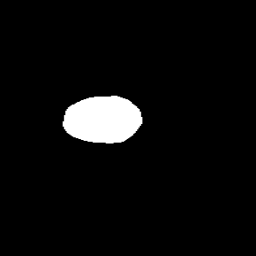

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/029_03_nuc.bmp
Extracted 67 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/029_03_cyt.dat


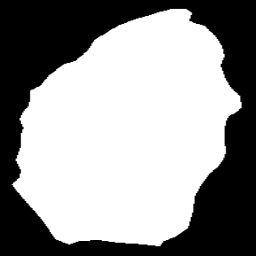

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/029_03_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/114_04_nuc.dat


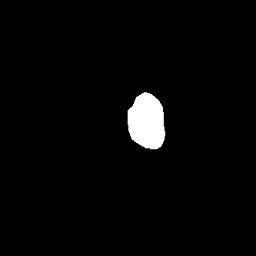

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/114_04_nuc.bmp
Extracted 45 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/114_04_cyt.dat


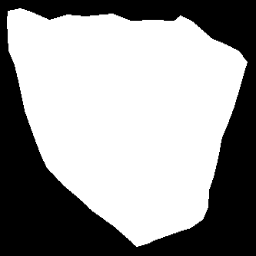

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/114_04_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_10_nuc.dat


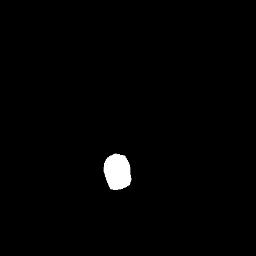

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/057_10_nuc.bmp
Extracted 68 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_10_cyt.dat


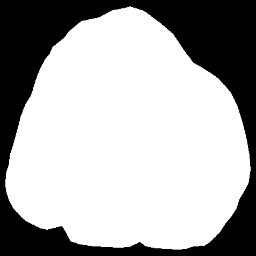

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/057_10_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/107_07_nuc.dat


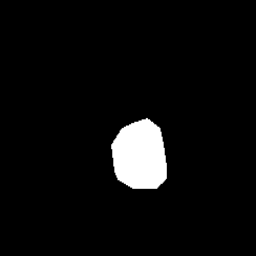

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/107_07_nuc.bmp
Extracted 32 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/107_07_cyt.dat


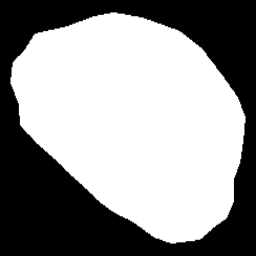

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/107_07_cyt.bmp
Extracted 28 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_05_nuc.dat


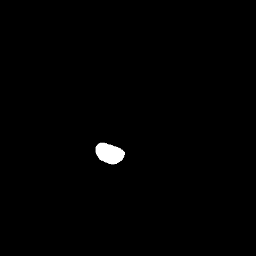

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/020_05_nuc.bmp
Extracted 60 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/020_05_cyt.dat


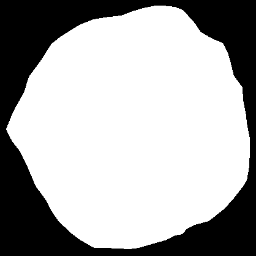

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/020_05_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_07_nuc.dat


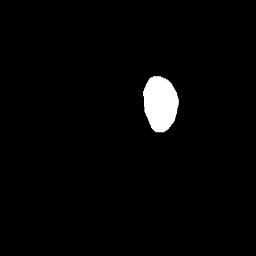

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/007_07_nuc.bmp
Extracted 41 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/007_07_cyt.dat


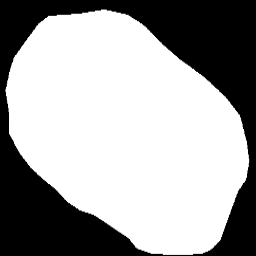

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/007_07_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/125_04_nuc.dat


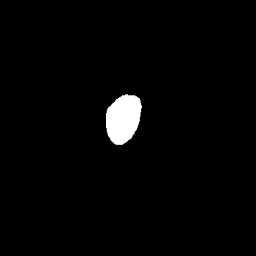

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/125_04_nuc.bmp
Extracted 40 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/125_04_cyt.dat


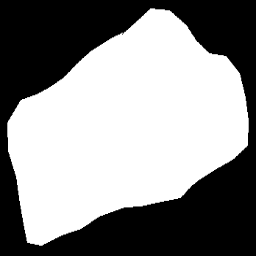

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/125_04_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_05_nuc.dat


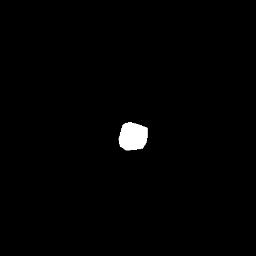

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/061_05_nuc.bmp
Extracted 52 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/061_05_cyt.dat


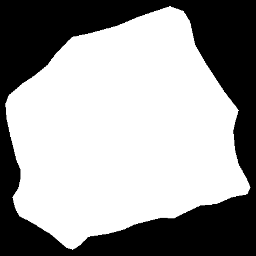

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/061_05_cyt.bmp
Extracted 19 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/024_02_nuc.dat


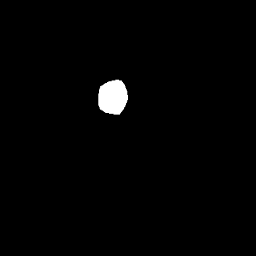

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/024_02_nuc.bmp
Extracted 67 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/024_02_cyt.dat


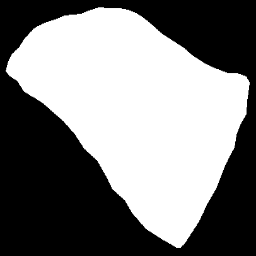

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/024_02_cyt.bmp
Extracted 18 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/095_04_nuc.dat


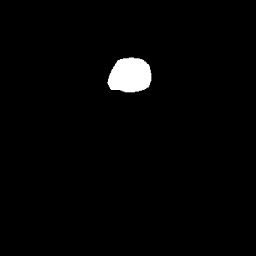

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/095_04_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/095_04_cyt.dat


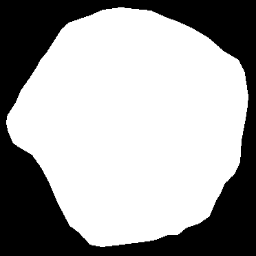

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/095_04_cyt.bmp
Extracted 16 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/111_02_nuc.dat


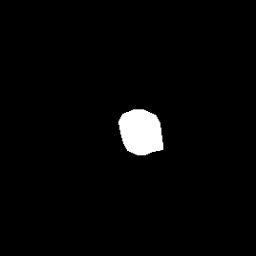

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/111_02_nuc.bmp
Extracted 40 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/111_02_cyt.dat


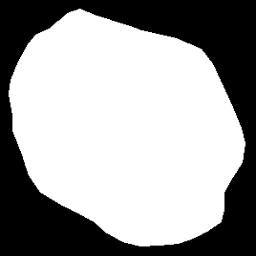

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/111_02_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/055_04_nuc.dat


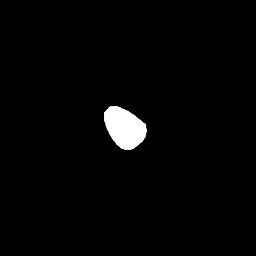

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/055_04_nuc.bmp
Extracted 74 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/055_04_cyt.dat


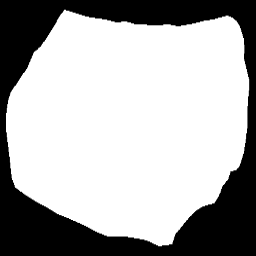

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/055_04_cyt.bmp
Extracted 22 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/121_01_nuc.dat


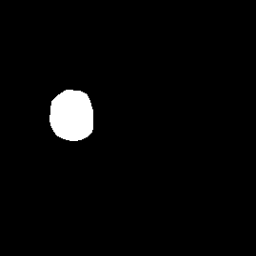

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/121_01_nuc.bmp
Extracted 38 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/121_01_cyt.dat


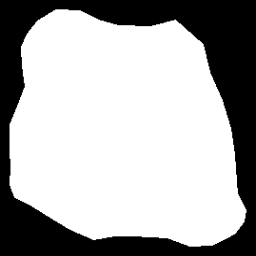

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/121_01_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_11_nuc.dat


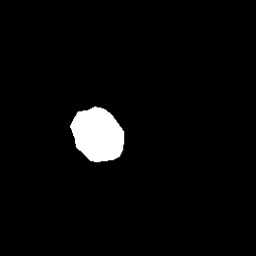

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/017_11_nuc.bmp
Extracted 76 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_11_cyt.dat


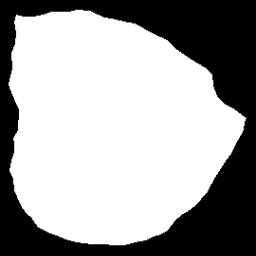

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/017_11_cyt.bmp
Extracted 21 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/084_01_nuc.dat


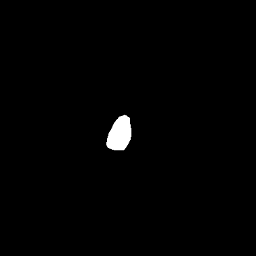

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/084_01_nuc.bmp
Extracted 51 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/084_01_cyt.dat


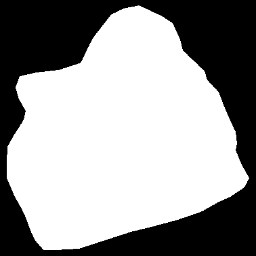

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/084_01_cyt.bmp
Extracted 14 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/112_05_nuc.dat


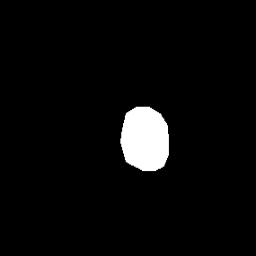

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/112_05_nuc.bmp
Extracted 35 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/112_05_cyt.dat


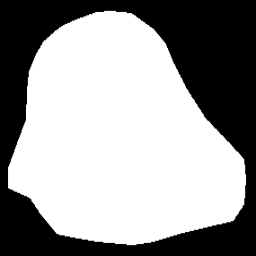

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/112_05_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_05_nuc.dat


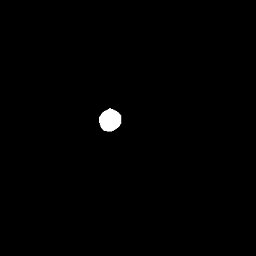

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/057_05_nuc.bmp
Extracted 88 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/057_05_cyt.dat


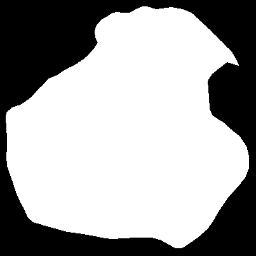

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/057_05_cyt.bmp
Extracted 13 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/076_02_nuc.dat


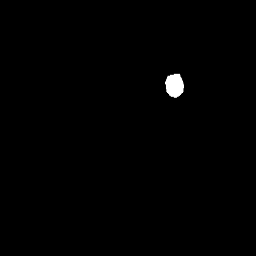

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/076_02_nuc.bmp
Extracted 58 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/076_02_cyt.dat


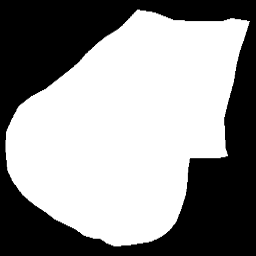

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/076_02_cyt.bmp
Extracted 17 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/078_01_nuc.dat


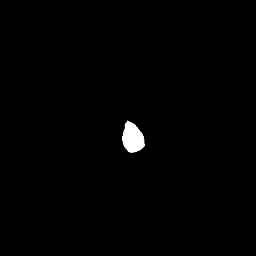

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/078_01_nuc.bmp
Extracted 58 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/078_01_cyt.dat


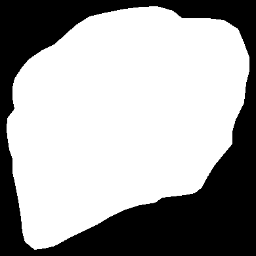

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/078_01_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_20_nuc.dat


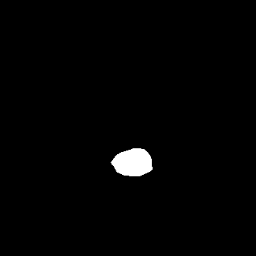

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/017_20_nuc.bmp
Extracted 91 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/017_20_cyt.dat


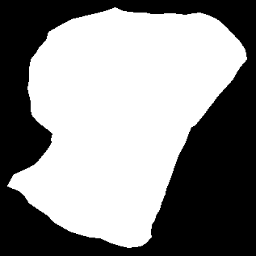

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/017_20_cyt.bmp
Extracted 20 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/126_02_nuc.dat


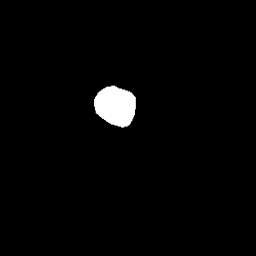

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/126_02_nuc.bmp
Extracted 35 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/126_02_cyt.dat


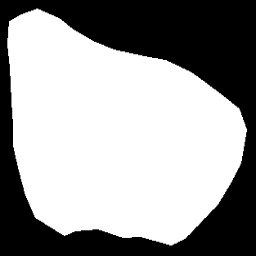

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/126_02_cyt.bmp
Extracted 23 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/112_03_nuc.dat


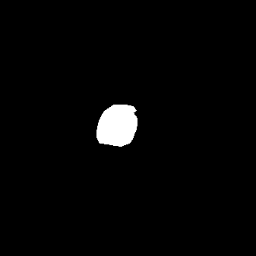

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/112_03_nuc.bmp
Extracted 54 polygon points from Superficial-Intermediate/im_Superficial-Intermediate/CROPPED/112_03_cyt.dat


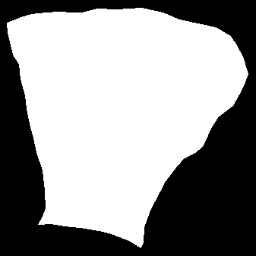

✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/112_03_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/095_12_nuc.dat


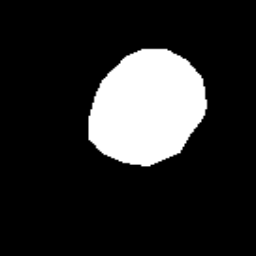

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_12_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/095_12_cyt.dat


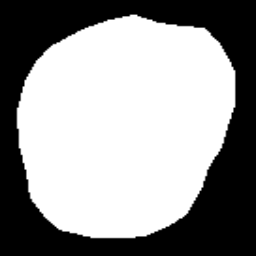

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_12_cyt.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/014_02_nuc.dat


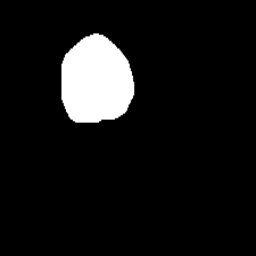

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_02_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/014_02_cyt.dat


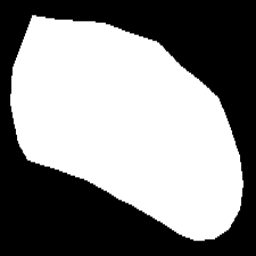

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_02_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/083_03_nuc.dat


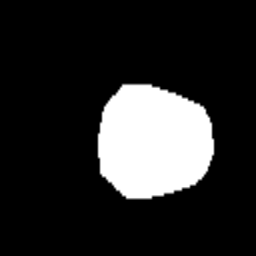

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_03_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/083_03_cyt.dat


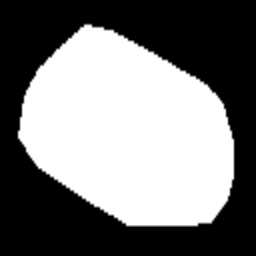

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_03_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/037_07_nuc.dat


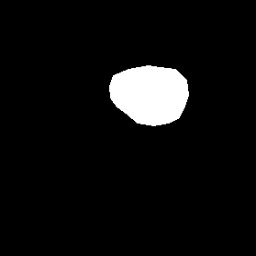

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/037_07_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/037_07_cyt.dat


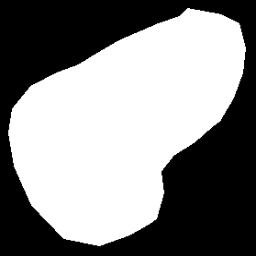

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/037_07_cyt.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/001_01_nuc.dat


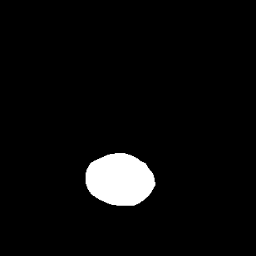

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_01_nuc.bmp
Extracted 55 polygon points from Parabasal/im_Parabasal/CROPPED/001_01_cyt.dat


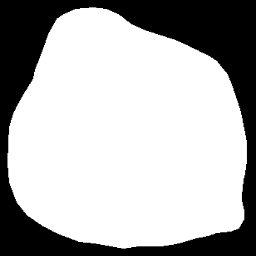

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/092_01_nuc.dat


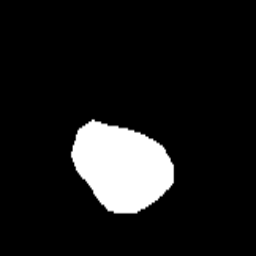

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/092_01_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/092_01_cyt.dat


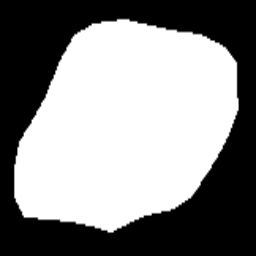

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/092_01_cyt.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/010_05_nuc.dat


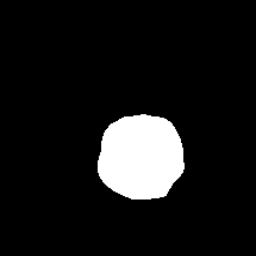

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_05_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/010_05_cyt.dat


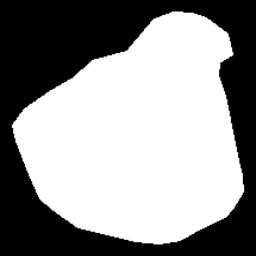

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_05_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/075_05_nuc.dat


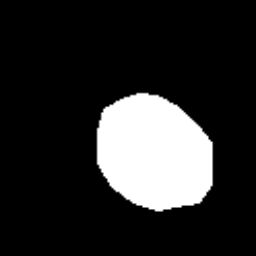

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_05_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/075_05_cyt.dat


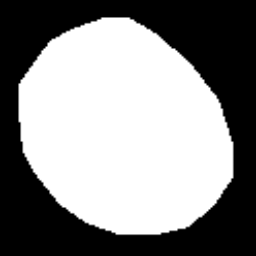

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_05_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/018_02_nuc.dat


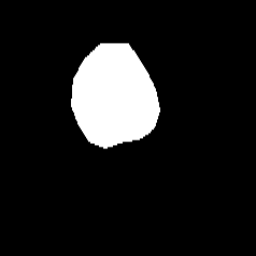

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_02_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/018_02_cyt.dat


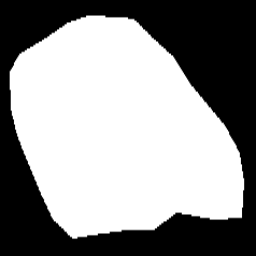

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_02_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/021_03_nuc.dat


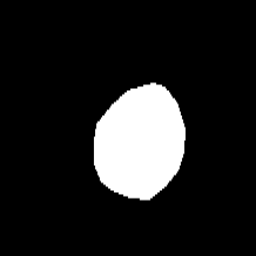

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_03_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/021_03_cyt.dat


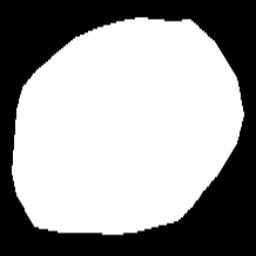

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_03_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/060_03_nuc.dat


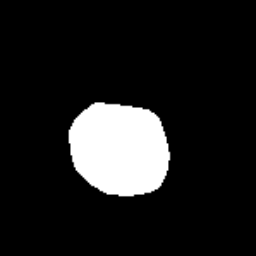

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_03_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/060_03_cyt.dat


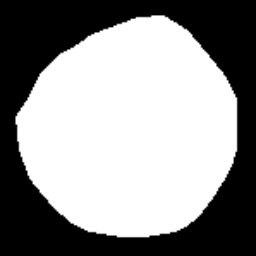

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_03_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/020_04_nuc.dat


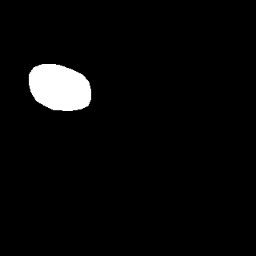

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_04_nuc.bmp
Extracted 45 polygon points from Parabasal/im_Parabasal/CROPPED/020_04_cyt.dat


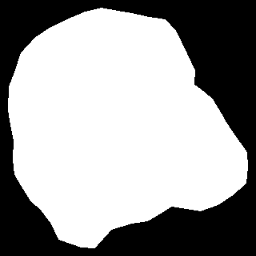

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_04_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/074_04_nuc.dat


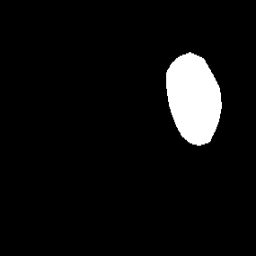

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/074_04_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/074_04_cyt.dat


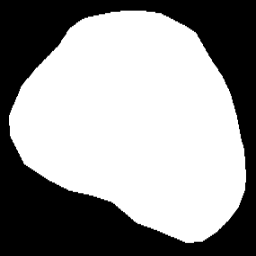

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/074_04_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/021_08_nuc.dat


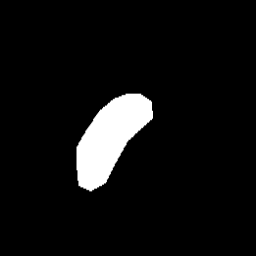

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_08_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/021_08_cyt.dat


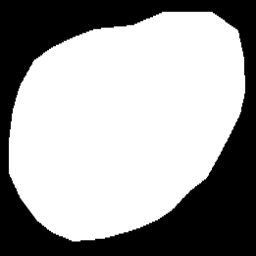

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_08_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/102_01_nuc.dat


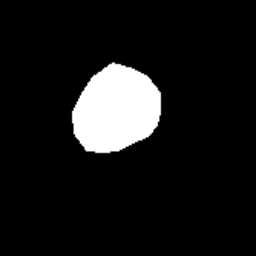

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_01_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/102_01_cyt.dat


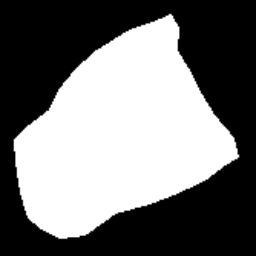

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_01_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/076_04_nuc.dat


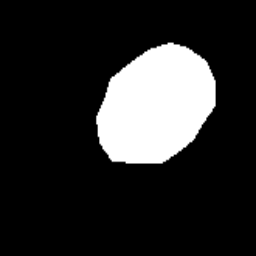

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/076_04_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/076_04_cyt.dat


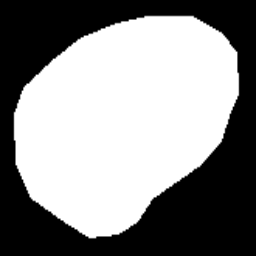

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/076_04_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/074_03_nuc.dat


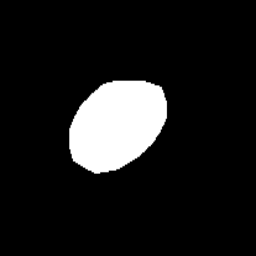

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/074_03_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/074_03_cyt.dat


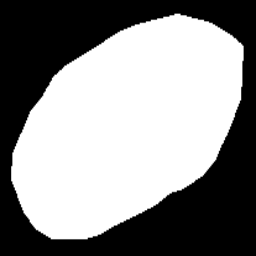

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/074_03_cyt.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/050_06_nuc.dat


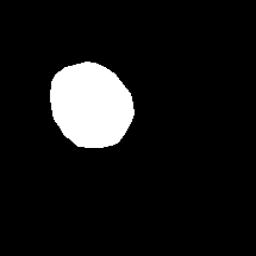

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_06_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/050_06_cyt.dat


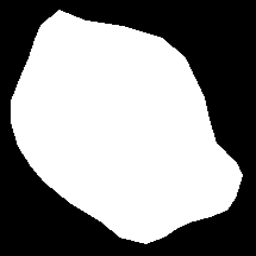

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_06_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/061_02_nuc.dat


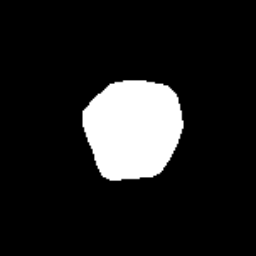

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/061_02_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/061_02_cyt.dat


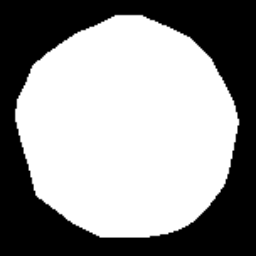

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/061_02_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/037_04_nuc.dat


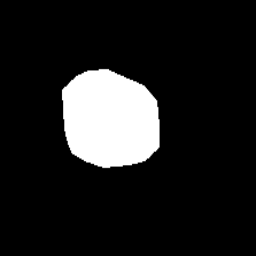

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/037_04_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/037_04_cyt.dat


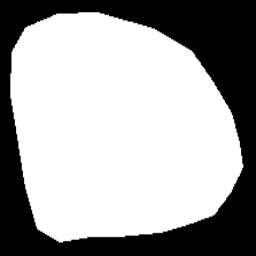

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/037_04_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/099_11_nuc.dat


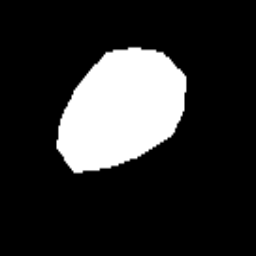

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_11_nuc.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/099_11_cyt.dat


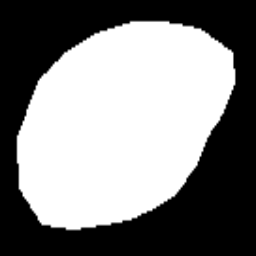

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_11_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/093_09_nuc.dat


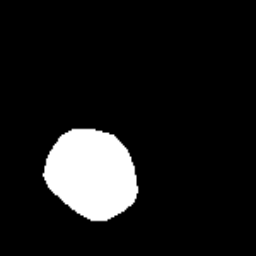

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_09_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/093_09_cyt.dat


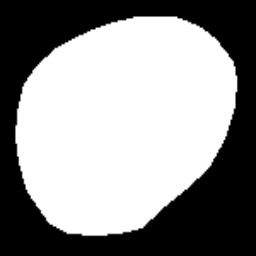

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_09_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/093_26_nuc.dat


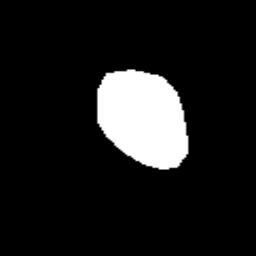

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_26_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/093_26_cyt.dat


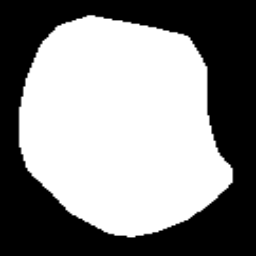

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_26_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/062_09_nuc.dat


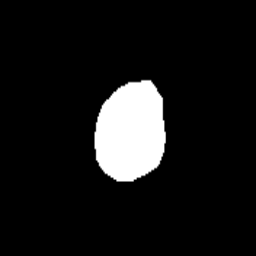

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_09_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/062_09_cyt.dat


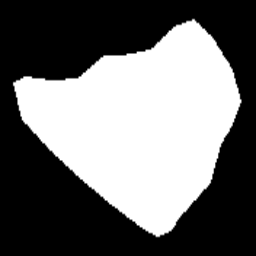

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_09_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/067_05_nuc.dat


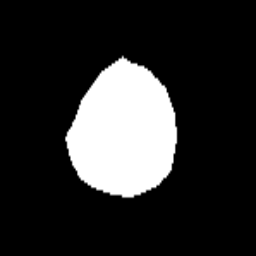

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_05_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/067_05_cyt.dat


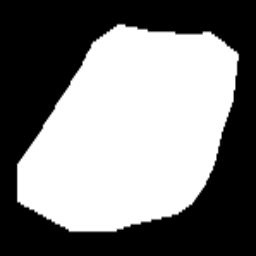

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_05_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/037_02_nuc.dat


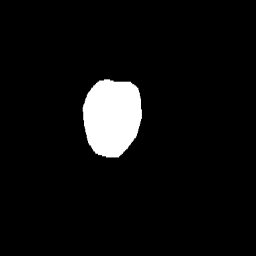

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/037_02_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/037_02_cyt.dat


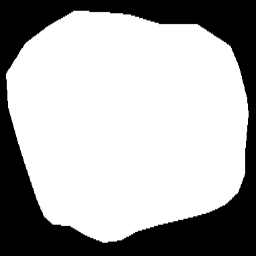

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/037_02_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/094_08_nuc.dat


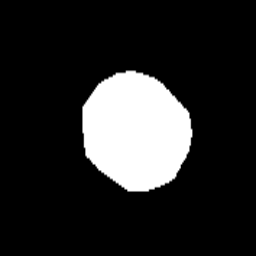

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_08_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/094_08_cyt.dat


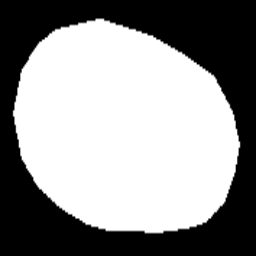

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_08_cyt.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/047_09_nuc.dat


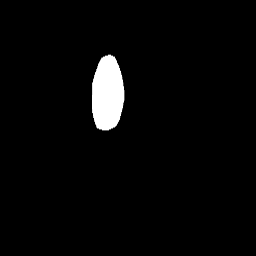

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_09_nuc.bmp
Extracted 48 polygon points from Parabasal/im_Parabasal/CROPPED/047_09_cyt.dat


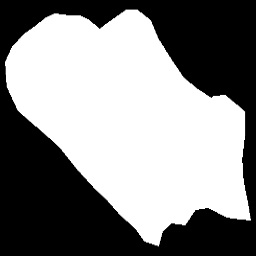

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_09_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/059_02_nuc.dat


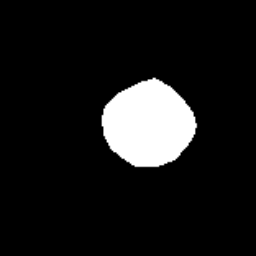

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/059_02_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/059_02_cyt.dat


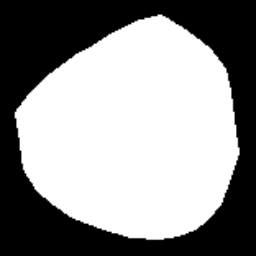

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/059_02_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/102_16_nuc.dat


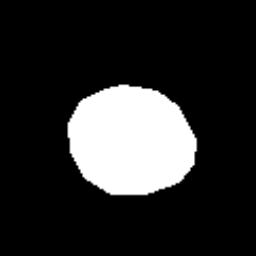

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_16_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/102_16_cyt.dat


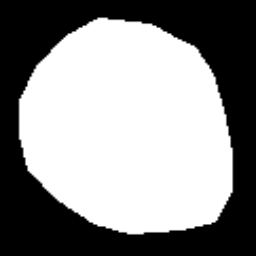

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_16_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/056_02_nuc.dat


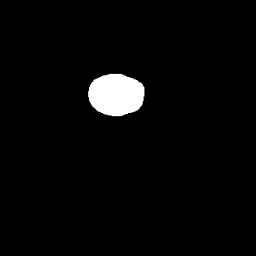

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_02_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/056_02_cyt.dat


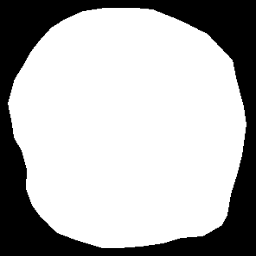

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_02_cyt.bmp
Extracted 11 polygon points from Parabasal/im_Parabasal/CROPPED/058_03_nuc.dat


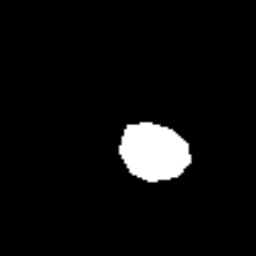

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_03_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/058_03_cyt.dat


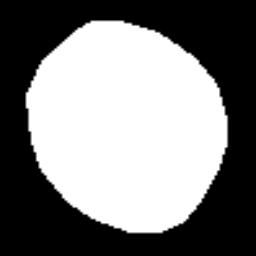

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_03_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/001_07_nuc.dat


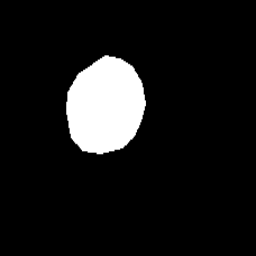

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_07_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/001_07_cyt.dat


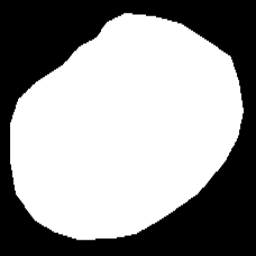

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_07_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/030_01_nuc.dat


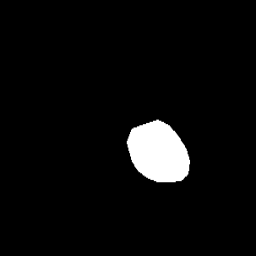

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/030_01_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/030_01_cyt.dat


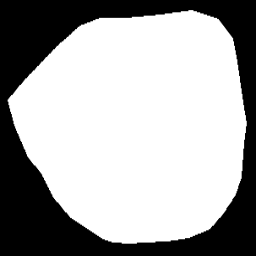

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/030_01_cyt.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/054_04_nuc.dat


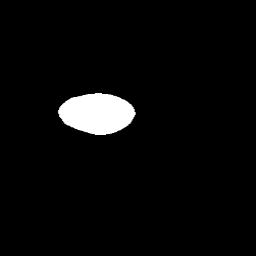

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_04_nuc.bmp
Extracted 50 polygon points from Parabasal/im_Parabasal/CROPPED/054_04_cyt.dat


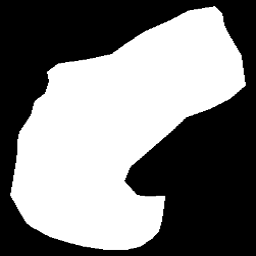

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_04_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/098_06_nuc.dat


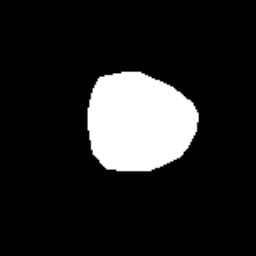

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_06_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/098_06_cyt.dat


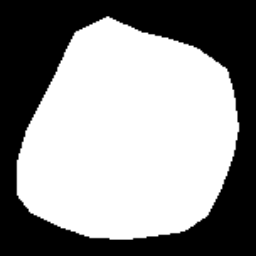

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_06_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/095_16_nuc.dat


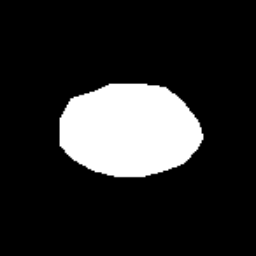

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_16_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/095_16_cyt.dat


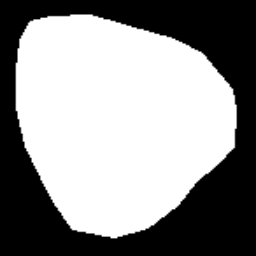

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_16_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/102_04_nuc.dat


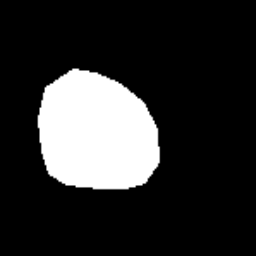

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_04_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/102_04_cyt.dat


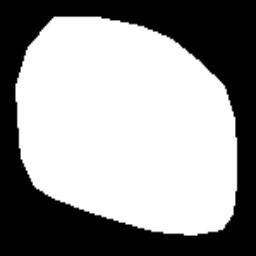

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_04_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/071_03_nuc.dat


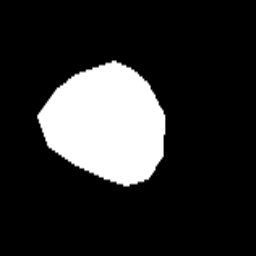

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_03_nuc.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/071_03_cyt.dat


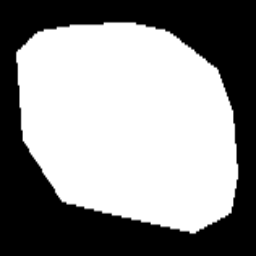

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_03_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/009_04_nuc.dat


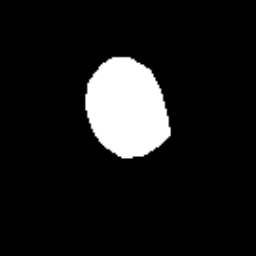

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_04_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/009_04_cyt.dat


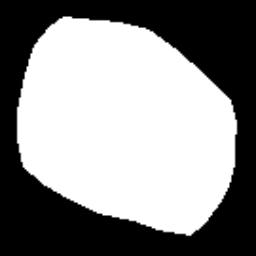

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_04_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/066_02_nuc.dat


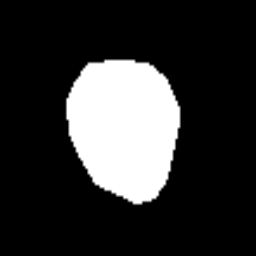

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_02_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/066_02_cyt.dat


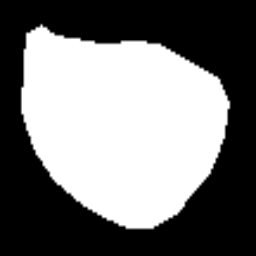

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_02_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/028_04_nuc.dat


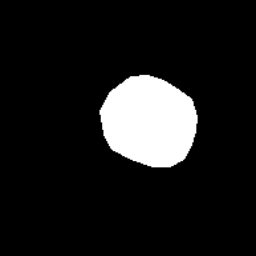

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_04_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/028_04_cyt.dat


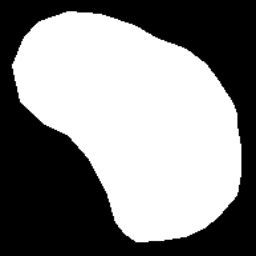

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_04_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/099_15_nuc.dat


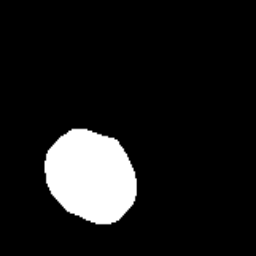

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_15_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/099_15_cyt.dat


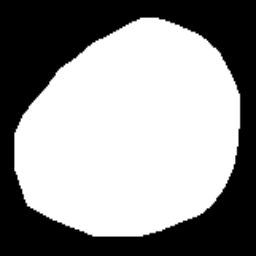

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_15_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/100_02_nuc.dat


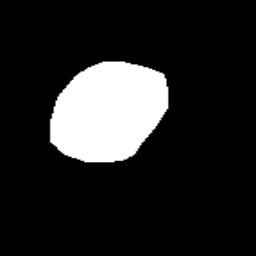

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_02_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/100_02_cyt.dat


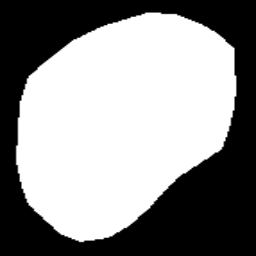

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_02_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/026_02_nuc.dat


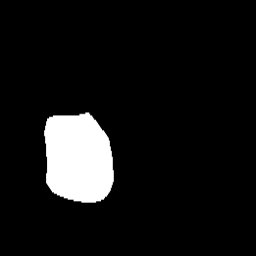

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/026_02_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/026_02_cyt.dat


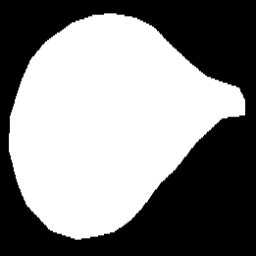

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/026_02_cyt.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/052_09_nuc.dat


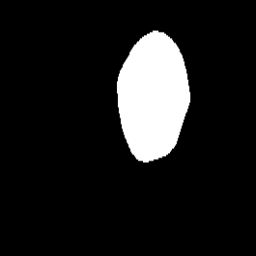

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_09_nuc.bmp
Extracted 43 polygon points from Parabasal/im_Parabasal/CROPPED/052_09_cyt.dat


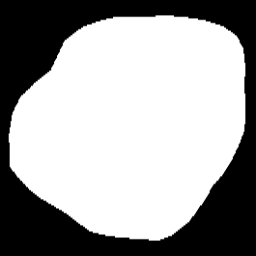

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_09_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/093_12_nuc.dat


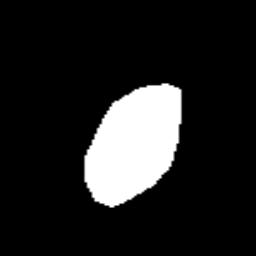

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_12_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/093_12_cyt.dat


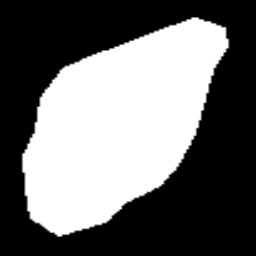

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_12_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/044_03_nuc.dat


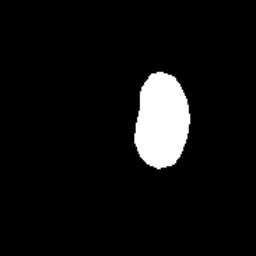

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_03_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/044_03_cyt.dat


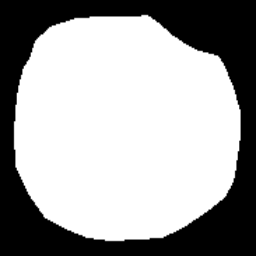

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_03_cyt.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/049_07_nuc.dat


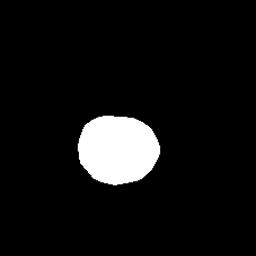

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_07_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/049_07_cyt.dat


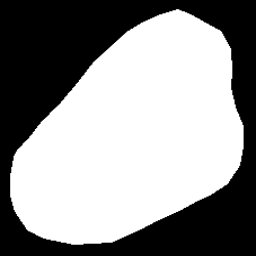

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_07_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/075_02_nuc.dat


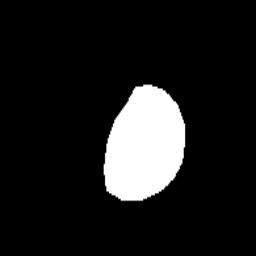

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_02_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/075_02_cyt.dat


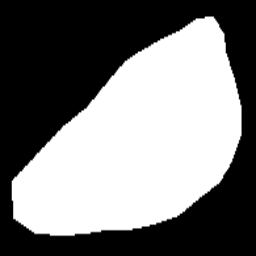

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_02_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/095_13_nuc.dat


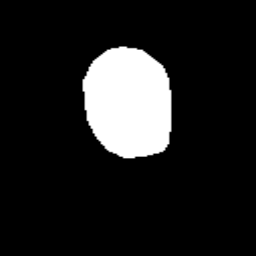

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_13_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/095_13_cyt.dat


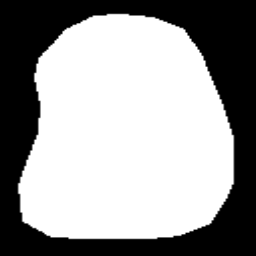

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_13_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/041_01_nuc.dat


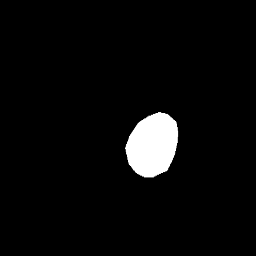

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/041_01_nuc.bmp
Extracted 42 polygon points from Parabasal/im_Parabasal/CROPPED/041_01_cyt.dat


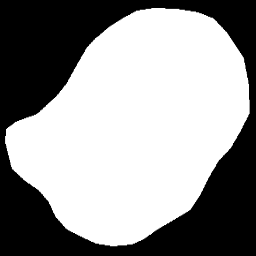

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/041_01_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/057_10_nuc.dat


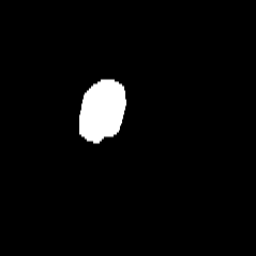

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_10_nuc.bmp
Extracted 40 polygon points from Parabasal/im_Parabasal/CROPPED/057_10_cyt.dat


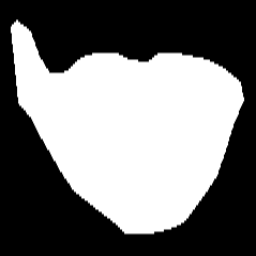

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_10_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/002_02_nuc.dat


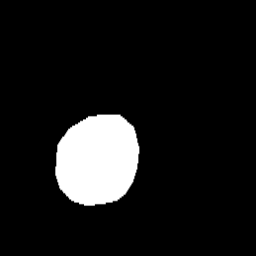

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/002_02_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/002_02_cyt.dat


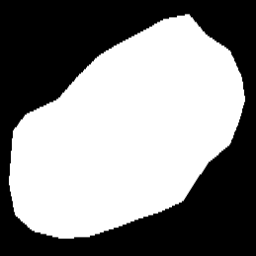

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/002_02_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/004_09_nuc.dat


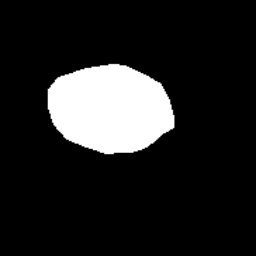

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_09_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/004_09_cyt.dat


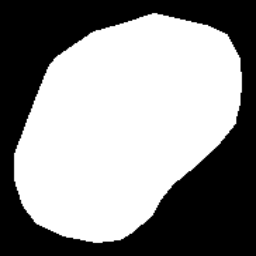

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_09_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/097_03_nuc.dat


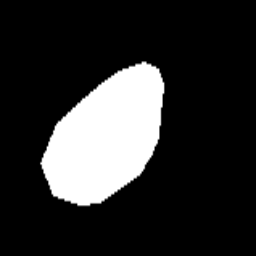

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_03_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/097_03_cyt.dat


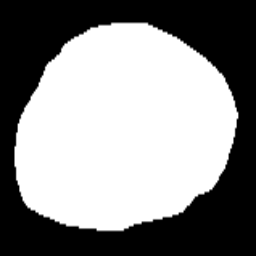

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_03_cyt.bmp
Extracted 13 polygon points from Parabasal/im_Parabasal/CROPPED/100_07_nuc.dat


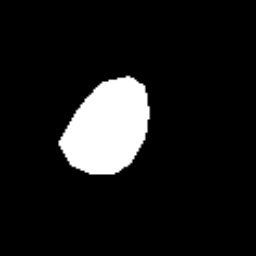

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_07_nuc.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/100_07_cyt.dat


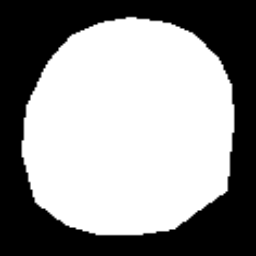

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_07_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/086_01_nuc.dat


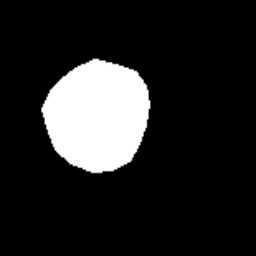

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_01_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/086_01_cyt.dat


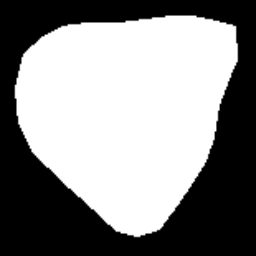

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_01_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/034_07_nuc.dat


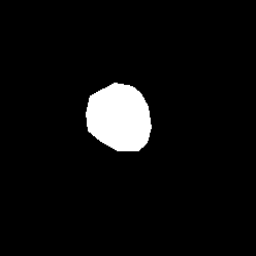

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_07_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/034_07_cyt.dat


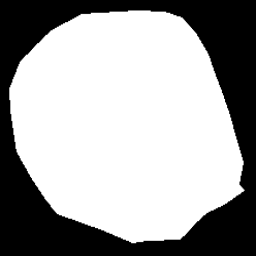

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_07_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/032_04_nuc.dat


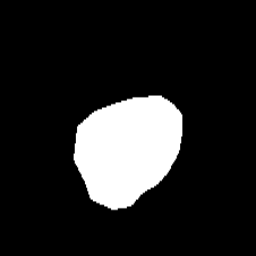

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_04_nuc.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/032_04_cyt.dat


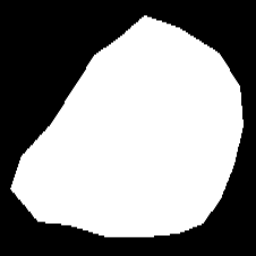

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_04_cyt.bmp
Extracted 13 polygon points from Parabasal/im_Parabasal/CROPPED/071_02_nuc.dat


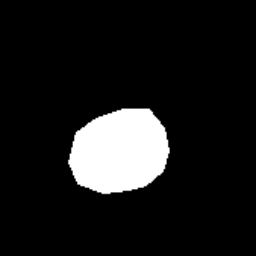

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_02_nuc.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/071_02_cyt.dat


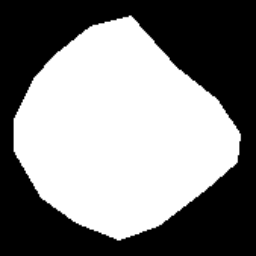

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_02_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/107_01_nuc.dat


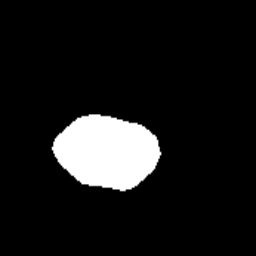

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_01_nuc.bmp
Extracted 47 polygon points from Parabasal/im_Parabasal/CROPPED/107_01_cyt.dat


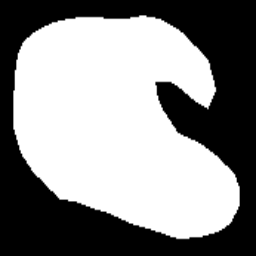

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_01_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/001_06_nuc.dat


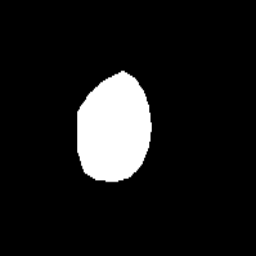

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_06_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/001_06_cyt.dat


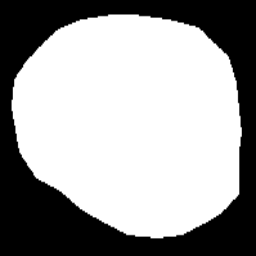

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_06_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/085_02_nuc.dat


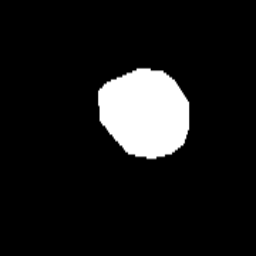

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/085_02_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/085_02_cyt.dat


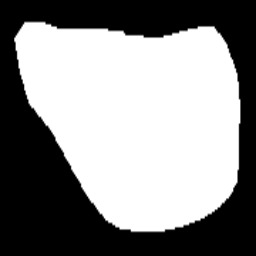

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/085_02_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/097_14_nuc.dat


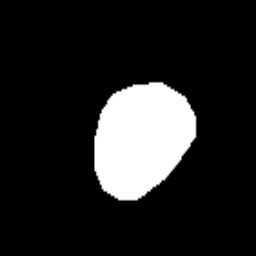

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_14_nuc.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/097_14_cyt.dat


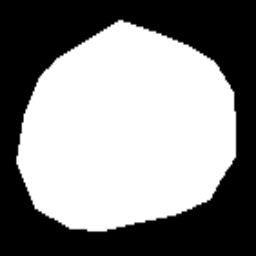

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_14_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/042_04_nuc.dat


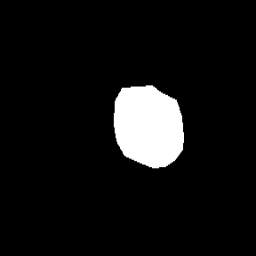

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_04_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/042_04_cyt.dat


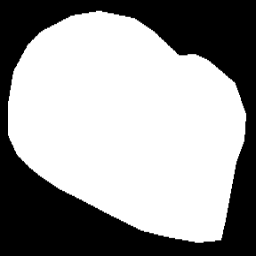

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_04_cyt.bmp
Extracted 13 polygon points from Parabasal/im_Parabasal/CROPPED/081_01_nuc.dat


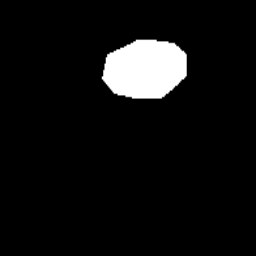

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_01_nuc.bmp
Extracted 41 polygon points from Parabasal/im_Parabasal/CROPPED/081_01_cyt.dat


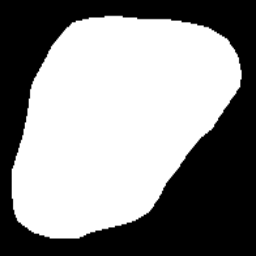

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/003_12_nuc.dat


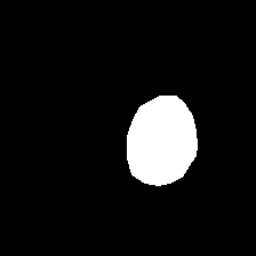

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_12_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/003_12_cyt.dat


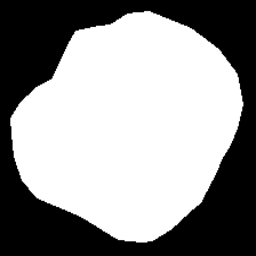

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_12_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/100_06_nuc.dat


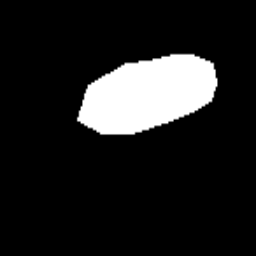

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_06_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/100_06_cyt.dat


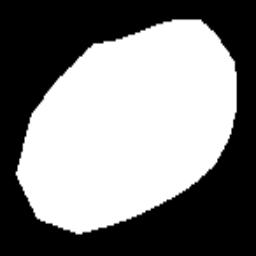

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_06_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/101_01_nuc.dat


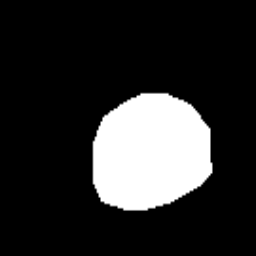

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/101_01_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/101_01_cyt.dat


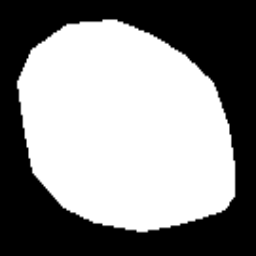

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/101_01_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/061_01_nuc.dat


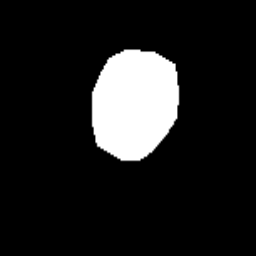

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/061_01_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/061_01_cyt.dat


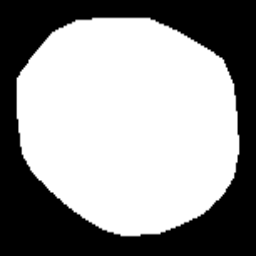

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/061_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/098_01_nuc.dat


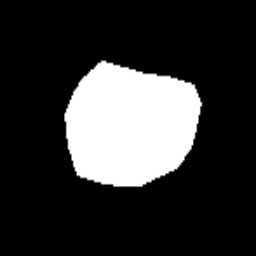

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_01_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/098_01_cyt.dat


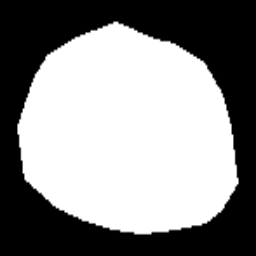

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_01_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/042_01_nuc.dat


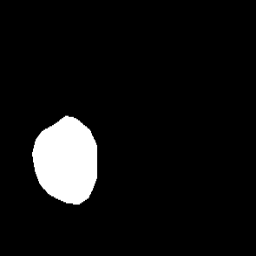

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_01_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/042_01_cyt.dat


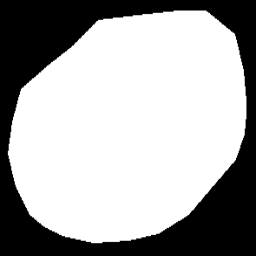

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_01_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/067_07_nuc.dat


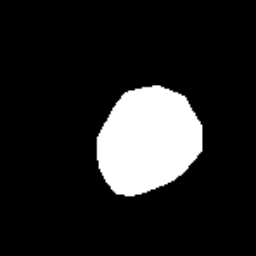

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_07_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/067_07_cyt.dat


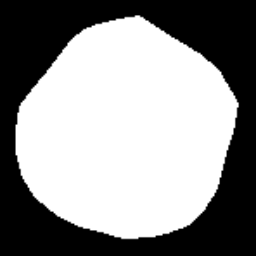

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_07_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/082_02_nuc.dat


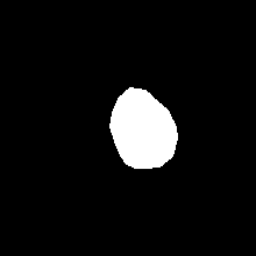

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/082_02_nuc.bmp
Extracted 45 polygon points from Parabasal/im_Parabasal/CROPPED/082_02_cyt.dat


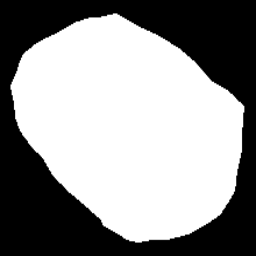

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/082_02_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/096_03_nuc.dat


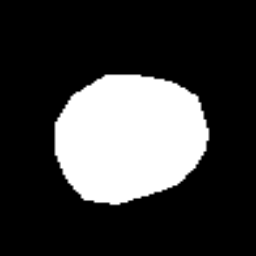

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_03_nuc.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/096_03_cyt.dat


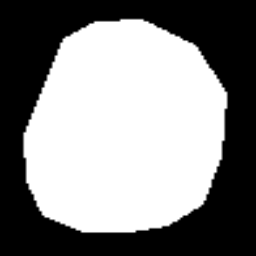

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_03_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/018_06_nuc.dat


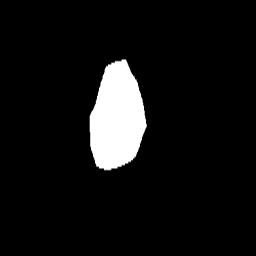

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_06_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/018_06_cyt.dat


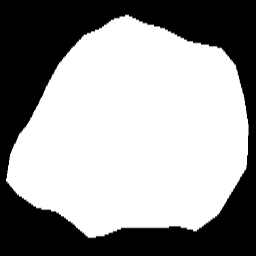

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_06_cyt.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/052_07_nuc.dat


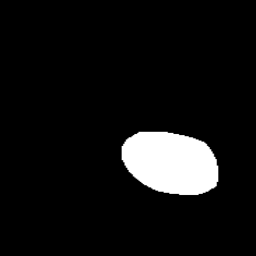

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_07_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/052_07_cyt.dat


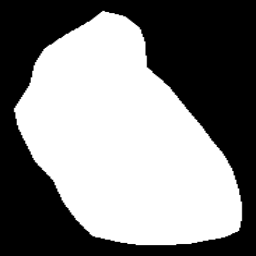

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_07_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/006_06_nuc.dat


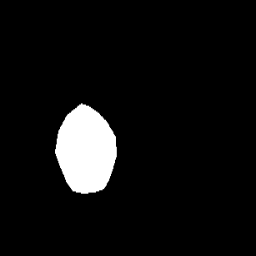

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_06_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/006_06_cyt.dat


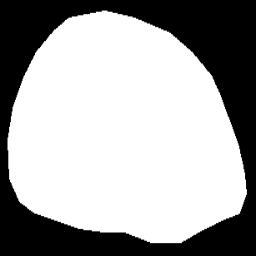

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_06_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/042_07_nuc.dat


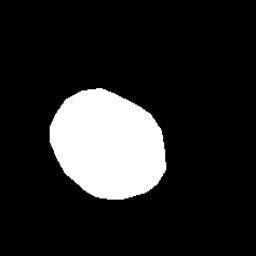

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_07_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/042_07_cyt.dat


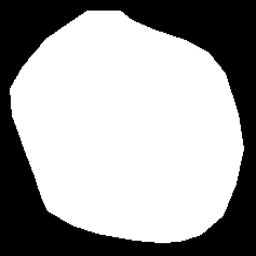

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_07_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/096_02_nuc.dat


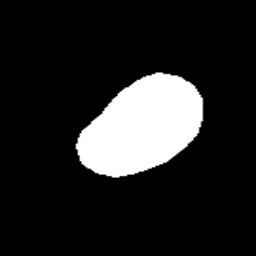

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_02_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/096_02_cyt.dat


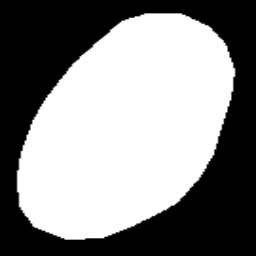

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_02_cyt.bmp
Extracted 13 polygon points from Parabasal/im_Parabasal/CROPPED/085_01_nuc.dat


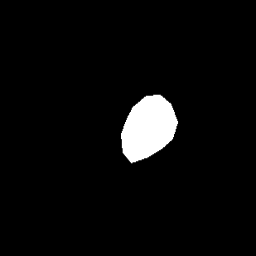

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/085_01_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/085_01_cyt.dat


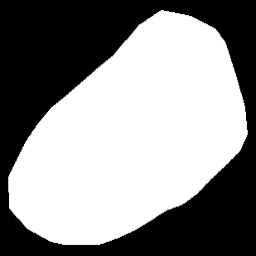

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/085_01_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/089_07_nuc.dat


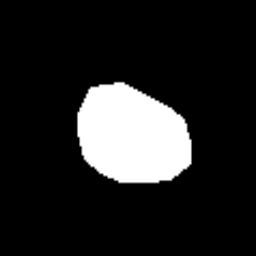

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_07_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/089_07_cyt.dat


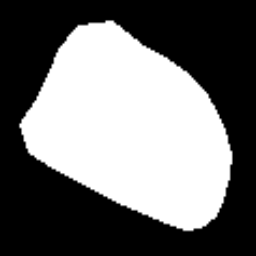

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_07_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/042_12_nuc.dat


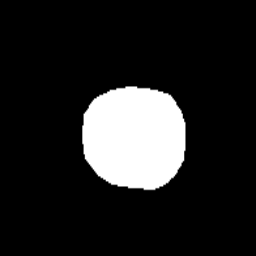

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_12_nuc.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/042_12_cyt.dat


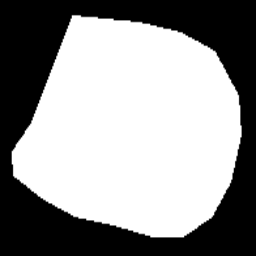

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_12_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/005_05_nuc.dat


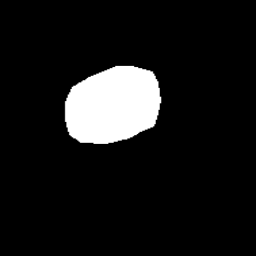

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_05_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/005_05_cyt.dat


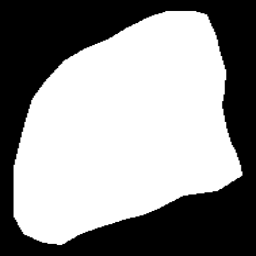

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_05_cyt.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/069_06_nuc.dat


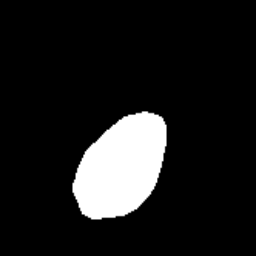

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_06_nuc.bmp
Extracted 54 polygon points from Parabasal/im_Parabasal/CROPPED/069_06_cyt.dat


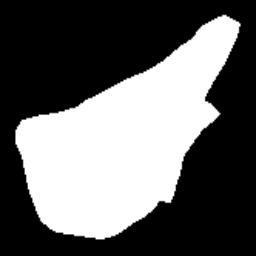

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_06_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/005_02_nuc.dat


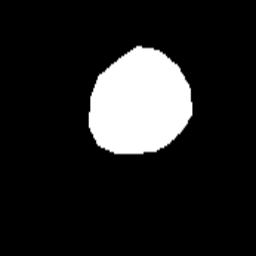

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_02_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/005_02_cyt.dat


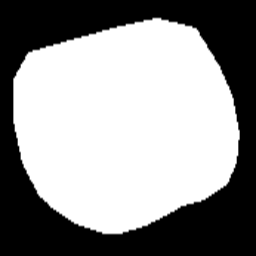

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_02_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/069_05_nuc.dat


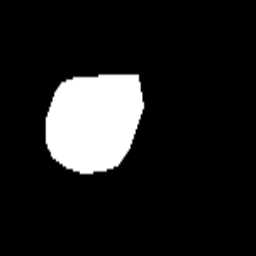

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_05_nuc.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/069_05_cyt.dat


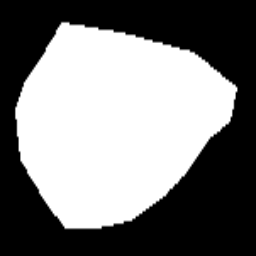

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_05_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/019_06_nuc.dat


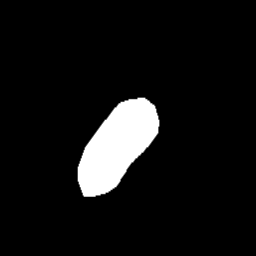

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_06_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/019_06_cyt.dat


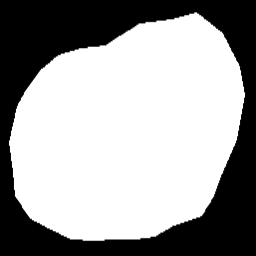

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_06_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/093_16_nuc.dat


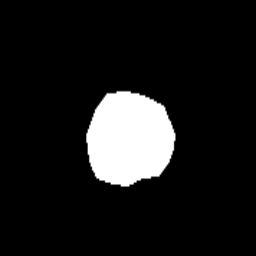

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_16_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/093_16_cyt.dat


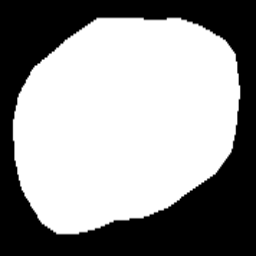

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_16_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/104_02_nuc.dat


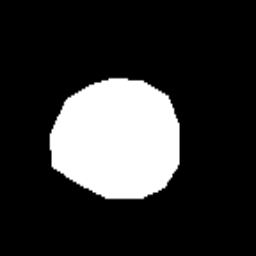

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/104_02_nuc.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/104_02_cyt.dat


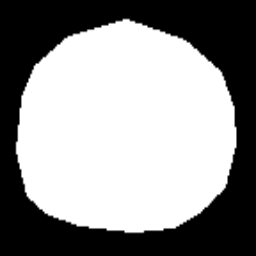

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/104_02_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/093_24_nuc.dat


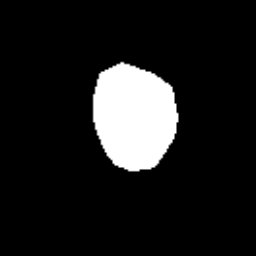

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_24_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/093_24_cyt.dat


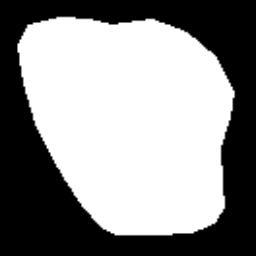

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_24_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/087_01_nuc.dat


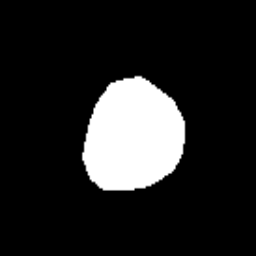

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/087_01_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/087_01_cyt.dat


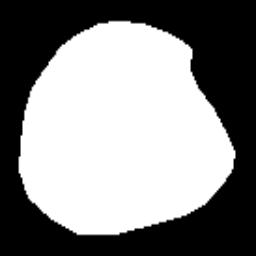

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/087_01_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/088_01_nuc.dat


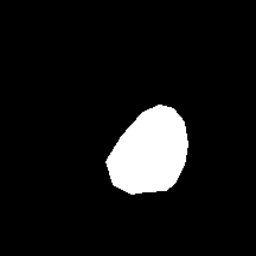

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/088_01_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/088_01_cyt.dat


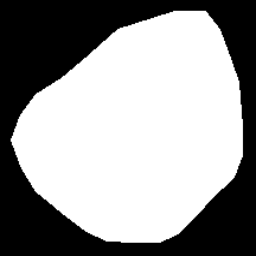

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/088_01_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/106_02_nuc.dat


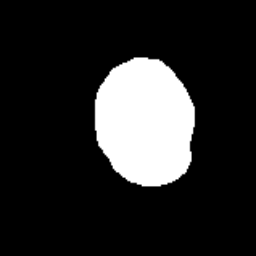

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_02_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/106_02_cyt.dat


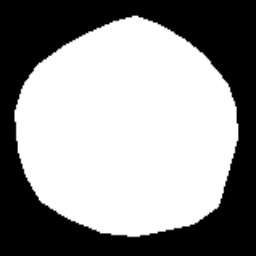

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_02_cyt.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/064_04_nuc.dat


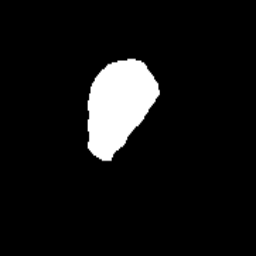

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_04_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/064_04_cyt.dat


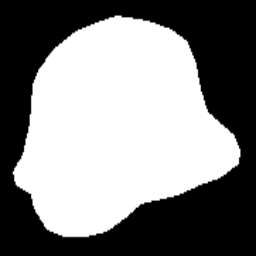

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_04_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/062_12_nuc.dat


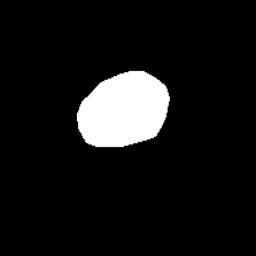

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_12_nuc.bmp
Extracted 42 polygon points from Parabasal/im_Parabasal/CROPPED/062_12_cyt.dat


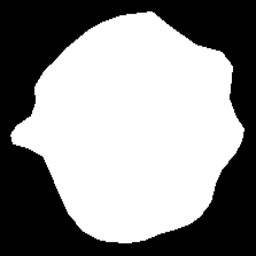

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_12_cyt.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/054_05_nuc.dat


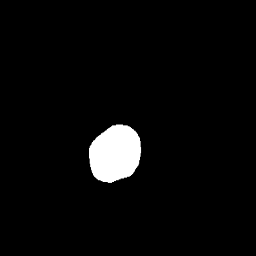

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_05_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/054_05_cyt.dat


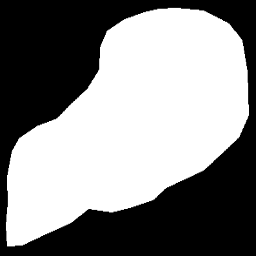

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_05_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/078_06_nuc.dat


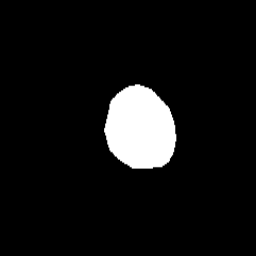

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_06_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/078_06_cyt.dat


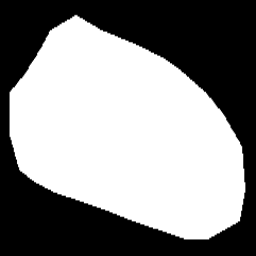

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_06_cyt.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/006_04_nuc.dat


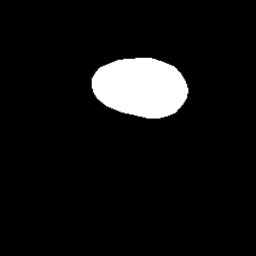

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_04_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/006_04_cyt.dat


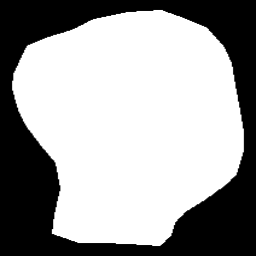

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_04_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/069_02_nuc.dat


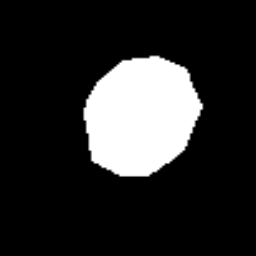

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_02_nuc.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/069_02_cyt.dat


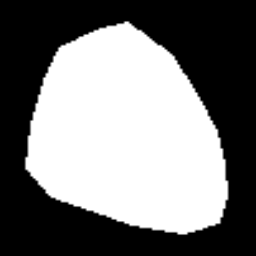

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_02_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/093_06_nuc.dat


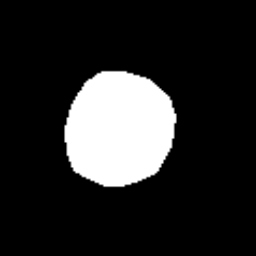

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_06_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/093_06_cyt.dat


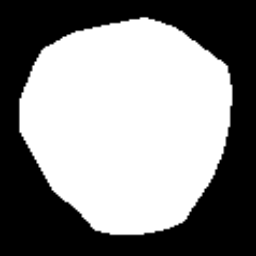

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_06_cyt.bmp
Extracted 13 polygon points from Parabasal/im_Parabasal/CROPPED/069_09_nuc.dat


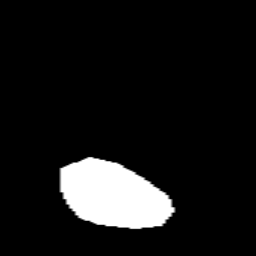

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_09_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/069_09_cyt.dat


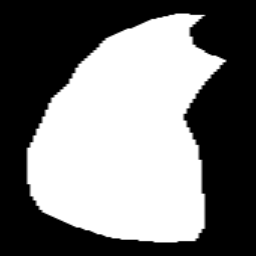

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_09_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/024_01_nuc.dat


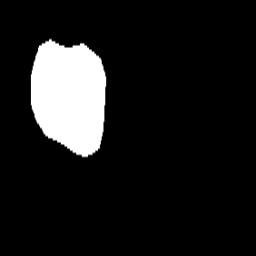

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/024_01_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/024_01_cyt.dat


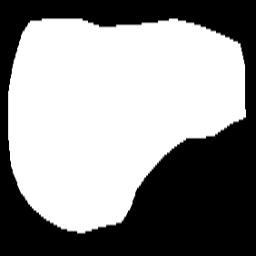

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/024_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/081_07_nuc.dat


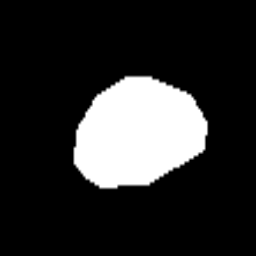

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_07_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/081_07_cyt.dat


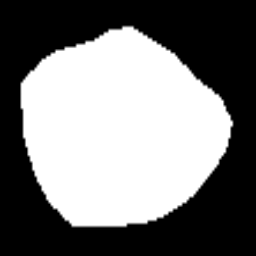

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_07_cyt.bmp
Extracted 39 polygon points from Parabasal/im_Parabasal/CROPPED/049_03_nuc.dat


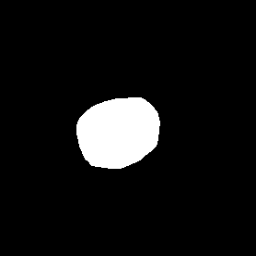

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_03_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/049_03_cyt.dat


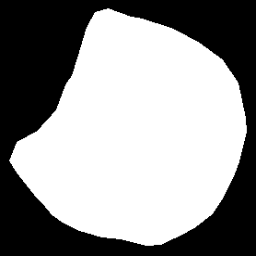

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_03_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/076_02_nuc.dat


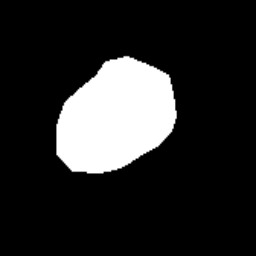

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/076_02_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/076_02_cyt.dat


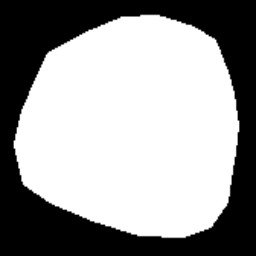

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/076_02_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/060_07_nuc.dat


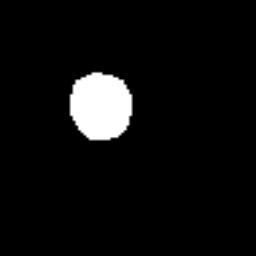

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_07_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/060_07_cyt.dat


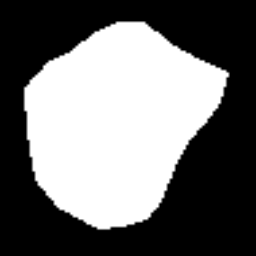

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_07_cyt.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/042_13_nuc.dat


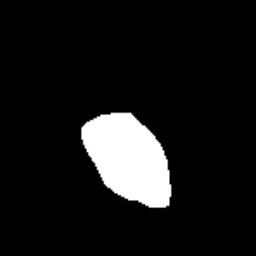

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_13_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/042_13_cyt.dat


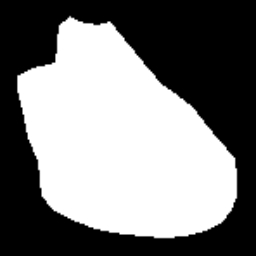

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_13_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/096_07_nuc.dat


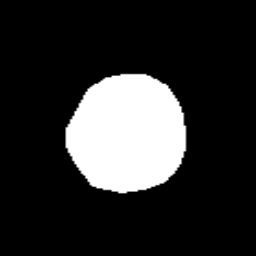

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_07_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/096_07_cyt.dat


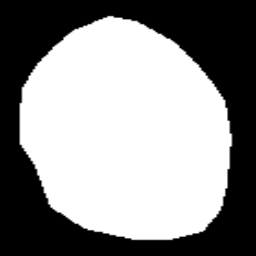

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_07_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/034_02_nuc.dat


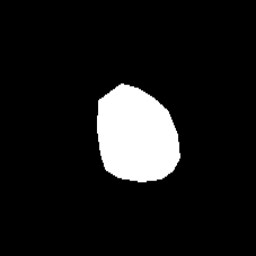

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_02_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/034_02_cyt.dat


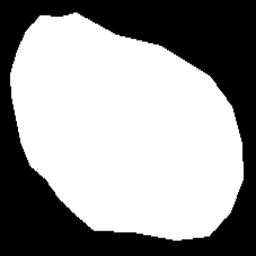

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_02_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/040_01_nuc.dat


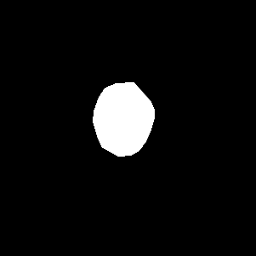

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/040_01_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/040_01_cyt.dat


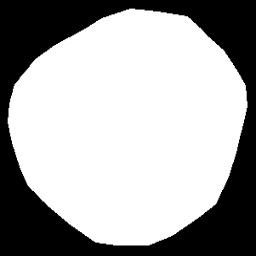

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/040_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/025_02_nuc.dat


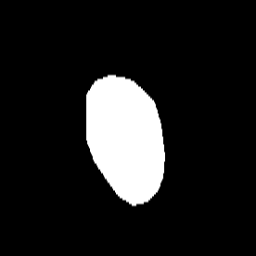

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_02_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/025_02_cyt.dat


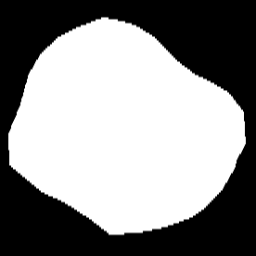

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_02_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/046_02_nuc.dat


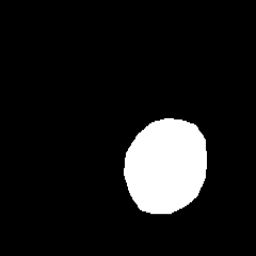

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_02_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/046_02_cyt.dat


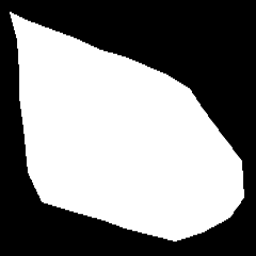

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_02_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/044_02_nuc.dat


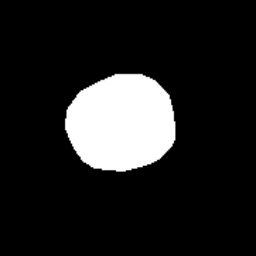

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_02_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/044_02_cyt.dat


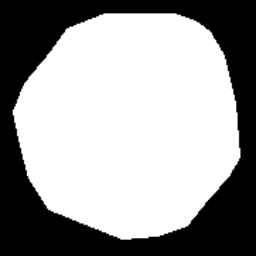

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_02_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/036_02_nuc.dat


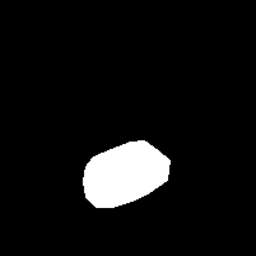

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/036_02_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/036_02_cyt.dat


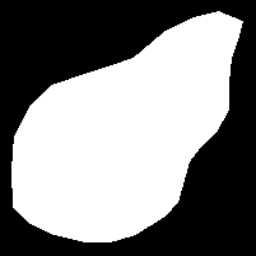

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/036_02_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/101_03_nuc.dat


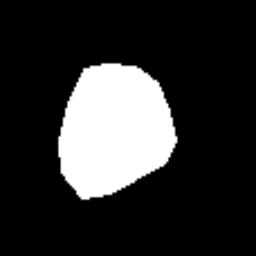

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/101_03_nuc.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/101_03_cyt.dat


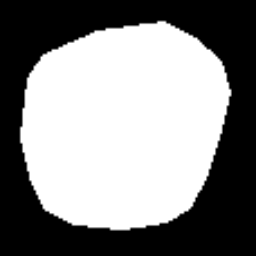

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/101_03_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/077_02_nuc.dat


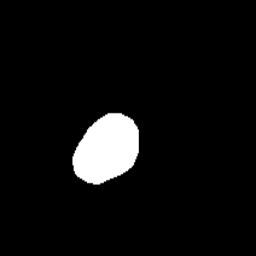

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/077_02_nuc.bmp
Extracted 39 polygon points from Parabasal/im_Parabasal/CROPPED/077_02_cyt.dat


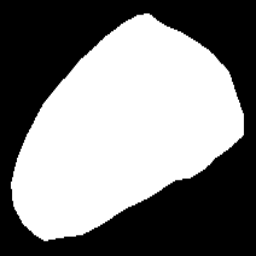

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/077_02_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/067_01_nuc.dat


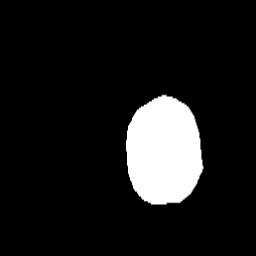

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_01_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/067_01_cyt.dat


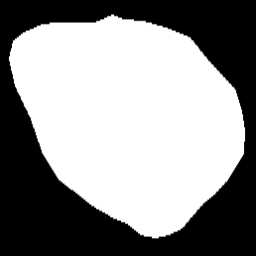

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_01_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/049_04_nuc.dat


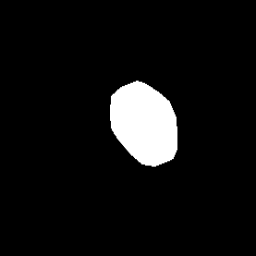

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_04_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/049_04_cyt.dat


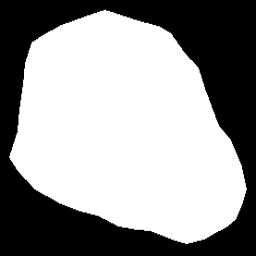

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_04_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/021_01_nuc.dat


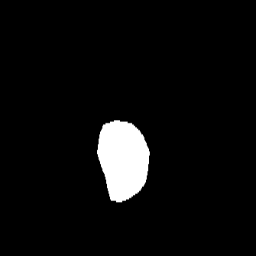

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_01_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/021_01_cyt.dat


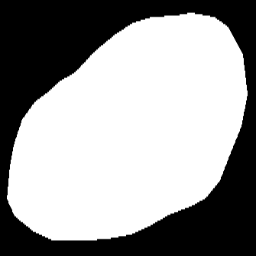

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/022_04_nuc.dat


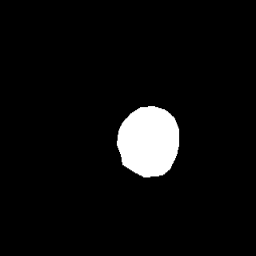

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/022_04_nuc.bmp
Extracted 40 polygon points from Parabasal/im_Parabasal/CROPPED/022_04_cyt.dat


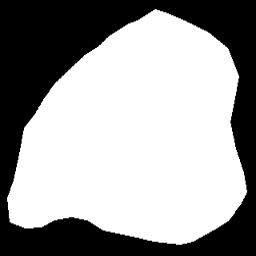

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/022_04_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/041_05_nuc.dat


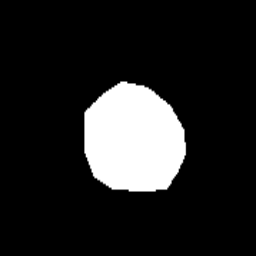

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/041_05_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/041_05_cyt.dat


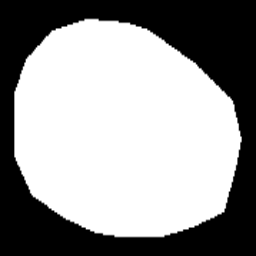

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/041_05_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/021_07_nuc.dat


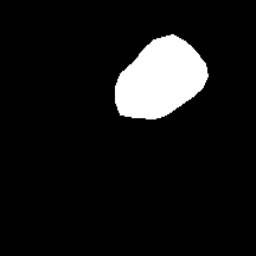

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_07_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/021_07_cyt.dat


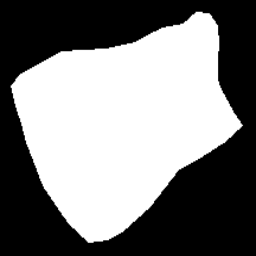

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_07_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/016_08_nuc.dat


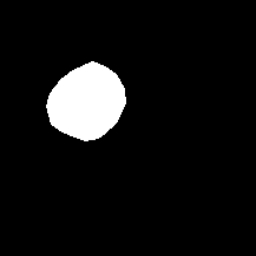

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/016_08_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/016_08_cyt.dat


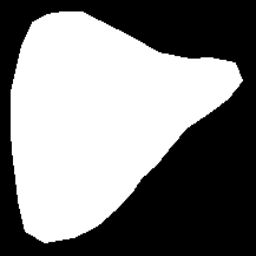

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/016_08_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/078_08_nuc.dat


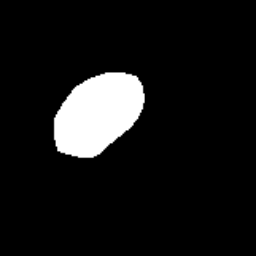

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_08_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/078_08_cyt.dat


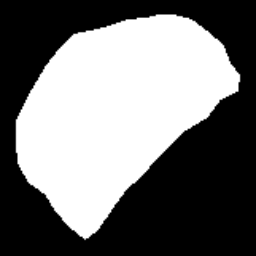

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_08_cyt.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/048_09_nuc.dat


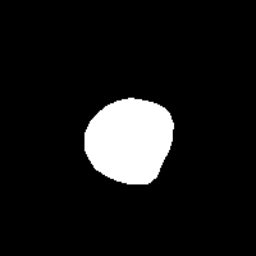

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_09_nuc.bmp
Extracted 43 polygon points from Parabasal/im_Parabasal/CROPPED/048_09_cyt.dat


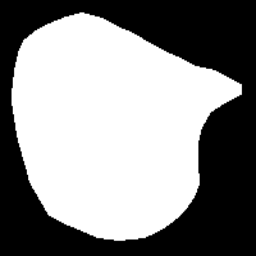

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_09_cyt.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/054_03_nuc.dat


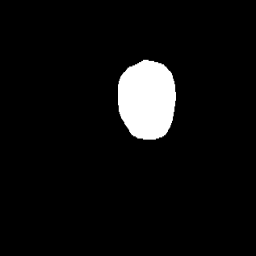

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_03_nuc.bmp
Extracted 41 polygon points from Parabasal/im_Parabasal/CROPPED/054_03_cyt.dat


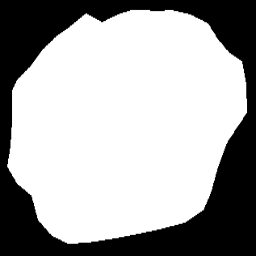

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_03_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/069_03_nuc.dat


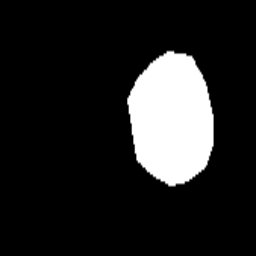

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_03_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/069_03_cyt.dat


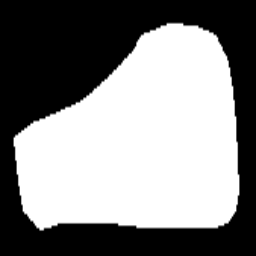

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_03_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/027_01_nuc.dat


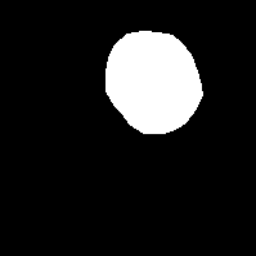

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_01_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/027_01_cyt.dat


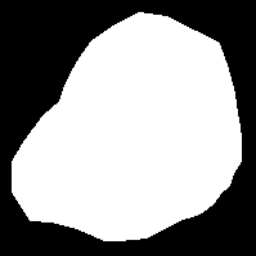

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_01_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/086_11_nuc.dat


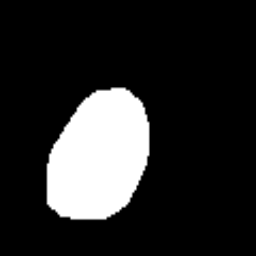

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_11_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/086_11_cyt.dat


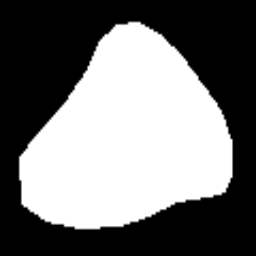

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_11_cyt.bmp
Extracted 13 polygon points from Parabasal/im_Parabasal/CROPPED/013_03_nuc.dat


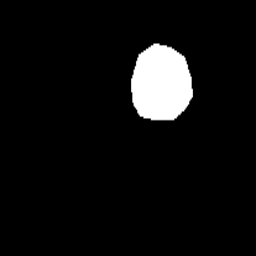

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/013_03_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/013_03_cyt.dat


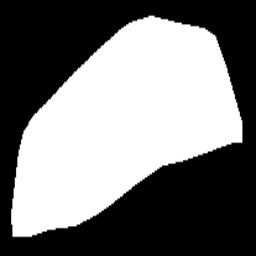

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/013_03_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/055_03_nuc.dat


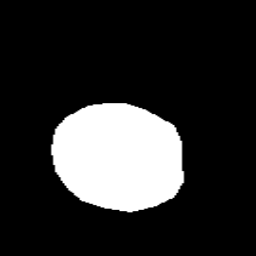

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/055_03_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/055_03_cyt.dat


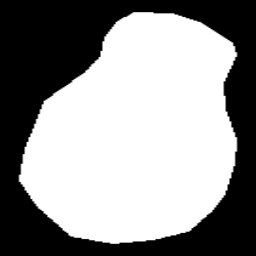

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/055_03_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/065_06_nuc.dat


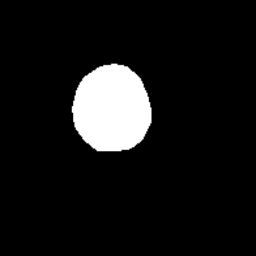

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/065_06_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/065_06_cyt.dat


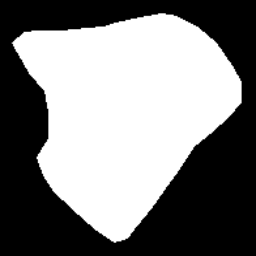

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/065_06_cyt.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/045_05_nuc.dat


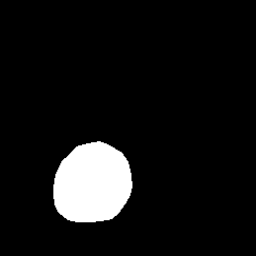

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_05_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/045_05_cyt.dat


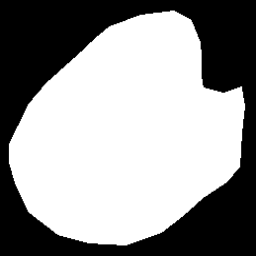

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_05_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/066_04_nuc.dat


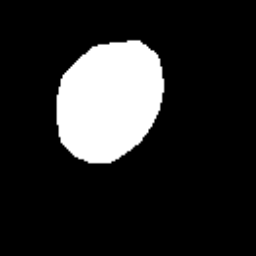

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_04_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/066_04_cyt.dat


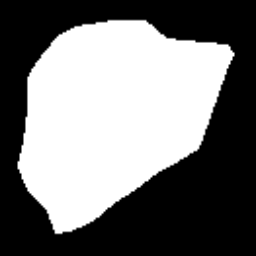

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_04_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/019_05_nuc.dat


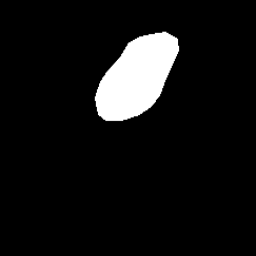

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_05_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/019_05_cyt.dat


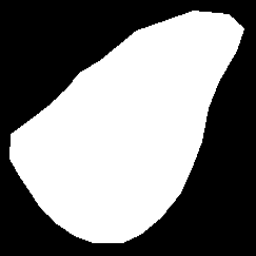

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_05_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/095_07_nuc.dat


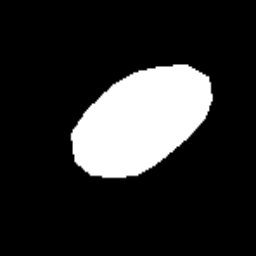

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_07_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/095_07_cyt.dat


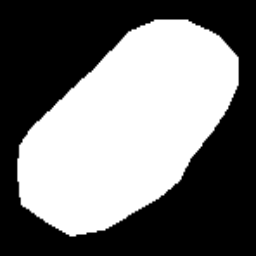

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_07_cyt.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/046_03_nuc.dat


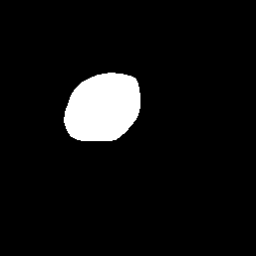

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_03_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/046_03_cyt.dat


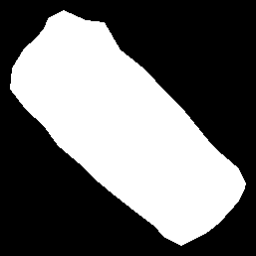

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_03_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/099_04_nuc.dat


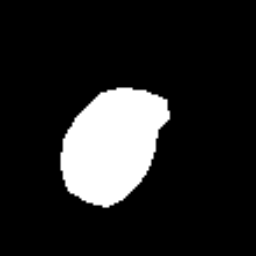

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_04_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/099_04_cyt.dat


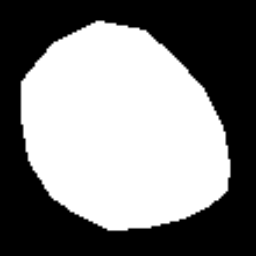

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_04_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/010_06_nuc.dat


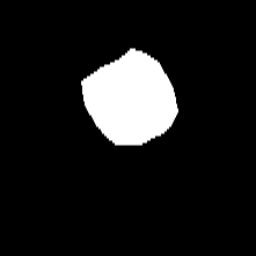

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_06_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/010_06_cyt.dat


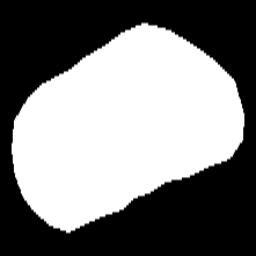

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_06_cyt.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/047_03_nuc.dat


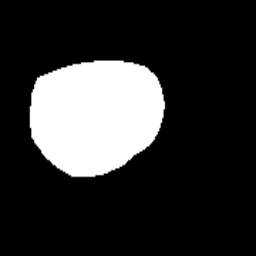

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_03_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/047_03_cyt.dat


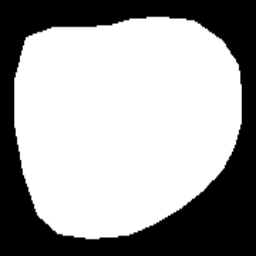

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_03_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/008_11_nuc.dat


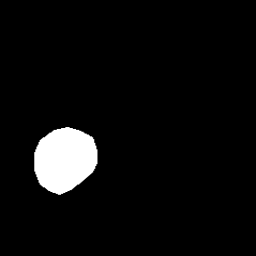

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_11_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/008_11_cyt.dat


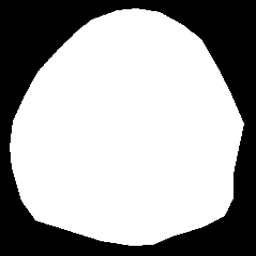

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_11_cyt.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/053_01_nuc.dat


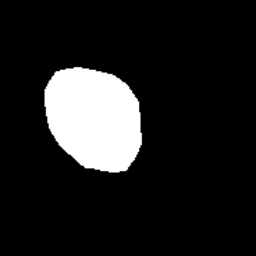

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_01_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/053_01_cyt.dat


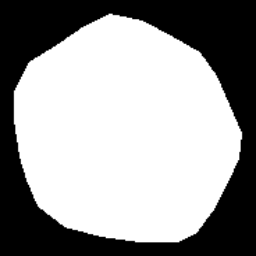

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_01_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/078_04_nuc.dat


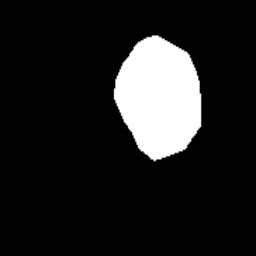

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_04_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/078_04_cyt.dat


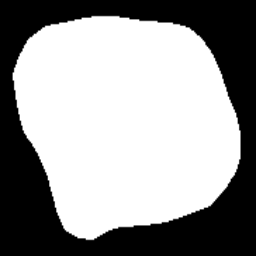

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_04_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/006_07_nuc.dat


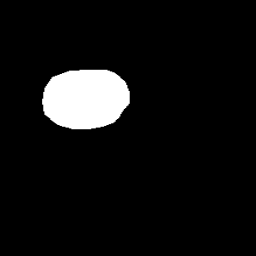

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_07_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/006_07_cyt.dat


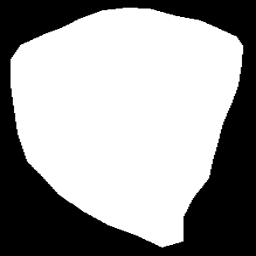

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_07_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/062_01_nuc.dat


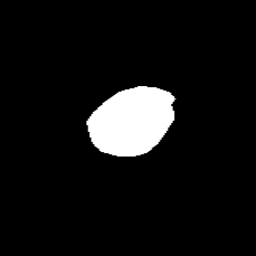

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_01_nuc.bmp
Extracted 43 polygon points from Parabasal/im_Parabasal/CROPPED/062_01_cyt.dat


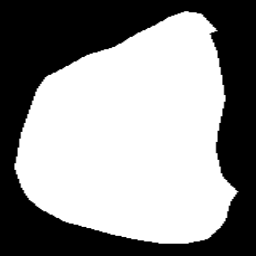

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/026_06_nuc.dat


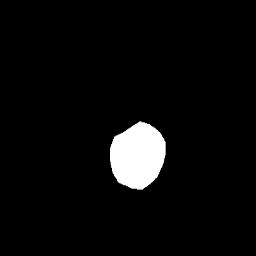

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/026_06_nuc.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/026_06_cyt.dat


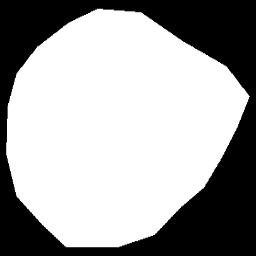

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/026_06_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/074_05_nuc.dat


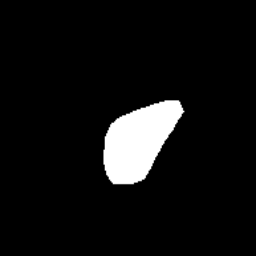

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/074_05_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/074_05_cyt.dat


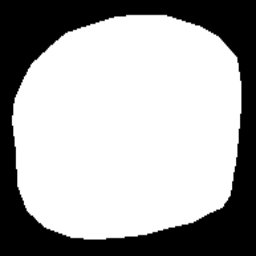

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/074_05_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/025_04_nuc.dat


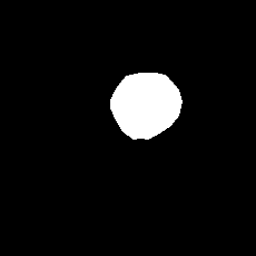

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_04_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/025_04_cyt.dat


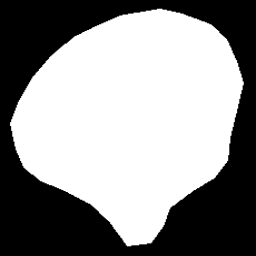

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_04_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/017_02_nuc.dat


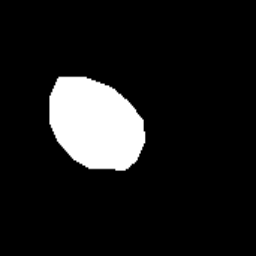

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_02_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/017_02_cyt.dat


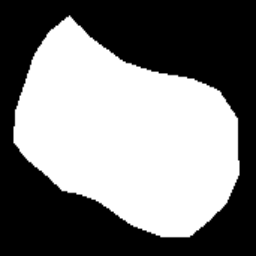

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_02_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/063_03_nuc.dat


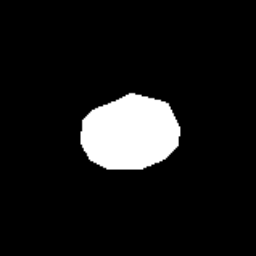

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_03_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/063_03_cyt.dat


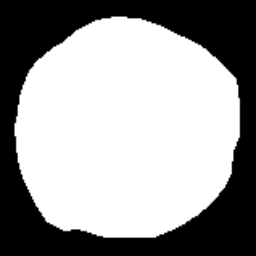

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_03_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/026_01_nuc.dat


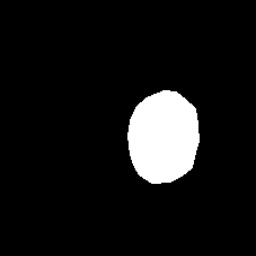

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/026_01_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/026_01_cyt.dat


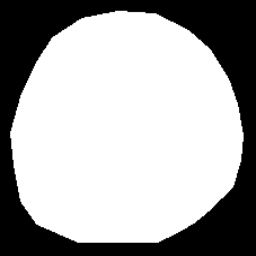

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/026_01_cyt.bmp
Extracted 13 polygon points from Parabasal/im_Parabasal/CROPPED/069_12_nuc.dat


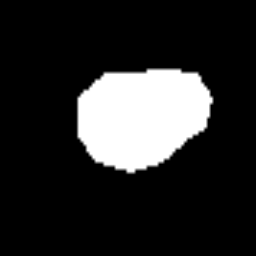

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_12_nuc.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/069_12_cyt.dat


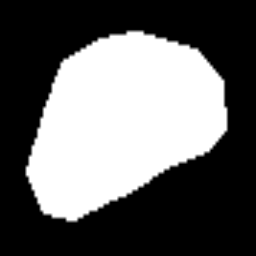

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_12_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/075_03_nuc.dat


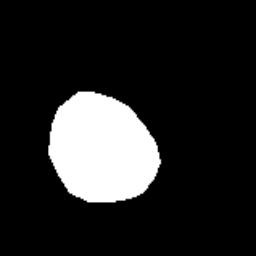

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_03_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/075_03_cyt.dat


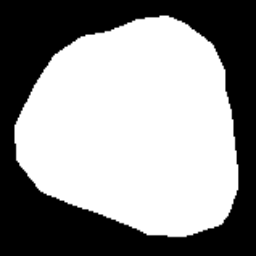

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_03_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/028_06_nuc.dat


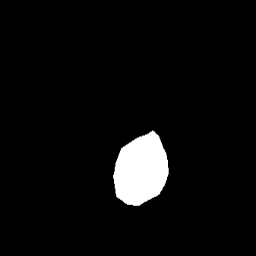

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_06_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/028_06_cyt.dat


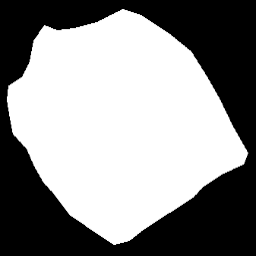

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_06_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/101_02_nuc.dat


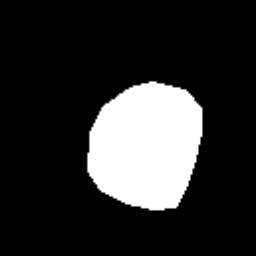

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/101_02_nuc.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/101_02_cyt.dat


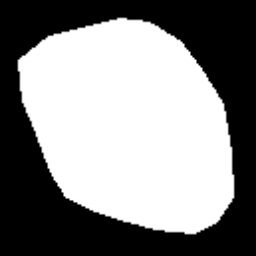

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/101_02_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/038_04_nuc.dat


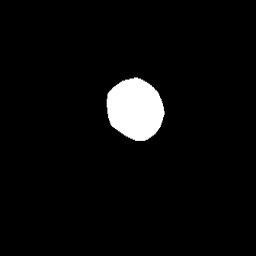

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/038_04_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/038_04_cyt.dat


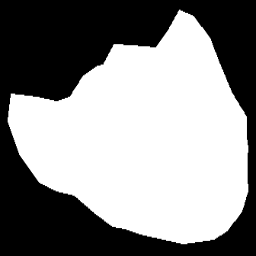

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/038_04_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/036_01_nuc.dat


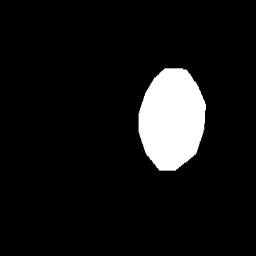

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/036_01_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/036_01_cyt.dat


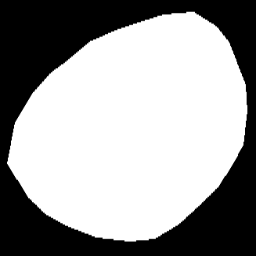

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/036_01_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/017_01_nuc.dat


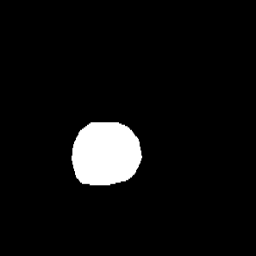

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_01_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/017_01_cyt.dat


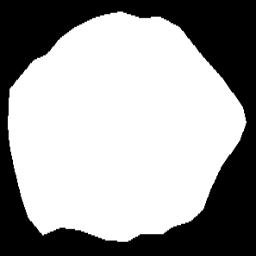

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_01_cyt.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/009_03_nuc.dat


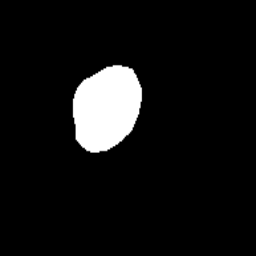

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_03_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/009_03_cyt.dat


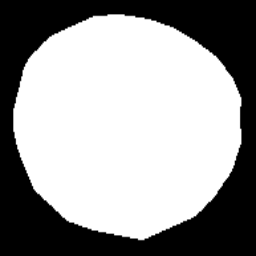

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_03_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/089_08_nuc.dat


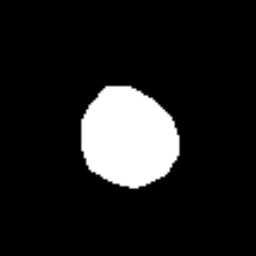

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_08_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/089_08_cyt.dat


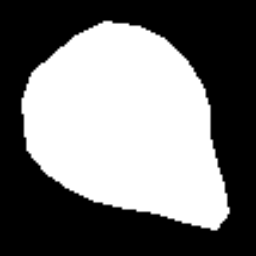

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_08_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/018_05_nuc.dat


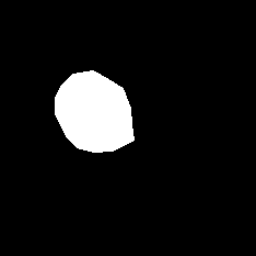

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_05_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/018_05_cyt.dat


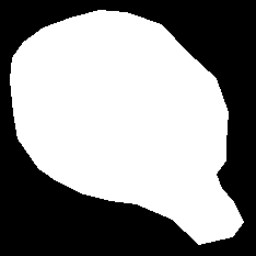

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_05_cyt.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/021_04_nuc.dat


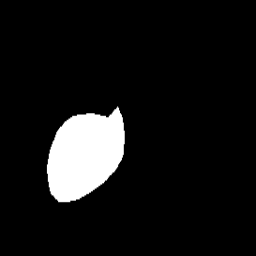

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_04_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/021_04_cyt.dat


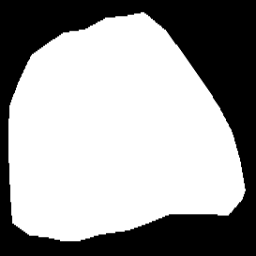

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_04_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/034_05_nuc.dat


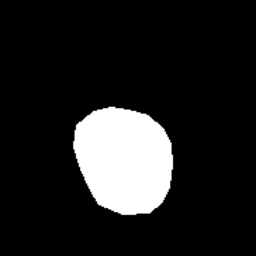

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_05_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/034_05_cyt.dat


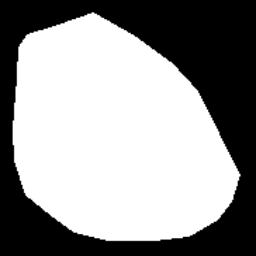

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_05_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/009_01_nuc.dat


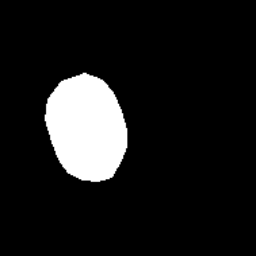

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_01_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/009_01_cyt.dat


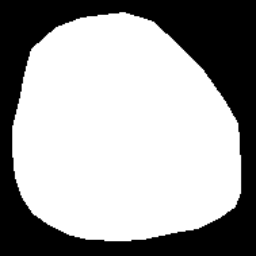

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_01_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/042_10_nuc.dat


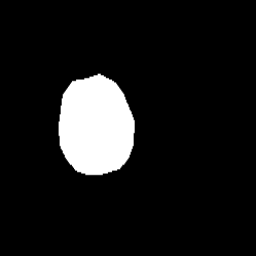

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_10_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/042_10_cyt.dat


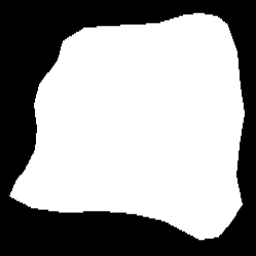

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_10_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/002_03_nuc.dat


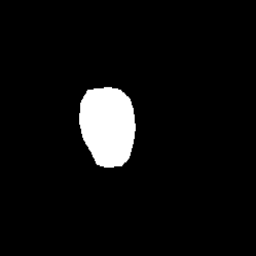

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/002_03_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/002_03_cyt.dat


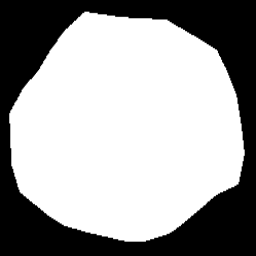

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/002_03_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/024_05_nuc.dat


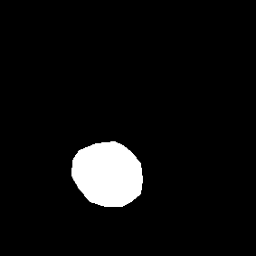

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/024_05_nuc.bmp
Extracted 45 polygon points from Parabasal/im_Parabasal/CROPPED/024_05_cyt.dat


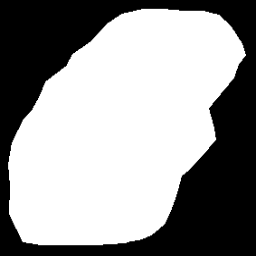

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/024_05_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/031_07_nuc.dat


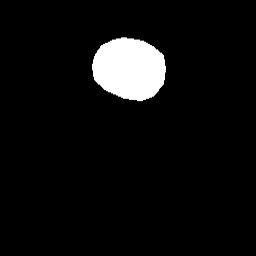

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/031_07_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/031_07_cyt.dat


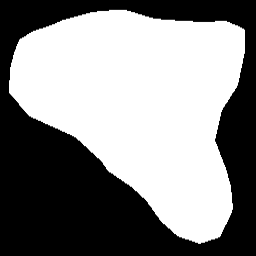

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/031_07_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/014_03_nuc.dat


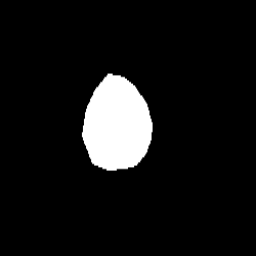

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_03_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/014_03_cyt.dat


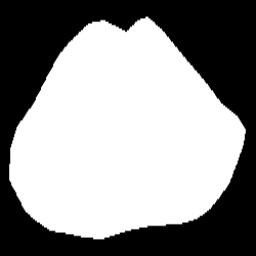

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_03_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/025_03_nuc.dat


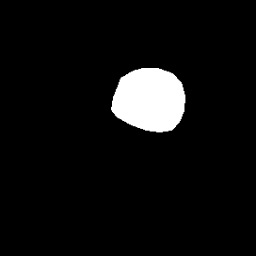

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_03_nuc.bmp
Extracted 47 polygon points from Parabasal/im_Parabasal/CROPPED/025_03_cyt.dat


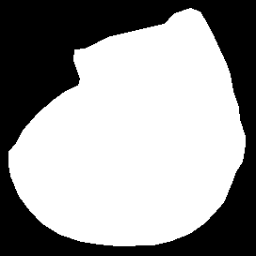

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_03_cyt.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/047_07_nuc.dat


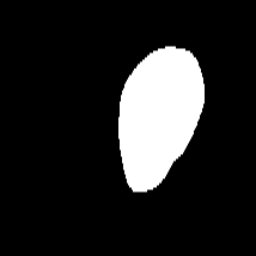

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_07_nuc.bmp
Extracted 41 polygon points from Parabasal/im_Parabasal/CROPPED/047_07_cyt.dat


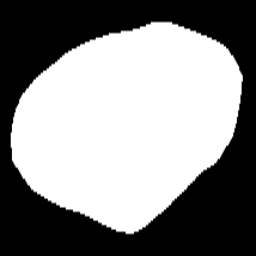

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_07_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/016_03_nuc.dat


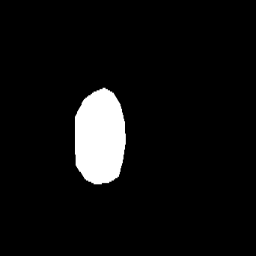

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/016_03_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/016_03_cyt.dat


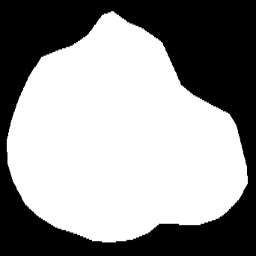

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/016_03_cyt.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/097_05_nuc.dat


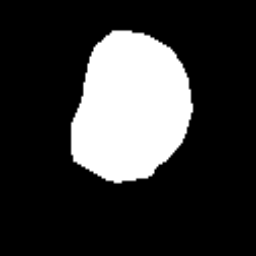

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_05_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/097_05_cyt.dat


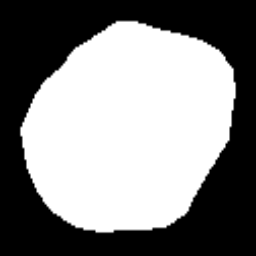

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_05_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/078_01_nuc.dat


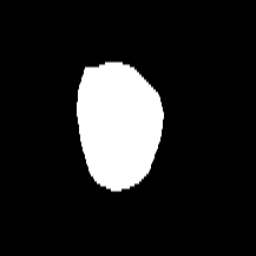

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_01_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/078_01_cyt.dat


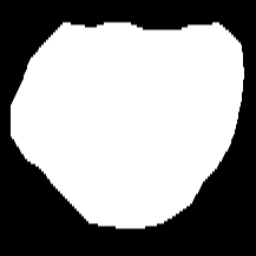

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_01_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/071_08_nuc.dat


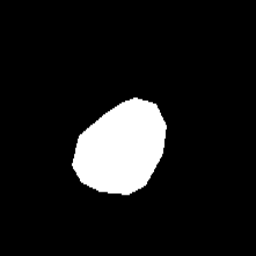

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_08_nuc.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/071_08_cyt.dat


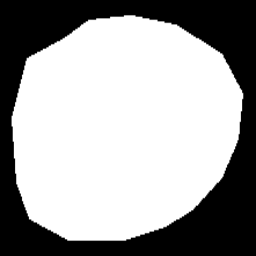

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_08_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/063_05_nuc.dat


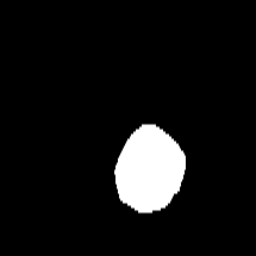

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_05_nuc.bmp
Extracted 41 polygon points from Parabasal/im_Parabasal/CROPPED/063_05_cyt.dat


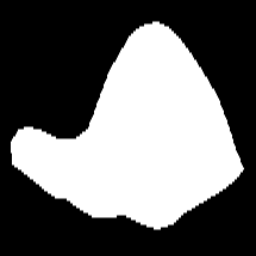

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_05_cyt.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/097_07_nuc.dat


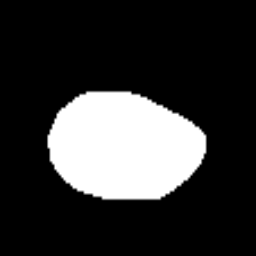

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_07_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/097_07_cyt.dat


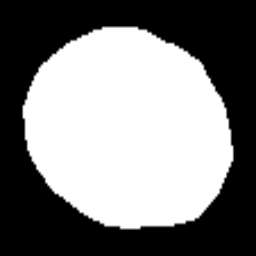

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_07_cyt.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/074_02_nuc.dat


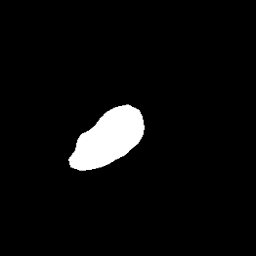

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/074_02_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/074_02_cyt.dat


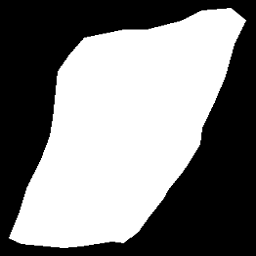

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/074_02_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/042_06_nuc.dat


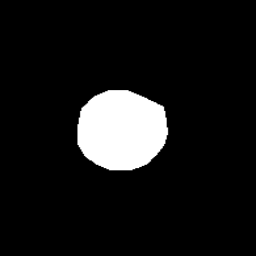

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_06_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/042_06_cyt.dat


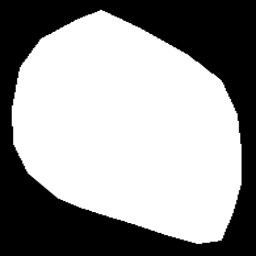

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_06_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/072_01_nuc.dat


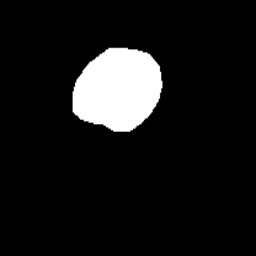

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_01_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/072_01_cyt.dat


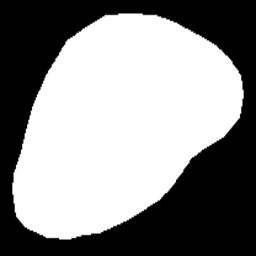

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_01_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/003_06_nuc.dat


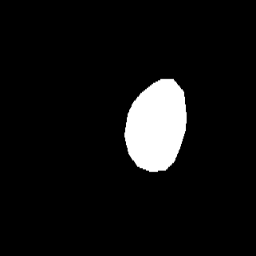

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_06_nuc.bmp
Extracted 40 polygon points from Parabasal/im_Parabasal/CROPPED/003_06_cyt.dat


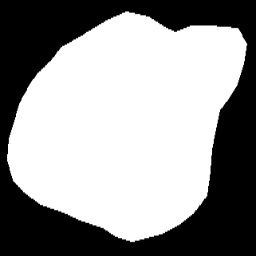

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_06_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/070_02_nuc.dat


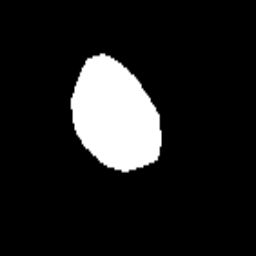

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_02_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/070_02_cyt.dat


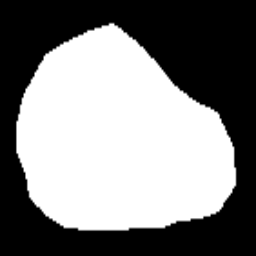

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_02_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/022_03_nuc.dat


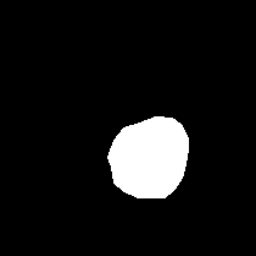

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/022_03_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/022_03_cyt.dat


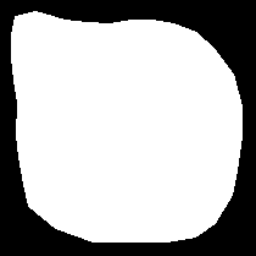

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/022_03_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/019_07_nuc.dat


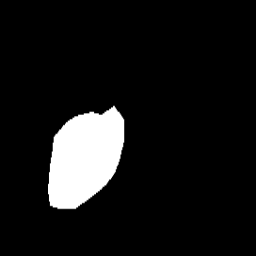

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_07_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/019_07_cyt.dat


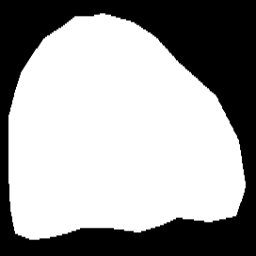

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_07_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/032_05_nuc.dat


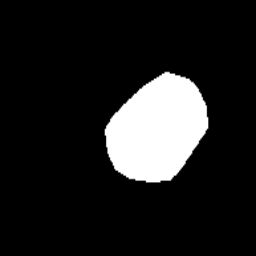

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_05_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/032_05_cyt.dat


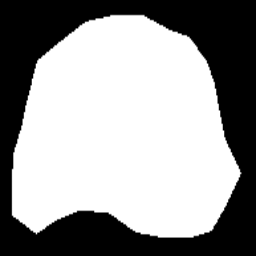

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_05_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/001_02_nuc.dat


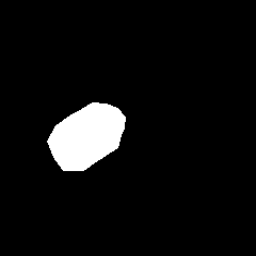

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_02_nuc.bmp
Extracted 43 polygon points from Parabasal/im_Parabasal/CROPPED/001_02_cyt.dat


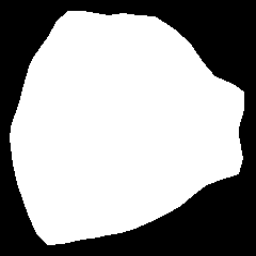

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_02_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/023_01_nuc.dat


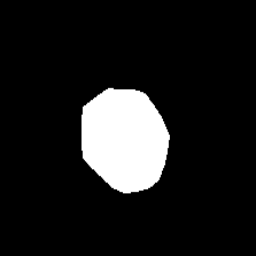

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_01_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/023_01_cyt.dat


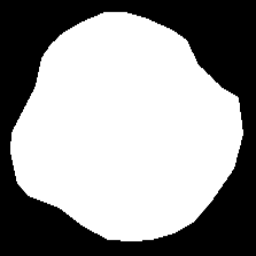

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/023_01_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/008_09_nuc.dat


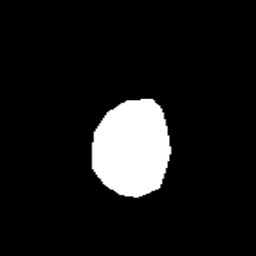

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_09_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/008_09_cyt.dat


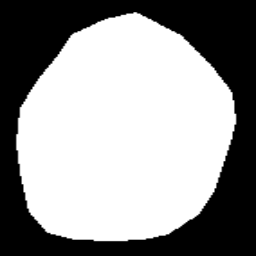

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_09_cyt.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/047_10_nuc.dat


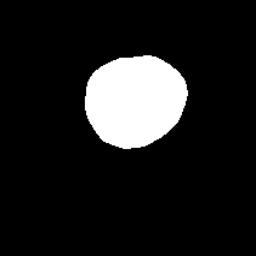

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_10_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/047_10_cyt.dat


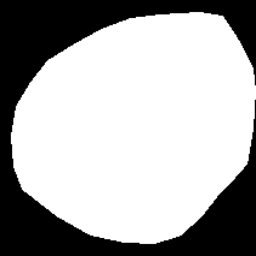

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_10_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/002_04_nuc.dat


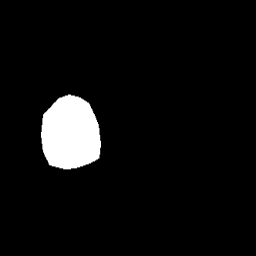

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/002_04_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/002_04_cyt.dat


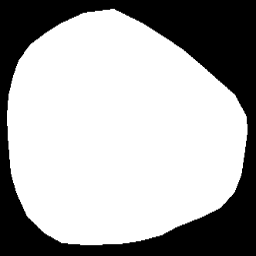

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/002_04_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/070_13_nuc.dat


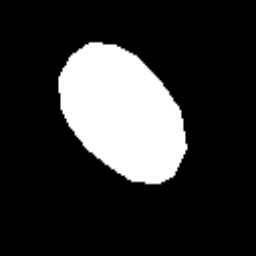

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_13_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/070_13_cyt.dat


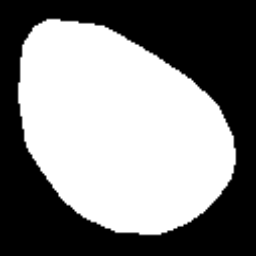

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_13_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/079_02_nuc.dat


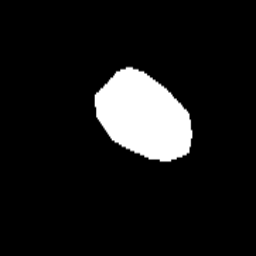

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/079_02_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/079_02_cyt.dat


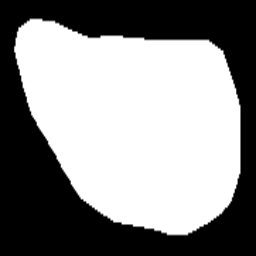

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/079_02_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/098_07_nuc.dat


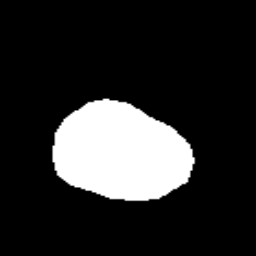

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_07_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/098_07_cyt.dat


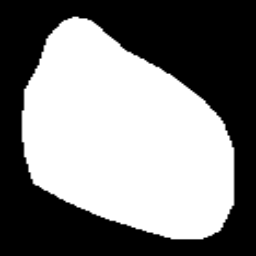

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_07_cyt.bmp
Extracted 12 polygon points from Parabasal/im_Parabasal/CROPPED/069_11_nuc.dat


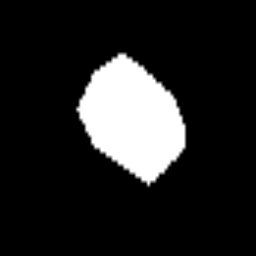

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_11_nuc.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/069_11_cyt.dat


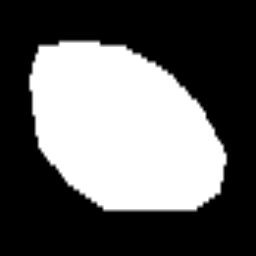

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_11_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/093_05_nuc.dat


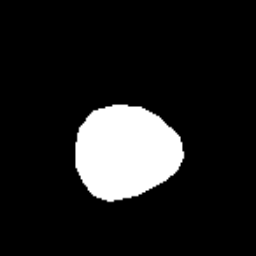

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_05_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/093_05_cyt.dat


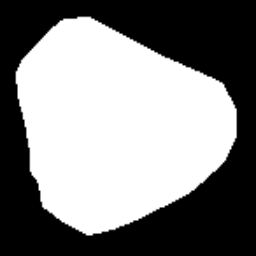

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_05_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/089_05_nuc.dat


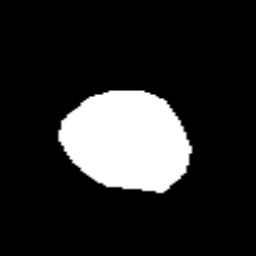

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_05_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/089_05_cyt.dat


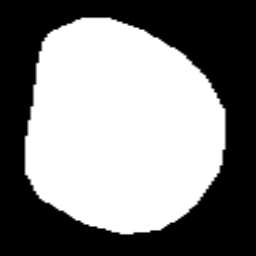

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_05_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/097_16_nuc.dat


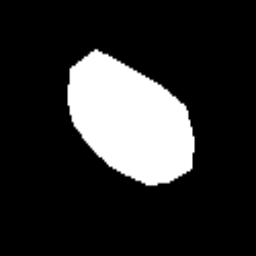

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_16_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/097_16_cyt.dat


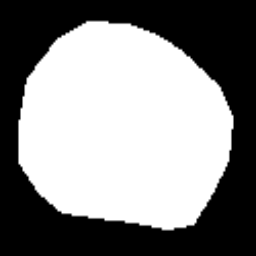

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_16_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/004_06_nuc.dat


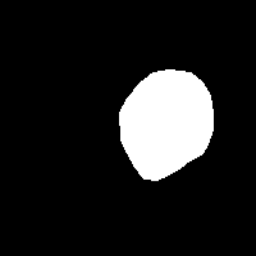

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_06_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/004_06_cyt.dat


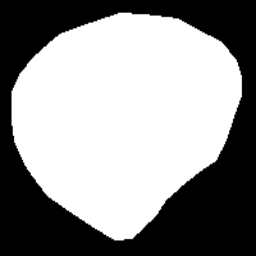

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_06_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/012_07_nuc.dat


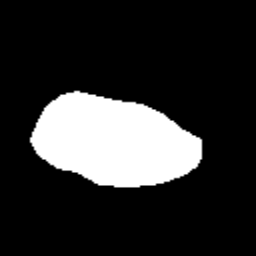

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_07_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/012_07_cyt.dat


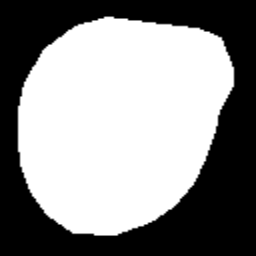

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_07_cyt.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/018_03_nuc.dat


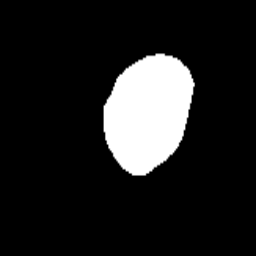

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_03_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/018_03_cyt.dat


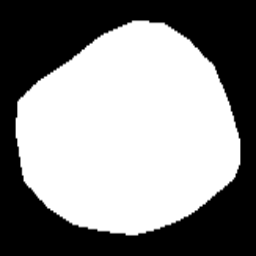

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_03_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/025_05_nuc.dat


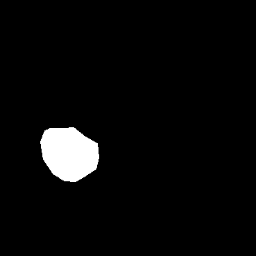

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_05_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/025_05_cyt.dat


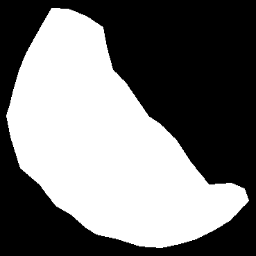

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_05_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/070_11_nuc.dat


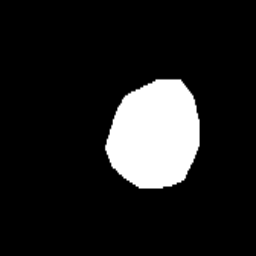

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_11_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/070_11_cyt.dat


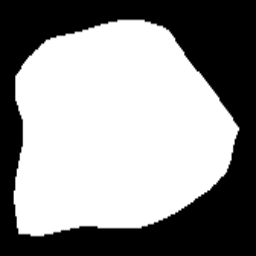

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_11_cyt.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/048_03_nuc.dat


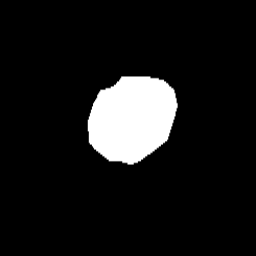

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_03_nuc.bmp
Extracted 46 polygon points from Parabasal/im_Parabasal/CROPPED/048_03_cyt.dat


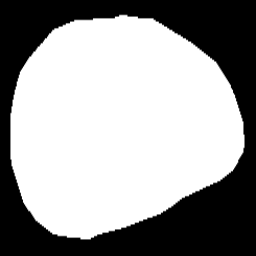

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_03_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/102_07_nuc.dat


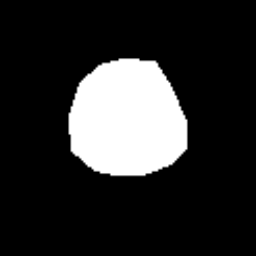

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_07_nuc.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/102_07_cyt.dat


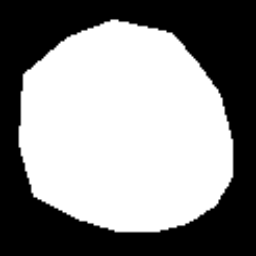

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_07_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/057_12_nuc.dat


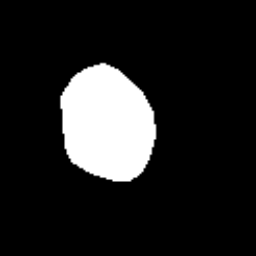

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_12_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/057_12_cyt.dat


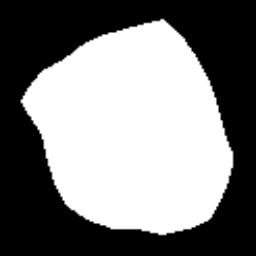

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_12_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/001_03_nuc.dat


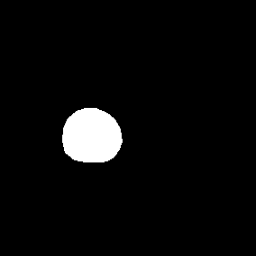

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_03_nuc.bmp
Extracted 45 polygon points from Parabasal/im_Parabasal/CROPPED/001_03_cyt.dat


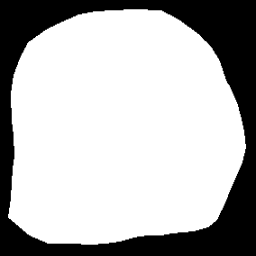

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_03_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/090_01_nuc.dat


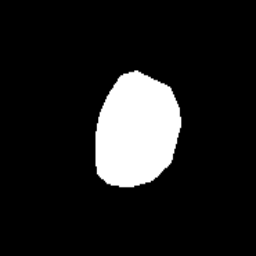

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/090_01_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/090_01_cyt.dat


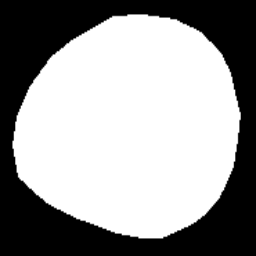

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/090_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/098_05_nuc.dat


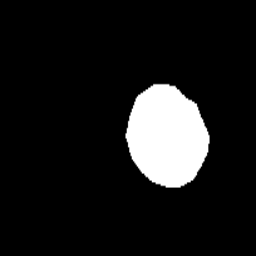

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_05_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/098_05_cyt.dat


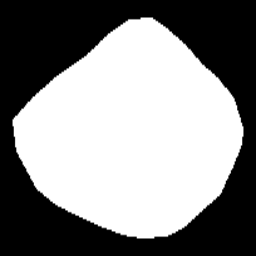

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_05_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/014_06_nuc.dat


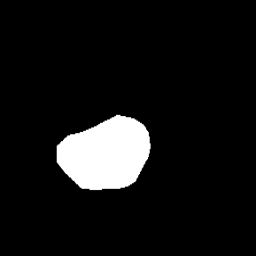

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_06_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/014_06_cyt.dat


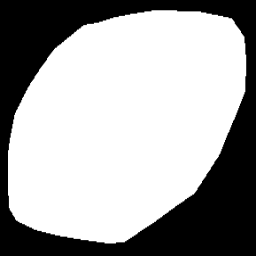

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_06_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/010_09_nuc.dat


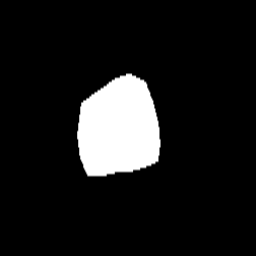

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_09_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/010_09_cyt.dat


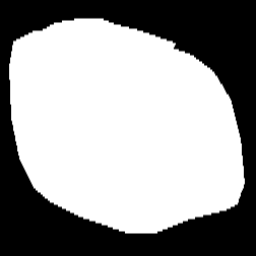

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_09_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/093_08_nuc.dat


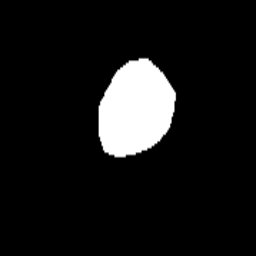

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_08_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/093_08_cyt.dat


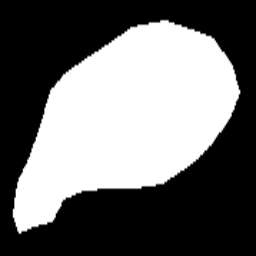

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_08_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/064_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_01_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/064_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_01_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/094_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_02_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/094_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_02_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/066_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_06_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/066_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_06_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/070_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_10_nuc.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/070_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_10_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/081_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_06_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/081_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_06_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/099_13_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_13_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/099_13_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_13_cyt.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/048_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_07_nuc.bmp
Extracted 52 polygon points from Parabasal/im_Parabasal/CROPPED/048_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_07_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/015_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_06_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/015_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_06_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/054_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_07_nuc.bmp
Extracted 39 polygon points from Parabasal/im_Parabasal/CROPPED/054_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_07_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/012_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_06_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/012_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_06_cyt.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/097_12_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_12_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/097_12_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_12_cyt.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/051_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/051_04_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/051_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/051_04_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/058_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_01_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/058_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_01_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/018_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_04_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/018_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_04_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/044_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_10_nuc.bmp
Extracted 48 polygon points from Parabasal/im_Parabasal/CROPPED/044_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_10_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/042_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_08_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/042_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_08_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/086_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_09_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/086_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_09_cyt.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/056_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_03_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/056_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_03_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/073_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/073_03_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/073_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/073_03_cyt.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/048_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_05_nuc.bmp
Extracted 49 polygon points from Parabasal/im_Parabasal/CROPPED/048_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_05_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/050_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_04_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/050_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_04_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/081_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_03_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/081_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_03_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/043_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_01_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/043_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_01_cyt.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/049_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_01_nuc.bmp
Extracted 46 polygon points from Parabasal/im_Parabasal/CROPPED/049_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_01_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/074_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/074_01_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/074_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/074_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/022_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/022_07_nuc.bmp
Extracted 39 polygon points from Parabasal/im_Parabasal/CROPPED/022_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/022_07_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/097_13_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_13_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/097_13_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_13_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/057_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_06_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/057_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_06_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/094_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_06_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/094_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_06_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/073_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/073_01_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/073_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/073_01_cyt.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/057_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_04_nuc.bmp
Extracted 39 polygon points from Parabasal/im_Parabasal/CROPPED/057_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_04_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/001_13_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_13_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/001_13_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_13_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/069_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_01_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/069_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/031_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/031_06_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/031_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/031_06_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/102_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_11_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/102_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_11_cyt.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/053_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_03_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/053_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_03_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/004_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_03_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/004_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_03_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/096_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_06_nuc.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/096_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_06_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/089_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_11_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/089_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_11_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/058_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_05_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/058_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_05_cyt.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/056_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_05_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/056_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_05_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/022_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/022_08_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/022_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/022_08_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/070_12_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_12_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/070_12_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_12_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/030_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/030_03_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/030_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/030_03_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/096_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_08_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/096_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_08_cyt.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/045_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_02_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/045_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_02_cyt.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/054_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_06_nuc.bmp
Extracted 40 polygon points from Parabasal/im_Parabasal/CROPPED/054_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_06_cyt.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/038_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/038_07_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/038_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/038_07_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/003_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_11_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/003_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_11_cyt.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/048_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_04_nuc.bmp
Extracted 57 polygon points from Parabasal/im_Parabasal/CROPPED/048_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_04_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/094_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_03_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/094_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_03_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/062_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_03_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/062_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_03_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/010_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_03_nuc.bmp
Extracted 39 polygon points from Parabasal/im_Parabasal/CROPPED/010_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_03_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/102_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_05_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/102_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_05_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/064_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_03_nuc.bmp
Extracted 40 polygon points from Parabasal/im_Parabasal/CROPPED/064_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_03_cyt.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/049_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_11_nuc.bmp
Extracted 49 polygon points from Parabasal/im_Parabasal/CROPPED/049_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_11_cyt.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/005_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_04_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/005_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_04_cyt.bmp
Extracted 12 polygon points from Parabasal/im_Parabasal/CROPPED/069_13_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_13_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/069_13_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_13_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/013_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/013_02_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/013_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/013_02_cyt.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/052_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_01_nuc.bmp
Extracted 41 polygon points from Parabasal/im_Parabasal/CROPPED/052_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_01_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/093_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_04_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/093_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_04_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/084_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/084_02_nuc.bmp
Extracted 50 polygon points from Parabasal/im_Parabasal/CROPPED/084_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/084_02_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/006_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_01_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/006_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_01_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/095_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_08_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/095_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_08_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/081_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_02_nuc.bmp
Extracted 51 polygon points from Parabasal/im_Parabasal/CROPPED/081_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_02_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/070_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_06_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/070_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_06_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/008_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_08_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/008_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_08_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/004_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_04_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/004_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_04_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/057_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_08_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/057_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_08_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/095_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_04_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/095_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_04_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/004_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_11_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/004_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_11_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/014_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_05_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/014_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_05_cyt.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/057_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_01_nuc.bmp
Extracted 48 polygon points from Parabasal/im_Parabasal/CROPPED/057_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_01_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/003_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_04_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/003_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_04_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/003_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_09_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/003_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_09_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/057_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_03_nuc.bmp
Extracted 42 polygon points from Parabasal/im_Parabasal/CROPPED/057_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_03_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/027_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_07_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/027_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_07_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/072_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_05_nuc.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/072_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_05_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/093_18_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_18_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/093_18_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_18_cyt.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/001_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_04_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/001_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_04_cyt.bmp
Extracted 11 polygon points from Parabasal/im_Parabasal/CROPPED/059_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/059_01_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/059_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/059_01_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/041_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/041_03_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/041_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/041_03_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/068_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_01_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/068_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_01_cyt.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/052_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_06_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/052_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_06_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/016_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/016_06_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/016_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/016_06_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/025_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_01_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/025_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_01_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/015_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_04_nuc.bmp
Extracted 46 polygon points from Parabasal/im_Parabasal/CROPPED/015_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_04_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/081_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_05_nuc.bmp
Extracted 43 polygon points from Parabasal/im_Parabasal/CROPPED/081_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_05_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/097_15_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_15_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/097_15_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_15_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/065_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/065_02_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/065_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/065_02_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/107_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_04_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/107_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_04_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/011_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_06_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/011_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_06_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/058_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_02_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/058_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/058_02_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/013_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/013_01_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/013_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/013_01_cyt.bmp
Extracted 13 polygon points from Parabasal/im_Parabasal/CROPPED/102_15_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_15_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/102_15_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_15_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/035_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/035_02_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/035_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/035_02_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/019_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_03_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/019_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_03_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/078_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_05_nuc.bmp
Extracted 51 polygon points from Parabasal/im_Parabasal/CROPPED/078_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_05_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/048_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_08_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/048_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_08_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/079_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/079_04_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/079_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/079_04_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/022_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/022_06_nuc.bmp
Extracted 40 polygon points from Parabasal/im_Parabasal/CROPPED/022_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/022_06_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/096_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_09_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/096_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_09_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/070_14_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_14_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/070_14_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_14_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/070_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_03_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/070_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_03_cyt.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/055_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/055_04_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/055_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/055_04_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/060_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_01_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/060_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_01_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/093_25_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_25_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/093_25_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_25_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/028_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_01_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/028_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_01_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/019_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_02_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/019_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_02_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/044_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_08_nuc.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/044_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_08_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/065_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/065_03_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/065_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/065_03_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/076_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/076_06_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/076_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/076_06_cyt.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/057_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_02_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/057_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_02_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/106_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_06_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/106_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_06_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/083_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_01_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/083_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_01_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/072_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_03_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/072_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_03_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/107_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_03_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/107_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_03_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/057_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_07_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/057_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_07_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/043_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_03_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/043_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_03_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/094_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_05_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/094_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_05_cyt.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/108_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_03_nuc.bmp
Extracted 44 polygon points from Parabasal/im_Parabasal/CROPPED/108_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_03_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/055_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/055_01_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/055_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/055_01_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/075_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_04_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/075_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_04_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/047_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_02_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/047_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_02_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/006_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_05_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/006_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_05_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/096_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_10_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/096_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_10_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/030_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/030_02_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/030_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/030_02_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/079_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/079_03_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/079_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/079_03_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/070_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_01_nuc.bmp
Extracted 43 polygon points from Parabasal/im_Parabasal/CROPPED/070_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/070_01_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/075_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_10_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/075_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_10_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/014_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_04_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/014_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_04_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/034_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_03_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/034_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_03_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/051_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/051_03_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/051_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/051_03_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/071_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_04_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/071_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_04_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/084_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/084_01_nuc.bmp
Extracted 39 polygon points from Parabasal/im_Parabasal/CROPPED/084_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/084_01_cyt.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/047_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_01_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/047_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_01_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/003_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_07_nuc.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/003_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_07_cyt.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/100_15_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_15_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/100_15_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_15_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/067_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_02_nuc.bmp
Extracted 42 polygon points from Parabasal/im_Parabasal/CROPPED/067_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_02_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/102_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_03_nuc.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/102_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_03_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/069_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_07_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/069_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/069_07_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/086_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_05_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/086_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_05_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/005_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_03_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/005_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_03_cyt.bmp
Extracted 13 polygon points from Parabasal/im_Parabasal/CROPPED/071_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_01_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/071_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_01_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/050_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_08_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/050_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_08_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/003_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_02_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/003_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_02_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/012_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_02_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/012_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_02_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/042_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_03_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/042_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_03_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/075_12_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_12_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/075_12_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_12_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/004_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_01_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/004_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/012_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_04_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/012_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_04_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/011_12_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_12_nuc.bmp
Extracted 41 polygon points from Parabasal/im_Parabasal/CROPPED/011_12_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_12_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/078_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_02_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/078_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_02_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/010_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_01_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/010_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_01_cyt.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/054_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_01_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/054_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/054_01_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/089_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_10_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/089_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_10_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/055_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/055_05_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/055_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/055_05_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/071_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_05_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/071_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_05_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/020_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_02_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/020_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_02_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/050_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_03_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/050_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_03_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/067_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_04_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/067_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_04_cyt.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/052_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_02_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/052_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_02_cyt.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/027_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_06_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/027_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_06_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/011_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_04_nuc.bmp
Extracted 42 polygon points from Parabasal/im_Parabasal/CROPPED/011_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_04_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/106_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_09_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/106_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_09_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/034_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_06_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/034_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/034_06_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/009_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_06_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/009_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/009_06_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/072_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_06_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/072_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_06_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/014_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_01_nuc.bmp
Extracted 44 polygon points from Parabasal/im_Parabasal/CROPPED/014_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_01_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/065_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/065_07_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/065_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/065_07_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/102_14_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_14_nuc.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/102_14_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_14_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/063_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_02_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/063_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_02_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/102_13_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_13_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/102_13_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_13_cyt.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/097_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_11_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/097_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_11_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/006_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_02_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/006_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_02_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/100_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_08_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/100_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_08_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/064_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_02_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/064_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_02_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/032_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_02_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/032_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_02_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/011_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_09_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/011_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_09_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/108_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_01_nuc.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/108_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_01_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/012_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_01_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/012_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_01_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/092_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/092_02_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/092_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/092_02_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/038_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/038_02_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/038_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/038_02_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/095_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_11_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/095_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_11_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/004_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_08_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/004_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_08_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/075_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_06_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/075_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_06_cyt.bmp
Extracted 13 polygon points from Parabasal/im_Parabasal/CROPPED/105_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/105_01_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/105_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/105_01_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/086_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_06_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/086_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_06_cyt.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/053_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_04_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/053_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_04_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/049_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_10_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/049_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_10_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/077_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/077_04_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/077_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/077_04_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/083_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_02_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/083_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_02_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/018_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_01_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/018_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/018_01_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/089_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_04_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/089_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_04_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/038_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/038_05_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/038_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/038_05_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/011_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_10_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/011_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_10_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/002_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/002_01_nuc.bmp
Extracted 41 polygon points from Parabasal/im_Parabasal/CROPPED/002_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/002_01_cyt.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/057_15_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_15_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/057_15_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_15_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/096_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_01_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/096_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/096_01_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/041_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/041_02_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/041_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/041_02_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/022_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/022_05_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/022_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/022_05_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/100_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_09_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/100_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_09_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/060_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_04_nuc.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/060_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/060_04_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/089_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_02_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/089_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_02_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/028_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_02_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/028_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_02_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/091_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/091_01_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/091_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/091_01_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/086_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_10_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/086_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_10_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/003_13_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_13_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/003_13_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_13_cyt.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/044_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_06_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/044_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_06_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/012_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_03_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/012_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_03_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/097_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_08_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/097_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_08_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/042_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_02_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/042_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/042_02_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/095_15_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_15_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/095_15_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_15_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/032_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_03_nuc.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/032_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_03_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/057_13_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_13_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/057_13_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_13_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/032_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_01_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/032_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_01_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/033_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/033_03_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/033_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/033_03_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/107_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_02_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/107_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_02_cyt.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/049_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_09_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/049_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_09_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/093_20_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_20_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/093_20_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_20_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/016_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/016_07_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/016_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/016_07_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/008_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_03_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/008_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_03_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/077_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/077_01_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/077_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/077_01_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/094_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_07_nuc.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/094_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_07_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/071_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_06_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/071_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/071_06_cyt.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/050_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_01_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/050_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_01_cyt.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/049_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_08_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/049_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_08_cyt.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/007_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_01_nuc.bmp
Extracted 39 polygon points from Parabasal/im_Parabasal/CROPPED/007_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_01_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/027_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_05_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/027_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_05_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/068_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_02_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/068_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/068_02_cyt.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/001_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_05_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/001_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_05_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/016_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/016_02_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/016_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/016_02_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/102_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_02_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/102_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_02_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/011_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_02_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/011_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_02_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/031_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/031_03_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/031_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/031_03_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/062_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_05_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/062_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_05_cyt.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/052_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_03_nuc.bmp
Extracted 47 polygon points from Parabasal/im_Parabasal/CROPPED/052_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_03_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/086_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_04_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/086_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_04_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/032_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_08_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/032_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_08_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/031_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/031_05_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/031_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/031_05_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/093_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_01_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/093_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_01_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/093_15_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_15_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/093_15_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_15_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/056_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_06_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/056_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_06_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/100_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_03_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/100_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_03_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/019_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_08_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/019_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_08_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/011_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_01_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/011_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/043_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_02_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/043_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/043_02_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/100_17_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_17_nuc.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/100_17_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_17_cyt.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/097_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_09_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/097_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_09_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/040_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/040_03_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/040_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/040_03_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/044_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_05_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/044_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_05_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/078_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_03_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/078_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_03_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/029_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/029_03_nuc.bmp
Extracted 45 polygon points from Parabasal/im_Parabasal/CROPPED/029_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/029_03_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/004_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_10_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/004_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_10_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/027_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_03_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/027_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_03_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/044_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_11_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/044_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_11_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/008_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_02_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/008_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_02_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/028_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_08_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/028_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_08_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/063_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_04_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/063_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_04_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/010_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_04_nuc.bmp
Extracted 49 polygon points from Parabasal/im_Parabasal/CROPPED/010_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/010_04_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/075_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_07_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/075_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_07_cyt.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/056_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_04_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/056_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/056_04_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/062_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_10_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/062_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/062_10_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/099_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_02_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/099_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_02_cyt.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/047_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_05_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/047_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_05_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/099_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_01_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/099_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_01_cyt.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/050_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_02_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/050_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/050_02_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/015_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_05_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/015_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_05_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/038_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/038_01_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/038_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/038_01_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/067_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_03_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/067_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_03_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/077_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/077_03_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/077_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/077_03_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/100_16_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_16_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/100_16_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_16_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/081_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_04_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/081_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/081_04_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/061_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/061_03_nuc.bmp
Extracted 40 polygon points from Parabasal/im_Parabasal/CROPPED/061_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/061_03_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/083_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_04_nuc.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/083_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/083_04_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/025_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_06_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/025_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/025_06_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/076_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/076_05_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/076_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/076_05_cyt.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/049_12_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_12_nuc.bmp
Extracted 39 polygon points from Parabasal/im_Parabasal/CROPPED/049_12_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_12_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/076_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/076_03_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/076_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/076_03_cyt.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/045_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_08_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/045_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_08_cyt.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/049_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_02_nuc.bmp
Extracted 53 polygon points from Parabasal/im_Parabasal/CROPPED/049_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_02_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/093_22_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_22_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/093_22_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_22_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/027_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_04_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/027_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_04_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/045_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_03_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/045_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_03_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/082_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/082_01_nuc.bmp
Extracted 42 polygon points from Parabasal/im_Parabasal/CROPPED/082_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/082_01_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/008_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_05_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/008_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_05_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/106_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_03_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/106_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/106_03_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/015_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_03_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/015_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_03_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/040_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/040_02_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/040_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/040_02_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/019_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_01_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/019_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_01_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/093_23_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_23_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/093_23_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/093_23_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/003_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_10_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/003_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_10_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/102_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_09_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/102_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_09_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/028_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_05_nuc.bmp
Extracted 41 polygon points from Parabasal/im_Parabasal/CROPPED/028_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_05_cyt.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/053_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_06_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/053_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/053_06_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/063_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_01_nuc.bmp
Extracted 47 polygon points from Parabasal/im_Parabasal/CROPPED/063_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/098_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_03_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/098_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/098_03_cyt.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/048_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_01_nuc.bmp
Extracted 57 polygon points from Parabasal/im_Parabasal/CROPPED/048_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/048_01_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/090_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/090_02_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/090_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/090_02_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/100_13_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_13_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/100_13_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_13_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/019_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_04_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/019_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_04_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/044_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_07_nuc.bmp
Extracted 46 polygon points from Parabasal/im_Parabasal/CROPPED/044_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_07_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/057_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_09_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/057_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_09_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/076_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/076_01_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/076_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/076_01_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/014_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_09_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/014_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_09_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/004_12_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_12_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/004_12_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/004_12_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/080_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_02_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/080_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_02_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/008_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_10_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/008_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/008_10_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/089_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_03_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/089_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_03_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/097_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_10_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/097_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_10_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/021_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_05_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/021_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/021_05_cyt.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/047_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_06_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/047_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/047_06_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/005_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_06_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/005_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/005_06_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/011_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_08_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/011_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/011_08_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/086_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_07_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/086_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_07_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/072_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_04_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/072_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/072_04_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/075_14_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_14_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/075_14_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/075_14_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/037_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/037_01_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/037_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/037_01_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/066_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_05_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/066_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/066_05_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/015_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_01_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/015_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_01_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/014_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_07_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/014_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/014_07_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/006_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_03_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/006_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/006_03_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/003_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_05_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/003_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/003_05_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/078_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_07_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/078_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/078_07_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/089_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_09_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/089_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/089_09_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/044_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_09_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/044_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/044_09_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/057_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_11_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/057_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/057_11_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/080_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_01_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/080_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_01_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/094_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_01_nuc.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/094_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_01_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/031_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/031_08_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/031_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/031_08_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/016_12_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/016_12_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/016_12_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/016_12_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/001_12_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_12_nuc.bmp
Extracted 42 polygon points from Parabasal/im_Parabasal/CROPPED/001_12_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/001_12_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/035_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/035_03_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/035_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/035_03_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/095_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_09_nuc.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/095_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_09_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/039_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/039_01_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/039_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/039_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/032_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_06_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/032_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_06_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/100_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_04_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/100_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/100_04_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/037_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/037_05_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/037_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/037_05_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/066_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/066_03_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/066_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/066_03_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/093_17_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/093_17_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/093_17_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/093_17_cyt.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/003_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/003_01_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/003_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/003_01_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/095_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/095_01_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/095_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/095_01_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/100_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/100_11_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/100_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/100_11_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/108_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/108_02_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/108_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/108_02_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/100_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/100_05_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/100_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/100_05_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/010_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/010_08_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/010_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/010_08_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/065_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/065_01_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/065_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/065_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/029_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/029_04_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/029_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/029_04_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/102_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/102_06_nuc.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/102_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/102_06_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/016_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/016_09_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/016_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/016_09_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/005_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/005_01_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/005_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/005_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/004_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/004_05_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/004_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/004_05_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/052_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/052_08_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/052_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/052_08_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/062_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/062_07_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/062_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/062_07_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/038_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/038_03_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/038_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/038_03_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/030_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/030_04_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/030_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/030_04_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/101_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/101_06_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/101_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/101_06_cyt.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/053_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/053_07_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/053_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/053_07_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/044_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/044_01_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/044_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/044_01_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/097_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/097_01_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/097_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/097_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/008_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/008_01_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/008_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/008_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/028_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/028_07_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/028_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/028_07_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/011_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/011_11_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/011_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/011_11_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/039_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/039_02_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/039_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/039_02_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/069_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/069_08_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/069_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/069_08_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/026_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/026_05_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/026_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/026_05_cyt.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/045_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/045_06_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/045_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/045_06_cyt.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/045_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/045_04_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/045_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/045_04_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/100_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/100_10_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/100_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/100_10_cyt.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/049_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/049_06_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/049_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/049_06_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/102_12_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/102_12_nuc.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/102_12_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/102_12_cyt.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/047_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/047_04_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/047_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/047_04_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/097_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/097_02_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/097_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/097_02_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/075_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/075_09_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/075_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/075_09_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/024_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/024_02_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/024_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/024_02_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/068_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/068_03_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/068_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/068_03_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/092_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/092_03_nuc.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/092_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/092_03_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/086_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/086_02_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/086_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/086_02_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/020_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/020_01_nuc.bmp
Extracted 47 polygon points from Parabasal/im_Parabasal/CROPPED/020_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/020_01_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/099_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/099_10_nuc.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/099_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/099_10_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/023_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/023_02_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/023_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/023_02_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/057_14_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/057_14_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/057_14_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/057_14_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/064_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/064_05_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/064_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/064_05_cyt.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/056_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/056_01_nuc.bmp
Extracted 39 polygon points from Parabasal/im_Parabasal/CROPPED/056_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/056_01_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/046_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/046_01_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/046_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/046_01_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/021_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/021_06_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/021_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/021_06_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/095_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/095_05_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/095_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/095_05_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/066_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/066_01_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/066_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/066_01_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/004_13_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/004_13_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/004_13_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/004_13_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/001_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/001_11_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/001_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/001_11_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/065_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/065_05_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/065_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/065_05_cyt.bmp
Extracted 13 polygon points from Parabasal/im_Parabasal/CROPPED/099_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/099_06_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/099_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/099_06_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/016_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/016_05_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/016_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/016_05_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/050_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/050_07_nuc.bmp
Extracted 41 polygon points from Parabasal/im_Parabasal/CROPPED/050_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/050_07_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/099_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/099_08_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/099_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/099_08_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/075_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/075_08_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/075_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/075_08_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/106_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/106_08_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/106_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/106_08_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/027_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/027_08_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/027_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/027_08_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/024_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/024_04_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/024_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/024_04_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/021_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/021_02_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/021_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/021_02_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/100_14_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/100_14_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/100_14_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/100_14_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/033_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/033_01_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/033_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/033_01_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/029_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/029_01_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/029_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/029_01_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/093_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/093_03_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/093_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/093_03_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/022_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/022_09_nuc.bmp
Extracted 41 polygon points from Parabasal/im_Parabasal/CROPPED/022_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/022_09_cyt.bmp
Extracted 13 polygon points from Parabasal/im_Parabasal/CROPPED/100_12_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/100_12_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/100_12_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/100_12_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/008_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/008_04_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/008_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/008_04_cyt.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/051_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/051_01_nuc.bmp
Extracted 47 polygon points from Parabasal/im_Parabasal/CROPPED/051_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/051_01_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/057_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/057_05_nuc.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/057_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/057_05_cyt.bmp
Extracted 13 polygon points from Parabasal/im_Parabasal/CROPPED/058_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/058_04_nuc.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/058_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/058_04_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/034_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/034_04_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/034_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/034_04_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/072_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/072_08_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/072_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/072_08_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/084_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/084_04_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/084_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/084_04_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/098_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/098_04_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/098_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/098_04_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/032_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/032_07_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/032_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/032_07_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/010_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/010_02_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/010_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/010_02_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/106_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/106_05_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/106_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/106_05_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/071_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/071_07_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/071_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/071_07_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/059_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/059_03_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/059_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/059_03_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/010_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/010_10_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/010_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/010_10_cyt.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/052_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/052_10_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/052_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/052_10_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/096_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/096_05_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/096_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/096_05_cyt.bmp
Extracted 12 polygon points from Parabasal/im_Parabasal/CROPPED/070_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/070_09_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/070_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/070_09_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/016_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/016_11_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/016_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/016_11_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/062_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/062_02_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/062_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/062_02_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/023_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/023_03_nuc.bmp
Extracted 45 polygon points from Parabasal/im_Parabasal/CROPPED/023_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/023_03_cyt.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/050_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/050_05_nuc.bmp
Extracted 57 polygon points from Parabasal/im_Parabasal/CROPPED/050_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/050_05_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/016_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/016_01_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/016_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/016_01_cyt.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/053_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/053_05_nuc.bmp
Extracted 40 polygon points from Parabasal/im_Parabasal/CROPPED/053_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/053_05_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/006_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/006_08_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/006_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/006_08_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/094_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/094_04_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/094_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/094_04_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/027_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/027_02_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/027_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/027_02_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/022_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/022_01_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/022_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/022_01_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/055_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/055_02_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/055_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/055_02_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/001_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/001_10_nuc.bmp
Extracted 44 polygon points from Parabasal/im_Parabasal/CROPPED/001_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/001_10_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/082_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/082_03_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/082_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/082_03_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/036_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/036_03_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/036_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/036_03_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/080_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/080_03_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/080_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/080_03_cyt.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/047_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/047_08_nuc.bmp
Extracted 72 polygon points from Parabasal/im_Parabasal/CROPPED/047_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/047_08_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/035_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/035_01_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/035_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/035_01_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/070_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/070_08_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/070_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/070_08_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/106_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/106_07_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/106_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/106_07_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/038_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/038_06_nuc.bmp
Extracted 39 polygon points from Parabasal/im_Parabasal/CROPPED/038_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/038_06_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/043_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/043_04_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/043_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/043_04_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/072_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/072_02_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/072_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/072_02_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/101_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/101_04_nuc.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/101_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/101_04_cyt.bmp
Extracted 12 polygon points from Parabasal/im_Parabasal/CROPPED/069_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/069_10_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/069_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/069_10_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/055_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/055_06_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/055_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/055_06_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/075_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/075_11_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/075_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/075_11_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/065_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/065_04_nuc.bmp
Extracted 39 polygon points from Parabasal/im_Parabasal/CROPPED/065_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/065_04_cyt.bmp
Extracted 13 polygon points from Parabasal/im_Parabasal/CROPPED/099_12_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/099_12_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/099_12_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/099_12_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/073_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/073_02_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/073_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/073_02_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/106_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/106_01_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/106_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/106_01_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/093_19_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/093_19_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/093_19_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/093_19_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/079_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/079_01_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/079_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/079_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/068_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/068_04_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/068_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/068_04_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/098_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/098_02_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/098_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/098_02_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/054_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/054_08_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/054_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/054_08_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/014_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/014_10_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/014_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/014_10_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/029_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/029_05_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/029_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/029_05_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/042_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/042_11_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/042_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/042_11_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/099_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/099_03_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/099_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/099_03_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/001_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/001_09_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/001_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/001_09_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/062_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/062_11_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/062_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/062_11_cyt.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/054_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/054_02_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/054_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/054_02_cyt.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/097_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/097_06_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/097_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/097_06_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/031_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/031_01_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/031_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/031_01_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/093_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/093_02_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/093_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/093_02_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/020_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/020_05_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/020_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/020_05_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/008_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/008_07_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/008_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/008_07_cyt.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/099_14_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/099_14_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/099_14_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/099_14_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/073_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/073_04_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/073_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/073_04_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/023_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/023_04_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/023_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/023_04_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/031_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/031_09_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/031_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/031_09_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/060_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/060_06_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/060_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/060_06_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/024_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/024_03_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/024_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/024_03_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/044_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/044_04_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/044_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/044_04_cyt.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/004_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/004_07_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/004_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/004_07_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/036_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/036_04_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/036_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/036_04_cyt.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/052_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/052_05_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/052_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/052_05_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/033_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/033_02_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/033_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/033_02_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/072_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/072_07_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/072_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/072_07_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/069_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/069_04_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/069_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/069_04_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/042_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/042_09_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/042_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/042_09_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/095_14_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/095_14_nuc.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/095_14_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/095_14_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/031_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/031_04_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/031_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/031_04_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/086_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/086_03_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/086_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/086_03_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/003_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/003_08_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/003_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/003_08_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/096_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/096_04_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/096_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/096_04_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/001_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/001_08_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/001_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/001_08_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/062_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/062_06_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/062_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/062_06_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/045_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/045_01_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/045_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/045_01_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/089_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/089_01_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/089_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/089_01_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/070_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/070_04_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/070_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Validation_Data/Masks/070_04_cyt.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/052_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/052_04_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/052_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/052_04_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/004_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/004_02_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/004_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/004_02_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/086_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/086_08_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/086_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/086_08_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/062_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/062_08_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/062_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/062_08_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/031_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/031_02_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/031_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/031_02_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/037_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/037_03_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/037_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/037_03_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/093_13_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/093_13_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/093_13_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/093_13_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/066_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/066_07_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/066_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/066_07_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/037_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/037_06_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/037_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/037_06_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/061_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/061_04_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/061_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/061_04_cyt.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/045_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/045_07_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/045_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/045_07_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/104_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/104_01_nuc.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/104_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/104_01_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/016_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/016_10_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/016_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/016_10_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/008_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/008_06_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/008_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/008_06_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/026_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/026_04_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/026_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/026_04_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/012_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/012_05_nuc.bmp
Extracted 30 polygon points from Parabasal/im_Parabasal/CROPPED/012_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/012_05_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/075_13_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/075_13_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/075_13_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/075_13_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/016_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/016_04_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/016_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/016_04_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/095_17_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/095_17_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/095_17_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/095_17_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/019_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/019_11_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/019_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/019_11_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/015_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/015_02_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/015_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/015_02_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/026_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/026_03_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/026_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/026_03_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/099_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/099_07_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/099_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/099_07_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/022_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/022_02_nuc.bmp
Extracted 45 polygon points from Parabasal/im_Parabasal/CROPPED/022_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/022_02_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/003_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/003_03_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/003_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/003_03_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/028_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/028_03_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/028_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/028_03_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/019_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/019_09_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/019_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/019_09_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/102_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/102_10_nuc.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/102_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/102_10_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/011_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/011_05_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/011_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/011_05_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/089_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/089_06_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/089_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/089_06_cyt.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/053_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/053_02_nuc.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/053_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/053_02_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/011_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/011_07_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/011_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/011_07_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/106_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/106_04_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/106_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/106_04_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/009_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/009_02_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/009_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/009_02_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/093_14_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/093_14_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/093_14_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/093_14_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/011_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/011_03_nuc.bmp
Extracted 41 polygon points from Parabasal/im_Parabasal/CROPPED/011_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/011_03_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/095_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/095_10_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/095_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/095_10_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/062_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/062_04_nuc.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/062_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/062_04_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/041_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/041_04_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/041_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/041_04_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/064_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/064_06_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/064_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/064_06_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/060_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/060_05_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/060_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/060_05_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/077_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/077_05_nuc.bmp
Extracted 56 polygon points from Parabasal/im_Parabasal/CROPPED/077_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/077_05_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/099_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/099_09_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/099_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/099_09_cyt.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/026_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/026_07_nuc.bmp
Extracted 32 polygon points from Parabasal/im_Parabasal/CROPPED/026_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/026_07_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/075_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/075_01_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/075_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/075_01_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/009_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/009_05_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/009_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/009_05_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/032_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/032_09_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/032_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/032_09_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/095_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/095_02_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/095_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/095_02_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/084_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/084_03_nuc.bmp
Extracted 48 polygon points from Parabasal/im_Parabasal/CROPPED/084_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/084_03_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/029_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/029_02_nuc.bmp
Extracted 36 polygon points from Parabasal/im_Parabasal/CROPPED/029_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/029_02_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/092_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/092_04_nuc.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/092_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/092_04_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/093_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/093_11_nuc.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/093_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/093_11_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/010_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/010_07_nuc.bmp
Extracted 35 polygon points from Parabasal/im_Parabasal/CROPPED/010_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/010_07_cyt.bmp
Extracted 24 polygon points from Parabasal/im_Parabasal/CROPPED/049_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/049_05_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/049_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/049_05_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/042_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/042_05_nuc.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/042_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/042_05_cyt.bmp
Extracted 20 polygon points from Parabasal/im_Parabasal/CROPPED/034_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/034_01_nuc.bmp
Extracted 37 polygon points from Parabasal/im_Parabasal/CROPPED/034_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/034_01_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/104_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/104_03_nuc.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/104_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/104_03_cyt.bmp
Extracted 13 polygon points from Parabasal/im_Parabasal/CROPPED/102_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/102_08_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/102_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/102_08_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/101_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/101_05_nuc.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/101_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/101_05_cyt.bmp
Extracted 15 polygon points from Parabasal/im_Parabasal/CROPPED/099_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/099_05_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/099_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/099_05_cyt.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/070_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/070_05_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/070_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/070_05_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/103_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/103_01_nuc.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/103_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/103_01_cyt.bmp
Extracted 22 polygon points from Parabasal/im_Parabasal/CROPPED/019_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/019_10_nuc.bmp
Extracted 42 polygon points from Parabasal/im_Parabasal/CROPPED/019_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/019_10_cyt.bmp
Extracted 23 polygon points from Parabasal/im_Parabasal/CROPPED/020_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/020_03_nuc.bmp
Extracted 43 polygon points from Parabasal/im_Parabasal/CROPPED/020_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/020_03_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/095_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/095_06_nuc.bmp
Extracted 18 polygon points from Parabasal/im_Parabasal/CROPPED/095_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/095_06_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/098_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/098_08_nuc.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/098_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/098_08_cyt.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/048_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/048_02_nuc.bmp
Extracted 45 polygon points from Parabasal/im_Parabasal/CROPPED/048_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/048_02_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/067_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/067_06_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/067_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/067_06_cyt.bmp
Extracted 33 polygon points from Parabasal/im_Parabasal/CROPPED/051_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/051_02_nuc.bmp
Extracted 43 polygon points from Parabasal/im_Parabasal/CROPPED/051_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/051_02_cyt.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/093_21_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/093_21_nuc.bmp
Extracted 25 polygon points from Parabasal/im_Parabasal/CROPPED/093_21_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/093_21_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/070_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/070_07_nuc.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/070_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/070_07_cyt.bmp
Extracted 14 polygon points from Parabasal/im_Parabasal/CROPPED/060_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/060_02_nuc.bmp
Extracted 34 polygon points from Parabasal/im_Parabasal/CROPPED/060_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/060_02_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/011_13_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/011_13_nuc.bmp
Extracted 28 polygon points from Parabasal/im_Parabasal/CROPPED/011_13_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/011_13_cyt.bmp
Extracted 19 polygon points from Parabasal/im_Parabasal/CROPPED/100_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/100_01_nuc.bmp
Extracted 26 polygon points from Parabasal/im_Parabasal/CROPPED/100_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/100_01_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/014_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/014_08_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/014_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/014_08_cyt.bmp
Extracted 31 polygon points from Parabasal/im_Parabasal/CROPPED/048_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/048_06_nuc.bmp
Extracted 59 polygon points from Parabasal/im_Parabasal/CROPPED/048_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/048_06_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/093_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/093_10_nuc.bmp
Extracted 29 polygon points from Parabasal/im_Parabasal/CROPPED/093_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/093_10_cyt.bmp
Extracted 16 polygon points from Parabasal/im_Parabasal/CROPPED/095_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/095_03_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/095_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/095_03_cyt.bmp
Extracted 27 polygon points from Parabasal/im_Parabasal/CROPPED/097_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/097_04_nuc.bmp
Extracted 38 polygon points from Parabasal/im_Parabasal/CROPPED/097_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/097_04_cyt.bmp
Extracted 17 polygon points from Parabasal/im_Parabasal/CROPPED/093_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/093_07_nuc.bmp
Extracted 21 polygon points from Parabasal/im_Parabasal/CROPPED/093_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Test_Data/Masks/093_07_cyt.bmp
Extracted 14 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/033_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/033_03_nuc.bmp
Extracted 32 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/033_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/033_03_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/087_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/087_09_nuc.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/087_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/087_09_cyt.bmp
Extracted 10 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/095_11_nuc.dat


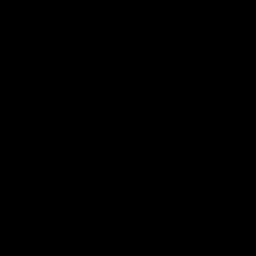

✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_11_nuc.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/095_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_11_cyt.bmp
Extracted 14 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/108_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_07_nuc.bmp
Extracted 18 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/108_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/108_07_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/094_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_04_nuc.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/094_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/094_04_cyt.bmp
Extracted 15 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/086_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_02_nuc.bmp
Extracted 15 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/086_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/086_02_cyt.bmp
Extracted 10 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/067_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_02_nuc.bmp
Extracted 21 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/067_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/067_02_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/145_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/145_02_nuc.bmp
Extracted 15 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/145_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/145_02_cyt.bmp
Extracted 21 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/192_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/192_01_nuc.bmp
Extracted 61 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/192_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/192_01_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/076_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/076_01_nuc.bmp
Extracted 25 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/076_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/076_01_cyt.bmp
Extracted 24 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/220_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/220_03_nuc.bmp
Extracted 31 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/220_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/220_03_cyt.bmp
Extracted 10 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/111_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/111_02_nuc.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/111_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/111_02_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/111_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/111_08_nuc.bmp
Extracted 14 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/111_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/111_08_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/063_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_01_nuc.bmp
Extracted 25 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/063_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/063_01_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/026_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/026_04_nuc.bmp
Extracted 33 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/026_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/026_04_cyt.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/146_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/146_06_nuc.bmp
Extracted 16 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/146_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/146_06_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/133_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/133_07_nuc.bmp
Extracted 15 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/133_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/133_07_cyt.bmp
Extracted 18 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/218_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/218_01_nuc.bmp
Extracted 30 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/218_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/218_01_cyt.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/059_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/059_02_nuc.bmp
Extracted 25 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/059_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/059_02_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/119_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/119_06_nuc.bmp
Extracted 14 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/119_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/119_06_cyt.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/019_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_04_nuc.bmp
Extracted 29 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/019_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/019_04_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/152_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/152_01_nuc.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/152_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/152_01_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/138_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/138_01_nuc.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/138_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/138_01_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/095_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_03_nuc.bmp
Extracted 19 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/095_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_03_cyt.bmp
Extracted 24 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/161_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/161_02_nuc.bmp
Extracted 39 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/161_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/161_02_cyt.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/032_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_02_nuc.bmp
Extracted 19 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/032_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/032_02_cyt.bmp
Extracted 14 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/046_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_03_nuc.bmp
Extracted 39 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/046_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/046_03_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/151_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/151_05_nuc.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/151_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/151_05_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/129_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/129_03_nuc.bmp
Extracted 16 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/129_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/129_03_cyt.bmp
Extracted 20 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/200_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/200_01_nuc.bmp
Extracted 39 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/200_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/200_01_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/121_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/121_10_nuc.bmp
Extracted 18 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/121_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/121_10_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/117_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/117_03_nuc.bmp
Extracted 16 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/117_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/117_03_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/033_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/033_02_nuc.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/033_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/033_02_cyt.bmp
Extracted 19 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/198_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/198_01_nuc.bmp
Extracted 40 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/198_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/198_01_cyt.bmp
Extracted 14 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/024_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/024_01_nuc.bmp
Extracted 29 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/024_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/024_01_cyt.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/102_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_07_nuc.bmp
Extracted 32 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/102_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/102_07_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/052_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_03_nuc.bmp
Extracted 18 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/052_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_03_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/090_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/090_08_nuc.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/090_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/090_08_cyt.bmp
Extracted 10 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/123_11_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_11_nuc.bmp
Extracted 19 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/123_11_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_11_cyt.bmp
Extracted 15 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/049_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_04_nuc.bmp
Extracted 27 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/049_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/049_04_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/114_14_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/114_14_nuc.bmp
Extracted 18 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/114_14_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/114_14_cyt.bmp
Extracted 26 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/196_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/196_01_nuc.bmp
Extracted 43 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/196_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/196_01_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/105_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/105_10_nuc.bmp
Extracted 16 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/105_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/105_10_cyt.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/013_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/013_04_nuc.bmp
Extracted 23 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/013_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/013_04_cyt.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/134_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/134_02_nuc.bmp
Extracted 16 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/134_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/134_02_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/105_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/105_03_nuc.bmp
Extracted 19 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/105_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/105_03_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/064_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_01_nuc.bmp
Extracted 25 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/064_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/064_01_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/195_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/195_02_nuc.bmp
Extracted 41 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/195_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/195_02_cyt.bmp
Extracted 21 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/161_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/161_03_nuc.bmp
Extracted 37 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/161_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/161_03_cyt.bmp
Extracted 14 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/143_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/143_04_nuc.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/143_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/143_04_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/007_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_01_nuc.bmp
Extracted 20 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/007_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/007_01_cyt.bmp
Extracted 10 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/097_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_03_nuc.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/097_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_03_cyt.bmp
Extracted 10 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/146_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/146_05_nuc.bmp
Extracted 20 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/146_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/146_05_cyt.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/113_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/113_05_nuc.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/113_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/113_05_cyt.bmp
Extracted 20 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/233_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/233_01_nuc.bmp
Extracted 34 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/233_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/233_01_cyt.bmp
Extracted 20 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/026_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/026_01_nuc.bmp
Extracted 40 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/026_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/026_01_cyt.bmp
Extracted 18 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/232_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/232_04_nuc.bmp
Extracted 44 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/232_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/232_04_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/130_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/130_06_nuc.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/130_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/130_06_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/097_10_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_10_nuc.bmp
Extracted 20 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/097_10_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_10_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/012_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_02_nuc.bmp
Extracted 22 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/012_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/012_02_cyt.bmp
Extracted 10 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/124_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/124_03_nuc.bmp
Extracted 34 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/124_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/124_03_cyt.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/149_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/149_01_nuc.bmp
Extracted 30 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/149_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/149_01_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/158_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/158_02_nuc.bmp
Extracted 26 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/158_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/158_02_cyt.bmp
Extracted 16 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/045_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_01_nuc.bmp
Extracted 34 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/045_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/045_01_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/099_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_09_nuc.bmp
Extracted 14 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/099_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_09_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/087_12_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/087_12_nuc.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/087_12_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/087_12_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/099_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_06_nuc.bmp
Extracted 14 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/099_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/099_06_cyt.bmp
Extracted 10 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/123_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_04_nuc.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/123_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_04_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/080_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_01_nuc.bmp
Extracted 26 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/080_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/080_01_cyt.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/111_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/111_03_nuc.bmp
Extracted 16 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/111_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/111_03_cyt.bmp
Extracted 14 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/218_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/218_02_nuc.bmp
Extracted 41 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/218_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/218_02_cyt.bmp
Extracted 15 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/152_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/152_02_nuc.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/152_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/152_02_cyt.bmp
Extracted 15 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/130_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/130_01_nuc.bmp
Extracted 21 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/130_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/130_01_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/077_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/077_05_nuc.bmp
Extracted 20 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/077_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/077_05_cyt.bmp
Extracted 19 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/172_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/172_02_nuc.bmp
Extracted 26 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/172_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/172_02_cyt.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/020_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_02_nuc.bmp
Extracted 28 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/020_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_02_cyt.bmp
Extracted 21 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/156_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/156_01_nuc.bmp
Extracted 62 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/156_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/156_01_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/123_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_06_nuc.bmp
Extracted 20 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/123_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_06_cyt.bmp
Extracted 9 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/133_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/133_03_nuc.bmp
Extracted 14 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/133_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/133_03_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/144_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/144_04_nuc.bmp
Extracted 20 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/144_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/144_04_cyt.bmp
Extracted 18 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/187_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/187_01_nuc.bmp
Extracted 28 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/187_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/187_01_cyt.bmp
Extracted 30 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/159_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/159_01_nuc.bmp
Extracted 68 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/159_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/159_01_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/141_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/141_05_nuc.bmp
Extracted 14 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/141_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/141_05_cyt.bmp
Extracted 20 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/165_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/165_01_nuc.bmp
Extracted 52 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/165_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/165_01_cyt.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/027_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_02_nuc.bmp
Extracted 22 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/027_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/027_02_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/133_05_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/133_05_nuc.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/133_05_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/133_05_cyt.bmp
Extracted 24 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/157_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/157_03_nuc.bmp
Extracted 27 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/157_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/157_03_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/084_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/084_03_nuc.bmp
Extracted 15 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/084_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/084_03_cyt.bmp
Extracted 20 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/220_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/220_02_nuc.bmp
Extracted 31 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/220_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/220_02_cyt.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/077_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/077_04_nuc.bmp
Extracted 26 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/077_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/077_04_cyt.bmp
Extracted 10 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/113_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/113_04_nuc.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/113_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/113_04_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/150_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/150_02_nuc.bmp
Extracted 14 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/150_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/150_02_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/107_09_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_09_nuc.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/107_09_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/107_09_cyt.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/211_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/211_01_nuc.bmp
Extracted 34 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/211_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/211_01_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/017_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_04_nuc.bmp
Extracted 22 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/017_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/017_04_cyt.bmp
Extracted 15 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/130_03_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/130_03_nuc.bmp
Extracted 27 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/130_03_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/130_03_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/015_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_07_nuc.bmp
Extracted 25 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/015_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/015_07_cyt.bmp
Extracted 9 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/101_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/101_02_nuc.bmp
Extracted 19 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/101_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/101_02_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/020_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_04_nuc.bmp
Extracted 23 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/020_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/020_04_cyt.bmp
Extracted 14 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/238_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/238_01_nuc.bmp
Extracted 39 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/238_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/238_01_cyt.bmp
Extracted 15 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/028_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_01_nuc.bmp
Extracted 38 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/028_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/028_01_cyt.bmp
Extracted 22 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/157_06_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/157_06_nuc.bmp
Extracted 34 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/157_06_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/157_06_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/119_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/119_07_nuc.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/119_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/119_07_cyt.bmp
Extracted 27 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/156_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/156_02_nuc.bmp
Extracted 58 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/156_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/156_02_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/097_08_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_08_nuc.bmp
Extracted 15 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/097_08_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/097_08_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/052_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_02_nuc.bmp
Extracted 20 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/052_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/052_02_cyt.bmp
Extracted 12 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/124_04_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/124_04_nuc.bmp
Extracted 20 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/124_04_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/124_04_cyt.bmp
Extracted 15 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/088_07_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/088_07_nuc.bmp
Extracted 24 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/088_07_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/088_07_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/130_14_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/130_14_nuc.bmp
Extracted 16 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/130_14_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/130_14_cyt.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/104_02_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/104_02_nuc.bmp
Extracted 18 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/104_02_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/104_02_cyt.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/123_14_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_14_nuc.bmp
Extracted 20 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/123_14_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_14_cyt.bmp
Extracted 9 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/073_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/073_01_nuc.bmp
Extracted 31 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/073_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/073_01_cyt.bmp
Extracted 17 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/219_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/219_01_nuc.bmp
Extracted 25 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/219_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/219_01_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/123_13_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_13_nuc.bmp
Extracted 16 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/123_13_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/123_13_cyt.bmp
Extracted 11 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/095_01_nuc.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_01_nuc.bmp
Extracted 15 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/095_01_cyt.dat


✅ Mask saved successfully at: /content/Clean_Data/Training_Data/Masks/095_01_cyt.bmp
Extracted 13 polygon points from Koilocytotic/im_Koilocytotic/CROPPED/021_02_nuc.dat


In [ ]:
organize_balanced_clean_data(root_folder_path)

In [ ]:
0.1 * (787 * 5)

In [ ]:
2750 + 785 + 400 == (787 * 5)

In [ ]:
[x* (787 * 5) for x in (0.7, 0.2, 0.1) ]

# 6. Implementation

## 6.1 Import Libraries

In [ ]:
import tensorflow as tf
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split

## 6.2 Load the Dataset

### Goal when loading the dataset

|Step| Completion Status|
|:----|:----:|
|Load Cropped Images from the Clean_Data directory| ✅|
|Convert images to grayscale (if needed)| ❌|
|Normalize pixel values to [0,1]| ❌|
|Create corresponding segmentation masks (if available)| ❌|
|Split data into training, validation, and test sets| ✅|

### Why Keep RGB

**1. Color information is crucial for classification & segmentation**

- Different stains (e.g., eosinophilic = pink, cyanophilic = blue) provide biological context.

- Grayscale conversion removes this key distinguishing factor.

**2. Preserves stain intensity variations**

- Some cells have darker cytoplasmic regions or lighter perinuclear areas, which are better captured in RGB.

**3. Maintains contrast for nucleus & cytoplasm segmentation**

- The difference in staining (e.g., a dark blue nucleus vs. a pink cytoplasm) improves segmentation accuracy.

**4. Deep Learning models can handle 3-channel (RGB) images well**

- A U-Net model trained on RGB images will likely perform better on this task.


In [ ]:
CLEAN_DATA_PATH = "/content/Clean_Data"
IMG_SIZE = (256, 256) # resize the images

In [ ]:
def load_images_and_masks(clean_data_path, dataset_type="Training_Data"):
    """
    Loads images and corresponding masks from the given dataset folder, preserving RGB channels.

    Args:
        clean_data_path (str): Root folder where clean data is stored.
        dataset_type (str): "Training_Data", "Validation_Data", or "Test_Data".

    Returns:
        X (numpy array): RGB images
        Y (numpy array): Corresponding segmentation masks
    """
    dataset_path = os.path.join(clean_data_path, dataset_type, "Images")
    images, masks = [], []

    for img_file in os.listdir(dataset_path):
        if img_file.endswith(".bmp"):
            img_path = os.path.join(dataset_path, img_file)

            # Load image in RGB (3-channel)
            img = cv2.imread(img_path, cv2.IMREAD_COLOR)  # Keep RGB format
            img = cv2.resize(img, IMG_SIZE) / 255.0  # Normalize pixel values

            # Load segmentation mask (assuming masks are in a separate folder or created manually)
            mask_path = img_path.replace("Images", "Masks")  # Modify path to find mask
            if os.path.exists(mask_path):
                mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)  # Keep as grayscale mask
                mask = cv2.resize(mask, IMG_SIZE) / 255.0
            else:
                mask = np.zeros(IMG_SIZE)  # Placeholder if no mask available

            images.append(img)
            masks.append(mask)

    return np.array(images).reshape(-1, 256, 256, 3), np.array(masks).reshape(-1, 256, 256, 1)
